# עבודת סיכום מס' 4

In [302]:
library(DBI)
library(odbc)
library(RSQLite)
library(dplyr)
library(ggplot2)
if (!require("car")) install.packages("car")
if (!require("tibble")) install.packages("tibble")
if (!require("gridExtra")) install.packages("gridExtra")
if (!require("gtools")) install.packages("gtools")

Loading required package: gtools


Attaching package: 'gtools'


The following object is masked from 'package:car':

    logit




In [2]:
#sort(unique(odbcListDrivers()[[1]]))

In [3]:
#con <- dbConnect(odbc(), 
     #            Driver = "SQL Server", 
      #           Server = "DESKTOP-AAGNMGA\\SQLEXPRESS", 
       #          Database = "BoxOffice", 
        #         Trusted_Connection = "True")

In [13]:
 #movies_ff <- dbReadTable(con,"movies_ff_v")

In [14]:
 #save(movies_ff,file="C:/Users/Mayer/Documents/DataScience/data/BoxOffice_ff.RData")

In [3]:
 BoxOffice_ff <- load("C:/Users/Mayer/Documents/DataScience/data/BoxOffice_ff.RData")

In [242]:
df <- movies_ff
y <- "revenue"

In [243]:
head(df)

,movie_id,original_language,release_date,runtime_cat,runtime,budget,popularity,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<dbl>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,1,en,2015-02-20,Short,93,14000000,6.575393,12314651,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2,en,2004-08-06,Medium,113,40000000,8.248895,95149435,1,0,...,0,0,0,0,0,0,3,0,0,1
3,3,en,2014-10-10,Medium,105,3300000,64.299990,13092000,1,1,...,0,1,0,0,0,0,2,0,0,0
4,4,hi,2012-03-09,Large,122,1200000,3.174936,16000000,0,1,...,0,0,0,0,0,0,0,0,0,0
5,5,ko,2009-02-05,Medium,118,0,1.148070,3923970,0,0,...,0,0,0,0,0,0,0,0,0,0
6,6,en,1987-08-06,Short,83,8000000,0.743274,3261638,1,0,...,0,0,0,0,0,0,0,0,0,0


In [9]:
vn <- names(df[,2:84])
movies_continuous <- c('movie_id')
for(v in vn) {
        if((is.numeric(df[[v]])) & (max(df[[v]],na.rm=T)>1))
            {movies_continuous <- c(movies_continuous,v)}}

In [10]:
movies_continuous <- setdiff(movies_continuous,"movie_id")

In [11]:
movies_continuous

[1] "runtime"                      "budget"                      
 [3] "popularity"                   "revenue"                     
 [5] "release_year"                 "release_month"               
 [7] "release_day"                  "seasonality"                 
 [9] "sw_collection"                "producers_cnt"               
[11] "countries_cnt"                "keywords_cnt"                
[13] "actor0_movies_cnt"            "actor0_movies_5y_cnt"        
[15] "actor1_movies_cnt"            "actor1_movies_5y_cnt"        
[17] "actor2_movies_cnt"            "actor2_movies_5y_cnt"        
[19] "actor0_prev_revenue"          "actor1_prev_revenue"         
[21] "actor2_prev_revenue"          "director_movies_cnt"         
[23] "director_movies_5y_cnt"       "depart_Art"                  
[25] "depart_Camera"                "depart_Crew"                 
[27] "depart_Custom_Mkup"           "depart_Directing"            
[29] "depart_Editing"               "depart_Lighting"             
[31] "depart_Production"            "depart_Sound"                
[33] "depart_Visual_Effects"        "depart_Writing"              
[35] "depart_Art_female"            "depart_Camera_female"        
[37] "depart_Crew_female"           "depart_Custom_Mkup_female"   
[39] "depart_Directing_female"      "depart_Editing_female"       
[41] "depart_Production_female"     "depart_Sound_female"         
[43] "depart_Visual_Effects_female" "depart_Writing_female"

From some reason I couldn't run some codes with 'movies_continuous' which I've created with a loop, therefore I've created a "stupid" object called 'movies_continuous2' which I've created by hand.. 
I spent a lot of time trying to figure out the error with no succsess

In [12]:
movies_continuous2 <- df[,c(5:8,13:14,16:20,26:32,39:42,63:84)]

In [13]:
movies_categorial <- df[,c(2,4,9:12,15,18,21:25,33:38,43:62)]
length(names(movies_categorial))

[1] 39

# Exploratory data analysis - חלק 2 - בדיקת הנתונים

##  2.1 Descriptive Statistics for BoxOffice

In [154]:
exploreData <- function(data=data, y=NULL, rn=NULL, factorSize=10, dir="report", debug=FALSE, ...) {

  get_computer_type <- function(){
    # check if current R client is running on PC or on the server
    if (Sys.info()[1] == "Windows") {
      computer.type = "pc"
    } else if (Sys.info()[1] == "Linux") {
      computer.type = "server"
    }
    return(computer.type)
  }

  whatVarType <- function(var) {
    suppressWarnings(if (var=="integer" | var=="numeric") {
      return(1)
    } else if (var=="factor" | var=="character") {
      return(2)
    } else if (var=="Date" | "POSIXct" %in% var[[1]]) {
      return(3)
    } else {
      return(0)
    })
  }

  drawHistogram <- function(imgname=imgname, x=x) {
    d=stats::density(x, kernel = "gaussian",na.rm=TRUE)
    breakstar=(max(x,na.rm=TRUE) -min(x,na.rm=TRUE))/d$bw
    h=graphics::hist(x, breaks=breakstar)
    graphics::plot(h,main="",xlab=imgname)
    yfit<-seq(min(x,na.rm=TRUE),max(x,na.rm=TRUE),length=40)
    ffit<-stats::dnorm(yfit,mean=mean(x,na.rm=T),sd=stats::sd(x,na.rm=T))
    ffit <- ffit*diff(h$mids[1:2])*length(x)
    lines(yfit, ffit, col="blue", lwd=2)
  }

  drawFakeGraph <- function(imgname=imgname) {
    graphics::plot.window(xlim = c(0,0),ylim = c(0,0))
  }

  drawBars <- function(imgname=imgname, x=x) {
    graphics::plot(x)
  }

  drawGraphOne <- function(imgname=imgname, numVar=x, vartype=1) {
    if(vartype==1) {
      drawHistogram(imgname,numVar)
    } else if(vartype==2) {
      drawBars(imgname,numVar)
    } else {
      drawFakeGraph(imgname)
    }
  }

  getContinuousStats <- function(x) {
    N <- length(x)
    n <- length(x[which(is.na(x)==FALSE)])
    pct <- formatC(n/N * 100)
    nmiss <- length(x[which(is.na(x)==TRUE)])
    npct <- formatC(nmiss/N *100)
    ma <- mean(x, na.rm=TRUE)
    s <- stats::sd(x, na.rm=TRUE)
    me <- formatC(stats::median(x, na.rm=TRUE))
    q1 <- formatC(stats::quantile(x,1/4, na.rm=TRUE))
    q3 <- formatC(stats::quantile(x,3/4, na.rm=TRUE))
    mn <- formatC(min(x, na.rm=TRUE))
    mx <- formatC(max(x, na.rm=TRUE))
    html <- paste("<div class='Cell' style='align: top;'> <u>Data type</u>: Continuous <p> <u>Data length</u>: ",n ,"/", N, " (", pct, "%) <br> <u>Missing</u>: ",
                  nmiss, " (", npct, "%)<p> <u>Mean</u>: ", formatC(ma), "\t <u>StdDev</u>: ", formatC(s), "<br><u>Median</u>: ",me,
                  "\t <u>IQR</u>: ", q1, "-", q3, "<br><u>Min</u>: ", mn, "\t <u>Max</u>: ", mx, "</div>")
    return(html)
  }

  getCategortyStats <- function(x) {
    N <- length(x)
    n <- length(x[which(is.na(x)==FALSE)])
    pct <- formatC(n/N * 100)
    nmiss <- length(x[which(is.na(x)==TRUE)])
    npct <- formatC(nmiss/N *100)
    l <- levels(x)
    s <- summary(x)
    htm <- "<ul>"
    if (length(l) < 5) {
      for (lv in l) {
        htm <- paste(htm, "<li><u>", lv, "</u>: ", s[[lv]], "</li>")
      }
      htm <- paste(htm,"</ul>")
    }
    html <- paste("<div class='Cell'> <u>Data type</u>: Categorical Data <p> <u>Data length</u>: ",n, "/", N, " (", pct, "%) <br> <u>Missing</u>: ",
                  nmiss, " (", npct, "%) <p> <u>Number of levels</u>: ", length(l), "<br>", htm, "</div>")
    return(html)
  }

  getDatesStats <- function(x) {
    N <- length(x)
    n <- length(x[which(is.na(x)==FALSE)])
    pct <- formatC(n/N * 100)
    nmiss <- length(x[which(is.na(x)==TRUE)])
    npct <- formatC(nmiss/N *100)
    s <- summary(x)
    html <- paste("<div class='Cell'> <u>Data type</u>: Date <p> <u>Data length</u>: ",n, "/", N, " (", pct, "%) <br> <u>Missing</u>: ",
                  nmiss, " (", npct, "%) <p> <u>Min date</u>: ", min(x, na.rm=T), "<br><u>Max date</u>:",max(x, na.rm=T) , "</div>")
    return(html)
  }

  getStats <- function(numVar=x, vartype=1) {
    if(vartype==1) {
      html <- getContinuousStats(numVar)
    } else if(vartype==2) {
      html <- getCategortyStats(numVar)
    } else if (vartype==3) {
      html <- getDatesStats(numVar)
    } else {
      html <- "<div class='Cell'></div>"
    }
    return(html)
  }

  getOutliers <- function(x) {
    bp <- graphics::boxplot(x,plot=FALSE)
    return(bp$out)
  }

  getOutlierGraph <- function(x) {
    #  mod <- tryCatch({
    outl <- getOutliers(x)
    df <- data.frame(x=x, cl=1)
    if(length(outl)>0) {
      df$cl[which(df$x %in% outl)] <- 2
    }
    #pl <- stats::scatter.smooth(df$x,col=df$cl)
    pl <- tryCatch({
      stats::scatter.smooth(df$x,col=df$cl,xlab="index")
    }, warning = function(w) {
      n <- "warning!"
    }, error = function(e) {
      n <- "error!"
    }, finally = {
      graphics::plot(df$x ~ row.names(df),col=df$cl,xlab="index")
    })
    ma <- mean(x, na.rm=TRUE)
    s <- stats::sd(x, na.rm=TRUE)
    graphics::abline(h=ma-(2*s), col="red", lty=2)
    graphics::abline(h=ma+(2*s), col="red", lty=2)
    #  }, error = function(e) {
    #    pl <- drawFakeGraph("none")
    #  })
    return(pl)
  }

  getScatterGraph <- function(df=data,x,y,dtype=1) {
    #  mod <- tryCatch({
    if(dtype==1) {
      pl <- ggplot2::ggplot(df) + ggplot2::geom_smooth(ggplot2::aes(x=data[[x]], y=data[[y]]), method="loess") + ggplot2::xlab(x) + ggplot2::ylab(y)
    } else {
      pl <- ggplot2::ggplot(df) + ggplot2::geom_boxplot(ggplot2::aes(y=data[[x]], color=data[[y]])) + ggplot2::xlab(x) + ggplot2::ylab(y) + ggplot2::labs(color=y)
    }
    return(pl)
  }

  getOutliersHtml <- function(imgname=imgname, x=x, srcdir=srcdir) {
    bp <- getOutliers(x)
    if (length(unique(bp)) > 10) {
      xtrm <- paste("There are ", length(unique(bp)), " outlier values")
    } else if (length(unique(bp)) == 0) {
      xtrm <- "No outlier values found"
    } else {
      xtrm <- paste(formatC(unique(bp)), collapse=', ' )
    }
    imgsrc = paste(paste0(srcdir,"/fig/"),imgname, "_2.png",sep="")
    html <- paste0("<div class='Cell'><img class='origimg' src='",imgsrc,"' height='150' width='250'><br> <u>Outlier values</u>: <br> ", xtrm, "</div>")
    return(html)
  }
  ################## Prepare for the report ###################
  #report <- paste(mydir,"/report",sep="")

  ################## Check for values for rn ##################
  if(!is.null(rn)) {
    if(length(rn)!=ncol(data)) {
      message("the value of the 'rn' argument was avoided because it does not have the same number of columns of the dataframe")
      rn <- NULL
    }
    xname <- rn
    names(xname) <- names(data)
  } else {
    xname <- NULL
  }

  report <- dir
  if (!file.exists(report)) {
    dir.create(report)
  }
  fig <- paste(report,"/fig",sep="")
  if (!file.exists(fig)) {
    dir.create(fig)
  }
  if (get_computer_type()=="pc") {
    srcdir <- paste0(getwd(),"/",report)
  } else {
    #srcdir <- paste0("file_show?path=",getwd(),"/",report)
    srcdir <- paste0("/view/",getwd(),"/report")
  }
  # determine which columns are integer
  int_col <- which(sapply(data, is.integer))
  int_col <- c(int_col,(which(sapply(data, is.numeric))))
  mi <- vector()
  # find only those integers with less than 10 unique values and convert to factor
  for (li in int_col) {
    if (length(unique(data[,li])) < factorSize) {
      mi <- c(mi,li)
      if (is.factor(data[,li]) == FALSE) {
        data[,li] <- factor(data[,li])
      }
    }
  }

  str_col <- which(sapply(data, is.character))
  mi <- vector()
  # find only those integers with less than 10 unique values and convert to factor
  for (li in str_col) {
    mi <- c(mi,li)
    data[,li] <- factor(data[,li])
  }

  # create the html report page
  myhtml <- paste(report,"/report.html",sep="")
  cat("<!DOCTYPE html>
      <html>
      <head>
      <title>Data Visualization</title>
      <meta http-equiv='Content-Type' content='text/html; charset=UTF-8' />
      <link rel='stylesheet' href='http://code.jquery.com/mobile/1.4.5/jquery.mobile-1.4.5.min.css'>

      <script src='http://code.jquery.com/jquery-1.10.2.js'></script>
      <script>
      $(document).ready(function(){
      $('.onetoone').hide();
      });

      $(function() {
      $('.origimg').click(function(e) {
      $('#popup_img').attr('src',$(this).attr('src'));
      $('#myContainer').hide();
      var pos = $(document).scrollTop();
      $('#myContainer').css({'top':pos+20,'left':250, 'position':'absolute', 'border':'1px solid black', 'padding':'0px'});
      $('#myContainer').show();
      });
      $('#myContainer').click(function(e) {
      $('#myContainer').hide();
      });

      $('#myform2').submit(function(e) {
      e.preventDefault();
      });

      $('#onetoone').on('click',function() {
      console.log('onetone button - 1');
      $('#onetoone').hide();
      $('#aslist').show();
      // To show only individual rows:
      $('.Row').hide();
      $('.onetoone').show();
      // then we iterate
      var i = $('.Row').length;
      // Then we iterate
      var nxt = $('#idx').val();
      if (nxt < i & nxt >0) {
      $('.Row').hide();
      $('.Row').eq(0).show();
      $('.Row').eq(nxt).show();
      } else {
      $('#idx').val(1)
      }
      console.log('onetone button - 2');
      });

      $('#aslist').on('click',function() {
      console.log('aslist button - 1');
      $('#onetoone').show();
      $('#aslist').hide();
      $('.onetoone').hide();
      $('.Row').show();
      console.log('aslist button - 2');
      });

      $('#less').on('click',function(){
      console.log('less button - 1');
      var i = $('.Row').length;
      var nxt = parseInt($('#idx').val(),10) - 1;
      if (nxt < i & nxt >0) {
      $('#idx').val(nxt)
      $('.Row').hide();
      $('.Row').eq(0).show();
      $('.Row').eq(nxt).show();
      } else {
      $('#idx').val(1)
      }
      console.log('less button - 2');
      });

      $('#more').on('click',function(){
      console.log('more button - 1');
      var i = $('.Row').length;
      var nxt = parseInt($('#idx').val(),10) + 1;
      if (nxt < i & nxt >0) {
      $('#idx').val(nxt)
      $('.Row').hide();
      $('.Row').eq(0).show();
      $('.Row').eq(nxt).show();
      } else {
      $('#idx').val(i)
      }
      console.log('more button - 2');
      });

      $('#idx').on('change', function(){
      console.log('idx changed - 1');
      var i = $('.Row').length;
      var nxt = $('#idx').val();
      if (nxt < i & nxt >0) {
      $('#idx').val(nxt)
      $('.Row').hide();
      $('.Row').eq(0).show();
      $('.Row').eq(nxt).show();
      } else {
      $('#idx').val(i)
      }
      console.log('idx changed - 2');
      });
      });

      </script>

      <style type='text/css'>
      .Table
      {
      display: table;
      }
      .Title
      {
      display: table-caption;
      text-align: center;
      font-weight: bold;
      font-size: larger;
      background-color:#4C6F50;
      color: #fff;
      }
      .Row
      {
      display: table-row;
      }
      .Row:nth-child(even) {
        background-color: #56882433;
      }
      .Cell
      {
      display: table-cell;
      border: solid;
      border-width: thin;
      padding-left: 5px;
      padding-right: 5px;
      vertical-align: top;
      font-family: Arial, Helvetica, sans-serif;
      font-size: 14px;
      }
      </style>

      </head>

      <body>
      <div id='pageone' data-role='main' class='ui-content'>
      ", file = myhtml, sep='\n',append=FALSE)

  html <- paste("<p><p><h1> Data Visualization & Exploration </h1>
                <form>
                <input type='button' id='onetoone' value='Show as Cards'>
                <input type='button' id='aslist' class='onetoone' value='Show as List'>
                </form>
                <p>
                ")
  cat(html, file = myhtml, sep='\n', append=TRUE)
  # begin table
  alt1 <- ifelse(is.null(y)== TRUE, "", "<div class='Cell Title'> Dependent <br> Variable <br> Distribution </div>")
  html <- paste("<p><p>
                <div class='Table'>
                <div class='Row'>
                <div class='Cell Title'> Variable </div>
                <div class='Cell Title'> Distribution </div>
                <div class='Cell Title'> Descriptive <br> Statistics</div>
                <div class='Cell Title'> Outliers </div>"
                , alt1,
                "</div>")
  cat(html, file = myhtml, sep='\n', append=TRUE)

  #### determinate the type of each variable...
  data_types <- sapply(sapply(data, class), whatVarType)
  ln <- length(data)
  ii <- 0
  pb <- utils::txtProgressBar(min=0,max=ln,style=3)
  for(x in names(data)) {

    ## check if the value has at least more than one unique value...
    if(length(unique(data[[x]])) < 2) {
      message(paste("The variable",x,"has less than two unique values, so will not be included"))
    } else {

      if(debug==TRUE) {
        print(x)
      } else {
        pb <- utils::txtProgressBar(min=0,max=ln,style=3)
      }

      html <- paste("<div class='Row'><div class='Cell'><b>",x,"</b><p>",xname[x],"</p></div>")

      cat(html, file = myhtml, sep='\n', append=TRUE)
      #### initialize the first graph
      imgname = paste(fig,"/",x, "_1.png",sep="")
      imgsrc = paste(paste0(srcdir,"/fig/"),x, "_1.png",sep="")
      ### send the data with the type to generate the correct graph..
      grDevices::png(imgname)
      drawGraphOne(x, data[[x]], data_types[x])
      grDevices::dev.off()
      html <- paste0("<div class='Cell'><img class='origimg'  src='",imgsrc,"' height='150' width='150'><br></div>")
      cat(html, file = myhtml, sep='\n', append=TRUE)

      # second, show the statistics
      html <- getStats(data[[x]],data_types[x])
      cat(html, file = myhtml, sep='\n', append=TRUE)

      # third, determine the outliers
      imgname = paste(fig,"/",x, "_2.png",sep="")
      if(data_types[x]==1) {
        grDevices::png(imgname)
        getOutlierGraph(data[[x]])
        grDevices::dev.off()
        html <- getOutliersHtml(x,data[[x]],srcdir)
      } else {
        html <- "<div class='Cell'></div>"
      }
      cat(html, file = myhtml, sep='\n', append=TRUE)

      # fourth, if y is assigned, make a corresponding plot
      if(is.null(y)==FALSE) {
        imgname = paste(fig,"/",x, "_3.png",sep="")
        imgsrc = paste(paste0(srcdir,"/fig/"),x, "_3.png",sep="")
        #print(imgname)
        grDevices::png(imgname)
        ### scatter.smooth(data[[x]] ~ data[[y]])
        #suppressWarnings(getScatterGraph(data,x,y,data_types[y]))
        plot(getScatterGraph(data,x,y,data_types[y]))
        grDevices::dev.off()
        html <- paste0("<div class='Cell'><img class='origimg' src='",imgsrc,"' height='150' width='150'><br></div>")
        cat(html, file = myhtml, sep='\n', append=TRUE)
      }
      html <- paste("</div>")
      cat(html, file = myhtml, sep='\n', append=TRUE)

      if(debug==FALSE) {
        utils::setTxtProgressBar(pb,ii)
        ii <- ii + 1
      }
    }
  }
  html <- paste("</div>")
  cat(html, file = myhtml, sep='\n', append=TRUE)
  # end table
  html <- paste("</div>
                <div data-role='popup' id='myContainer' style='display: none;'>
                <img id='popup_img' src='' />
                </div>
                </div>
                </div>
                </div>
                <p>
                <div class='onetoone'>
                <form id='myform2'>
                <span> <input type='button' id='less' value=' << '> </span>
                <span> <input id='idx' name='idx' value='1'></input></span>
                <span> <input type='button' id='more' value=' >> '> </span>
                </form>
                </div>
                <p>
                </body></html>
                ")
  cat(html, file = myhtml, sep='\n', append=TRUE)
  if(.Platform$OS.type == "unix") {
    system(paste("start /b ", myhtml))
  } else {
    shell(paste("explorer ", gsub("/", "\\\\", myhtml) ), intern=TRUE)
  }
}

###################### END exploreData ###############

In [157]:
exploreData(data=df, y='revenue',dir="report-r", debug=FALSE) 

  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4384 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4531 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at -0.04"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 1.04"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  0"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"There are other near singularities as well. 1"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"pseudoinverse used at -0.04"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"neighborhood radius 1.04"
Warning mess

  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message:
"Removed 5310 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message:
"Removed 5534 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message:
"Removed 5621 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at -0.115"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 2.115"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  1.2111e-014"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"There are other near singularities as well. 1"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"pseudoinverse used at -0.115"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"neighborhood radius 2.115

  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at -0.595"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 2.595"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  8.8213e-015"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"There are other near singularities as well. 4"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"pseudoinverse used at -0.595"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"neighborhood radius 2.595

  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at -0.165"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 2.165"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  9.8819e-015"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"There are other near singularities as well. 4"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"pseudoinverse used at -0.165"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"neighborhood radius 2.165

  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at 0.855"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 1.145"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  3.4382e-028"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"There are other near singularities as well. 1"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"pseudoinverse used at 0.855"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"neighborhood radius 1.145"


  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at -0.07"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 2.07"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  4.6794e-015"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"There are other near singularities as well. 1"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"pseudoinverse used at -0.07"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"neighborhood radius 2.07"
Wa

  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"at  -0.06"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"radius  0.0036"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"all data on boundary of neighborhood. make span bigger"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at -0.06"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 0.06"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  1"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"zero-width neighborhood. make span bigger"
Warning message:
"Computation failed in `stat_smooth()`:
NA/NaN/Inf i

  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"at  -0.26"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"radius  0.0676"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"all data on boundary of neighborhood. make span bigger"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at -0.26"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 0.26"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  1"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"zero-width neighborhood. make span bigger"
Warning message:
"Computation failed in `stat_smooth()`:
NA/NaN/Inf i

  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at 2"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 1"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  0"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"pseudoinverse used at 2"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"neighborhood radius 1"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(

  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4397 rows containing non-finite values (stat_smooth)."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at -0.06"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 2.06"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  1.5653e-015"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"There are other near singularities as well. 4"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"pseudoinverse used at -0.06"
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
"neighborhood radius 2.06"
Wa

  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |                                                                      |   0%

Warning message:
"Removed 4382 rows containing non-finite values (stat_smooth)."


  |===================================================================== |  99%

Warning message in system(cmd, intern = intern, wait = wait | intern, show.output.on.console = wait, :
"running command 'C:\WINDOWS\system32\cmd.exe /c explorer  report-r\report.html' had status 1"


character(0)
attr(,"status")
[1] 1

### report notebook
<a href="https://github.com/EtiMayer/DataScience/blob/master/stats/Homework#4/report-r/report.html" target='_blank'> Report</a>

In [110]:
summary(df)

    movie_id    original_language  release_date       runtime_cat       
 Min.   :   1   Length:7375        Length:7375        Length:7375       
 1st Qu.:1848   Class :character   Class :character   Class :character  
 Median :3696   Mode  :character   Mode  :character   Mode  :character  
 Mean   :3698                                                           
 3rd Qu.:5550                                                           
 Max.   :7398                                                           
                                                                        
    runtime          budget            popularity         revenue         
 Min.   :  0.0   Min.   :        0   Min.   :  0.000   Min.   :1.000e+00  
 1st Qu.: 94.0   1st Qu.:        0   1st Qu.:  3.970   1st Qu.:2.405e+06  
 Median :104.0   Median :  8000000   Median :  7.456   Median :1.693e+07  
 Mean   :107.7   Mean   : 22666657   Mean   :  8.540   Mean   :6.688e+07  
 3rd Qu.:118.0   3rd Qu.: 29000000   3rd 

In [19]:
rapply(df,function(x)length(unique(x)))

movie_id            original_language 
                        7375                           44 
                release_date                  runtime_cat 
                        4697                            3 
                     runtime                       budget 
                         168                          704 
                  popularity                      revenue 
                        7371                         2845 
                  sw_lang_en              sw_web_presence 
                           2                            2 
               sw_has_poster                   sw_tagline 
                           2                            2 
                release_year                release_month 
                          99                           13 
          high_release_month                  release_day 
                           2                           32 
                 seasonality                sw_collection 
                          13                            3 
               producers_cnt                countries_cnt 
                          25                           12 
                     lang_US                      lang_FR 
                           2                            2 
                     lang_RU                      lang_ES 
                           2                            2 
                     lang_JA                 keywords_cnt 
                           2                           46 
           actor0_movies_cnt         actor0_movies_5y_cnt 
                          61                           17 
           actor1_movies_cnt         actor1_movies_5y_cnt 
                          59                           18 
           actor2_movies_cnt         actor2_movies_5y_cnt 
                          53                           16 
            sw_female_actor0             sw_female_actor1 
                           3                            3 
            sw_female_actor2               sw_male_actor0 
                           3                            3 
              sw_male_actor1               sw_male_actor2 
                           3                            3 
         actor0_prev_revenue          actor1_prev_revenue 
                        1152                         1265 
         actor2_prev_revenue          director_movies_cnt 
                        1341                           30 
      director_movies_5y_cnt              genre_adventure 
                           7                            2 
               genre_fantasy              genre_animation 
                           2                            2 
                 genre_drama                 genre_horror 
                           2                            2 
                genre_action                 genre_comedy 
                           2                            2 
               genre_history                genre_western 
                           2                            2 
              genre_thriller                  genre_crime 
                           2                            2 
           genre_documentary        genre_science_fiction 
                           2                            2 
               genre_mystery                  genre_music 
                           2                            2 
               genre_romance                 genre_family 
                           2                            2 
                   genre_war                genre_foreign 
                           2                            2 
                  depart_Art                depart_Camera 
                          35                           24 
                 depart_Crew           depart_Custom_Mkup 
                          51                           28 
            depart_Directing               depart_Editing 
                          24                           17 
        

In [11]:
#install.packages("pastecs")
library(pastecs)
options(scipen=100)
options(digits=2)
stat.desc(df[,5:84], basic=TRUE, desc=TRUE, norm=FALSE, p=0.95)

,runtime,budget,popularity,revenue,sw_lang_en,sw_web_presence,sw_has_poster,sw_tagline,release_year,release_month,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
nbr.val,7370.00,7375.0,7375.000000,2993.0,7375.0000,7375.0000,7375.00000,7375.0000,7374.0000,7374.000,...,7341.0000,7341.0000,7341.0000,7341.0000,7341.0000,7341.00000,7341.000,7341.0000,7341.0000,7341.0000
nbr.null,19.00,2012.0,0.000000,0.0,1039.0000,5012.0000,2.00000,1442.0000,0.0000,0.000,...,7194.0000,6971.0000,5293.0000,6297.0000,6516.0000,7336.00000,3872.000,6840.0000,7281.0000,6578.0000
nbr.na,5.00,0.0,0.000000,4382.0,0.0000,0.0000,0.00000,0.0000,1.0000,1.000,...,34.0000,34.0000,34.0000,34.0000,34.0000,34.00000,34.000,34.0000,34.0000,34.0000
min,0.00,0.0,0.000001,1.0,0.0000,0.0000,0.00000,0.0000,1918.0000,1.000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.00000,0.000,0.0000,0.0000,0.0000
max,338.00,380000000.0,547.488298,1519557910.0,1.0000,1.0000,1.00000,1.0000,2017.0000,12.000,...,3.0000,10.0000,6.0000,4.0000,5.0000,1.00000,12.000,6.0000,2.0000,5.0000
range,338.00,380000000.0,547.488297,1519557909.0,1.0000,1.0000,1.00000,1.0000,99.0000,11.000,...,3.0000,10.0000,6.0000,4.0000,5.0000,1.00000,12.000,6.0000,2.0000,5.0000
sum,794097.00,167166594664.0,62980.853408,200169779760.0,6336.0000,2363.0000,7373.00000,5933.0000,14745625.0000,50471.000,...,150.0000,473.0000,2595.0000,1127.0000,893.0000,5.00000,6898.000,581.0000,62.0000,912.0000
median,104.00,8000000.0,7.455875,16928137.0,1.0000,0.0000,1.00000,1.0000,2004.0000,7.000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.00000,0.000,0.0000,0.0000,0.0000
mean,107.75,22666656.9,8.539777,66879311.6,0.8591,0.3204,0.99973,0.8045,1999.6779,6.844,...,0.0204,0.0644,0.3535,0.1535,0.1216,0.00068,0.940,0.0791,0.0084,0.1242


###  2.2 Plots

### Runtime_cat

Warning message:
"Ignoring unknown parameters: main"


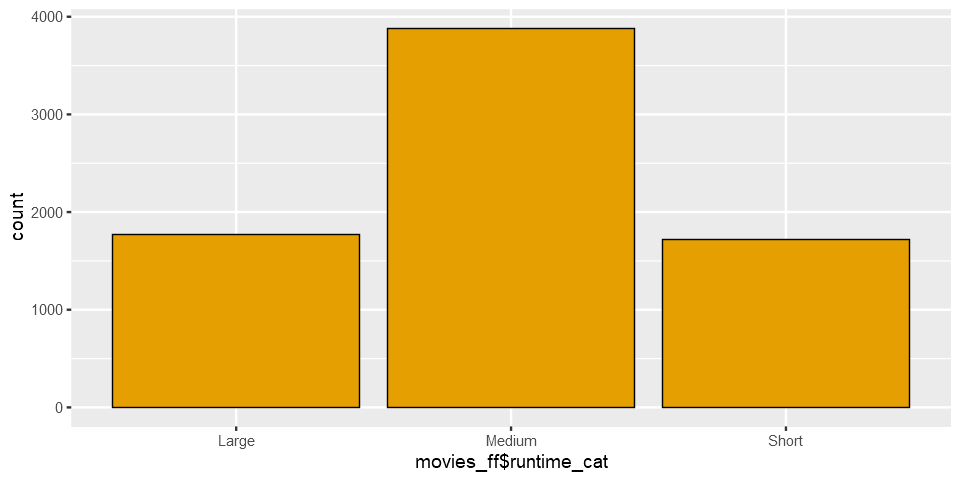

In [6]:
ggplot(df, aes(df$runtime_cat)) + geom_bar(fill = "#E69F00",color = "black",size = 0.3, main = "runtime_cat")  + theme_get()


### Runtime Analysis

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
"Removed 5 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 5 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5 rows containing missing values (geom_point)."


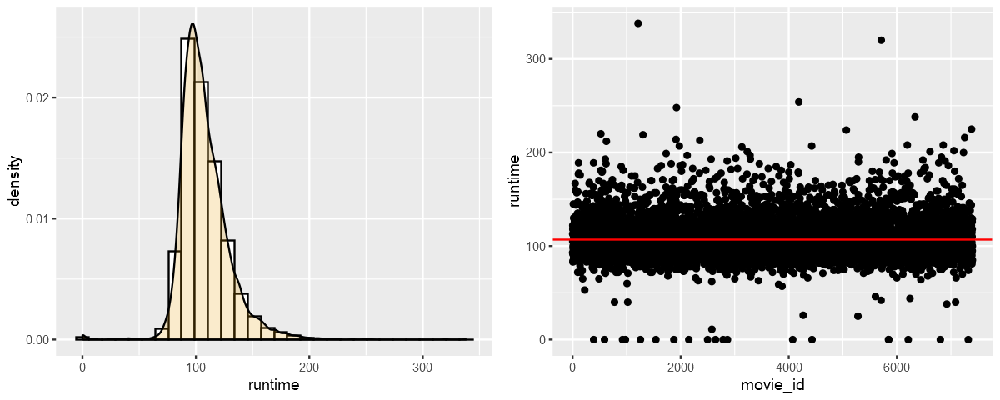

In [8]:
p1 <- ggplot(df, aes(x=runtime)) + geom_histogram(aes(y=..density..), colour="black", fill="white")+
      geom_density(alpha=0.2, fill="#E69F00") + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=runtime)) + geom_hline(yintercept = 107 ,color="red")


options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

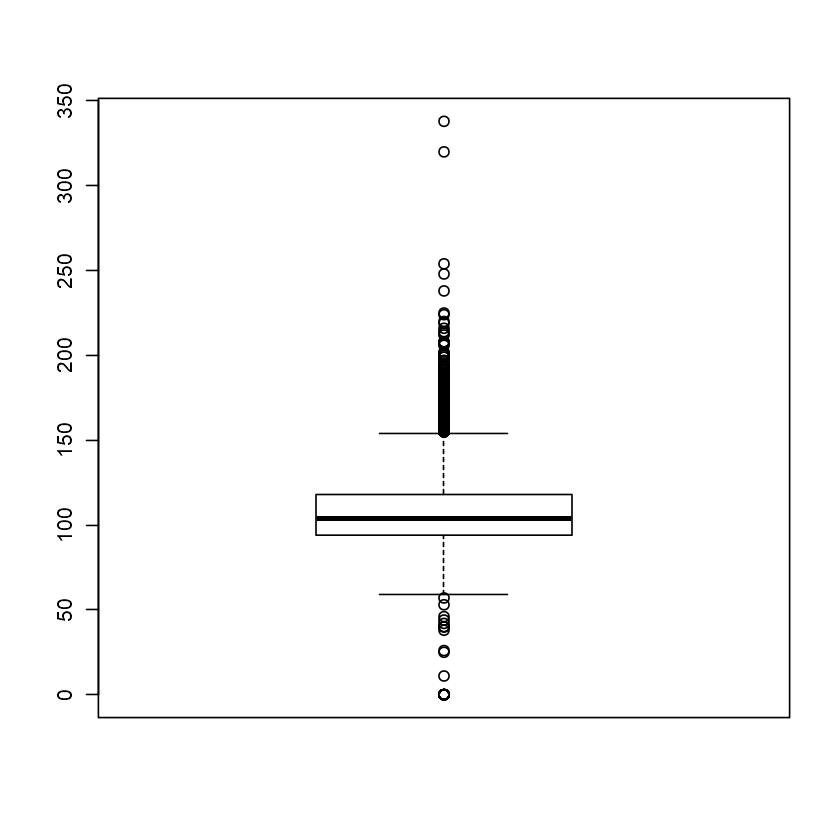

In [9]:
out_runtime <- boxplot(df$runtime)
options(repr.plot.width = 5, repr.plot.height =10)

In [161]:
head(out_runtime$out) # outlier
min(out_runtime$out) #  minimum outlier
max(out_runtime$out)
median(out_runtime$out)
mean(out_runtime$out)
length(out_runtime$out)

[1] 167 160 157 158 177 189

[1] 0

[1] 338

[1] 165

[1] 156.1127

[1] 275

### Budget Analysis

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
"Removed 2012 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 2012 rows containing non-finite values (stat_density)."


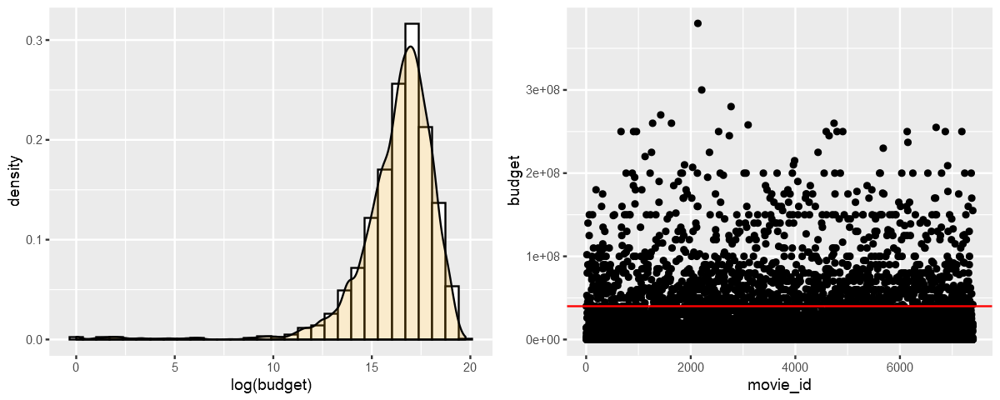

In [11]:
p1 <- ggplot(df, aes(x=log(budget))) + geom_histogram(aes(y=..density..), colour="black", fill="white")+
      geom_density(alpha=0.2, fill="#E69F00") + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=budget)) + geom_hline(yintercept = 40000000 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

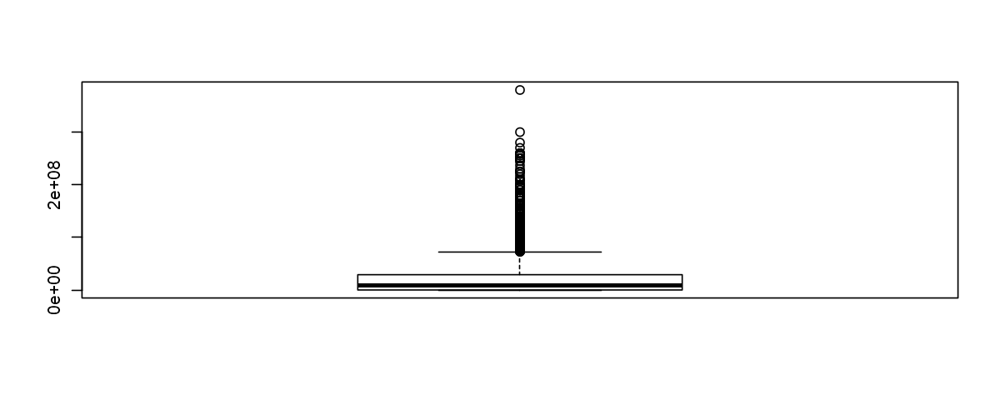

In [12]:
out_budget <- boxplot(df$budget)
options(repr.plot.width = 5, repr.plot.height =10)

In [13]:
head(out_budget$out) # outlier
min(out_budget$out) #  minimum outlier
max(out_budget$out) 
median(out_budget$out)
mean(out_budget$out)
length(out_budget$out)

[1] 1.02e+08 8.00e+07 9.00e+07 1.40e+08 8.00e+07 1.25e+08

[1] 7.3e+07

[1] 3.8e+08

[1] 1.05e+08

[1] 121655977

[1] 624

### Original_language Analysis

In [72]:
table(df$original_language)


  af   ar   bm   bn   ca   cn   cs   da   de   el   en   es   fa   fi   fr   he 
   1    1    2    3    1   41    3   17   49    3 6336   95    5    3  199    6 
  hi   hu   id   is   it   ja   ka   kn   ko   ml   mr   nb   nl   no   pl   pt 
 118    4    3    1   55   90    1    1   48   12    1    1   11    5    5   13 
  ro   ru   sr   sv   ta   te   th   tr   ur   vi   xx   zh 
   8  105    3   20   31    9    5    9    2    1    2   46 

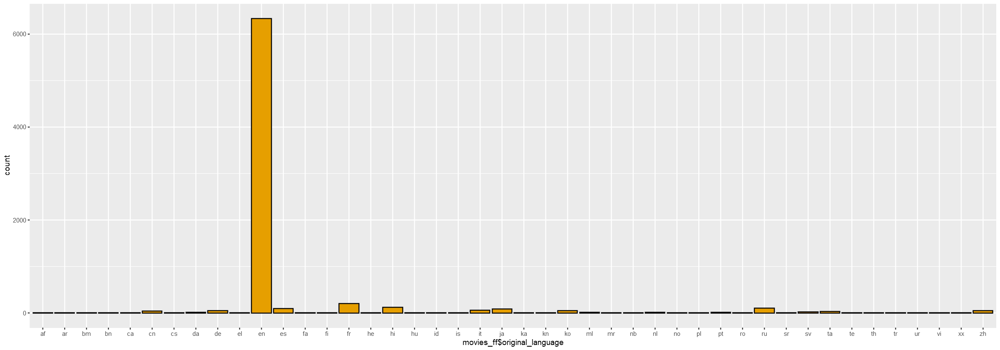

In [20]:
ggplot(df, aes(df$original_language)) +
  geom_bar(color = "black", fill = "#E69F00")  + theme_get()
options(repr.plot.width = 20, repr.plot.height = 7)

### Popularity Analysis

Warning message in sqrt(log(popularity)):
"NaNs produced"
Warning message in sqrt(log(popularity)):
"NaNs produced"
Warning message in sqrt(log(popularity)):
"NaNs produced"
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
"Removed 573 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 573 rows containing non-finite values (stat_density)."


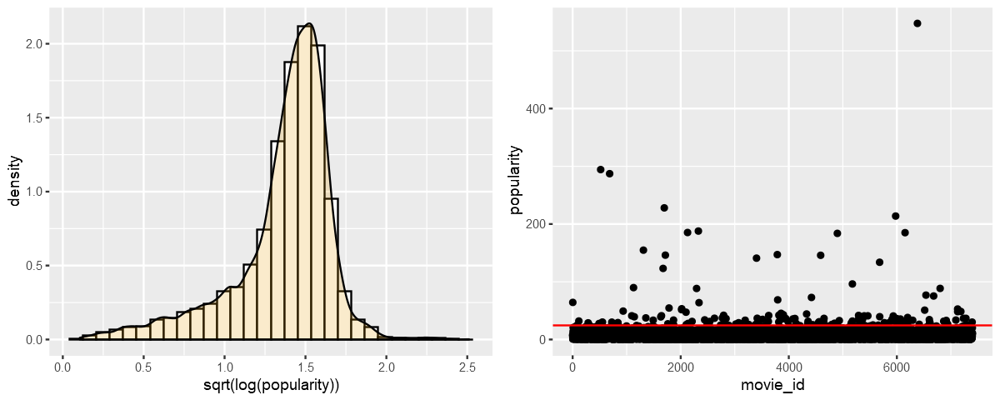

In [11]:
p1 <- ggplot(df, aes(sqrt(log(popularity)))) + geom_histogram(aes(y=..density..), colour="black", fill="white")+
      geom_density(alpha=0.2, fill="#E69F00") + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=popularity)) + geom_hline(yintercept = 25 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

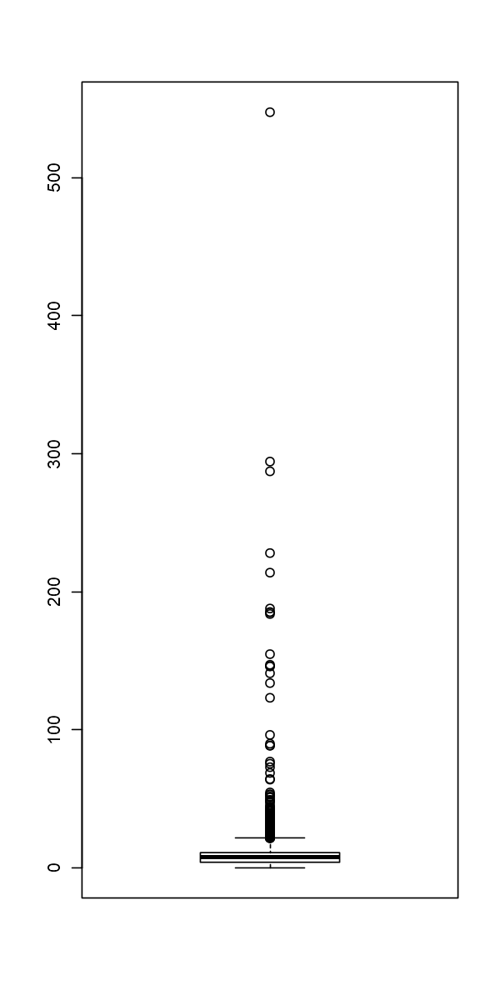

In [17]:
out_popularity <- boxplot(df$popularity)
options(repr.plot.width = 5, repr.plot.height =5)

In [18]:
head(out_popularity$out) # outlier
min(out_popularity$out) #  minimum outlier
max(out_popularity$out) #  maximum outlier
median(out_popularity$out)
mean(out_popularity$out)
length(out_popularity$out)

[1] 64.29999 23.06508 25.26187 32.07073 21.79111 28.92084

[1] 21.46346

[1] 547.4883

[1] 30.12129

[1] 46.8045

[1] 201

### Revenue Analysis

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
"Removed 4382 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
"Removed 4382 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Warning message:
"Removed 4382 rows containing missing values (geom_point)."


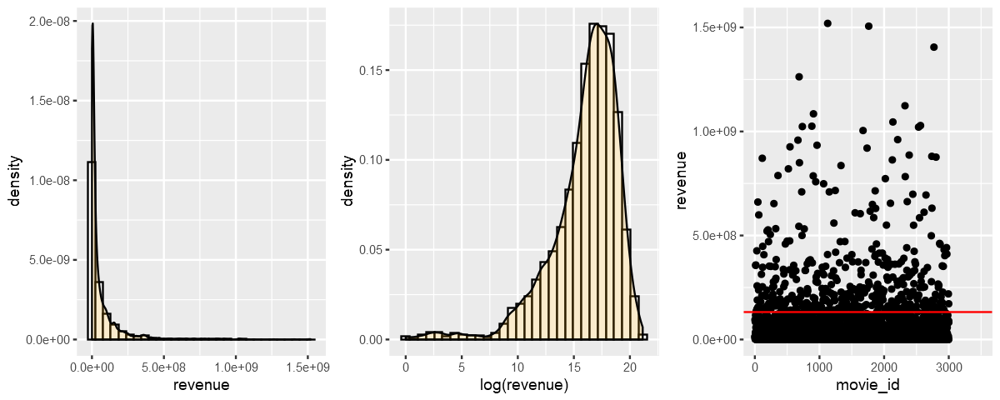

In [13]:
p1 <- ggplot(df, aes(x=revenue)) + geom_histogram(aes(y=..density..), colour="black", fill="white")+
      geom_density(alpha=0.2, fill="#E69F00") + theme_get()
#log reveue
p2 <- ggplot(df, aes(x=log(revenue))) + geom_histogram(aes(y=..density..), colour="black", fill="white")+
      geom_density(alpha=0.2, fill="#E69F00") + theme_get()
p3 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=revenue)) + xlim (0,3500) +
      geom_hline(yintercept = 130000000 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2,p3, nrow = 1)

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


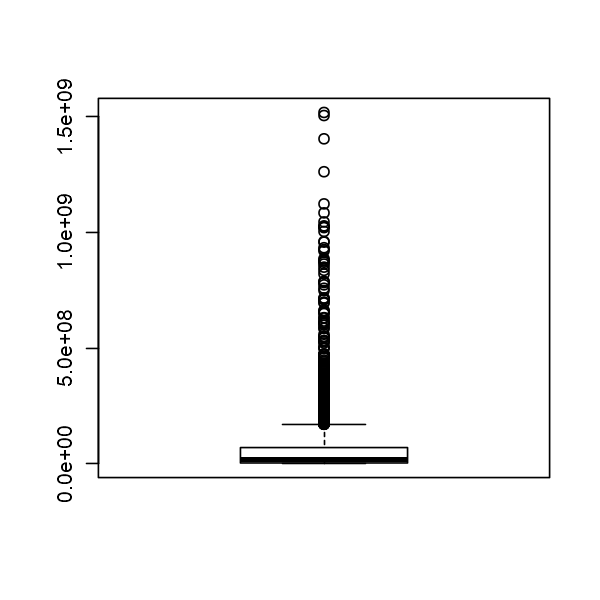

In [23]:
out_revenue <- boxplot(df$revenue)
options(repr.plot.width = 5, repr.plot.height =15)

In [24]:
head(out_revenue$out) # outlier
min(out_revenue$out) #  minimum outlier
max(out_revenue$out) #  maximum outlier
median(out_revenue$out)
mean(out_revenue$out)
length(out_revenue$out)

[1] 356296601 358372926 426480871 258022233 189859560 660940780

[1] 169852759

[1] 1519557910

[1] 288752301

[1] 376550319

[1] 315

### sw_lang_en

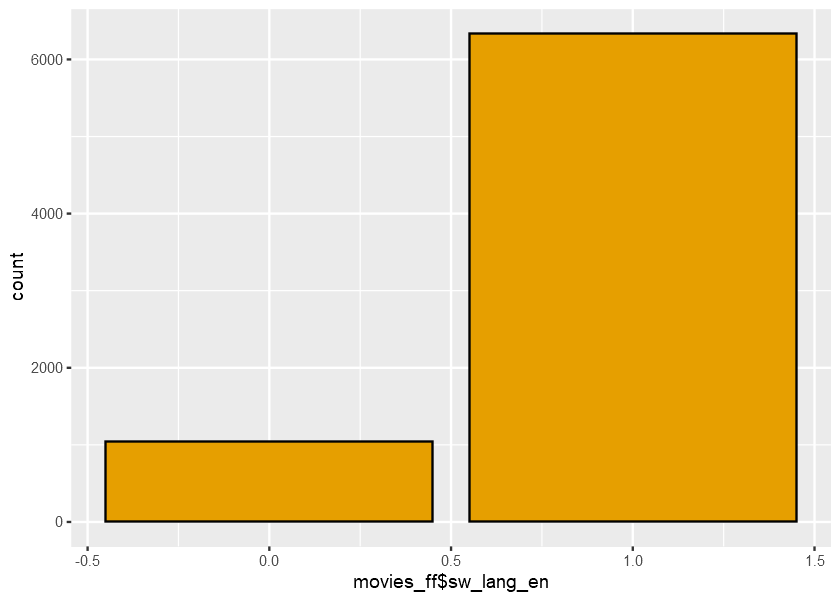

In [43]:
ggplot(df, aes(df$sw_lang_en)) + 
    geom_bar(color = "black", fill = "#E69F00")  + 
    theme_get()
   options(repr.plot.width = 7, repr.plot.height = 5)

### sw_web_presence

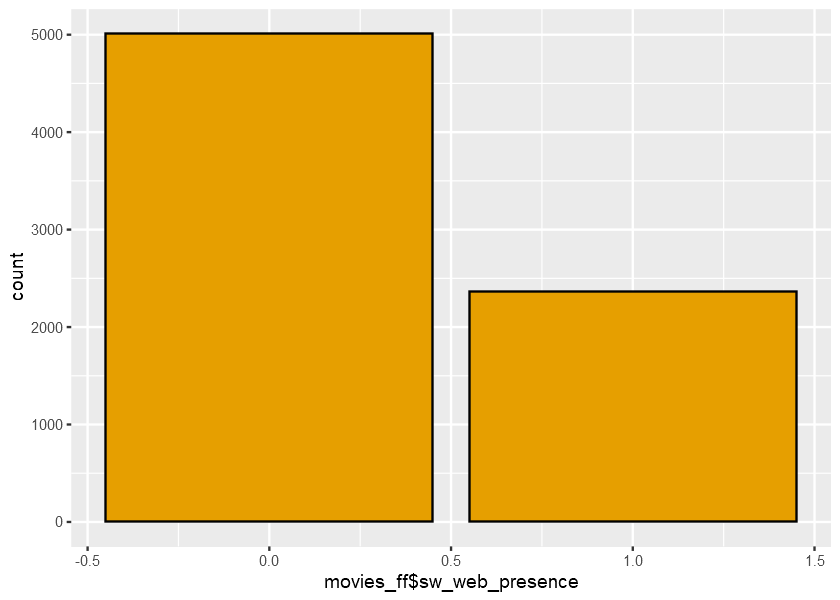

In [71]:
ggplot(df, aes(df$sw_web_presence)) + 
    geom_bar(color = "black", fill = "#E69F00")  + 
    theme_get()
   options(repr.plot.width = 7, repr.plot.height = 5)

### sw_has_poster

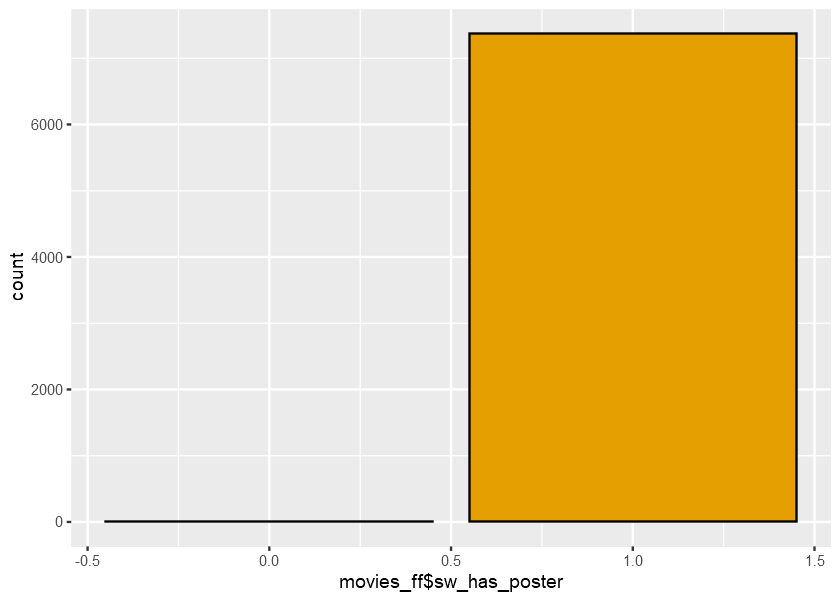

In [46]:
ggplot(df, aes(df$sw_has_poster)) + 
    geom_bar(color = "black", fill = "#E69F00")  + 
    theme_get()
   options(repr.plot.width = 7, repr.plot.height = 5)

### sw_tagline

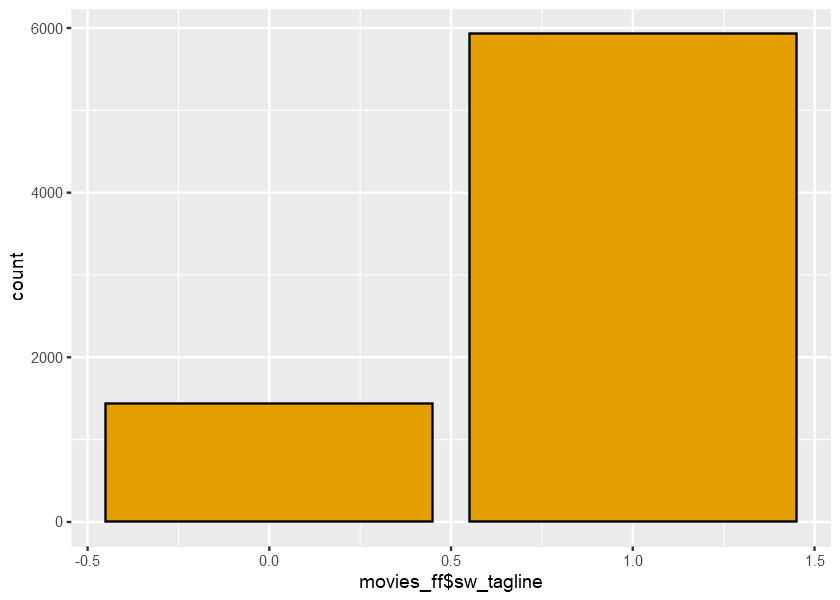

In [48]:
ggplot(df, aes(df$sw_tagline)) + 
    geom_bar(color = "black", fill = "#E69F00")  + 
    theme_get()
   options(repr.plot.width = 7, repr.plot.height = 5)

### Release Date Analysis

Warning message:
"Removed 1 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 1 rows containing non-finite values (stat_density)."


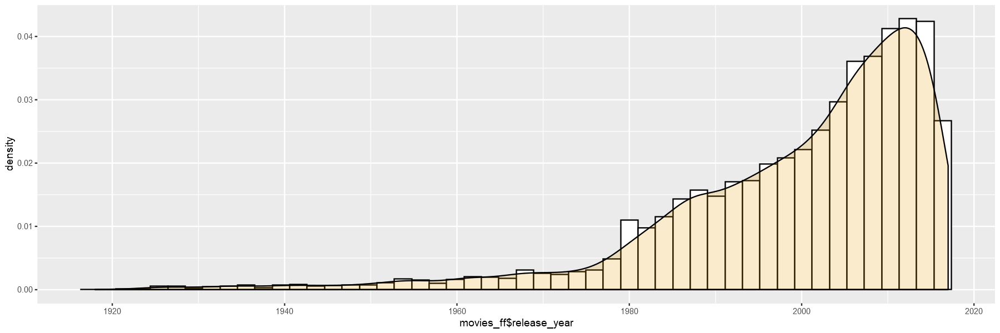

In [77]:
# release_year
ggplot(df, aes(x=df$release_year)) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()
options(repr.plot.width = 15, repr.plot.height = 5)

Warning message:
"Removed 1 rows containing non-finite values (stat_count)."


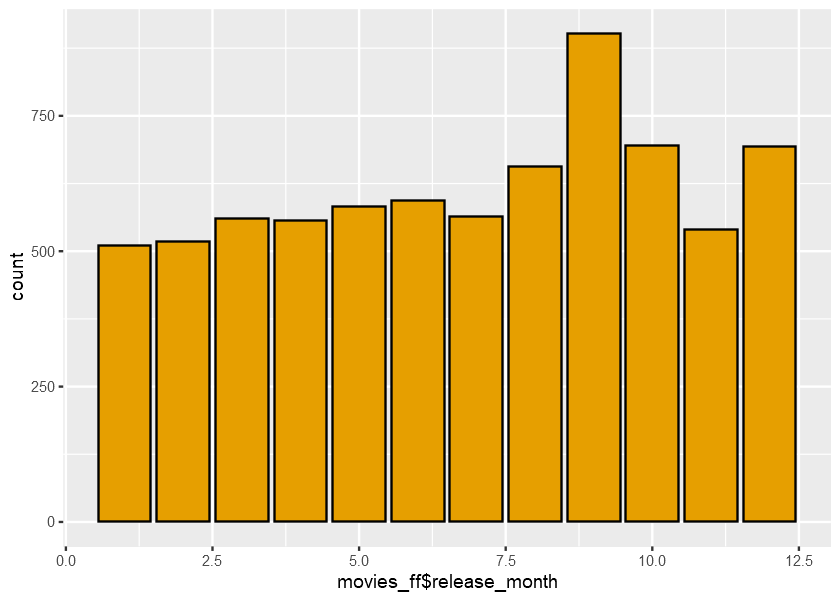

In [78]:
# release_month
ggplot(df, aes(df$release_month)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()+
    geom_hline(yintercept =  mean(df$release_month),na.rm=T,col="red")
   options(repr.plot.width = 7, repr.plot.height = 5)


  1   2   3   4   5   6   7   8   9  10  11  12 
510 518 561 557 582 594 564 657 902 695 540 694 

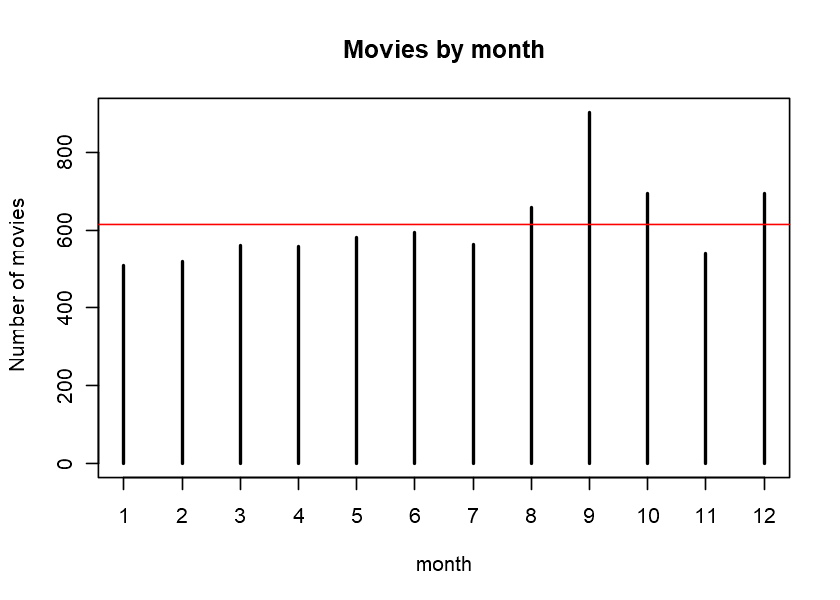

In [89]:
table(df$release_month)
plot(table(df$release_month), ylab="Number of movies",xlab="month",main="Movies by month")
abline(h=mean(table(df$release_month),na.rm = TRUE),col="red")

Warning message:
"Removed 1 rows containing non-finite values (stat_count)."


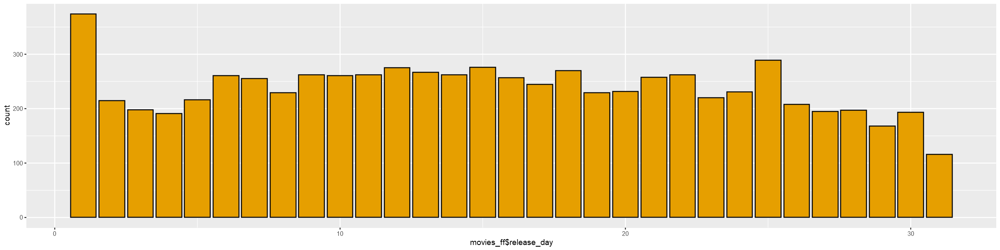

In [104]:
# release_day
ggplot(df, aes(df$release_day)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 20, repr.plot.height = 5)


  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20 
374 215 198 191 216 261 255 229 262 261 262 275 267 262 276 257 245 270 229 232 
 21  22  23  24  25  26  27  28  29  30  31 
258 262 220 231 289 208 195 197 168 193 116 

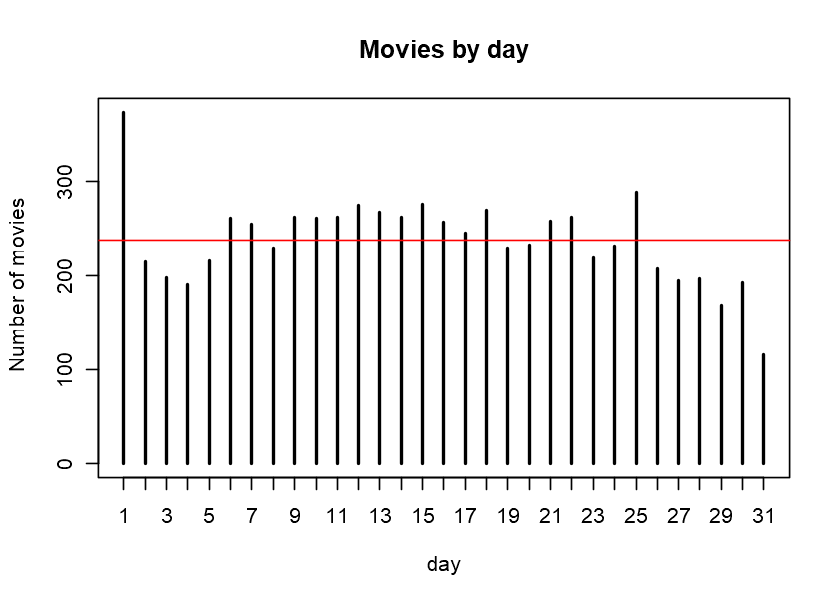

In [91]:
table(df$release_day)
plot(table(df$release_day), ylab="Number of movies",xlab="day",main="Movies by day")
abline(h=mean(table(df$release_day),na.rm = TRUE),col="red")

### Seasonality Analysis

Warning message:
"Removed 1 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 1 rows containing non-finite values (stat_density)."


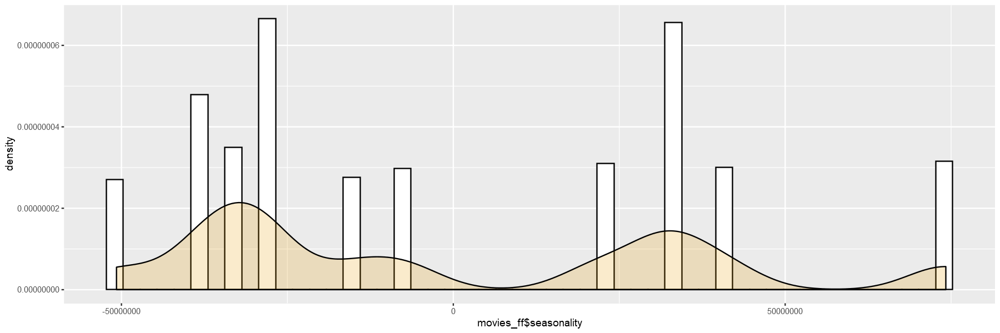

In [138]:
# seasonality
ggplot(df, aes(x=df$seasonality)) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()

In [145]:
movie.time <- df %>% 
    mutate(release_year,release_month) %>%
    group_by(release_year,release_month) %>%
    summarise(n=n(),revenue_mean=mean(revenue,na.rm=T)) %>%
    select(release_year,release_month,n,revenue_mean) %>%
    filter(between(release_year,1985,2016))

movie.time$revenue_mean <- ifelse(is.na(movie.time$revenue_mean),0,movie.time$revenue_mean)

movie.ts <- ts(movie.time$revenue_mean, start = c(1995, 1), end=c(2016,12), frequency = 12)

In [148]:
movie.ts

,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec
1995,7,27233140,20325078,390659,102655171,43092109,35269132,9014279,10609321,5818146,20032287,40555964
1996,0,15377563,43077666,5239644,102281980,34245468,45464460,19927038,750000,46838412,36949300,35539822
1997,3200000,9518342,47771934,46682407,4738953,89026107,28382331,31309195,88981269,13119518,11294901,55617613
1998,5943231,26998319,22785921,12120007,142984274,127698510,11404671,10552278,2252640,14481664,30978712,76231706
1999,12404204,31613134,15869677,35859929,237182311,134387126,80806356,5422857,39485040,85983742,139434862,31589510
2000,17030246,15090574,1305887,15774500,66171445,120099325,505000000,40747115,2244231,42088087,172364257,43665526
2001,6853159,47364375,65595485,14306524,34356941,207845079,30102717,7332090,11078252,707701,198461,2358239
2002,21621000,0,128423253,35869301,41940207,229025794,31823577,15394379,24993547,11864944,114758510,107764097
2003,5491903,83964186,9656091,9730837,46769121,203906638,80976750,9459298,24768048,40119046,40093966,33268915
2004,1653565,31836719,91361221,11733804,6918587,406287050,184127456,0,18346899,8112656,60912004,59239151


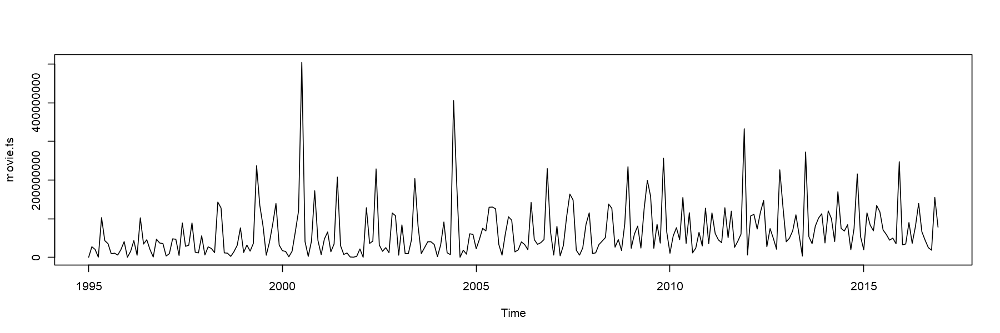

In [150]:
plot(movie.ts)

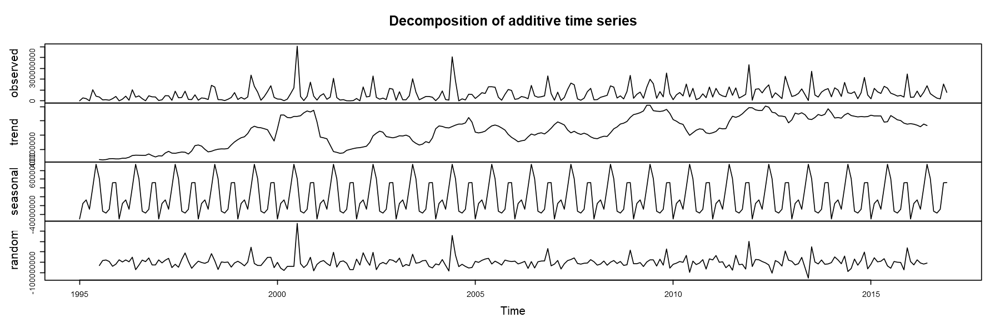

In [152]:
plot(decompose(movie.ts))

In [159]:
movie.dec <- decompose(movie.ts)
head(movie.dec$seasonal)
montly_trend <- data.frame(month=c(1:12),season=movie.dec$seasonal[1:12]) # season=movie.dec$seasonal[1:12]) ts is matrix since we want only the first line we take the first 12 varibles 
montly_trend

[1] -50832969 -15414392  -7254937 -28510946  21652661  74099998

month,season
<int>,<dbl>
1,-50832969
2,-15414392
3,-7254937
4,-28510946
5,21652661
6,74099998
7,41133257
8,-33067831
9,-37243111


### sw_collection

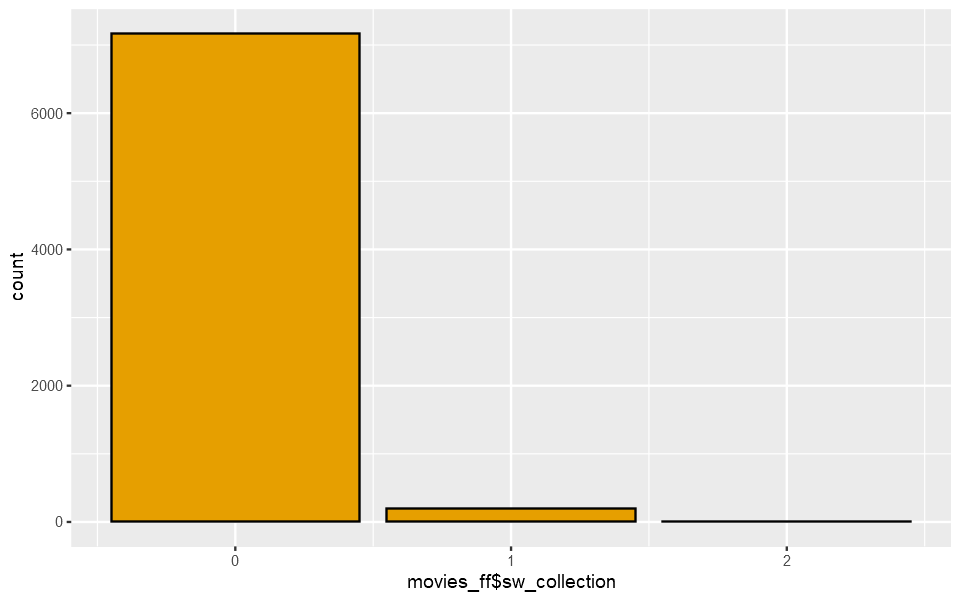

In [122]:
ggplot(df, aes(df$sw_collection)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### producers_cnt Analysis

Warning message:
"Removed 395 rows containing non-finite values (stat_count)."
Warning message:
"Removed 395 rows containing missing values (geom_point)."


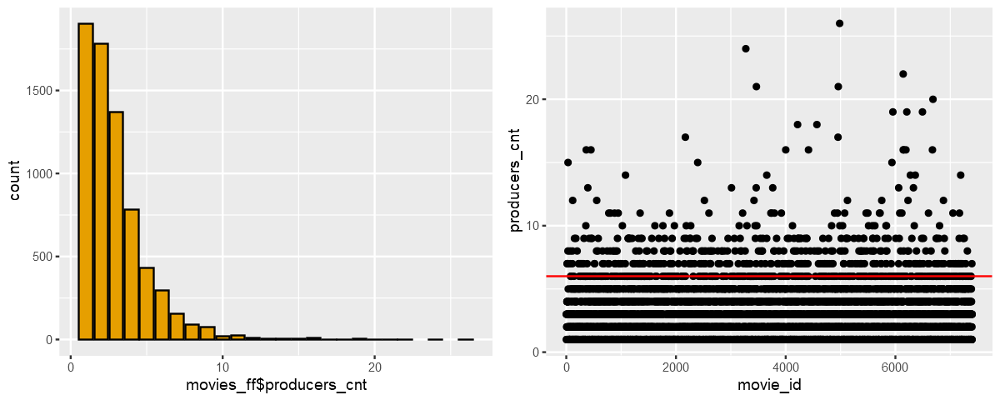

In [15]:
p1 <- ggplot(df, aes(df$producers_cnt)) + geom_bar(color = "black", fill = "#E69F00")  + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=producers_cnt)) + geom_hline(yintercept = 6 ,color="red")
   
options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

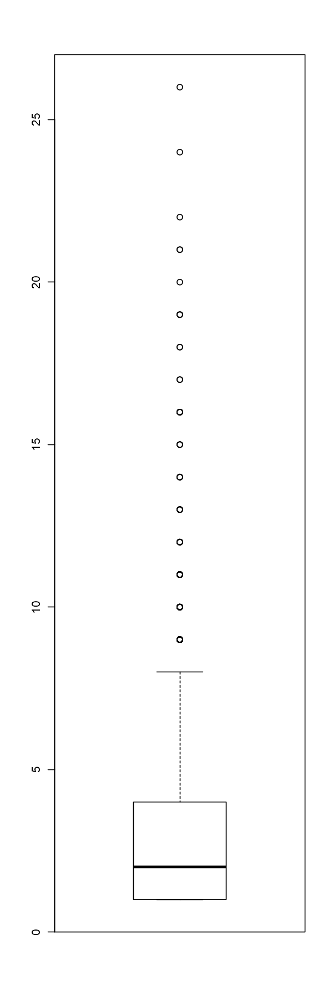

In [31]:
out_producers_cnt <- boxplot(df$producers_cnt)
options(repr.plot.width = 5, repr.plot.height = 5)

In [32]:
head(out_producers_cnt$out) # outlier
min(out_producers_cnt$out) #  minimum outlier
max(out_producers_cnt$out) #  maximum outlier
median(out_producers_cnt$out)
mean(out_producers_cnt$out)
length(out_producers_cnt$out)

[1] 15 12  9  9  9 10

[1] 9

[1] 26

[1] 10

[1] 11.21472

[1] 163

### countries_cnt Analysis

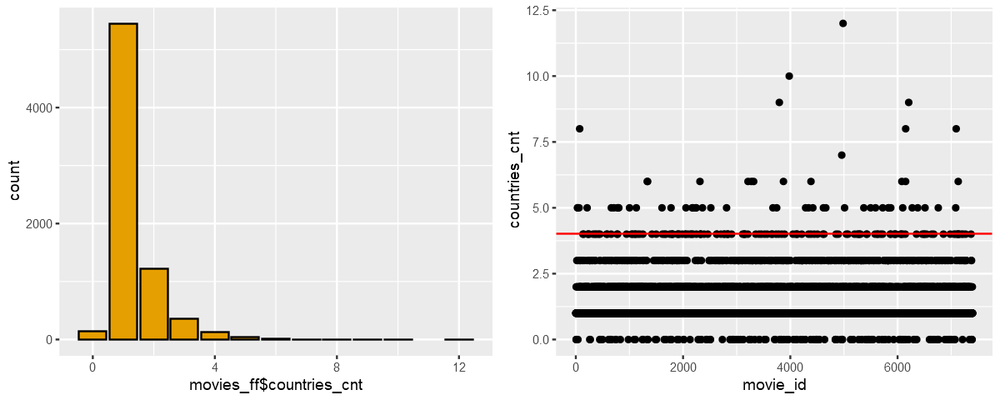

In [16]:
p1 <- ggplot(df, aes(df$countries_cnt)) + geom_bar(color = "black", fill = "#E69F00")  + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=countries_cnt)) + geom_hline(yintercept = 4 ,color="red")
   
options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

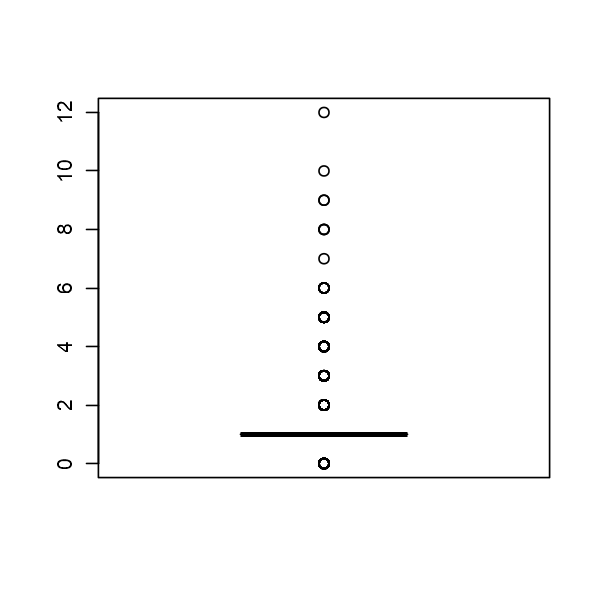

In [36]:
out_countries_cnt <- boxplot(df$countries_cnt)
options(repr.plot.width = 8, repr.plot.height = 20)

In [37]:
head(out_countries_cnt$out) # outlier head list
min(out_countries_cnt$out) #  minimum outlier
max(out_countries_cnt$out) #  maximum outlier
median(out_countries_cnt$out)
mean(out_countries_cnt$out)
length(out_countries_cnt$out)

[1] 0 2 0 3 2 2

[1] 0

[1] 12

[1] 2

[1] 2.284971

[1] 1923

### lang_US

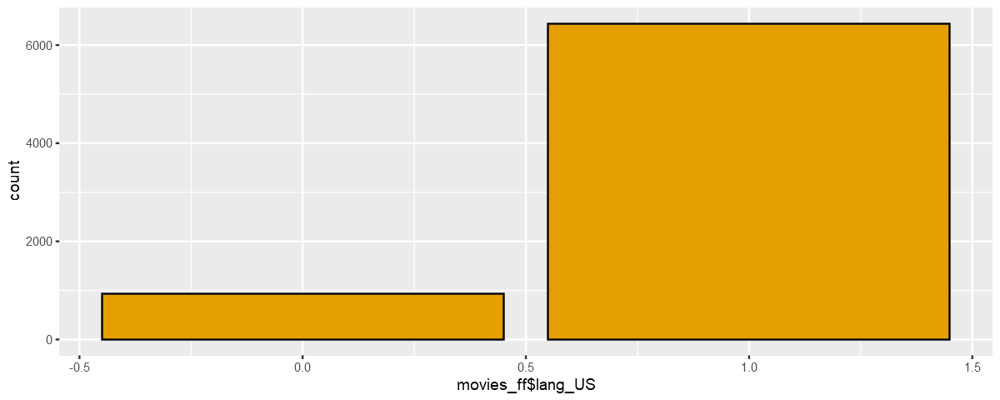

In [17]:
ggplot(df, aes(df$lang_US)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### lang_FR

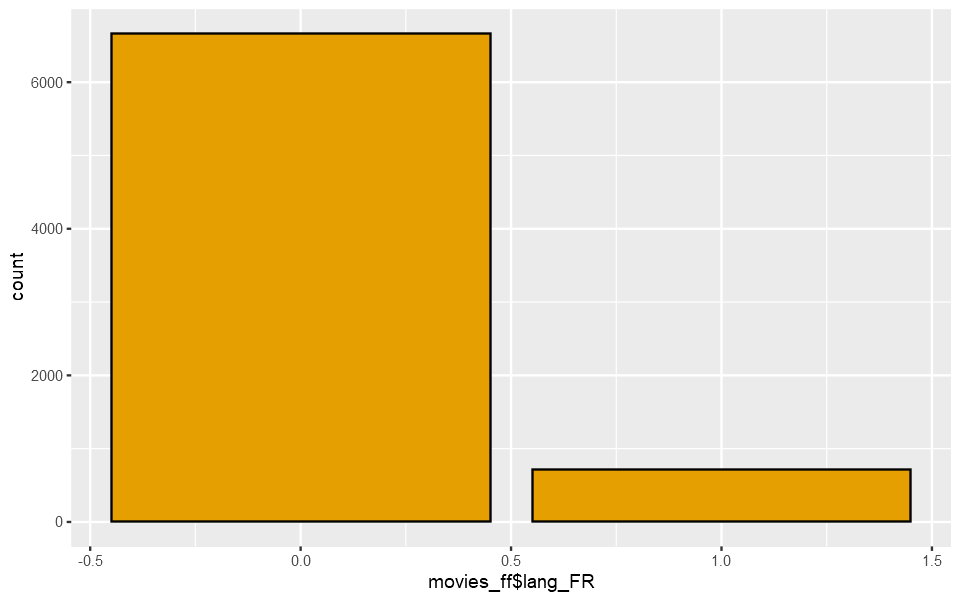

In [138]:
ggplot(df, aes(df$lang_FR)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### lang_RU

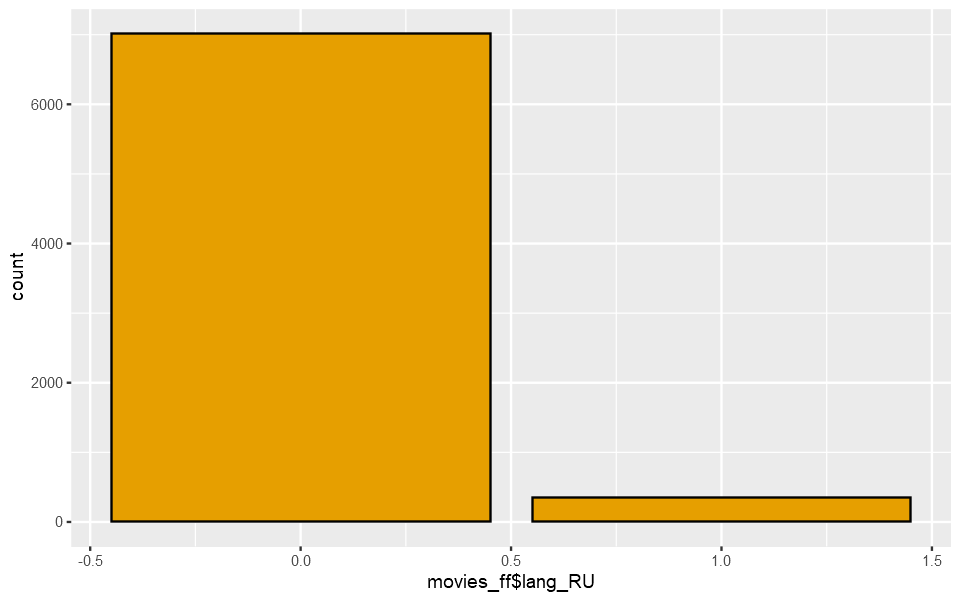

In [140]:
ggplot(df, aes(df$lang_RU)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### lang_ES

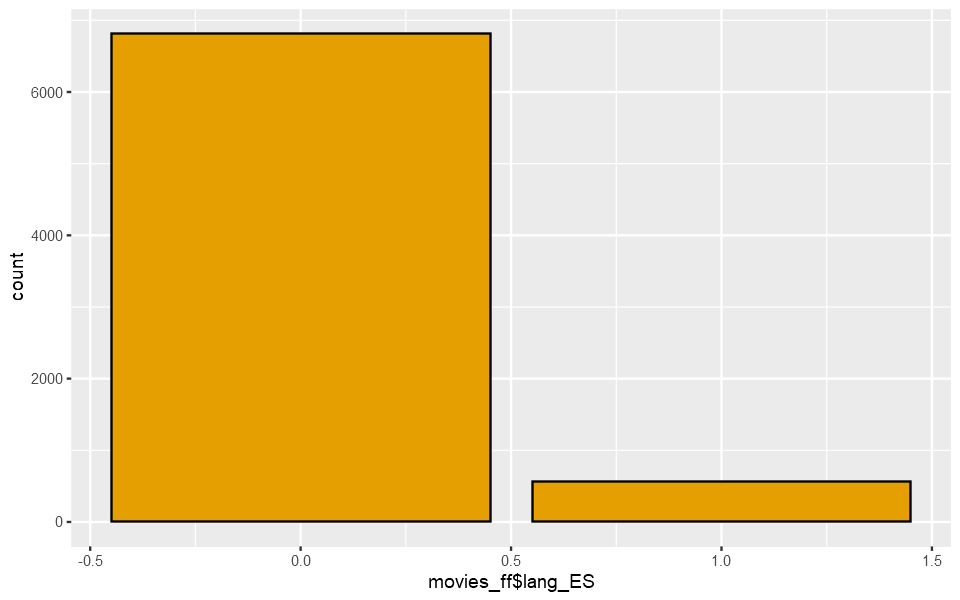

In [142]:
ggplot(df, aes(df$lang_ES)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### lang_JA

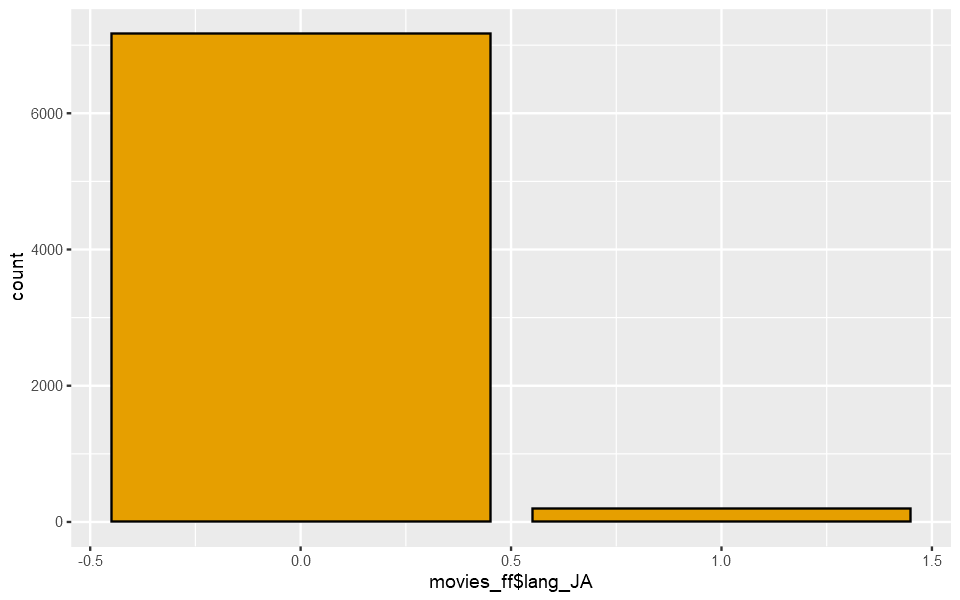

In [144]:
ggplot(df, aes(df$lang_JA)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### keyword_cnt Analysis

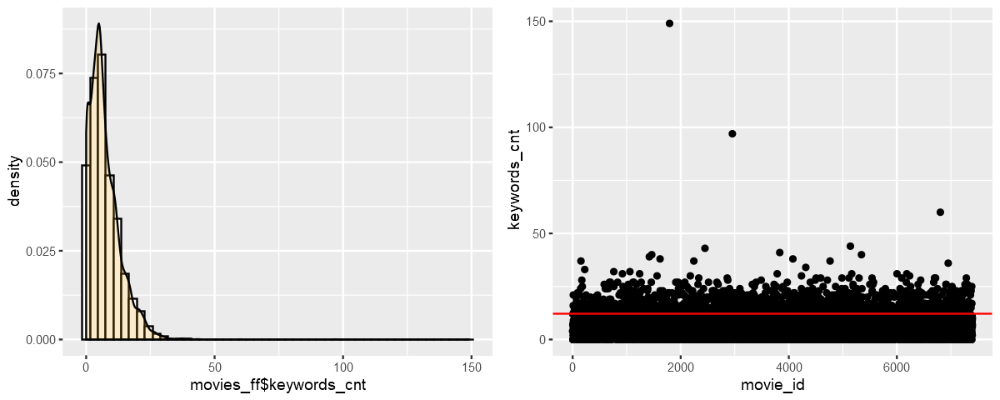

In [19]:
p1 <- ggplot(df, aes(x=df$keywords_cnt)) + geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
      geom_density(alpha=0.2, fill="#E69F00") + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=keywords_cnt)) + geom_hline(yintercept = 12 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

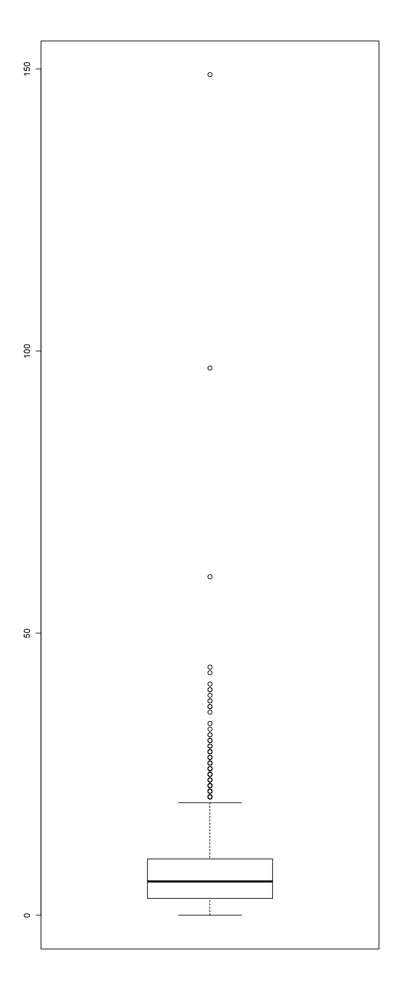

In [43]:
out_keywords_cnt <- boxplot(df$keywords_cnt) 
options(repr.plot.width = 5, repr.plot.height = 5)

In [44]:
head(out_keywords_cnt$out)
min(out_keywords_cnt$out)
max(out_keywords_cnt$out)
median(out_keywords_cnt$out)
mean(out_keywords_cnt$out)
length(out_keywords_cnt$out)

[1] 21 22 22 21 24 37

[1] 21

[1] 149

[1] 23

[1] 25.33453

[1] 278

### actor0_movies_cnt Analysis

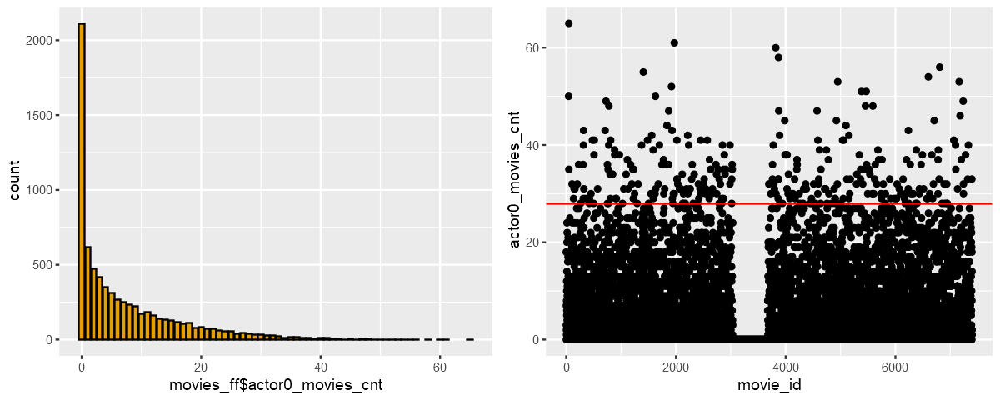

In [20]:
p1 <- ggplot(df, aes(df$actor0_movies_cnt)) + geom_bar(color = "black", fill = "#E69F00")  + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=actor0_movies_cnt)) + geom_hline(yintercept = 28 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

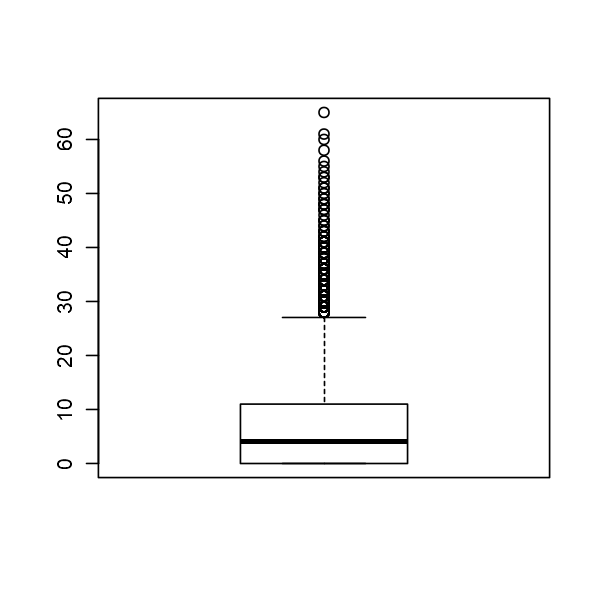

In [48]:
out_actor0_movies_cnt <- boxplot(df$actor0_movies_cnt) 
options(repr.plot.width = 5, repr.plot.height = 5)

In [49]:
head(out_actor0_movies_cnt$out)
min(out_actor0_movies_cnt$out)
max(out_actor0_movies_cnt$out)
median(out_actor0_movies_cnt$out)
mean(out_actor0_movies_cnt$out)
length(out_actor0_movies_cnt$out)

[1] 50 65 35 32 29 31

[1] 28

[1] 65

[1] 32

[1] 34.49346

[1] 306

### actor0_movies_5y_cnt Analysis

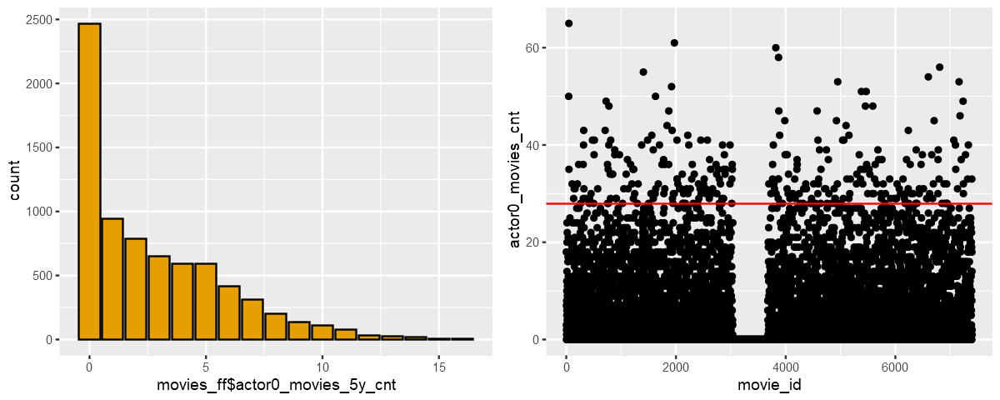

In [21]:
p1 <- ggplot(df, aes(df$actor0_movies_5y_cnt)) + geom_bar(color = "black", fill = "#E69F00")  + theme_get()
P2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=actor0_movies_5y_cnt)) + geom_hline(yintercept = 13 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

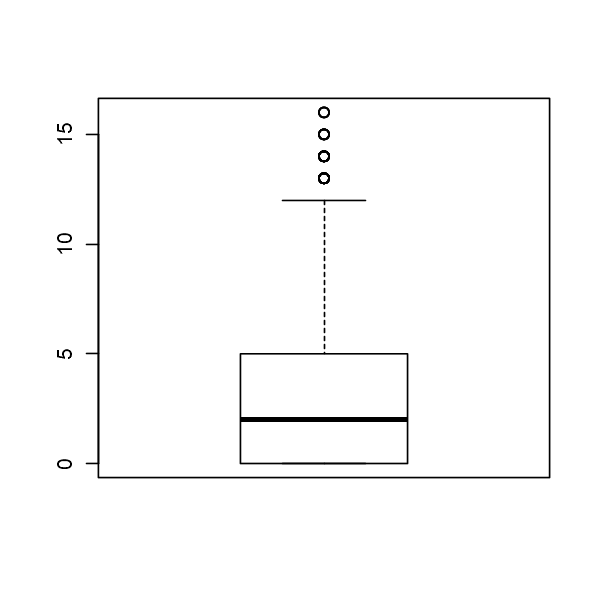

In [53]:
out_actor0_movies_5y_cnt <- boxplot(df$actor0_movies_5y_cnt) 
options(repr.plot.width = 5, repr.plot.height = 5)

In [54]:
head(out_actor0_movies_5y_cnt$out)
min(out_actor0_movies_5y_cnt$out)
max(out_actor0_movies_5y_cnt$out)
median(out_actor0_movies_5y_cnt$out)
mean(out_actor0_movies_5y_cnt$out)
length(out_actor0_movies_5y_cnt$out)

[1] 14 14 13 13 15 13

[1] 13

[1] 16

[1] 14

[1] 13.82692

[1] 52

### actor1_movies_cnt Analysis

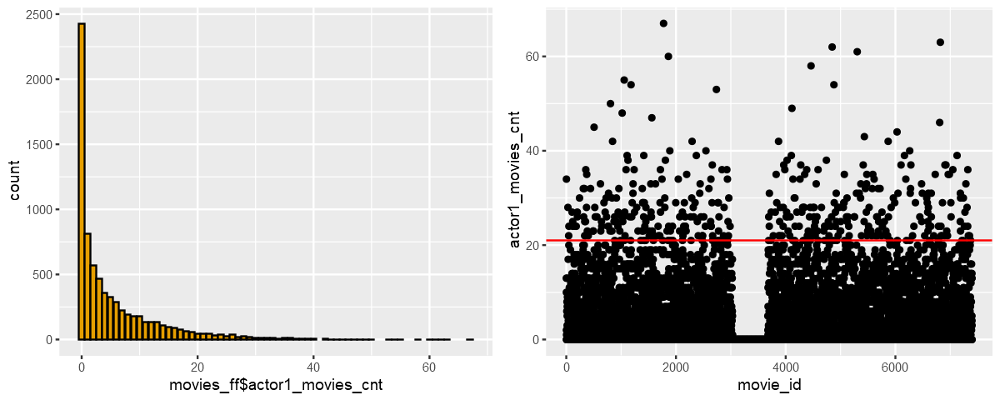

In [22]:
p1 <- ggplot(df, aes(df$actor1_movies_cnt)) + geom_bar(color = "black", fill = "#E69F00")  + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=actor1_movies_cnt)) + geom_hline(yintercept = 21 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

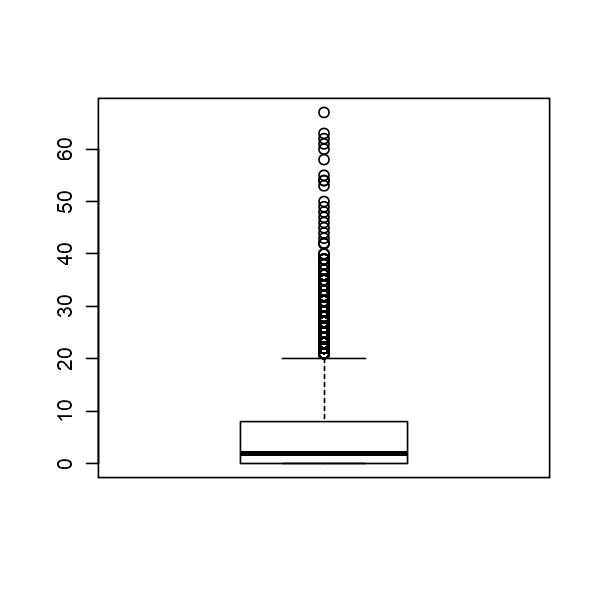

In [57]:
out_actor1_movies_cnt <- boxplot(df$actor1_movies_cnt) 
options(repr.plot.width = 5, repr.plot.height = 5)

In [58]:
head(out_actor1_movies_cnt$out)
min(out_actor1_movies_cnt$out)
max(out_actor1_movies_cnt$out)
median(out_actor1_movies_cnt$out)
mean(out_actor1_movies_cnt$out)
length(out_actor1_movies_cnt$out)

[1] 34 28 22 24 27 24

[1] 21

[1] 67

[1] 26

[1] 28.09002

[1] 411

### actor1_movies_5y_cnt

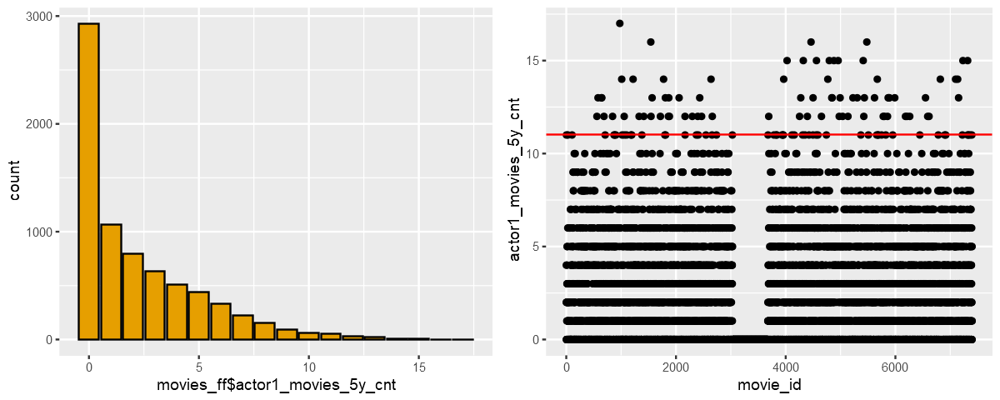

In [23]:
p1 <- ggplot(df, aes(df$actor1_movies_5y_cnt)) + geom_bar(color = "black", fill = "#E69F00")  + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=actor1_movies_5y_cnt)) + geom_hline(yintercept = 11 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

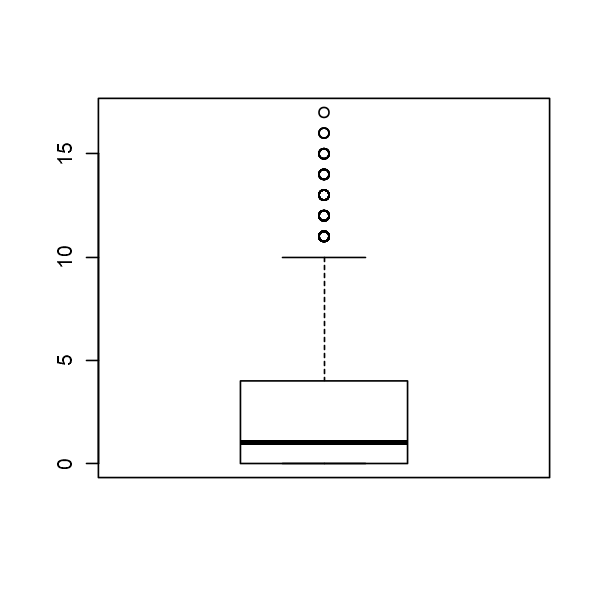

In [61]:
out_actor1_movies_5y_cnt <- boxplot(df$actor1_movies_5y_cnt) 

In [74]:
head(out_actor1_movies_5y_cnt$out)
min(out_actor1_movies_5y_cnt$out)
max(out_actor1_movies_5y_cnt$out)
median(out_actor1_movies_5y_cnt$out)
mean(out_actor1_movies_5y_cnt$out)
length(out_actor1_movies_5y_cnt$out)

[1] 11 11 11 12 13 13

[1] 11

[1] 17

[1] 12

[1] 12.24242

[1] 132

### actor2_movies_cnt

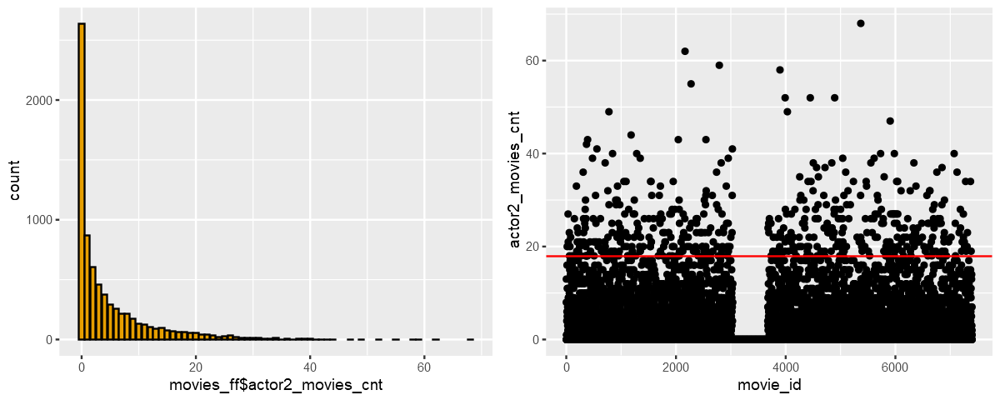

In [24]:
p1 <- ggplot(df, aes(df$actor2_movies_cnt)) + geom_bar(color = "black", fill = "#E69F00")  + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=actor2_movies_cnt)) + geom_hline(yintercept = 18 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

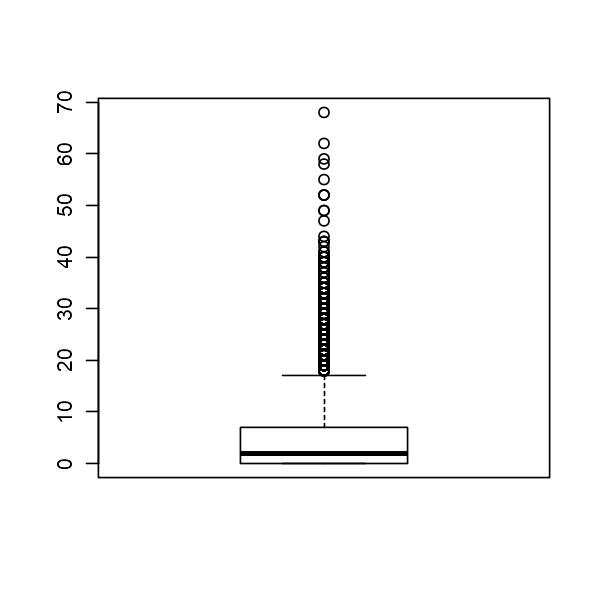

In [64]:
out_actor2_movies_cnt <- boxplot(df$actor2_movies_cnt) 

In [72]:
head(out_actor2_movies_cnt$out)
min(out_actor2_movies_cnt$out)
max(out_actor2_movies_cnt$out)
median(out_actor2_movies_cnt$out)
mean(out_actor2_movies_cnt$out)
length(out_actor2_movies_cnt$out)

[1] 20 27 21 23 18 20

[1] 18

[1] 68

[1] 23

[1] 24.87377

[1] 507

### actor2_movies_5y_cnt Analysis

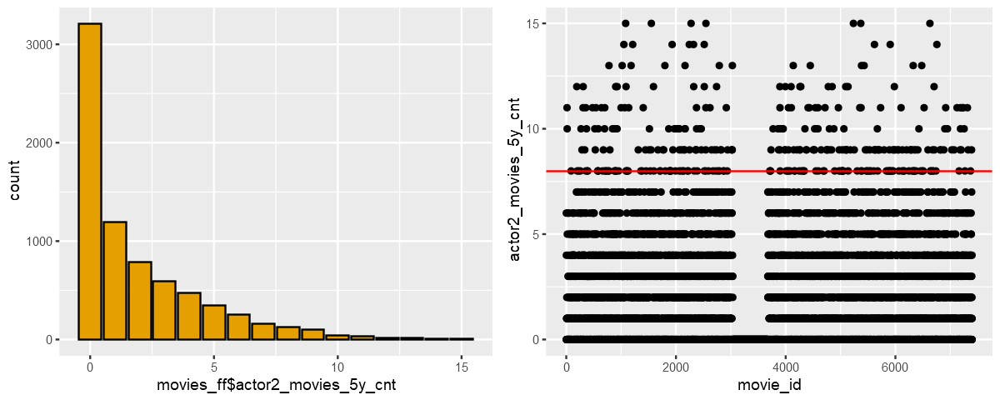

In [26]:
p1 <- ggplot(df, aes(df$actor2_movies_5y_cnt)) + geom_bar(color = "black", fill = "#E69F00")  + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=actor2_movies_5y_cnt)) + geom_hline(yintercept = 8 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

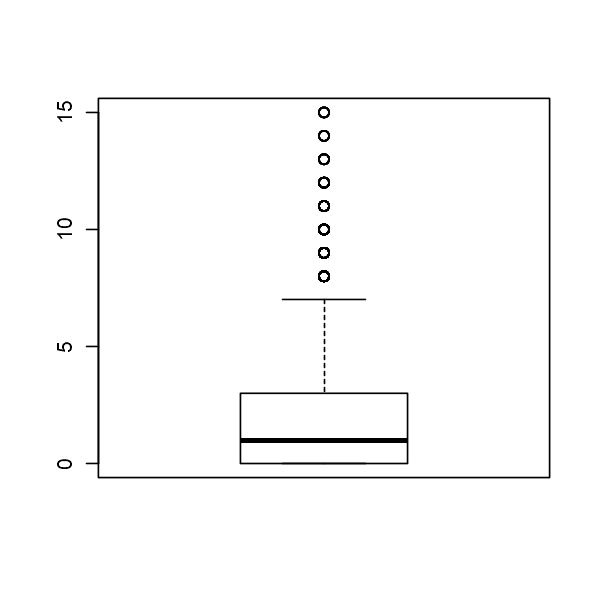

In [67]:
out_actor2_movies_5y_cnt <- boxplot(df$actor2_movies_5y_cnt) 

In [70]:
head(out_actor2_movies_5y_cnt$out)
min(out_actor2_movies_5y_cnt$out)
max(out_actor2_movies_5y_cnt$out)
median(out_actor2_movies_5y_cnt$out)
mean(out_actor2_movies_5y_cnt$out)
length(out_actor2_movies_5y_cnt$out)

[1] 11 10  8 12  8  8

[1] 8

[1] 15

[1] 9

[1] 9.530435

[1] 345

### sw_female_actor0

Warning message:
"Removed 934 rows containing non-finite values (stat_count)."


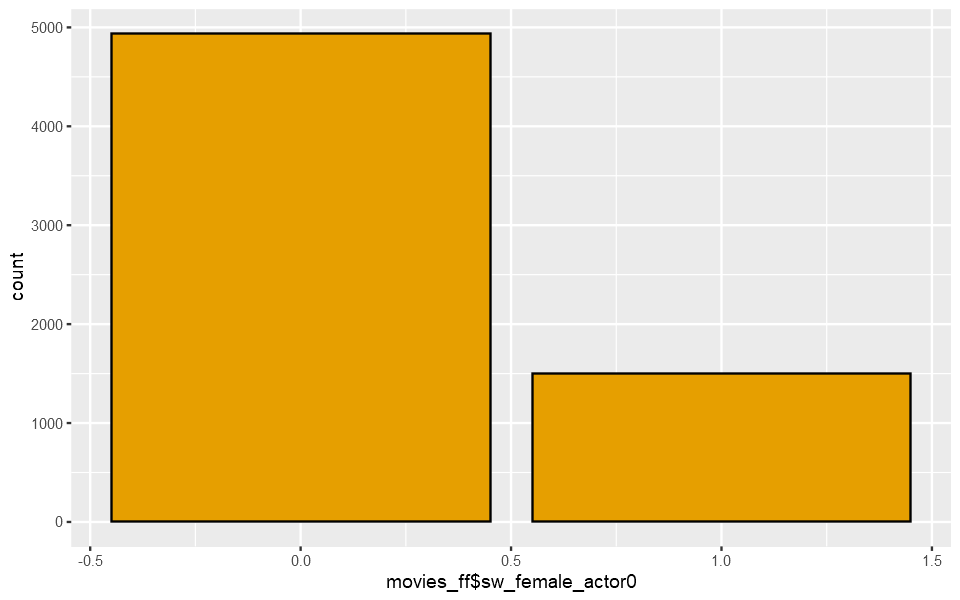

In [166]:
ggplot(df, aes(df$sw_female_actor0)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### sw_female_actor1

Warning message:
"Removed 782 rows containing non-finite values (stat_count)."


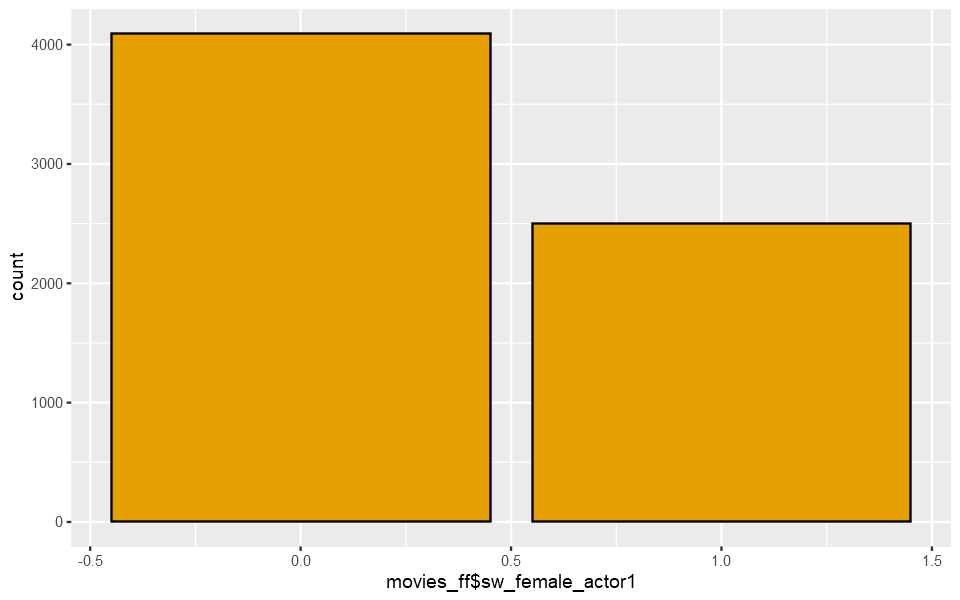

In [167]:
ggplot(df, aes(df$sw_female_actor1)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### sw_female_actor2

Warning message:
"Removed 788 rows containing non-finite values (stat_count)."


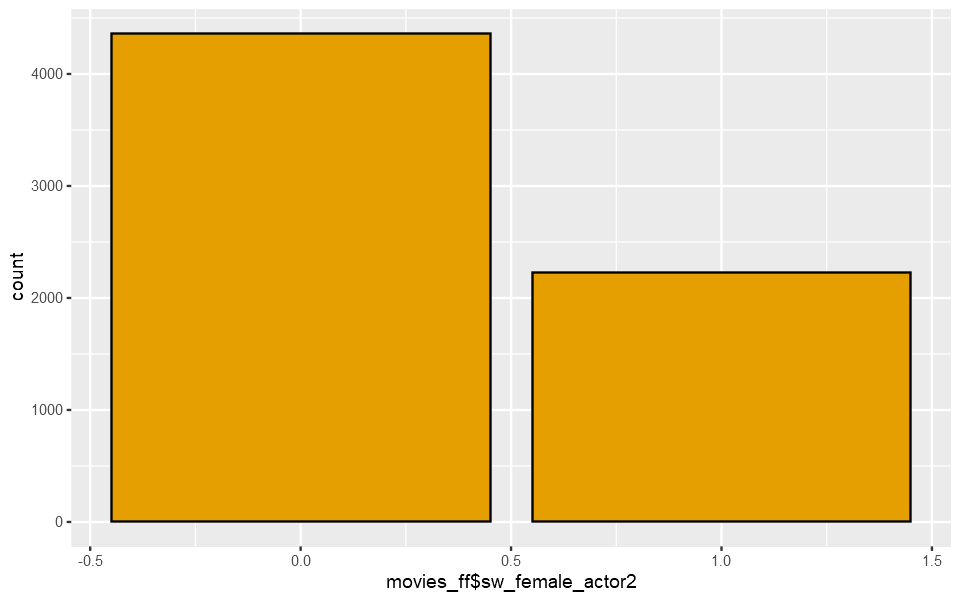

In [168]:
ggplot(df, aes(df$sw_female_actor2)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### sw_male_actor0

Warning message:
"Removed 934 rows containing non-finite values (stat_count)."


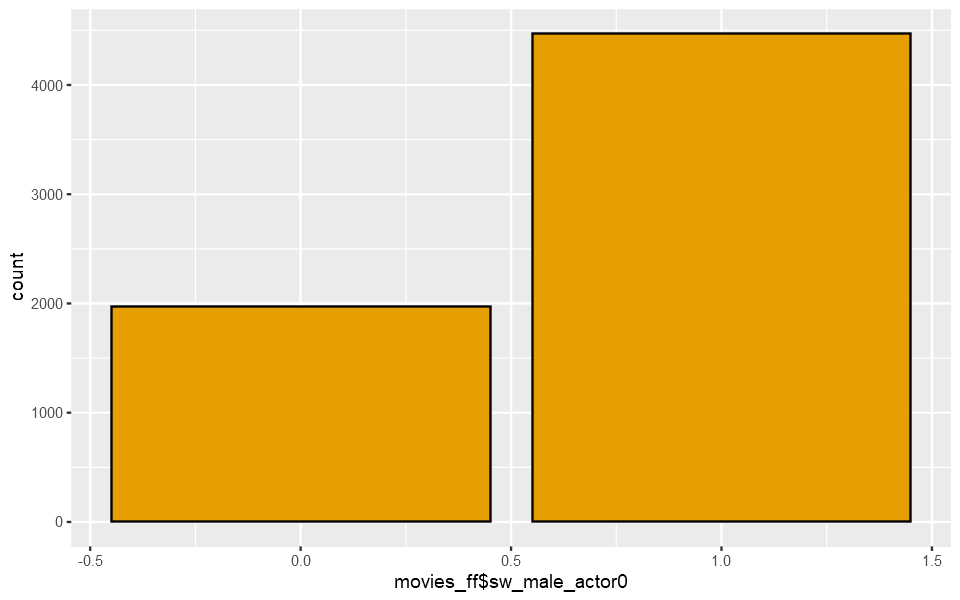

In [169]:
ggplot(df, aes(df$sw_male_actor0)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### sw_male_actor1

Warning message:
"Removed 782 rows containing non-finite values (stat_count)."


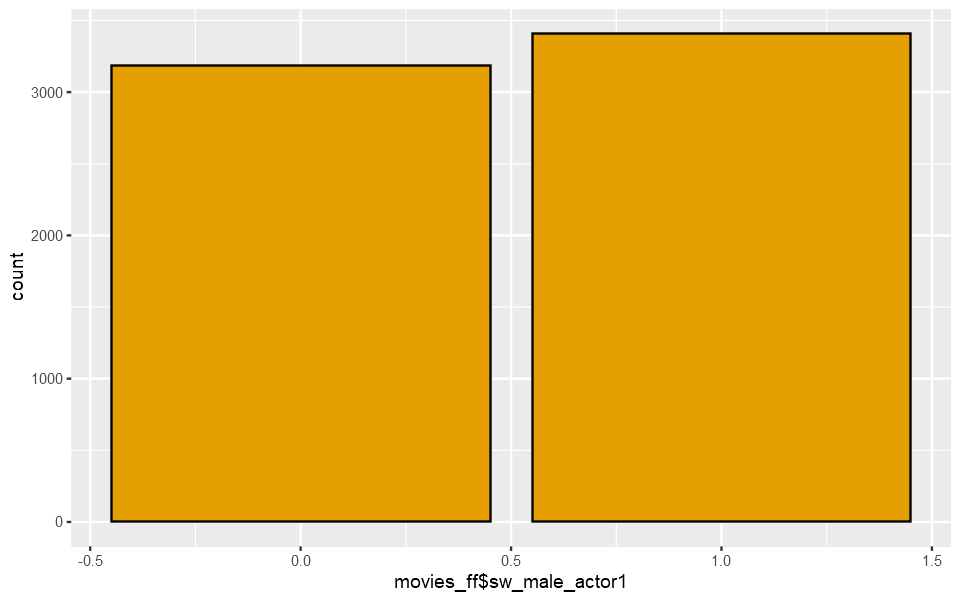

In [171]:
ggplot(df, aes(df$sw_male_actor1)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### sw_male_actor2

Warning message:
"Removed 788 rows containing non-finite values (stat_count)."


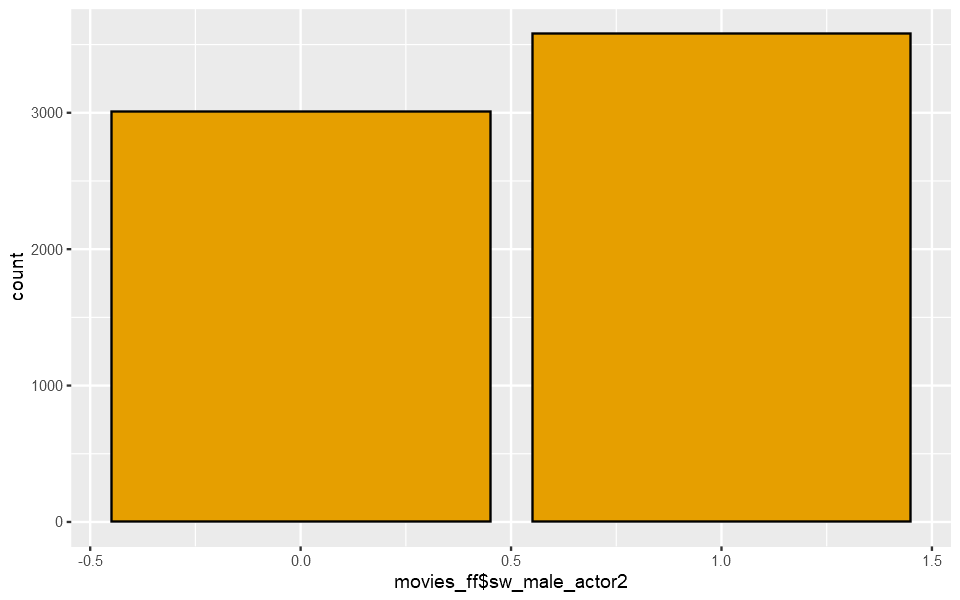

In [172]:
ggplot(df, aes(df$sw_male_actor2)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### # actor0_prev_revenue Analysis

Warning message:
"Removed 2752 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 2752 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2752 rows containing missing values (geom_point)."


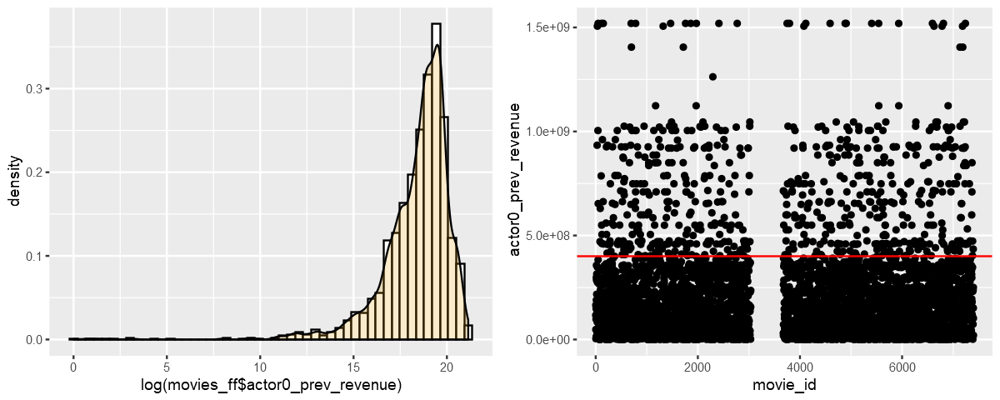

In [27]:
p1 <- ggplot(df, aes(x=log(df$actor0_prev_revenue))) + 
      geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
      geom_density(alpha=0.2, fill="#E69F00") + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=actor0_prev_revenue)) + 
      geom_hline(yintercept = 400000000 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


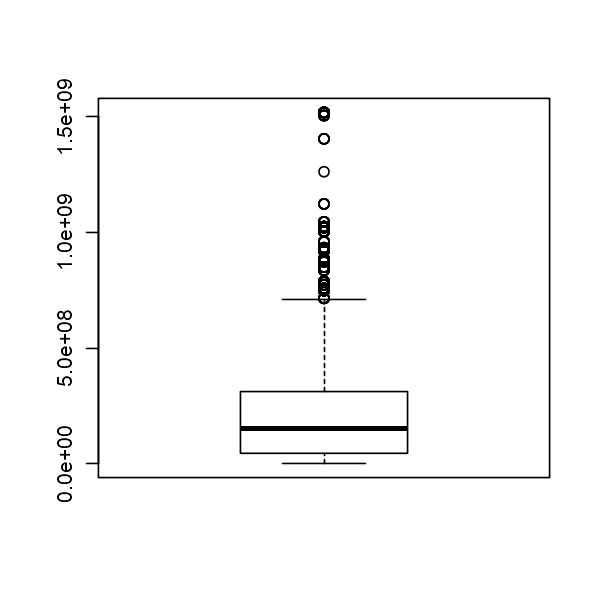

In [70]:
out_actor0_prev_revenue <- boxplot(df$actor0_prev_revenue) 

In [68]:
head(out_actor0_prev_revenue$out)
min(out_actor0_prev_revenue$out)
max(out_actor0_prev_revenue$out)
median(out_actor0_prev_revenue$out)
mean(out_actor0_prev_revenue$out)
length(out_actor0_prev_revenue$out)

[1]  933959197 1506249360 1004558444 1519557910  786636033 1519557910

[1] 714766572

[1] 1519557910

[1] 926287400

[1] 970535871

[1] 281

### actor1_prev_revenue Analysis

Warning message:
"Removed 3201 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 3201 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3201 rows containing missing values (geom_point)."


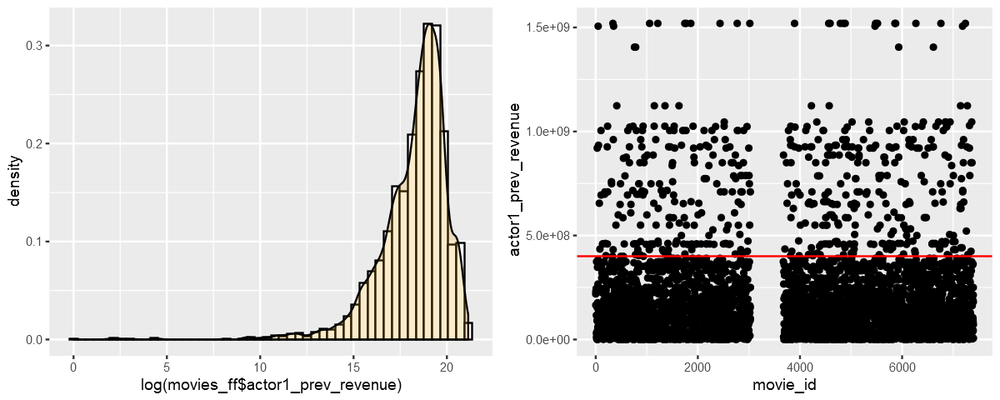

In [28]:
p1 <- ggplot(df, aes(x=log(df$actor1_prev_revenue))) + 
      geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
      geom_density(alpha=0.2, fill="#E69F00") + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=actor1_prev_revenue)) + 
      geom_hline(yintercept = 400000000 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


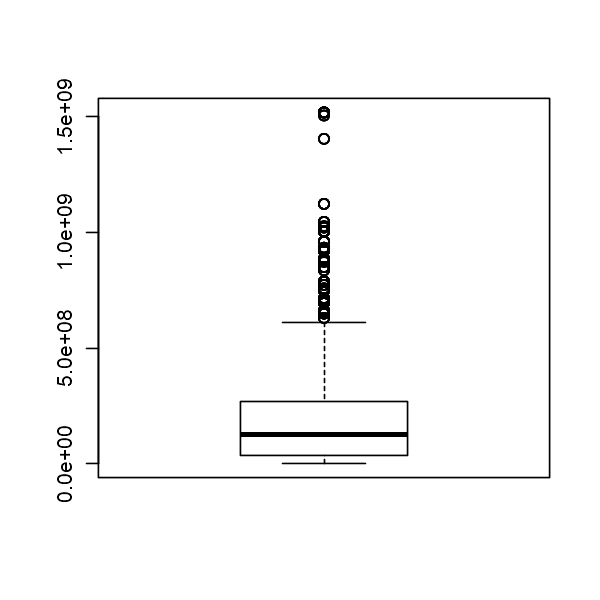

In [73]:
out_actor1_prev_revenue <- boxplot(df$actor1_prev_revenue) 

In [66]:
head(out_actor1_prev_revenue$out)
min(out_actor1_prev_revenue$out)
max(out_actor1_prev_revenue$out)
median(out_actor1_prev_revenue$out)
mean(out_actor1_prev_revenue$out)
length(out_actor1_prev_revenue$out)

[1]  920100000 1506249360  933959197  655011224 1004558444  694713380

[1] 630161890

[1] 1519557910

[1] 886686817

[1] 913759883

[1] 326

### actor2_prev_revenue

Warning message:
"Removed 3423 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 3423 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3423 rows containing missing values (geom_point)."


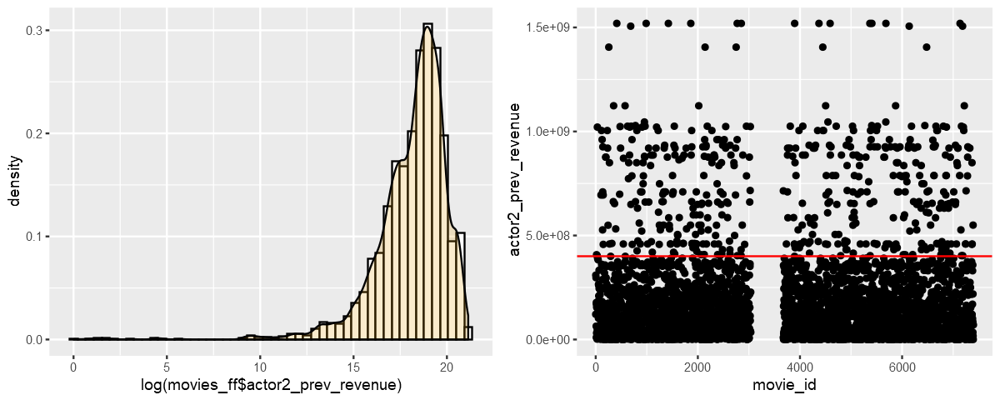

In [29]:
p1 <- ggplot(df, aes(x=log(df$actor2_prev_revenue))) + 
      geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
      geom_density(alpha=0.2, fill="#E69F00") + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=actor2_prev_revenue)) + 
      geom_hline(yintercept = 400000000 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


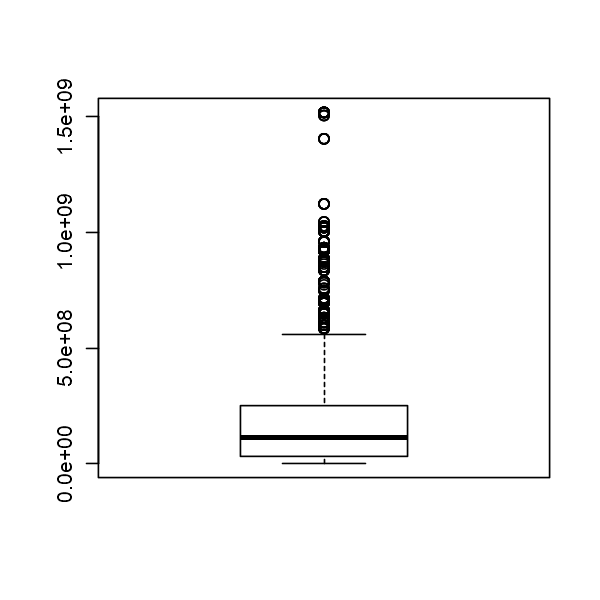

In [76]:
out_actor2_prev_revenue <- boxplot(df$actor2_prev_revenue) 

In [64]:
head(out_actor2_prev_revenue$out)
min(out_actor2_prev_revenue$out)
max(out_actor2_prev_revenue$out)
median(out_actor2_prev_revenue$out)
mean(out_actor2_prev_revenue$out)
length(out_actor2_prev_revenue$out)

[1] 1021103568  694713380 1004558444  961000000  709827462  926287400

[1] 585349010

[1] 1519557910

[1] 876688482

[1] 873059048

[1] 331

### director_movies_cnt Analysis

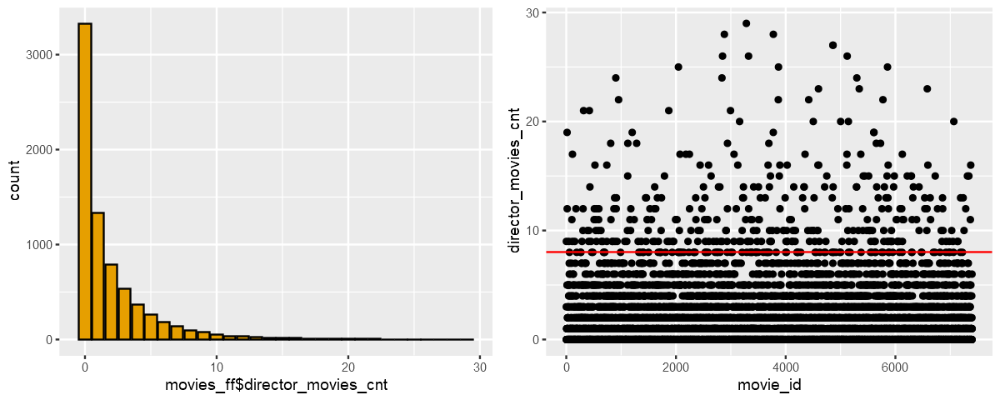

In [31]:
p1 <- ggplot(df, aes(df$director_movies_cnt)) + geom_bar(color = "black", fill = "#E69F00")  + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=director_movies_cnt)) + geom_hline(yintercept = 8 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

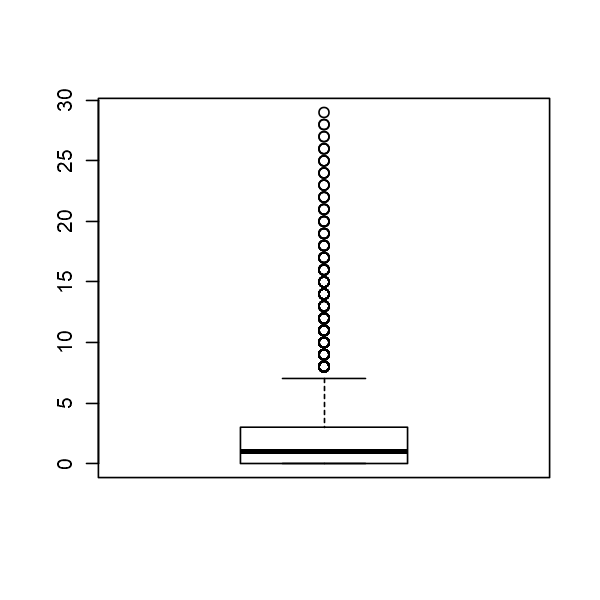

In [79]:
out_director_movies_cnt <- boxplot(df$director_movies_cnt) 

In [62]:
head(out_director_movies_cnt$out)
min(out_director_movies_cnt$out)
max(out_director_movies_cnt$out)
median(out_director_movies_cnt$out)
mean(out_director_movies_cnt$out)
length(out_director_movies_cnt$out)

[1]  9 19 12  9  8 11

[1] 8

[1] 29

[1] 10

[1] 11.6815

[1] 427

### director_movies_5y_cnt Analysis

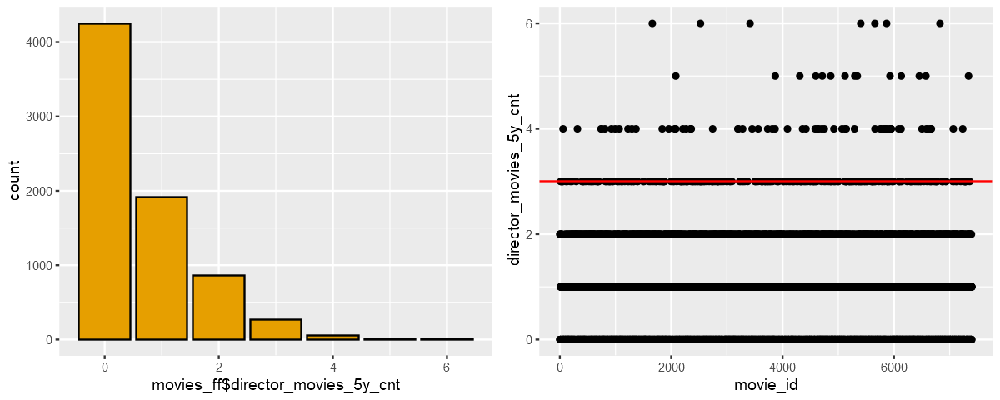

In [32]:
p1 <- ggplot(df, aes(df$director_movies_5y_cnt)) + geom_bar(color = "black", fill = "#E69F00")  + theme_get()
p2 <- ggplot(data=df) + geom_point(aes(x=movie_id, y=director_movies_5y_cnt)) + geom_hline(yintercept = 3 ,color="red")

options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

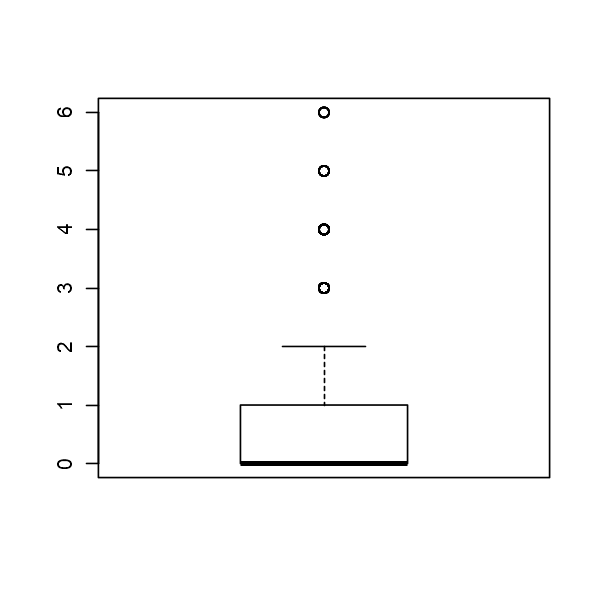

In [82]:
out_director_movies_5y_cnt <- boxplot(df$director_movies_5y_cnt) 

In [60]:
head(out_director_movies_5y_cnt$out)
min(out_director_movies_5y_cnt$out)
max(out_director_movies_5y_cnt$out)
median(out_director_movies_5y_cnt$out)
mean(out_director_movies_5y_cnt$out)
length(out_director_movies_5y_cnt$out)

[1] 3 3 3 3 3 4

[1] 3

[1] 6

[1] 3

[1] 3.314286

[1] 350

### Ganres

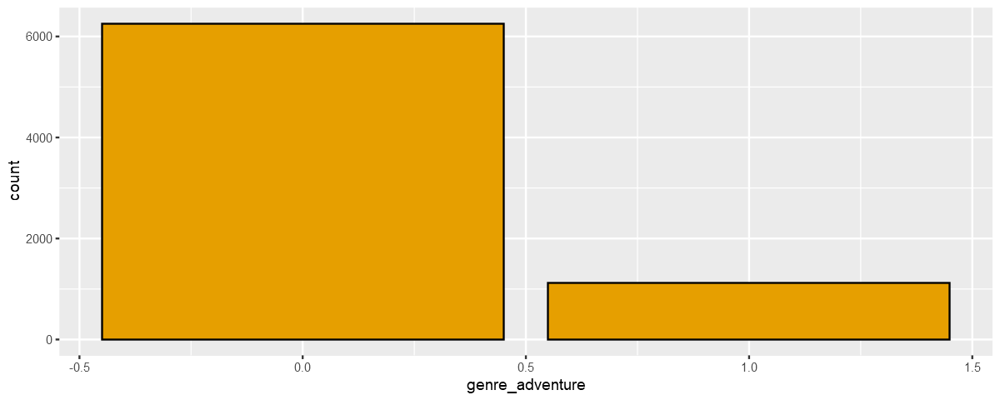

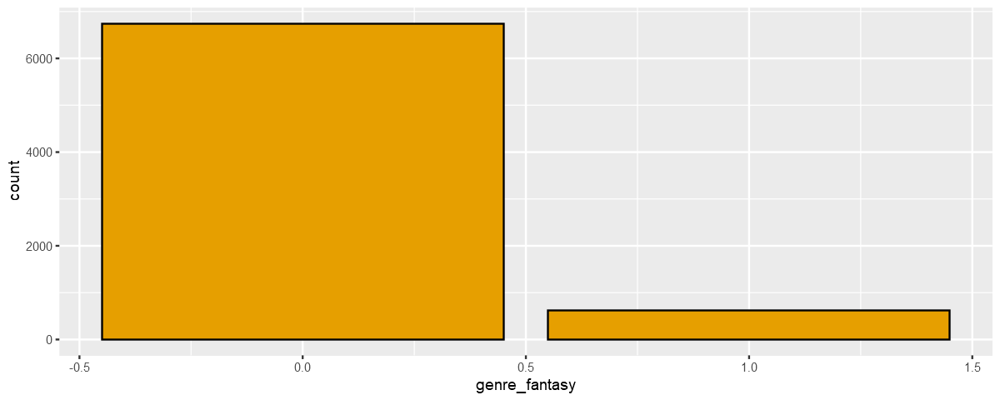

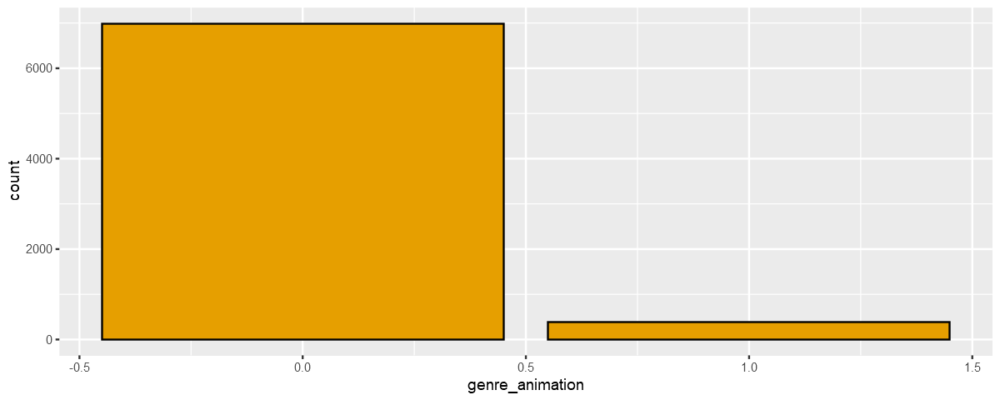

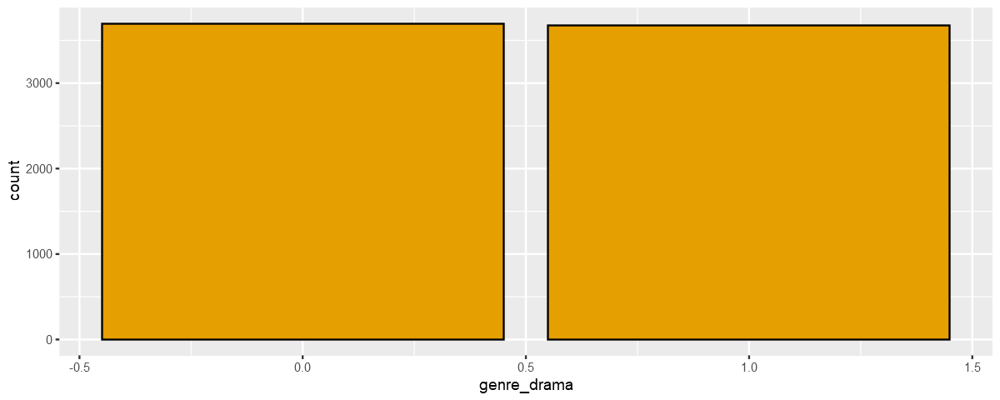

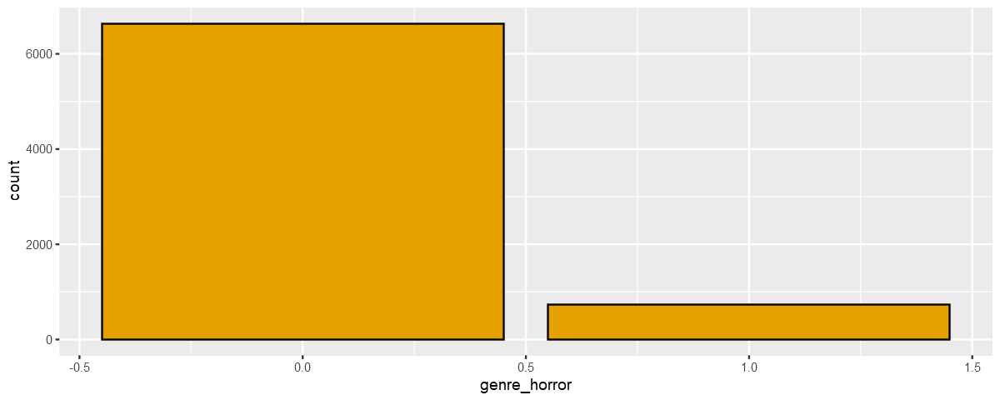

...

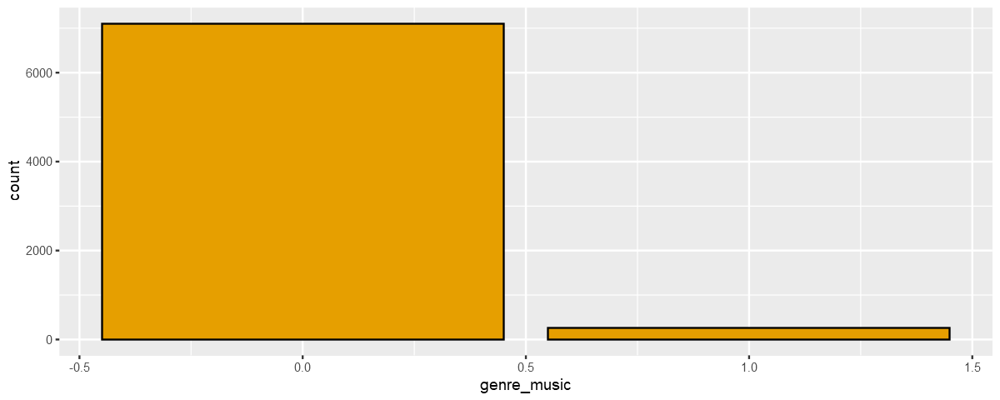

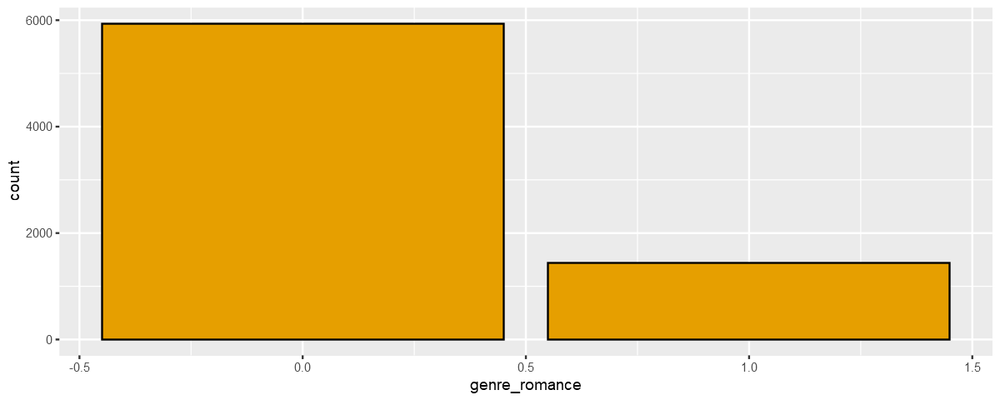

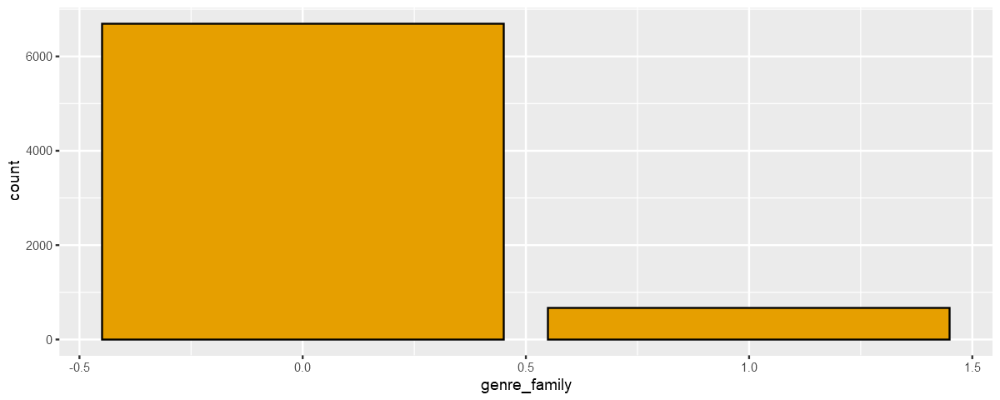

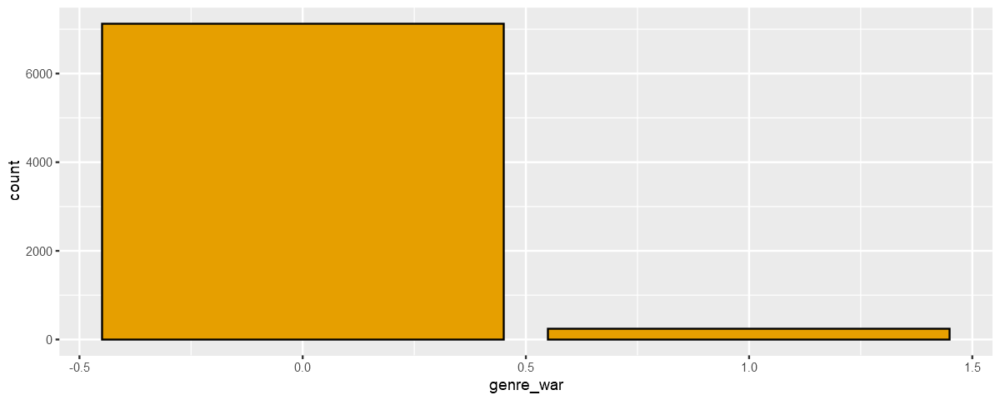

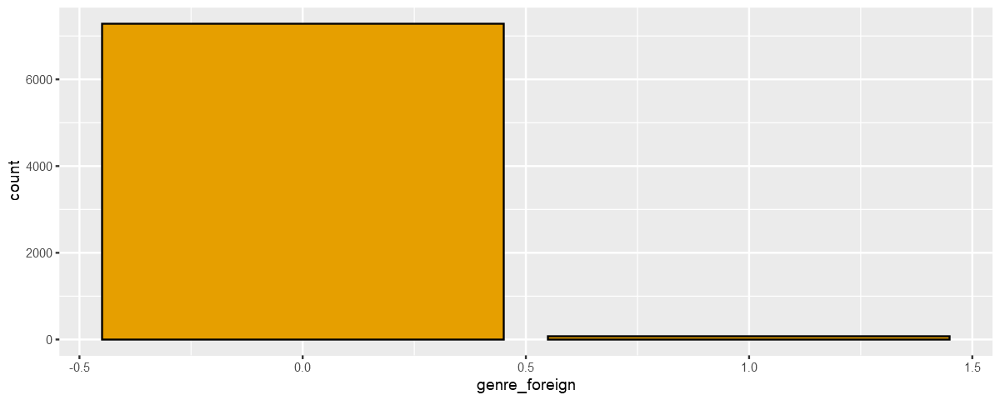

In [33]:
par(mfrow=c(2,2))

nm <- names(df[,1:84])

for (i in 44:62) {
    x <- df[,i]
    print( ggplot(df, aes(x)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    xlab(nm[i]) +
    theme_get())
    }

### Departments Analysis

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."
Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


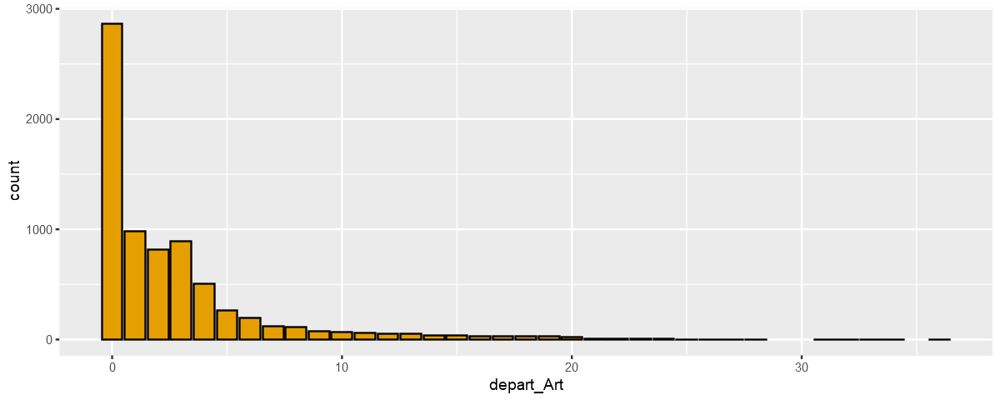

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


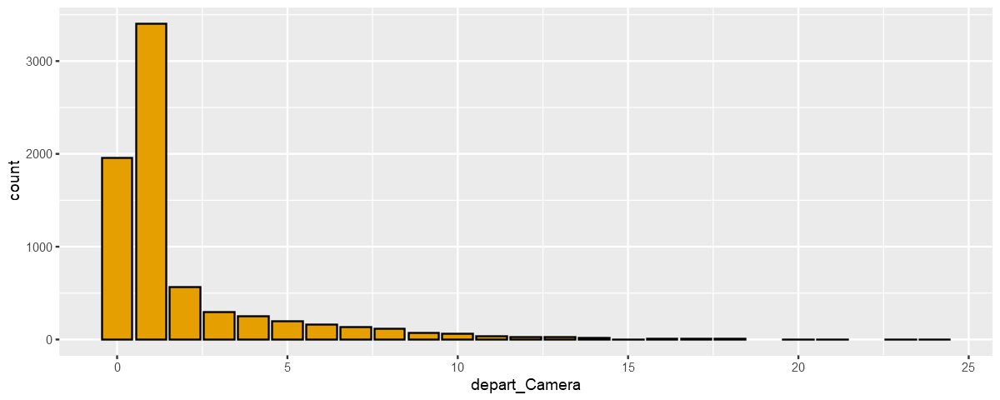

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


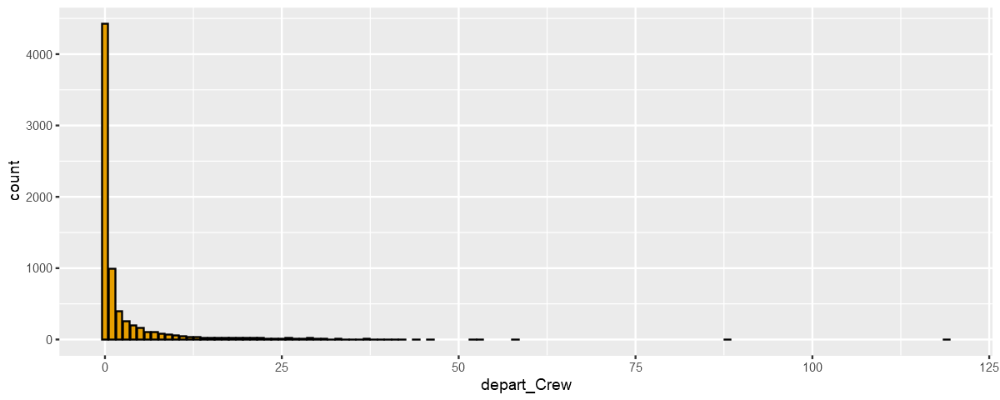

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


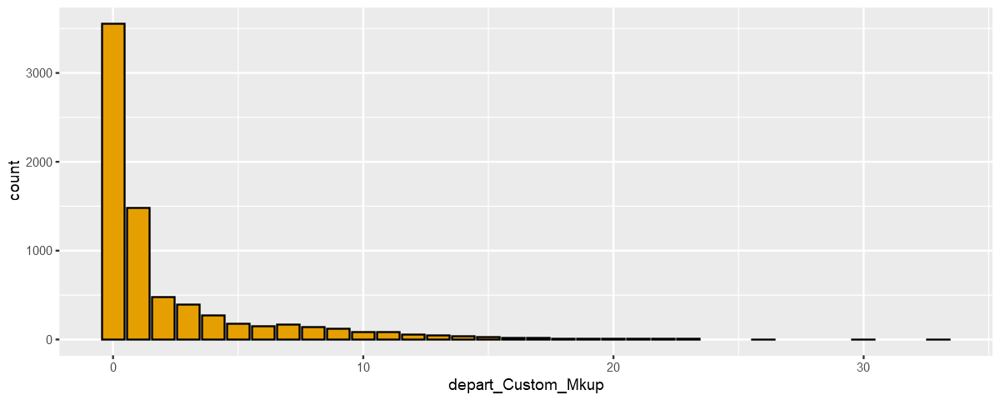

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


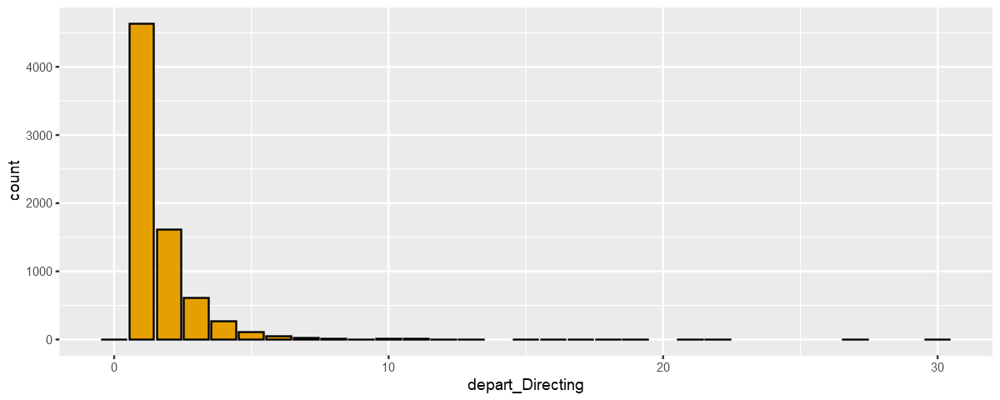

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


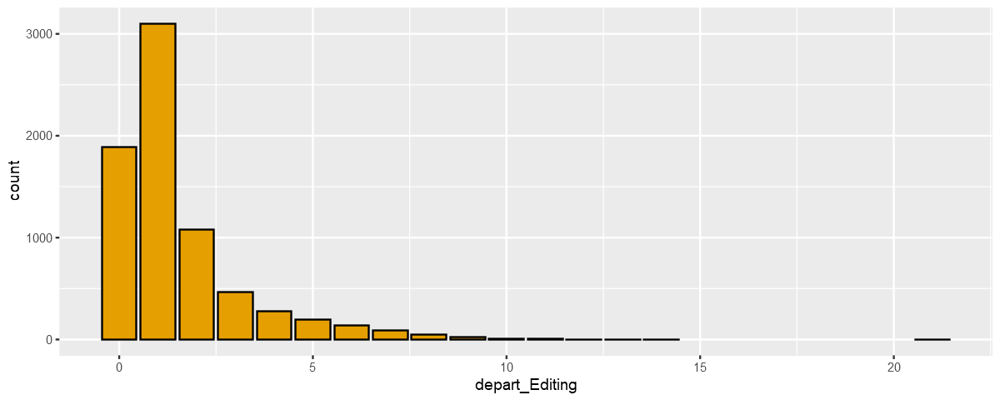

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


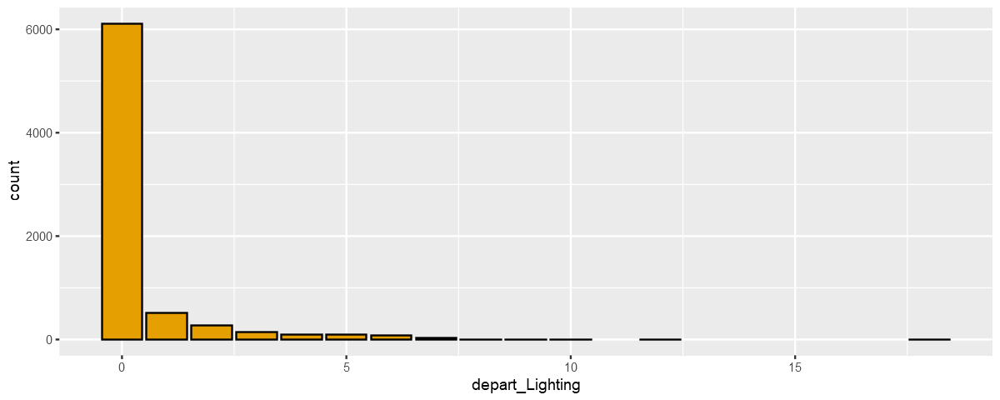

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


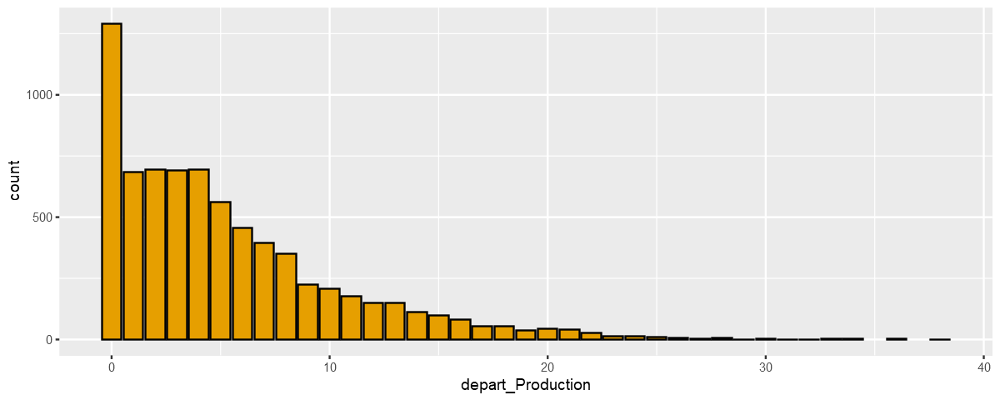

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


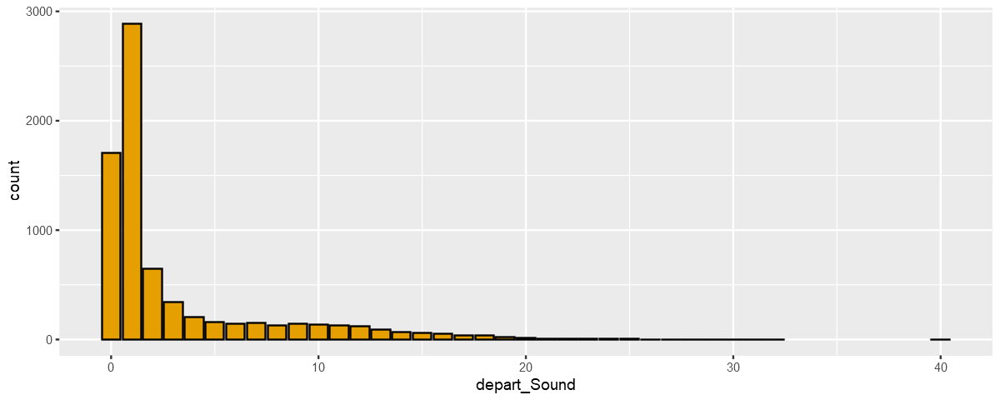

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


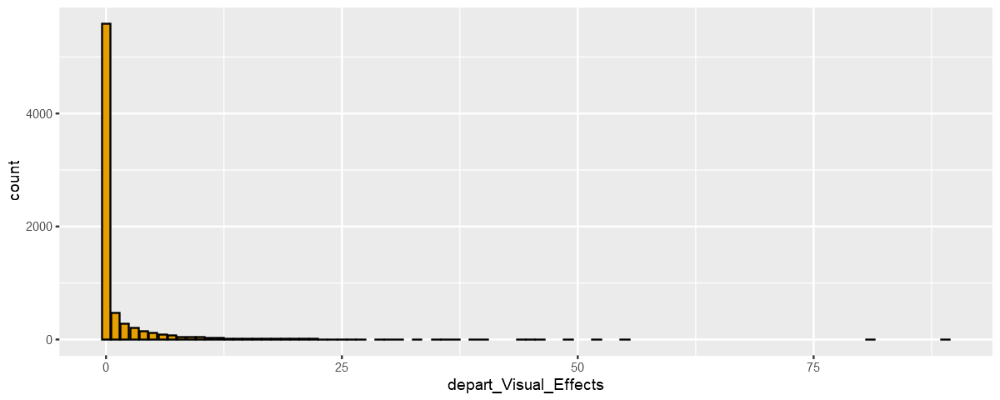

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


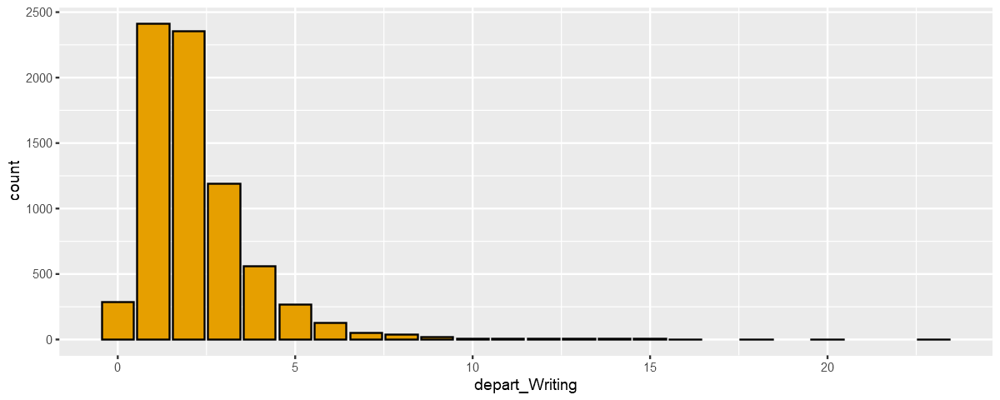

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


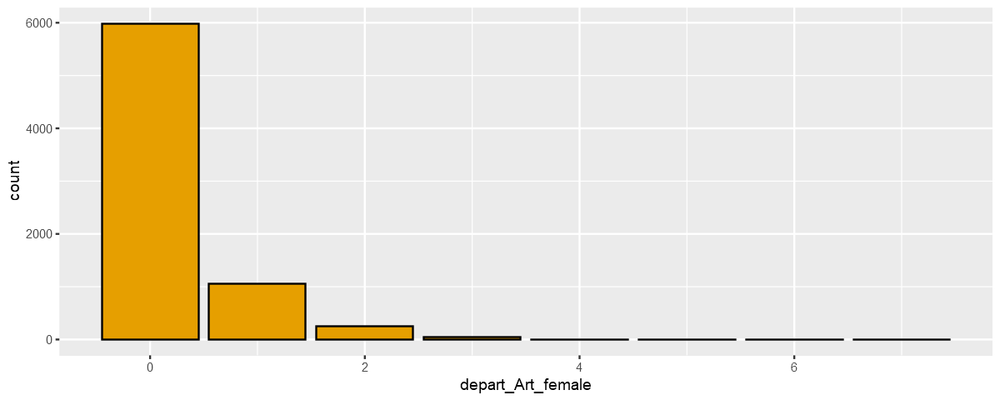

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


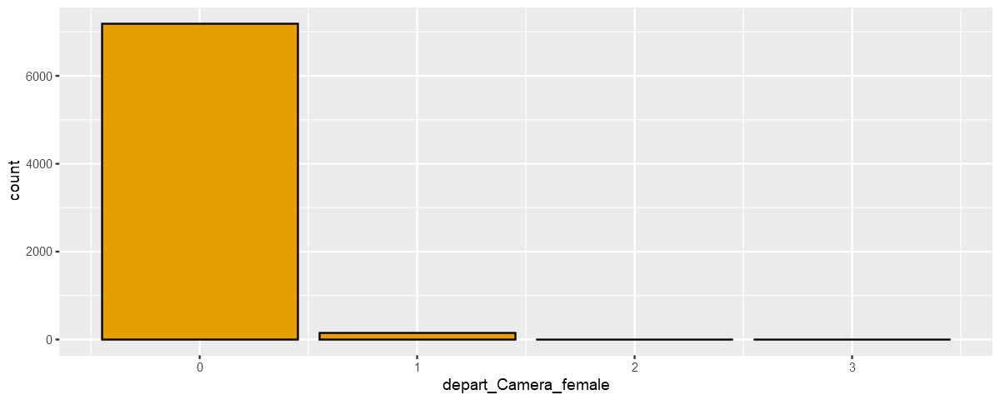

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


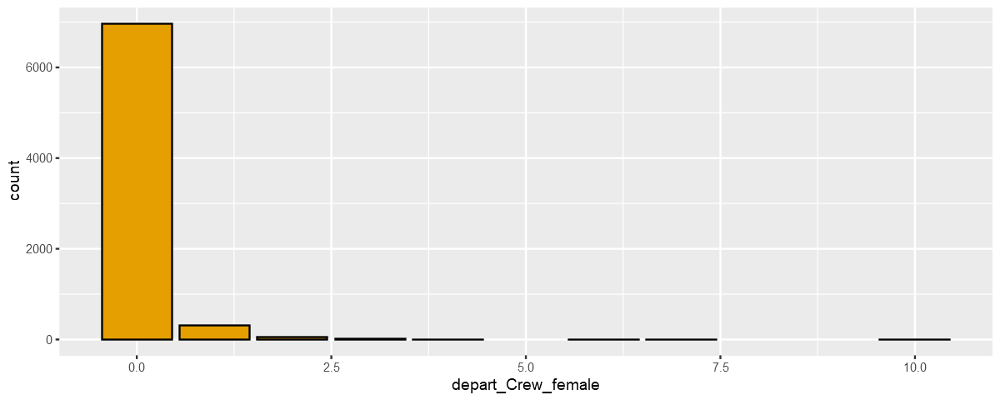

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


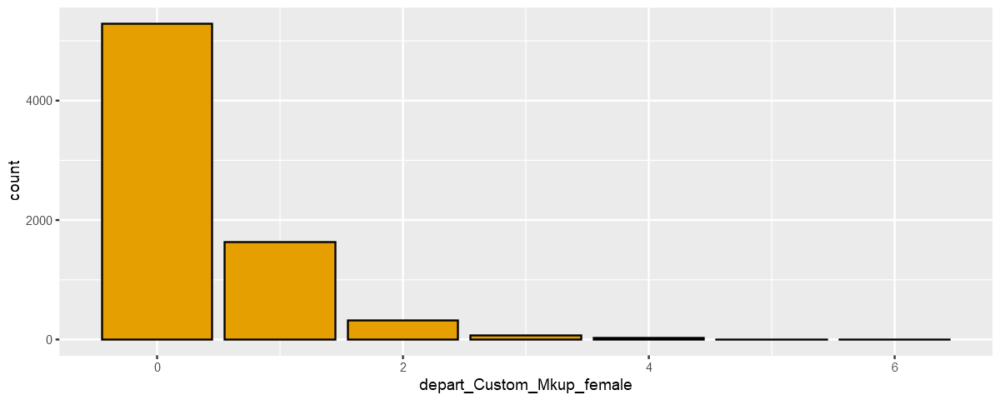

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


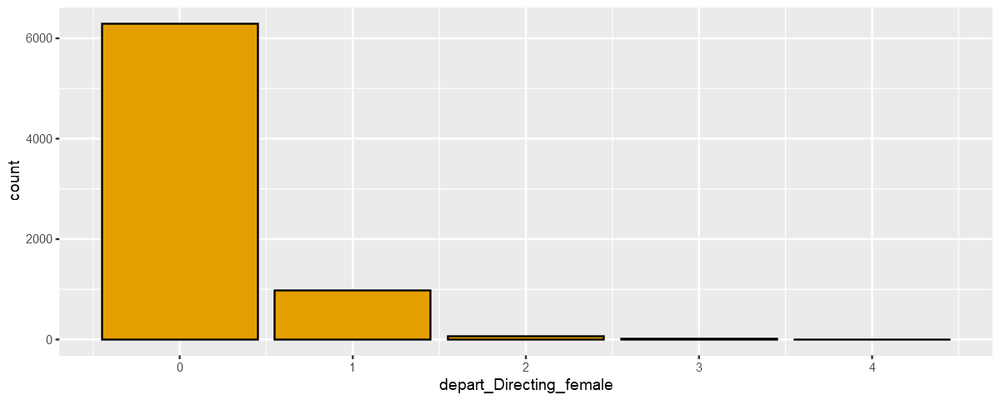

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


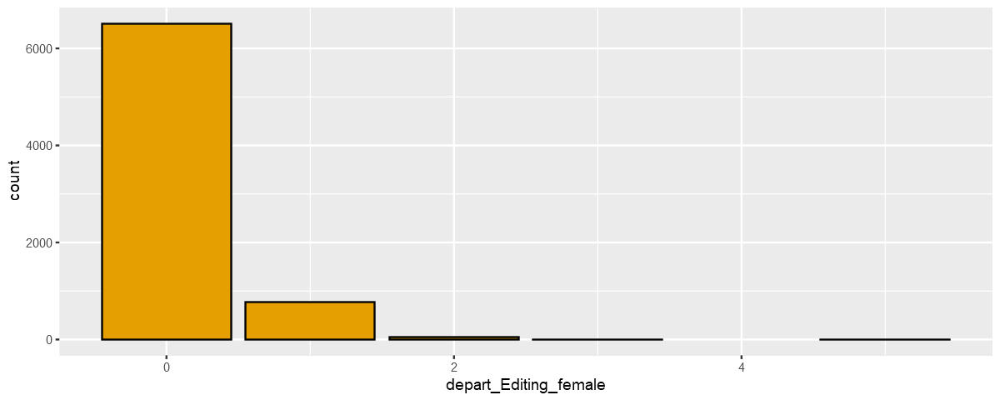

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


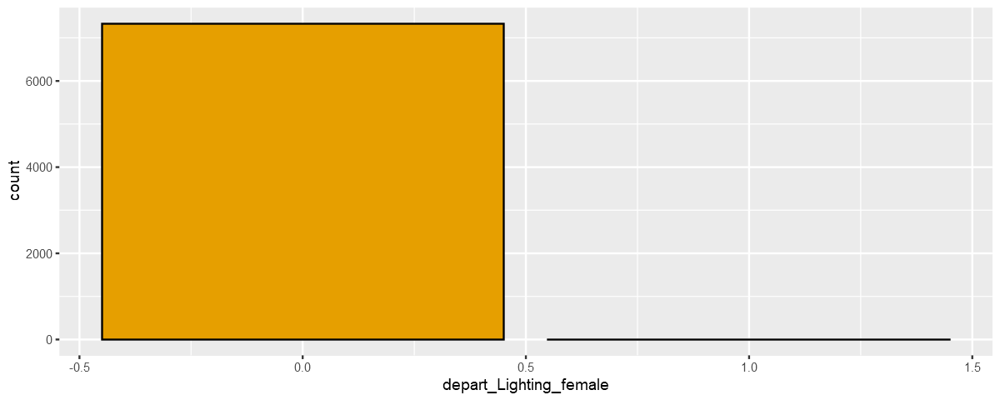

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


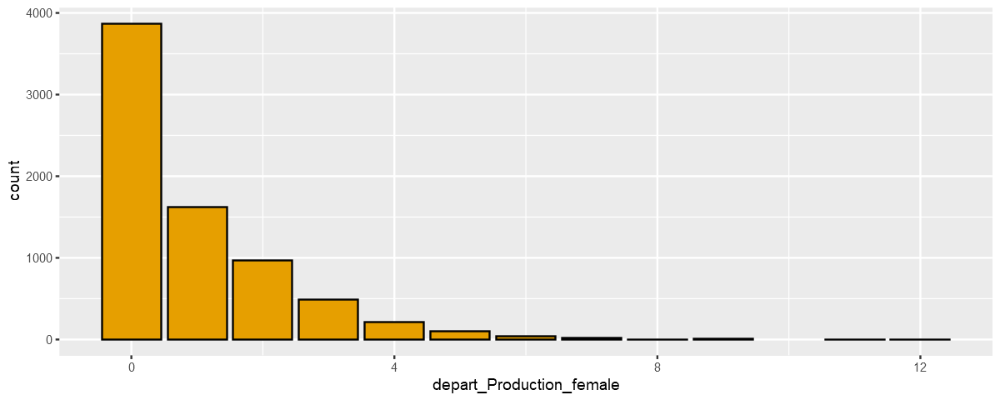

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


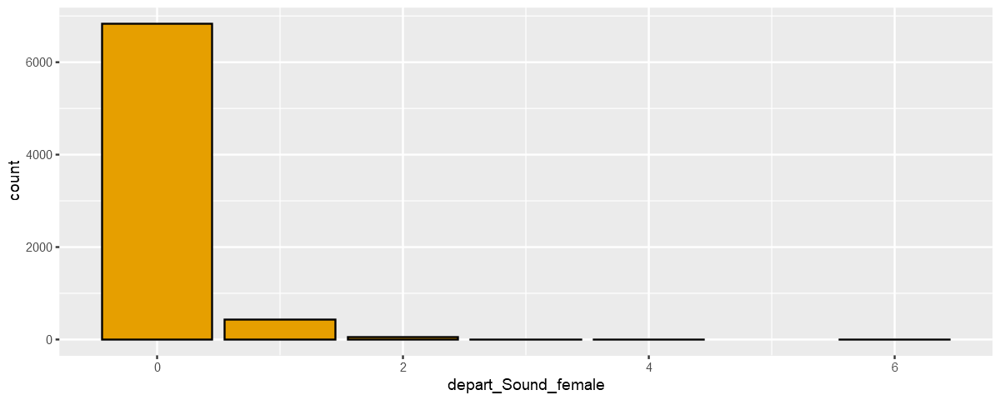

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


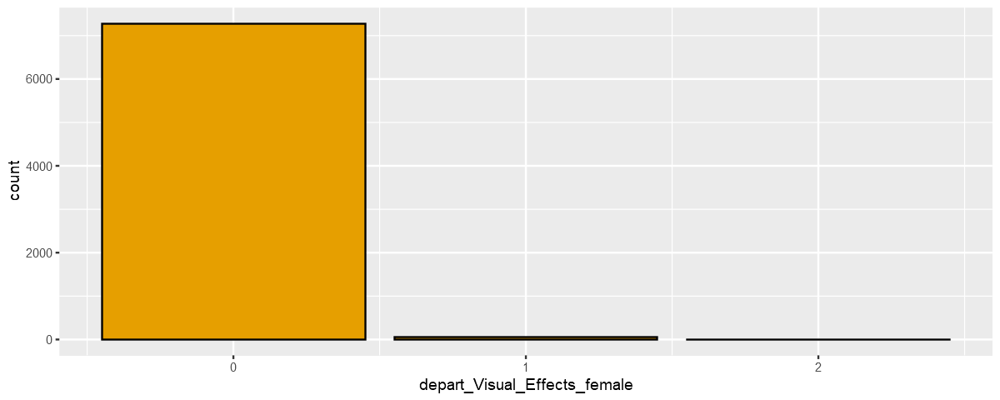

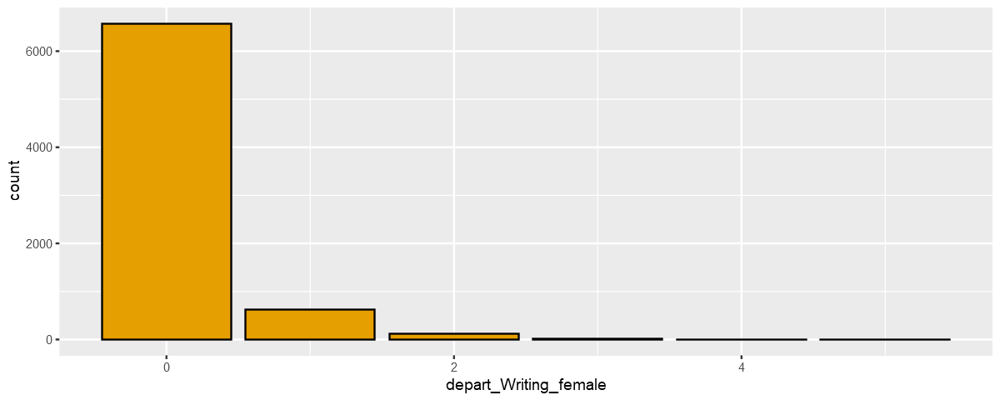

In [34]:
par(mfrow=c(2,2))

nm <- names(df[,1:84])

for (i in 63:84) {
    x <- df[,i]
    print( ggplot(df, aes(x)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    xlab(nm[i]) +
    theme_get())

}

Warning message:
"Removed 34 rows containing missing values (geom_point)."
Warning message:
"Removed 34 rows containing missing values (geom_point)."


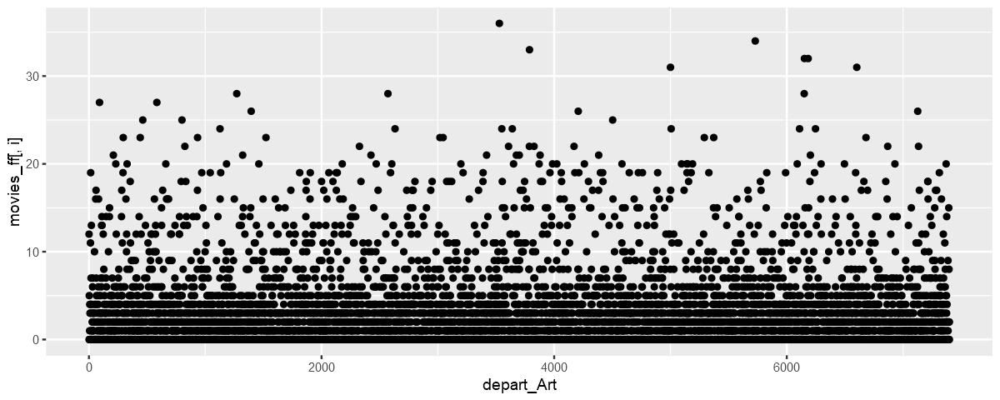

Warning message:
"Removed 34 rows containing missing values (geom_point)."


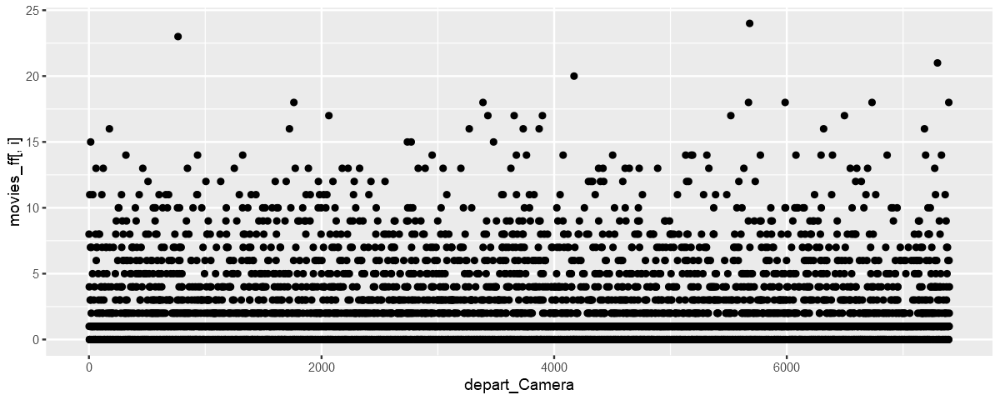

Warning message:
"Removed 34 rows containing missing values (geom_point)."


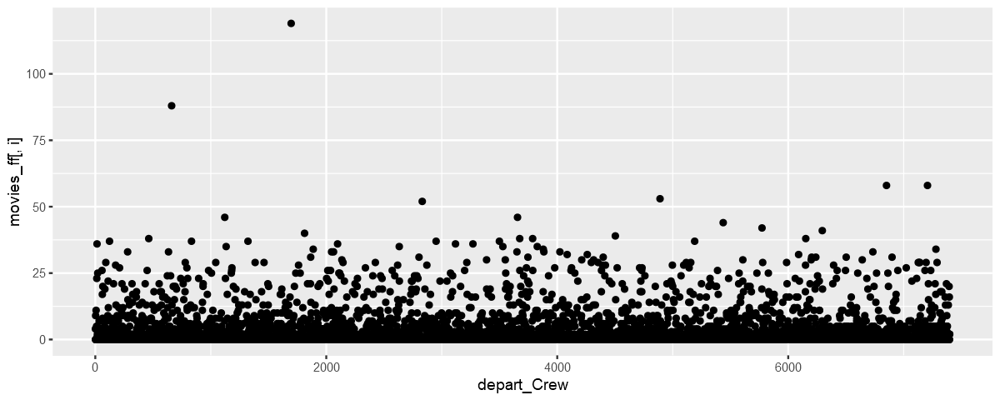

Warning message:
"Removed 34 rows containing missing values (geom_point)."


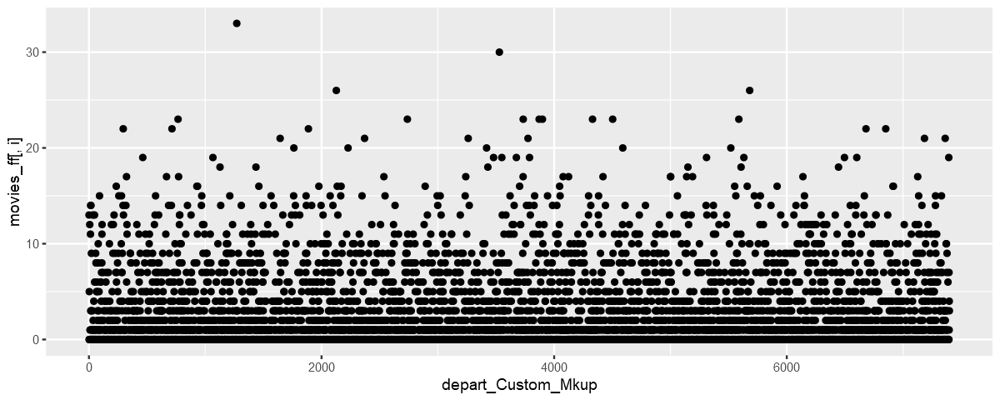

Warning message:
"Removed 34 rows containing missing values (geom_point)."


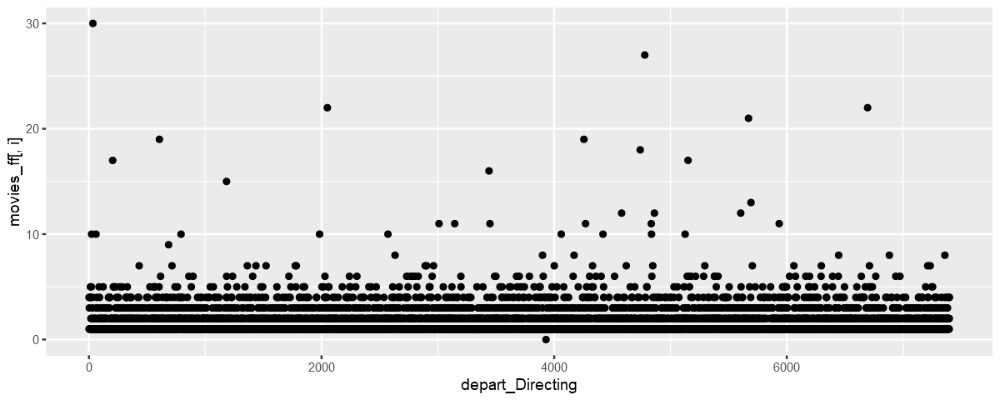

Warning message:
"Removed 34 rows containing missing values (geom_point)."


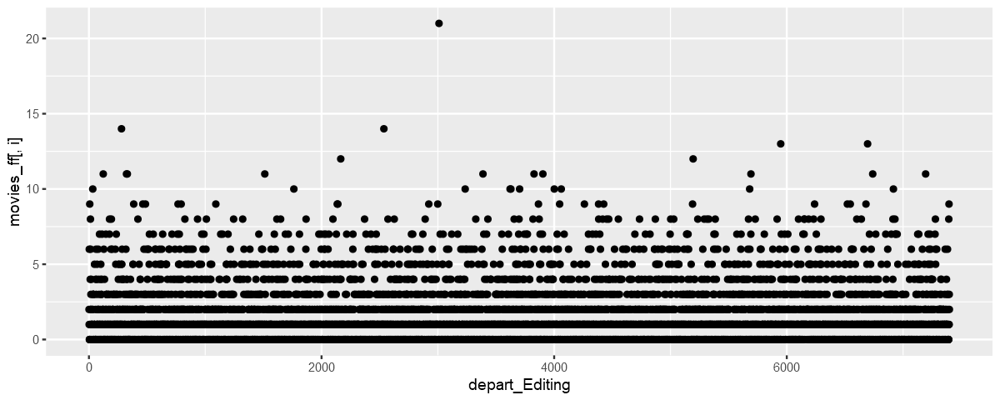

Warning message:
"Removed 34 rows containing missing values (geom_point)."


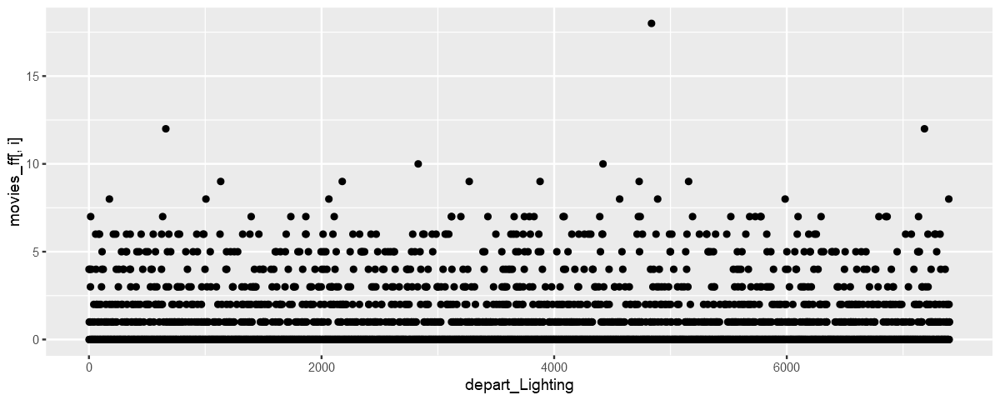

Warning message:
"Removed 34 rows containing missing values (geom_point)."


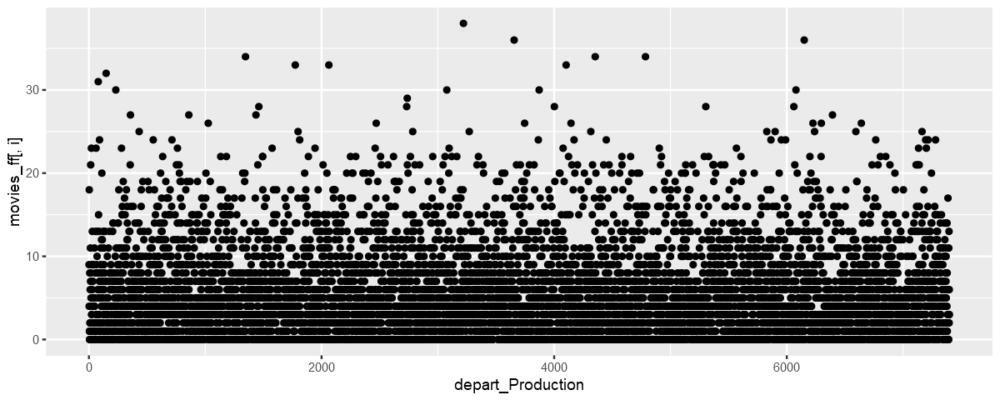

Warning message:
"Removed 34 rows containing missing values (geom_point)."


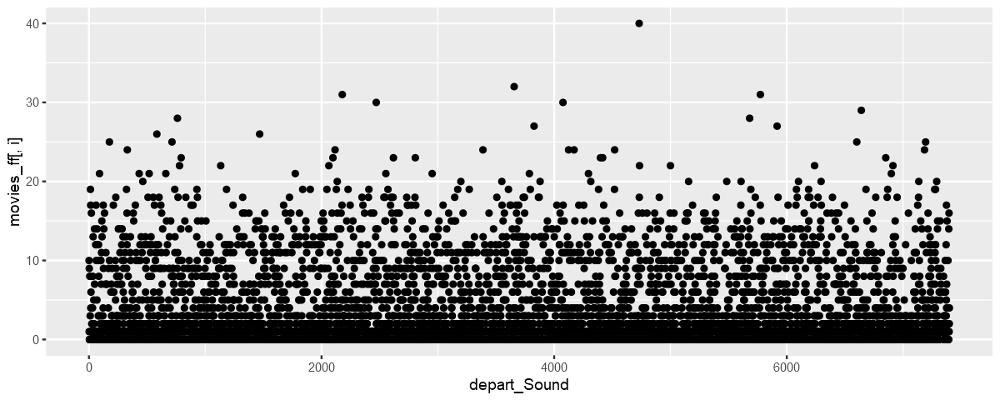

Warning message:
"Removed 34 rows containing missing values (geom_point)."


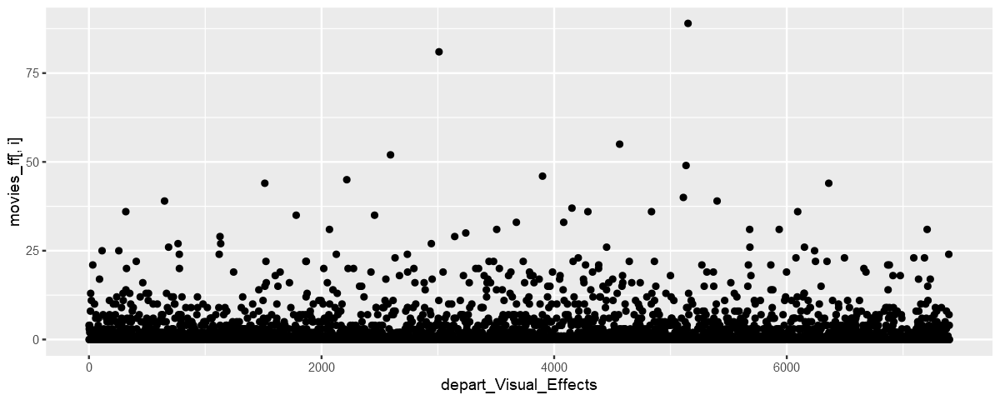

Warning message:
"Removed 34 rows containing missing values (geom_point)."


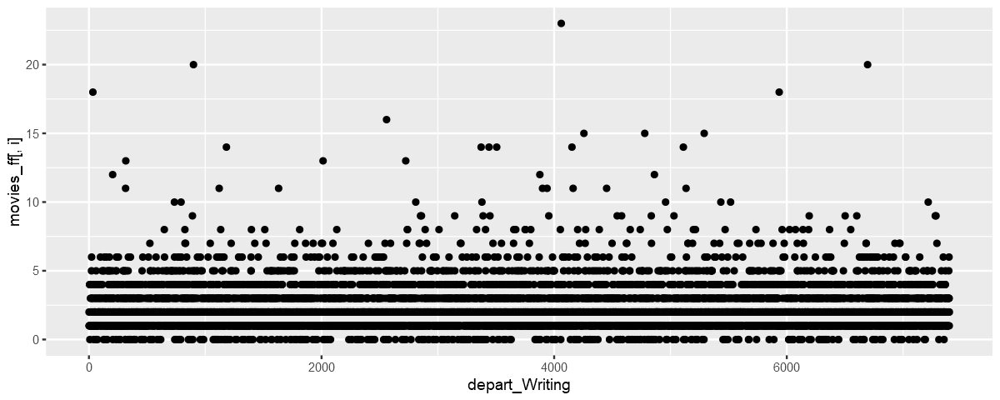

Warning message:
"Removed 34 rows containing missing values (geom_point)."


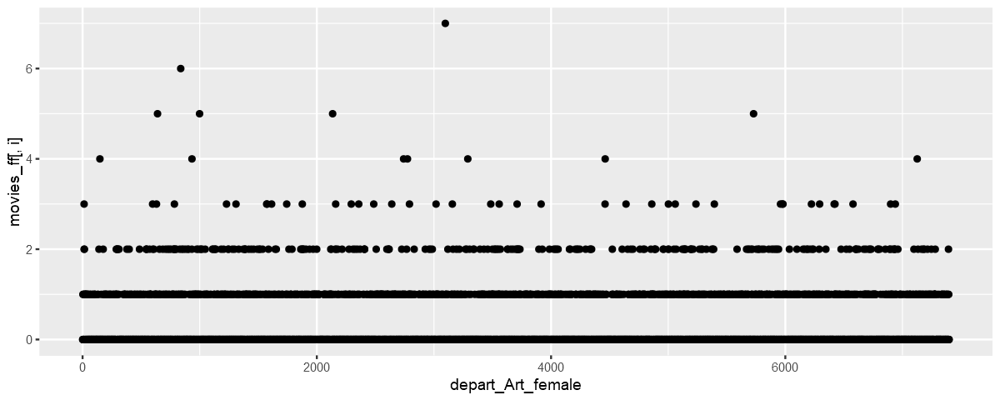

Warning message:
"Removed 34 rows containing missing values (geom_point)."


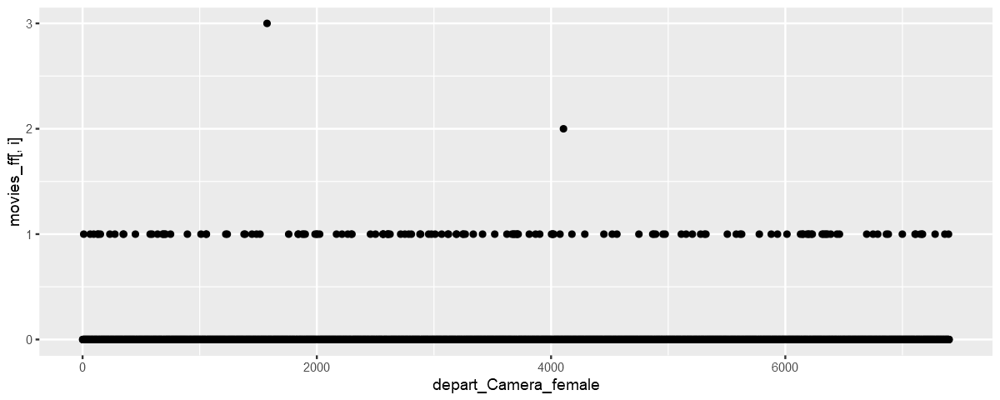

Warning message:
"Removed 34 rows containing missing values (geom_point)."


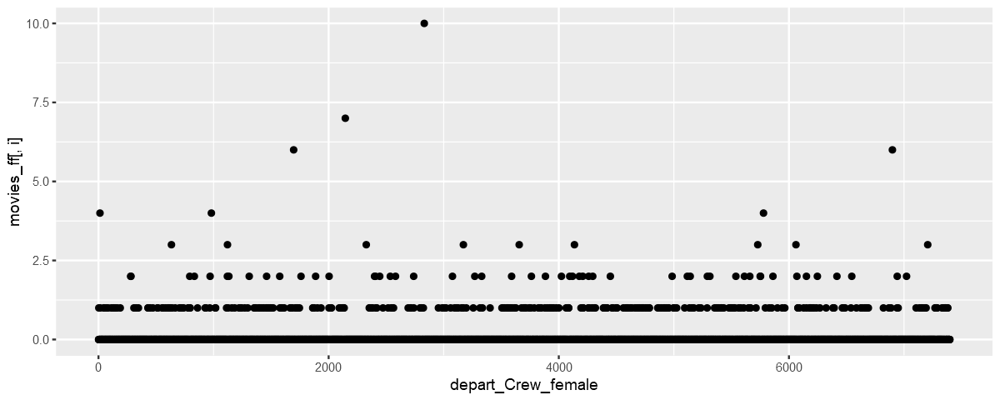

Warning message:
"Removed 34 rows containing missing values (geom_point)."


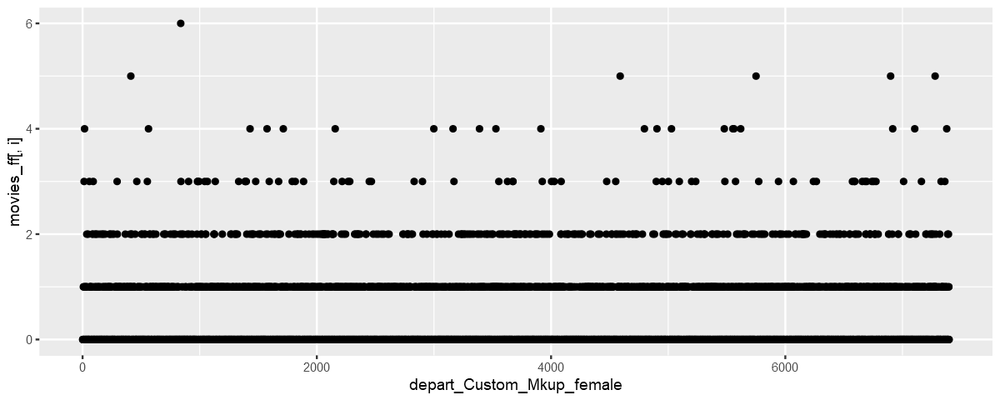

Warning message:
"Removed 34 rows containing missing values (geom_point)."


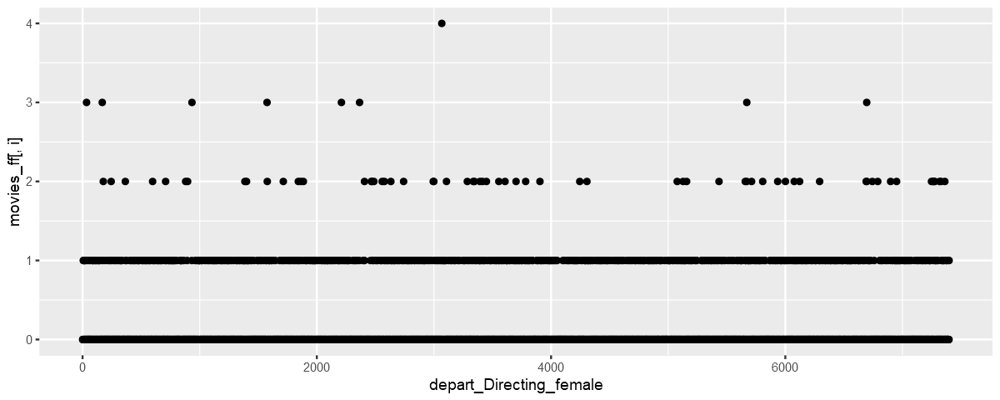

Warning message:
"Removed 34 rows containing missing values (geom_point)."


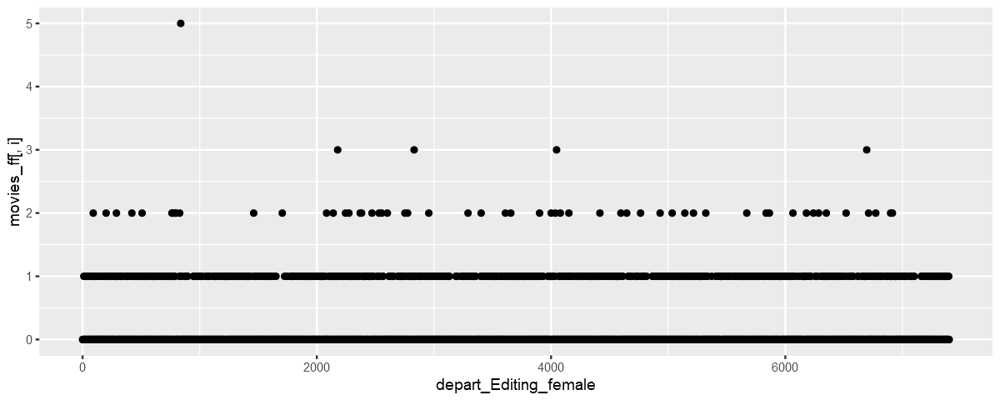

Warning message:
"Removed 34 rows containing missing values (geom_point)."


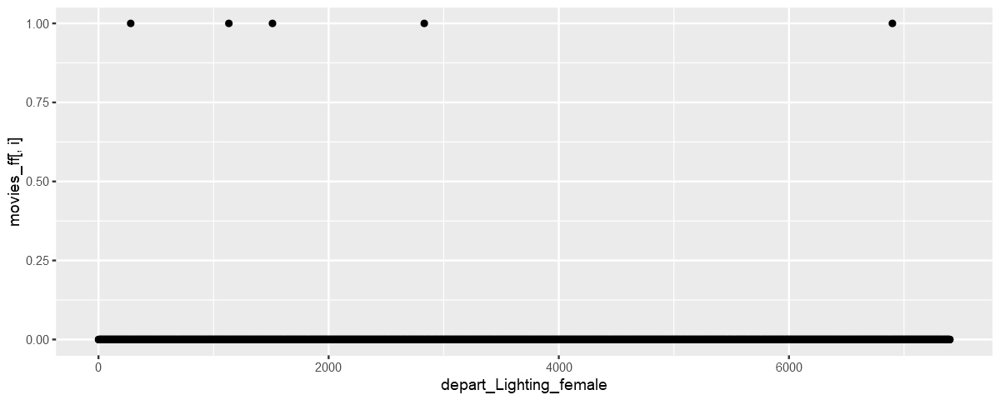

Warning message:
"Removed 34 rows containing missing values (geom_point)."


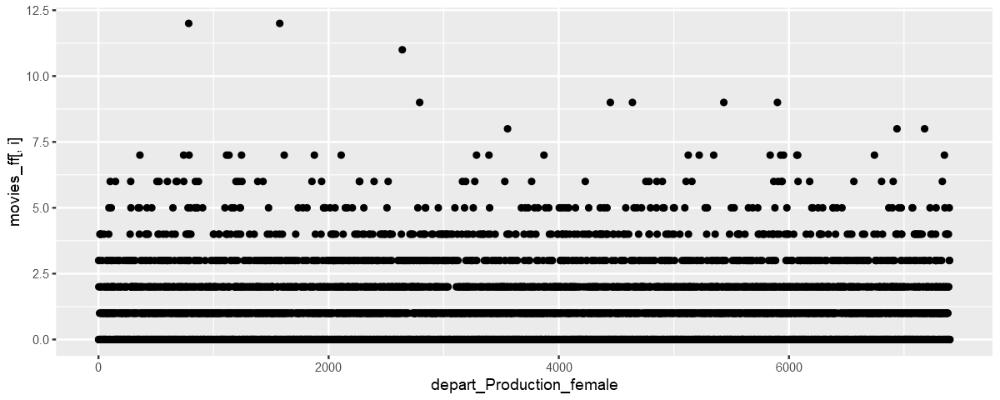

Warning message:
"Removed 34 rows containing missing values (geom_point)."


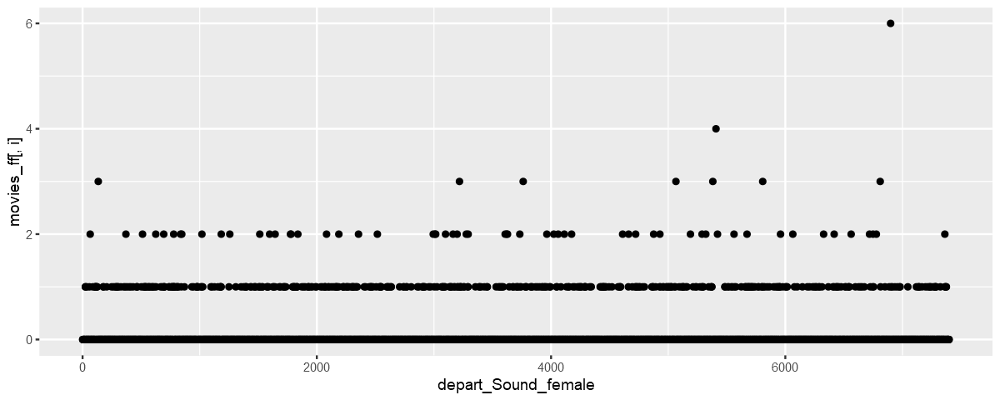

Warning message:
"Removed 34 rows containing missing values (geom_point)."


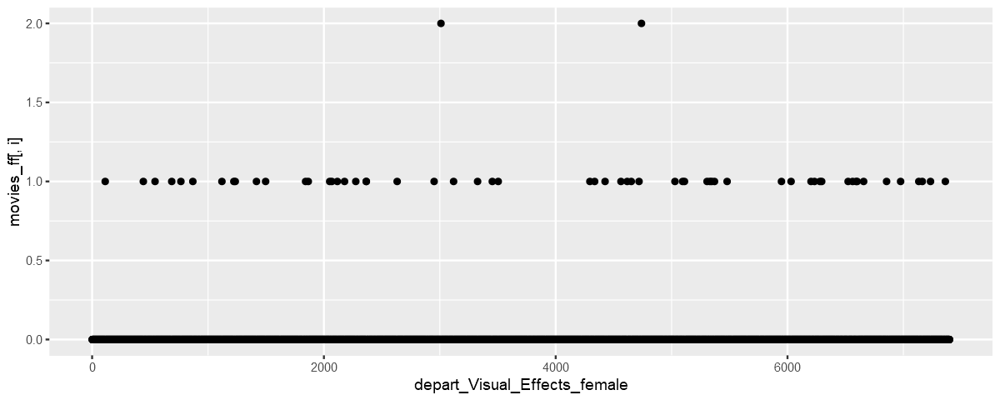

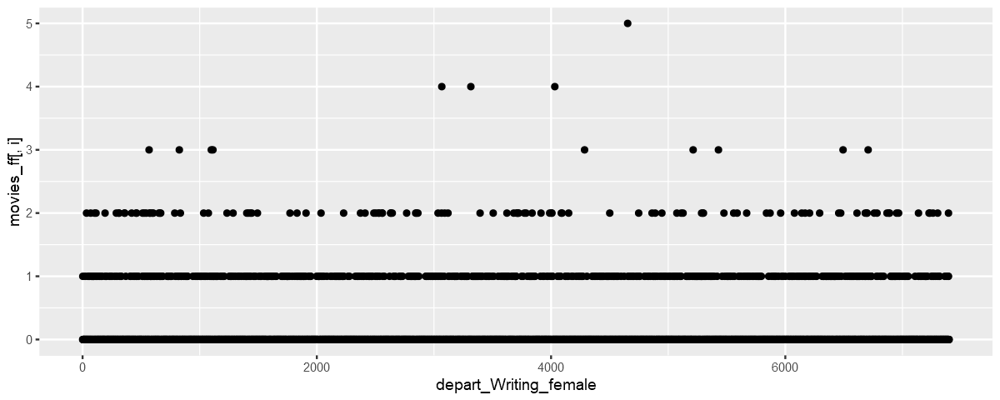

In [35]:
par(mfrow=c(2,2))

for (i in 63:84) {
    print(ggplot(data=df) +
          geom_point(aes(x=movie_id, y=df[,i])) +
          xlab(nm[i]))
} 


##  2.3 Correlation matrix

In [17]:
if(!require(corrplot)) {install.packages("corrplot");require(corrplot)}
if (!require("RColorBrewer")) install.packages("RColorBrewer")

Loading required package: corrplot

corrplot 0.84 loaded

Loading required package: RColorBrewer



In [48]:
res <- NULL

for(i in movies_continuous) {
    rw <- NULL
    for(j in movies_continuous) {
        rw <- cbind(rw,cor.test(x=df[[i]],y=df[[j]],method="spearman")$estimate)
    }
    res <- rbind(res,rw)
}
row.names(res) <- movies_continuous
colnames(res) <- movies_continuous
res

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test.default(x = movies_ff[[i]], y = movies_ff[[j]], method = "spearman"):
"Cannot compute exact p-value with ties"
Warning message in cor.test

,runtime,budget,popularity,revenue,release_year,release_month,release_day,seasonality,sw_collection,producers_cnt,...,depart_Art_female,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
runtime,1.000000000,0.25050252,0.17136367,0.26191060,0.004360218,0.1262076528,0.0279912142,0.0960086447,0.046622733,0.097767205,...,0.111873075,0.001225895,0.0704246646,0.169646772,0.0698589725,0.048497778,0.126761948,0.0774874705,0.005255800,0.026717987
budget,0.250502521,1.00000000,0.51763922,0.69100785,0.157141175,0.0602131869,0.0342037539,0.1345926151,0.081935008,0.273677529,...,0.240030511,0.036589693,0.1755994840,0.315041130,0.1396022783,0.086162991,0.396343510,0.1305320003,0.082564782,0.049253239
popularity,0.171363671,0.51763922,1.00000000,0.59453873,0.135965923,0.0539458645,0.0482334529,0.1043664721,0.087653111,0.285426693,...,0.221043305,0.065173132,0.1774724840,0.294492671,0.1262728299,0.102167066,0.395866981,0.1382170269,0.076447923,0.060167155
revenue,0.261910598,0.69100785,0.59453873,1.00000000,0.017917598,0.0364920303,0.0606503918,0.1990130962,0.094416265,0.196467841,...,0.239779128,0.032005853,0.1628297145,0.317688650,0.1261972942,0.058297473,0.387482082,0.1411739321,0.077061051,0.099745155
release_year,0.004360218,0.15714117,0.13596592,0.01791760,1.000000000,-0.0497651356,0.0061774439,-0.0786023935,0.088808193,0.338516327,...,0.107572524,0.062025697,0.0832048798,0.068599043,0.0854188781,-0.012019154,0.183404135,0.0753722071,0.052271724,0.041967836
release_month,0.126207653,0.06021319,0.05394586,0.03649203,-0.049765136,1.0000000000,-0.0009423409,0.1707315246,-0.027212476,-0.001043865,...,0.021674782,0.010827577,0.0120540840,0.036098381,0.0215525596,0.029983201,0.050992715,0.0204621810,0.004774131,0.009202500
release_day,0.027991214,0.03420375,0.04823345,0.06065039,0.006177444,-0.0009423409,1.0000000000,0.0410096781,0.018610327,0.014359309,...,0.002821397,0.001052866,0.0005068131,0.005062611,0.0150900891,0.006423604,0.006748973,-0.0004783957,0.002249062,0.020212138
seasonality,0.096008645,0.13459262,0.10436647,0.19901310,-0.078602394,0.1707315246,0.0410096781,1.0000000000,-0.000937747,-0.018386271,...,0.021742138,-0.010299156,0.0317639923,0.036027035,0.0006687689,0.011206622,0.015323870,-0.0068919871,0.019629109,-0.002721881
sw_collection,0.046622733,0.08193501,0.08765311,0.09441626,0.088808193,-0.0272124763,0.0186103266,-0.0009377470,1.000000000,0.138351557,...,0.035172711,0.017336175,0.0554464154,0.077165283,0.0311544415,0.013411305,0.079336967,0.0229611410,0.048970513,0.012428258
producers_cnt,0.097767205,0.27367753,0.28542669,0.19646784,0.338516327,-0.0010438647,0.0143593088,-0.0183862713,0.138351557,1.000000000,...,0.177470682,0.040005803,0.1038378789,0.219010258,0.1019486490,0.044205743,0.318429765,0.0852203442,0.058094839,0.017851821


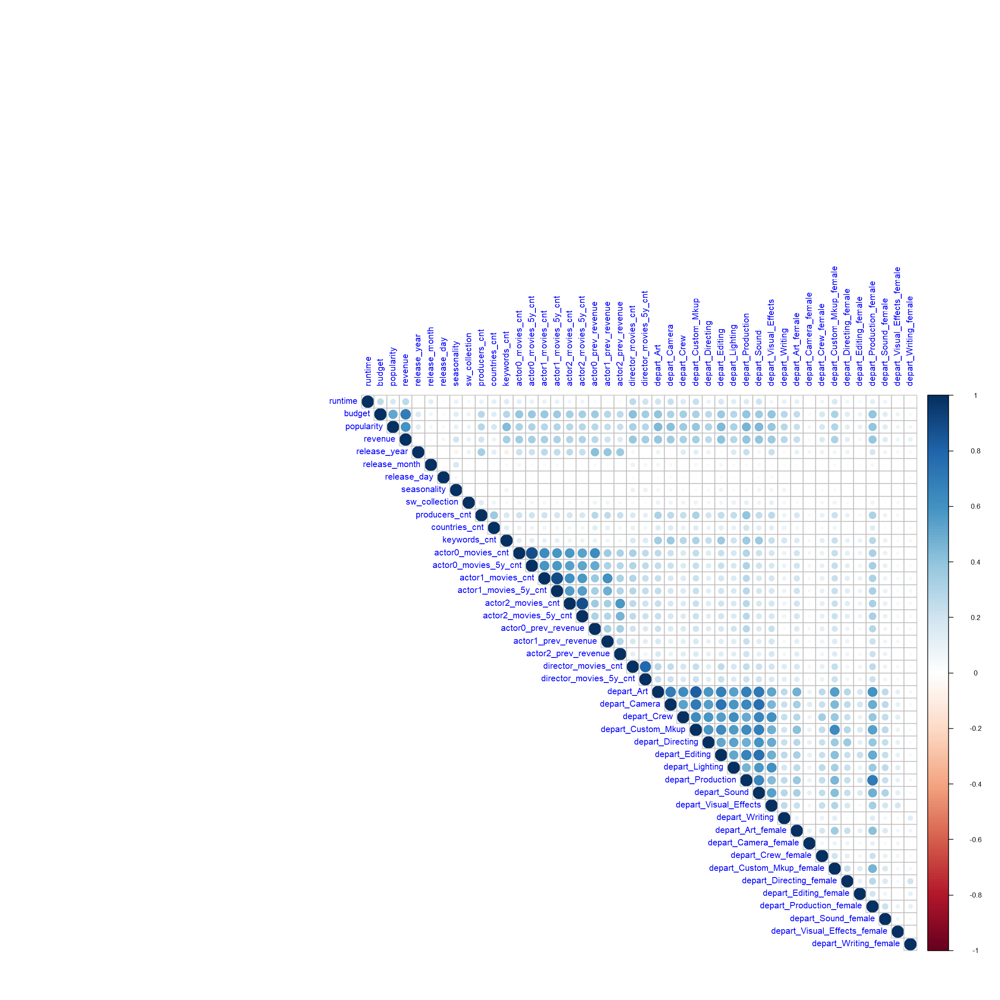

In [54]:
corrplot(res, type = "upper", 
         tl.col = "Blue", tl.srt = 90)


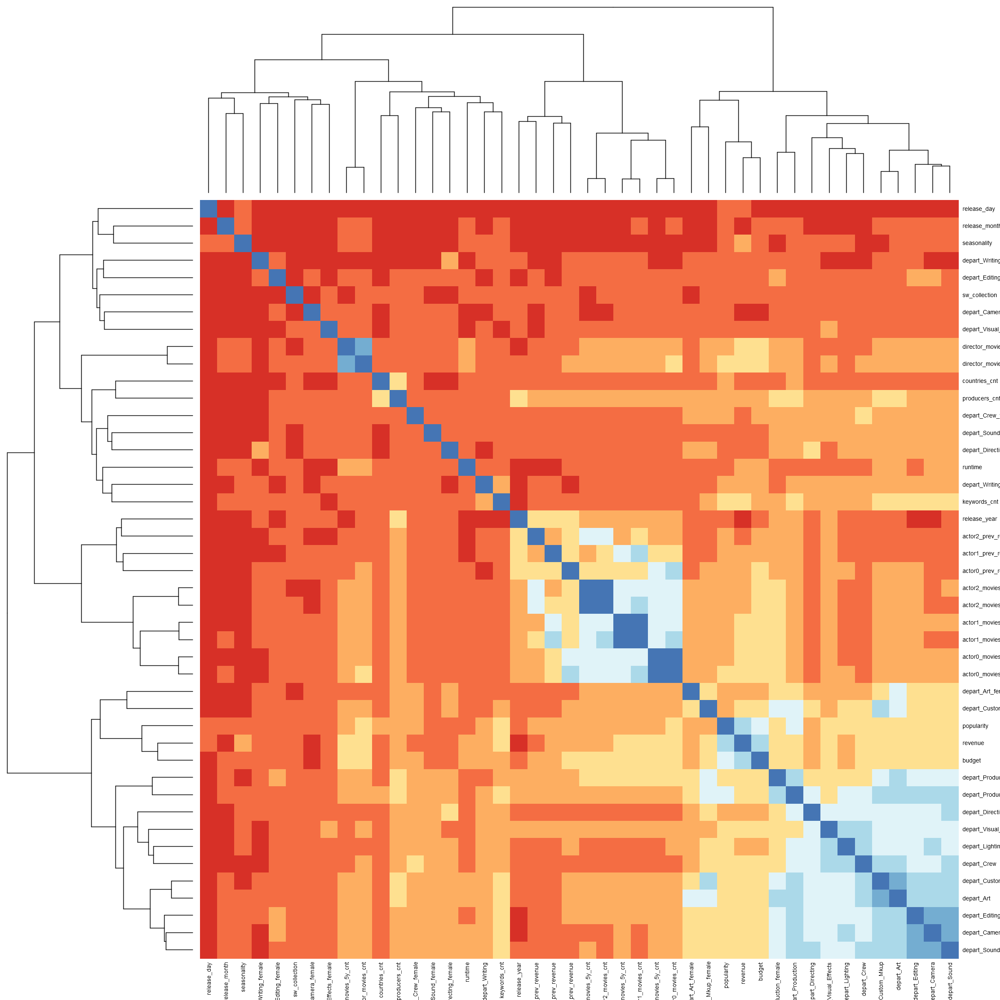

In [55]:
heatmap(res,symm = T,cexCol = 0.8, cexRow = 0.8, col=brewer.pal(n=8, name="RdYlBu"))

### 2.4 Revenue Analysis

Warning message:
"Removed 4382 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Warning message:
"Removed 4382 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."


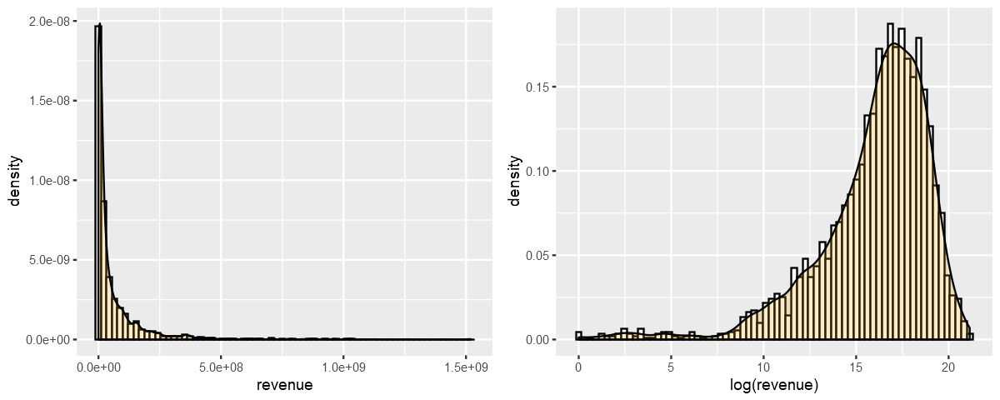

In [56]:
p1 <- ggplot(df, aes(x=revenue)) + 
      geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 70)+
      geom_density(alpha=0.2, fill="#E69F00") + theme_get()
#log revenue
p2 <- ggplot(df, aes(x=log(revenue))) + 
      geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 70)+
      geom_density(alpha=0.2, fill="#E69F00") + theme_get()


options(repr.plot.width = 10, repr.plot.height = 4)
grid.arrange(p1,p2, nrow = 1)

#### differences between the average revenue by language?

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."


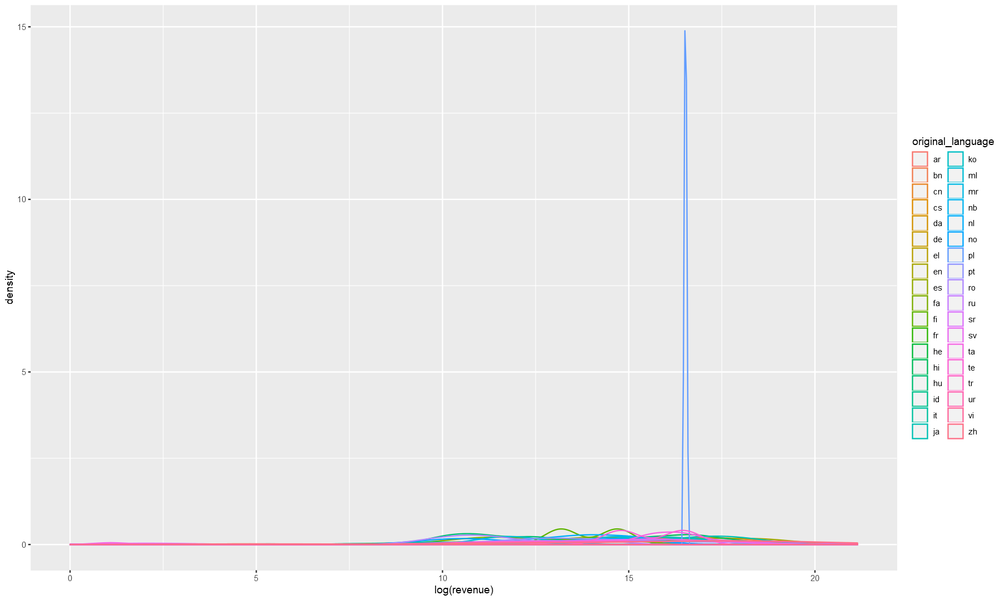

In [361]:
ggplot(data=df) +
    geom_density(aes(log(revenue), group=original_language, color=original_language))

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


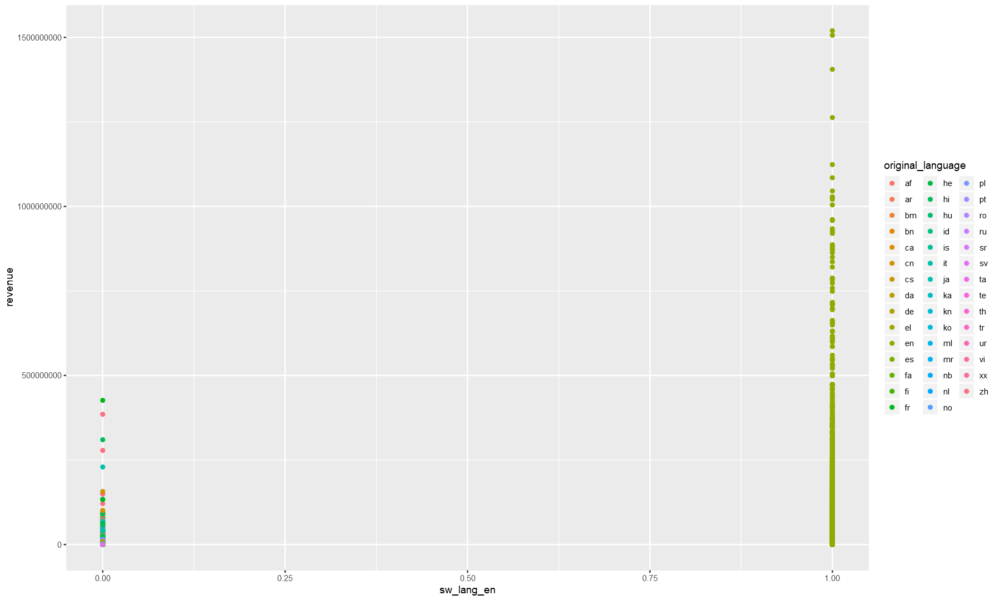

In [370]:
ggplot(data=df) +
    geom_point(aes(x=sw_lang_en, y=revenue, color = original_language))

Warning message:
"Removed 4384 rows containing missing values (geom_point)."
Warning message:
"Removed 4382 rows containing missing values (geom_point)."


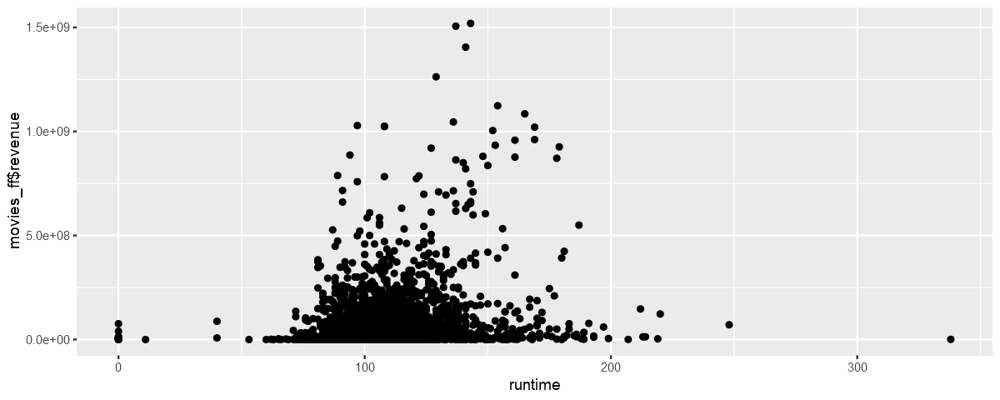

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


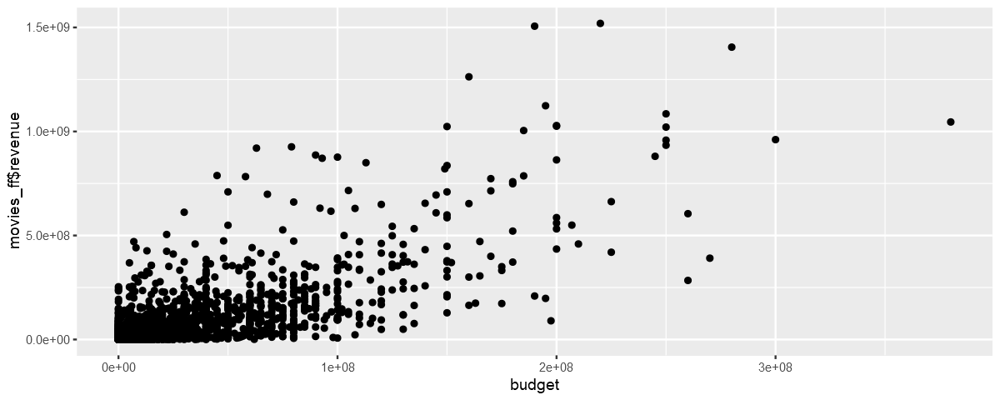

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


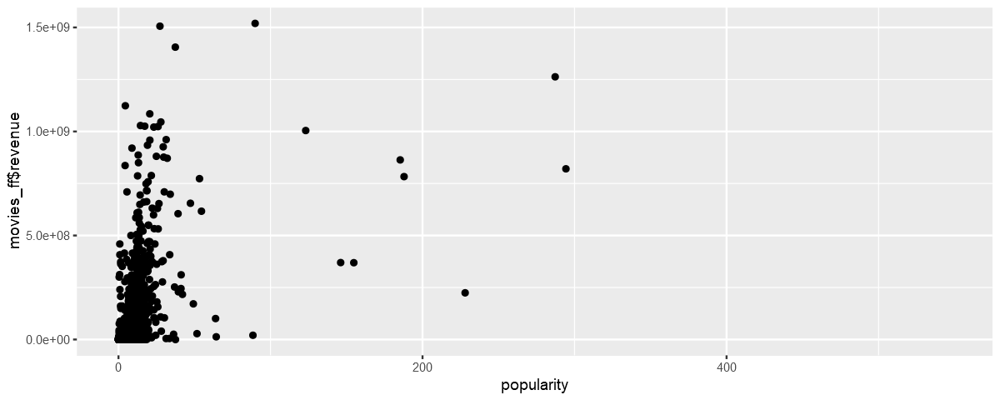

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


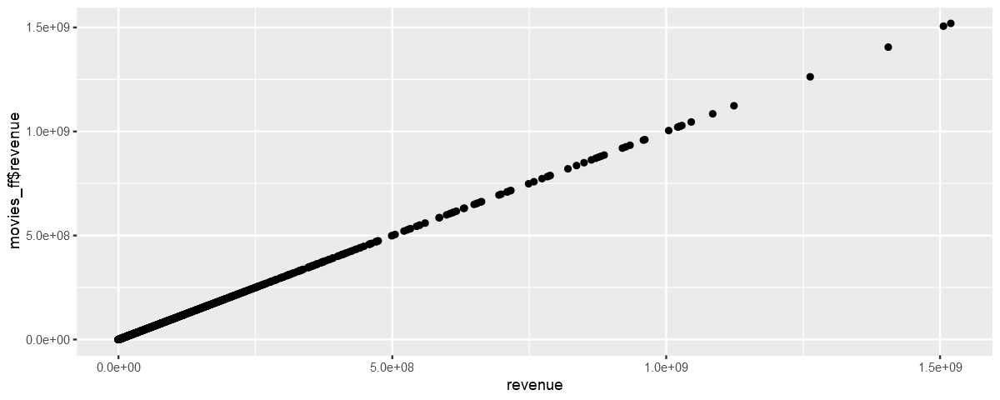

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


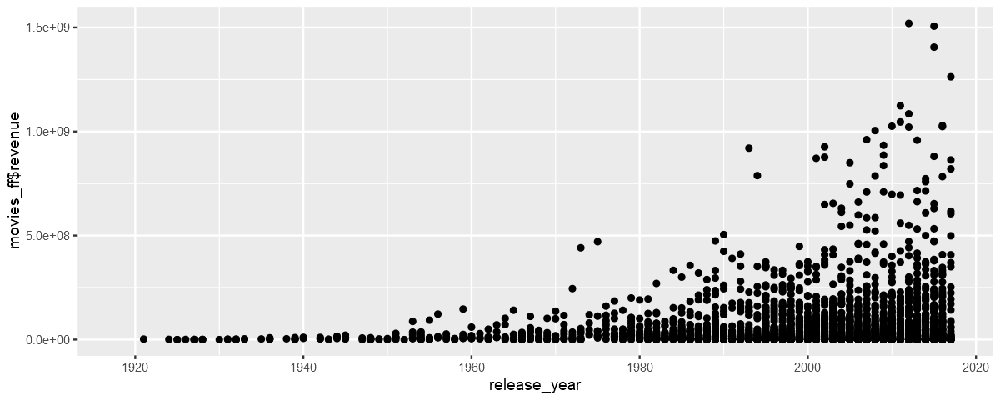

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


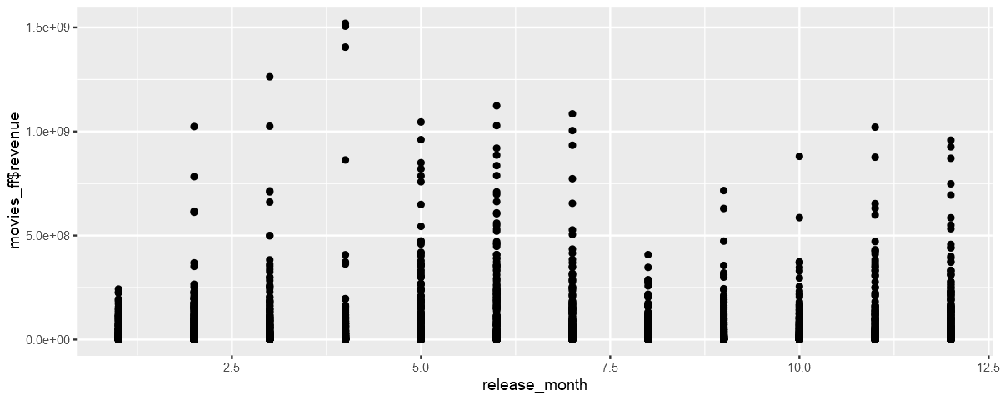

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


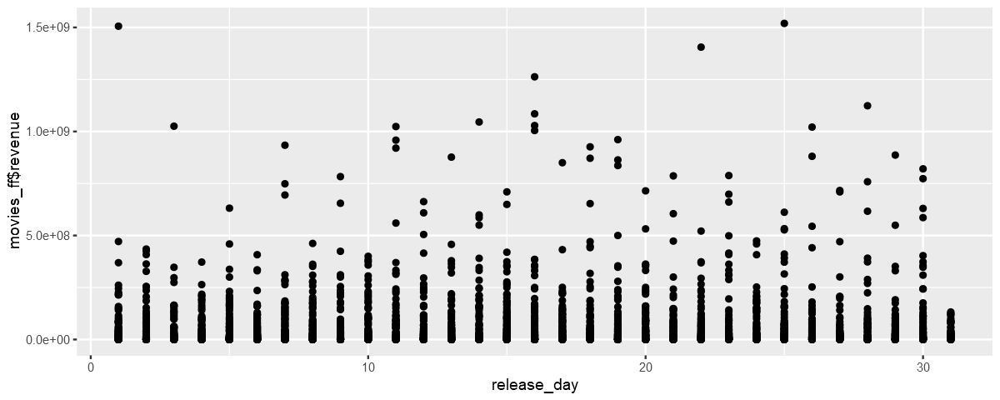

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


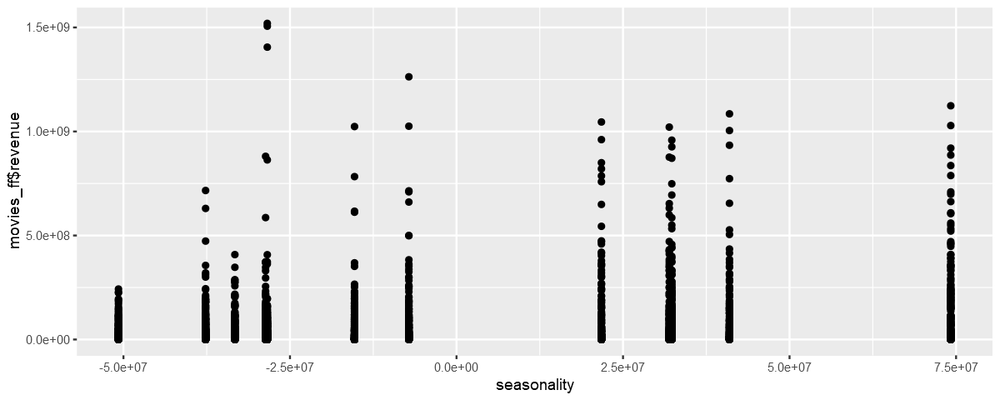

Warning message:
"Removed 4531 rows containing missing values (geom_point)."


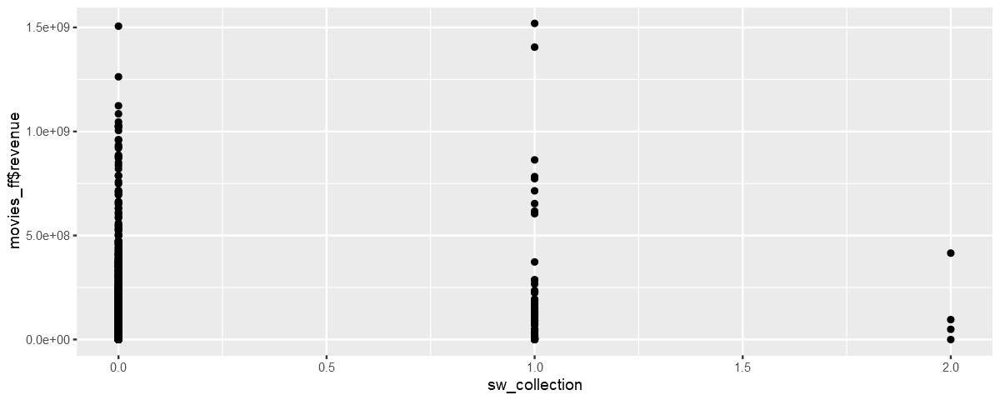

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


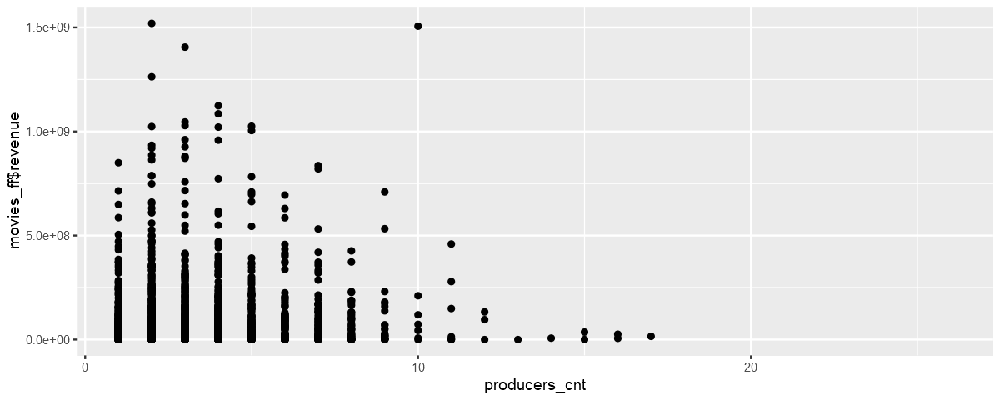

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


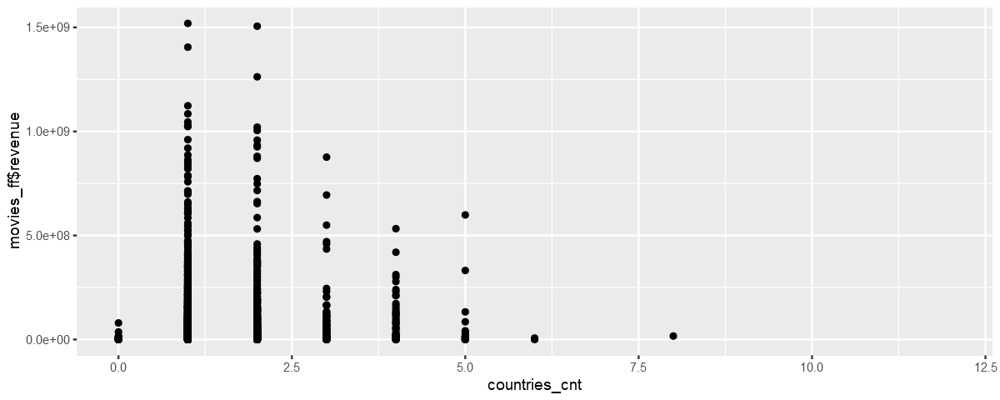

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


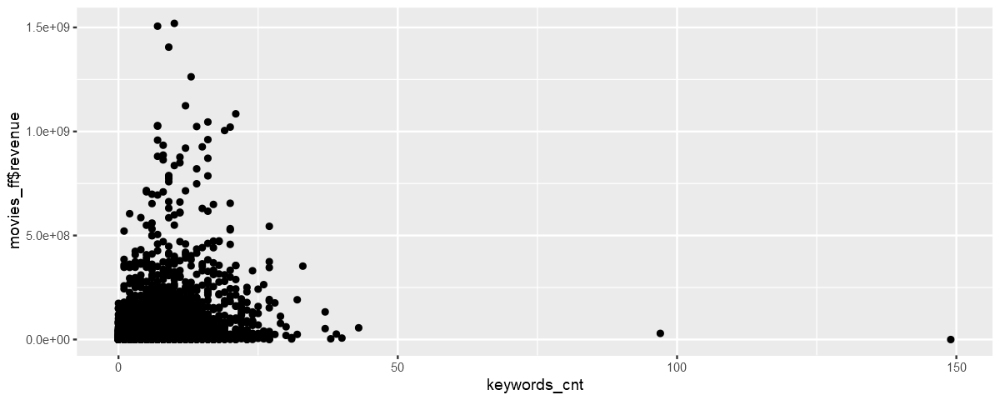

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


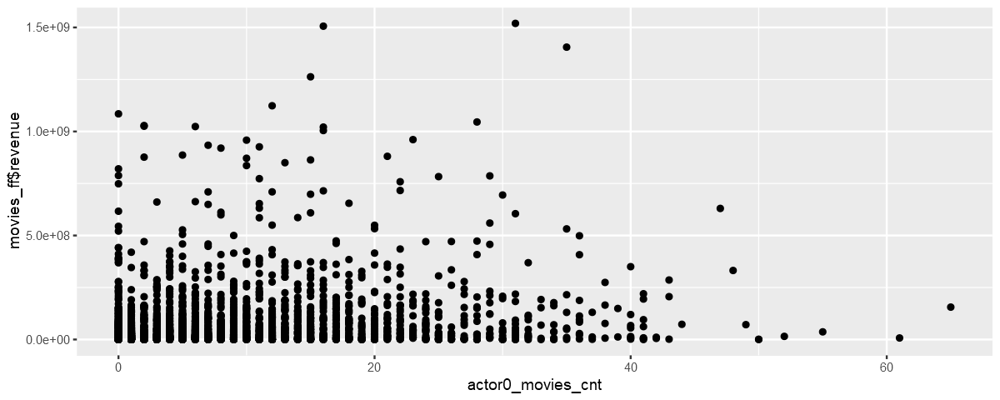

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


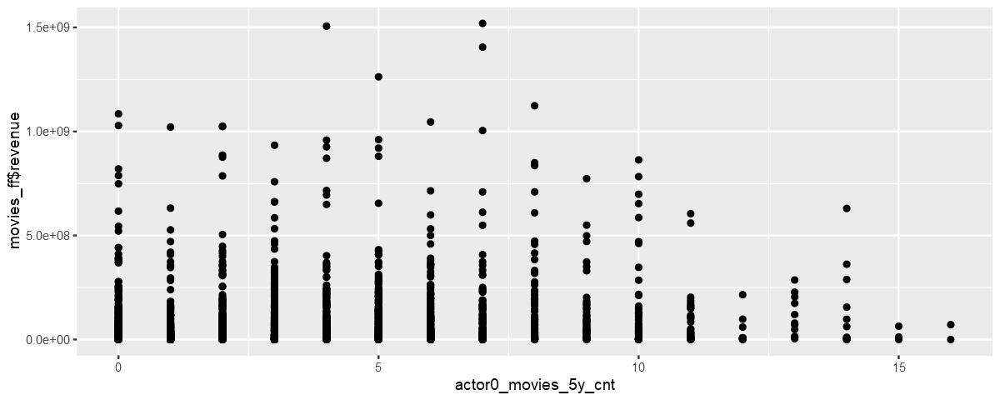

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


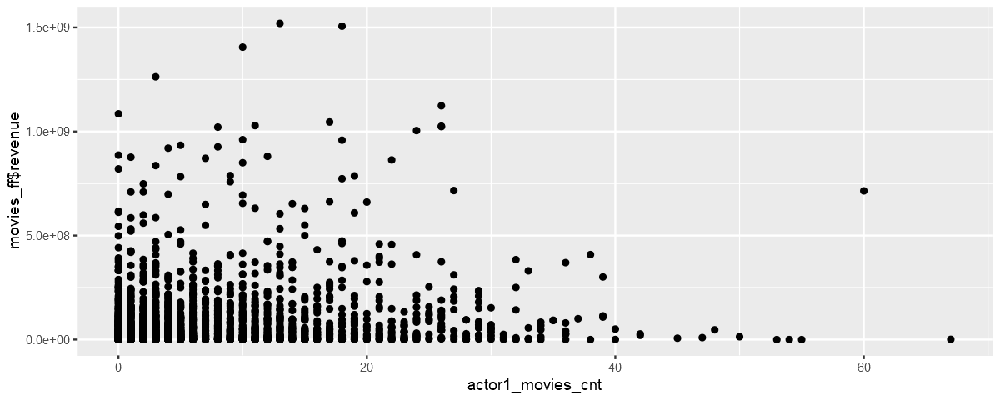

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


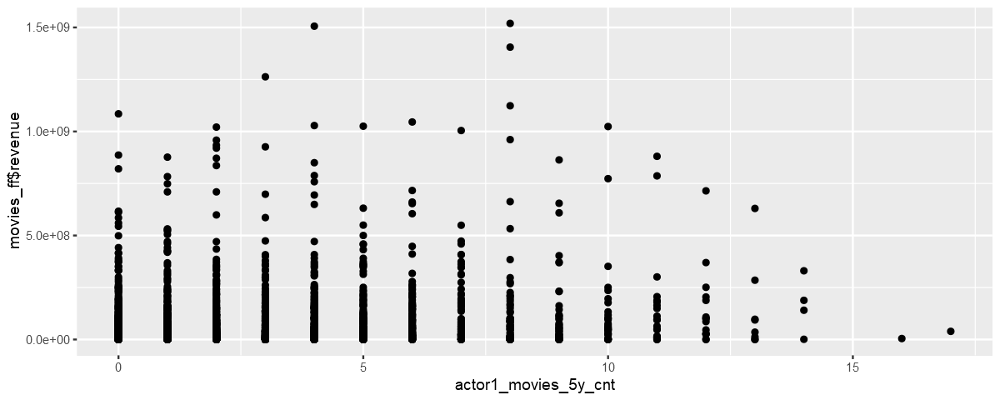

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


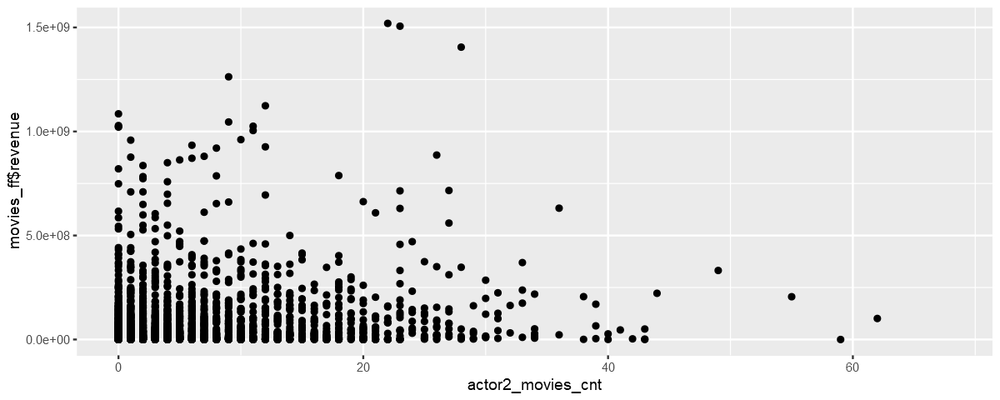

Warning message:
"Removed 5310 rows containing missing values (geom_point)."


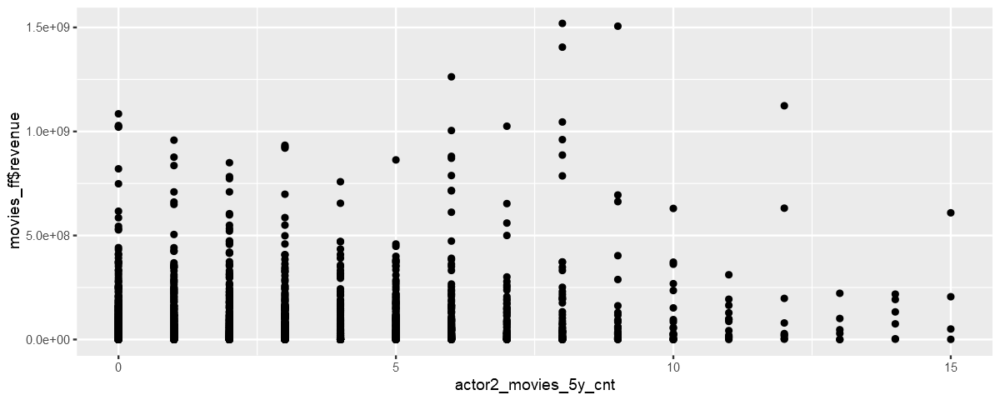

Warning message:
"Removed 5534 rows containing missing values (geom_point)."


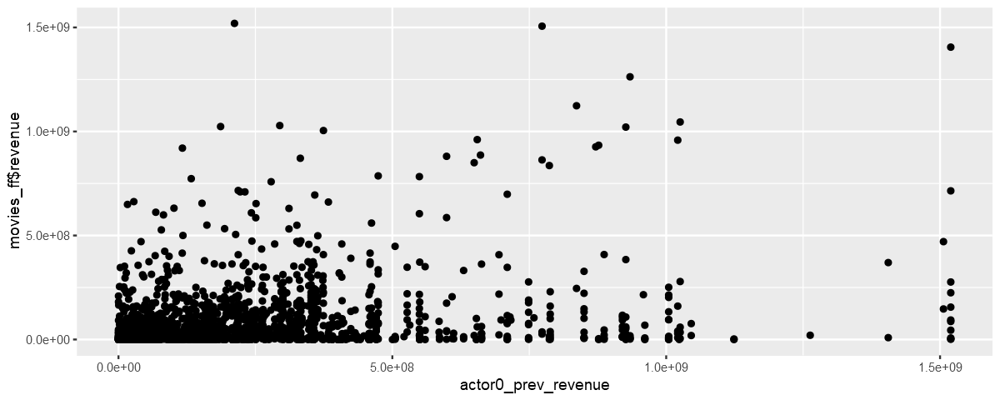

Warning message:
"Removed 5621 rows containing missing values (geom_point)."


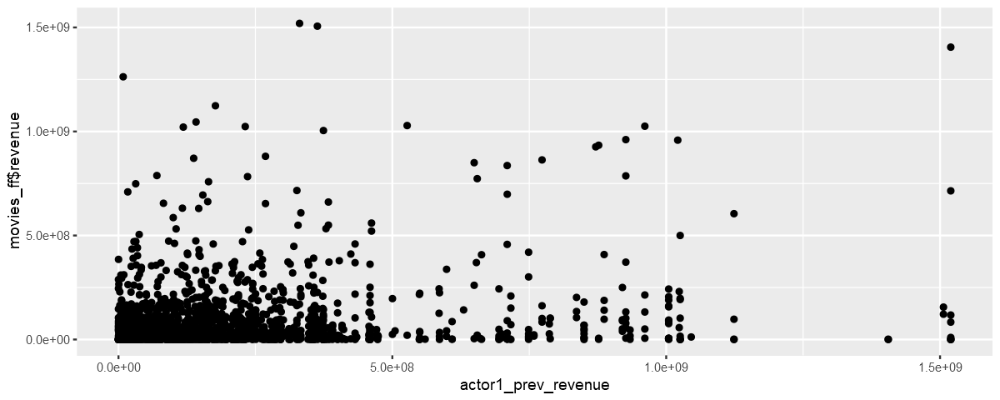

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


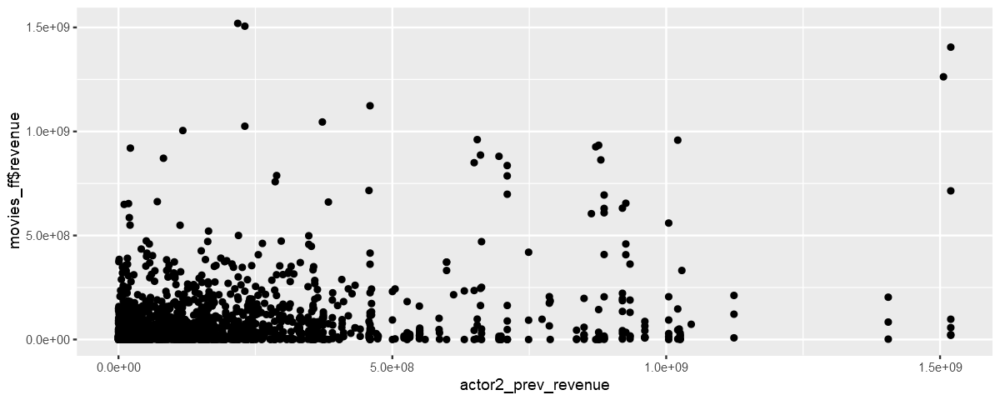

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


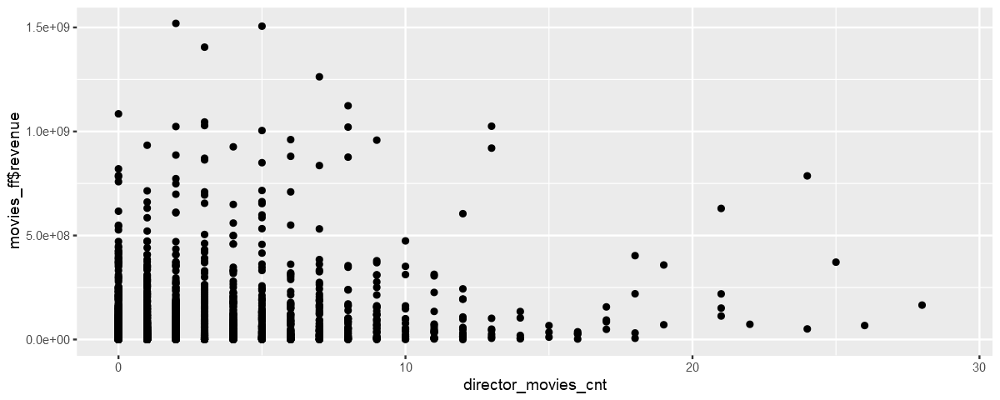

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


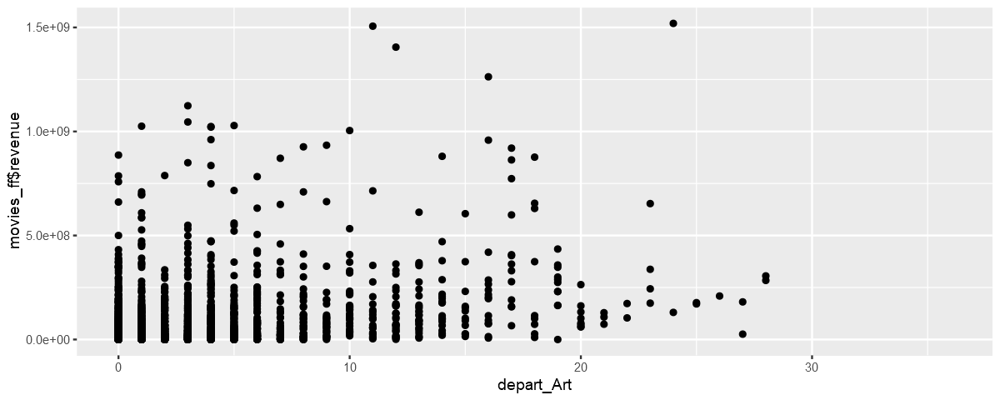

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


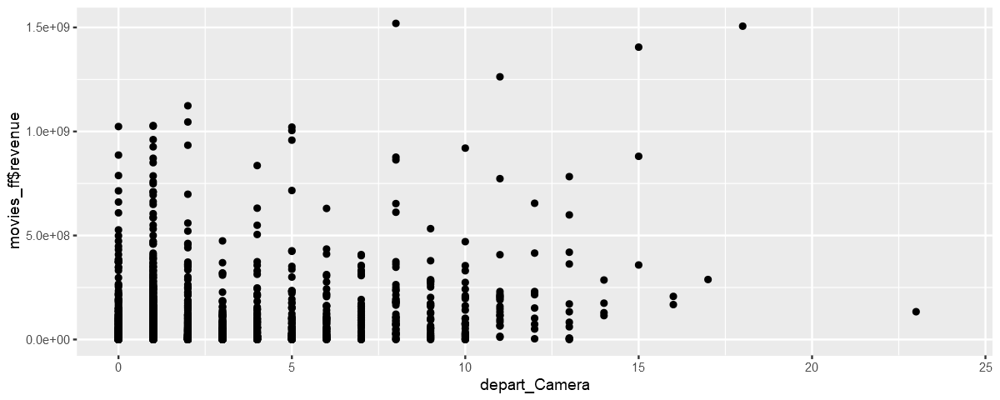

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


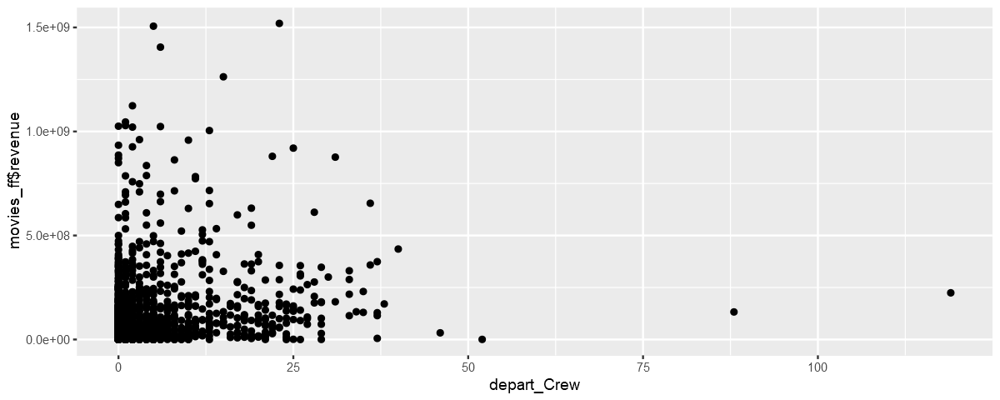

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


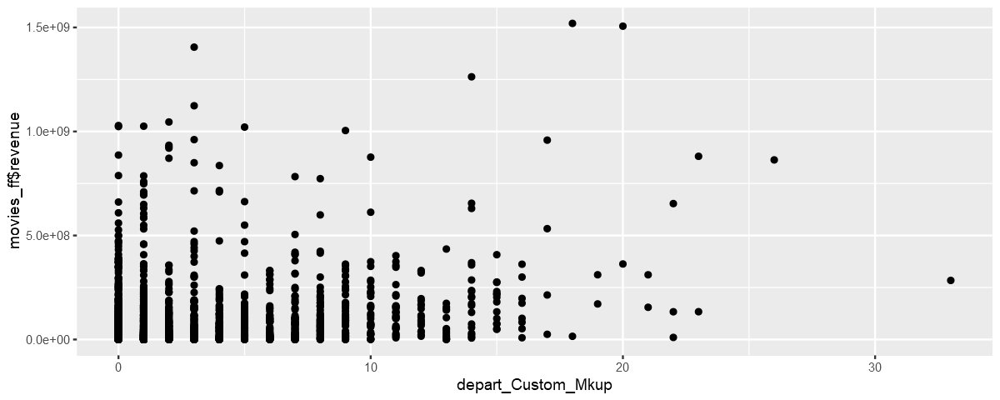

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


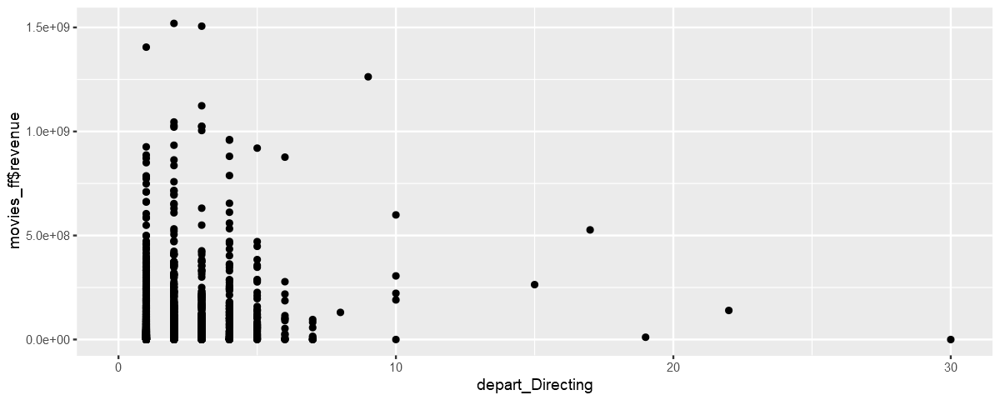

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


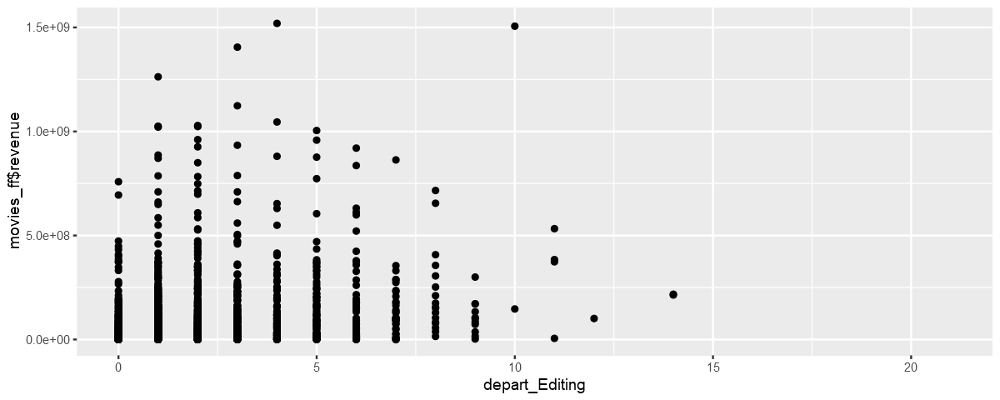

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


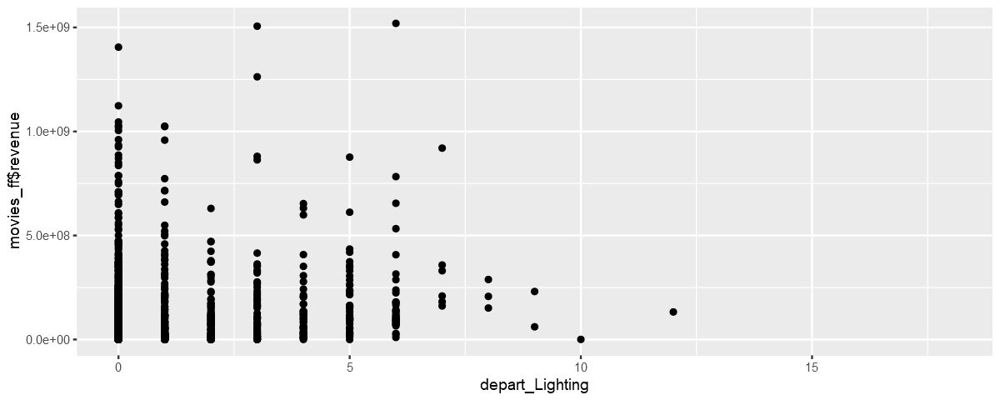

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


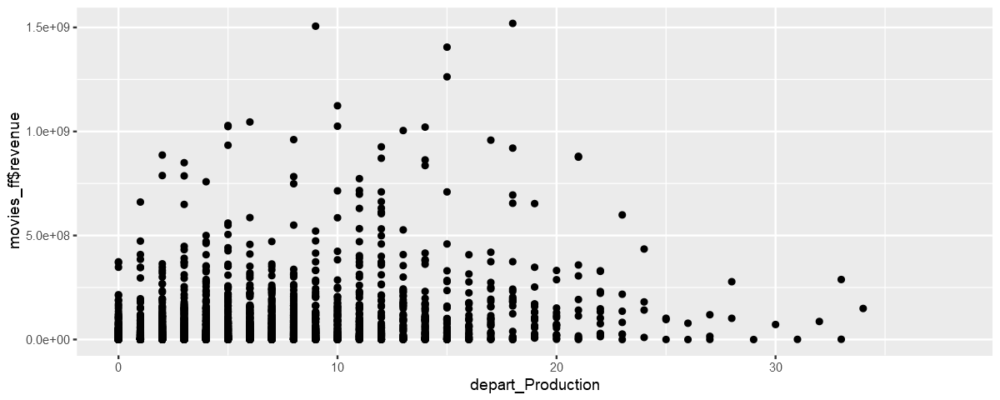

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


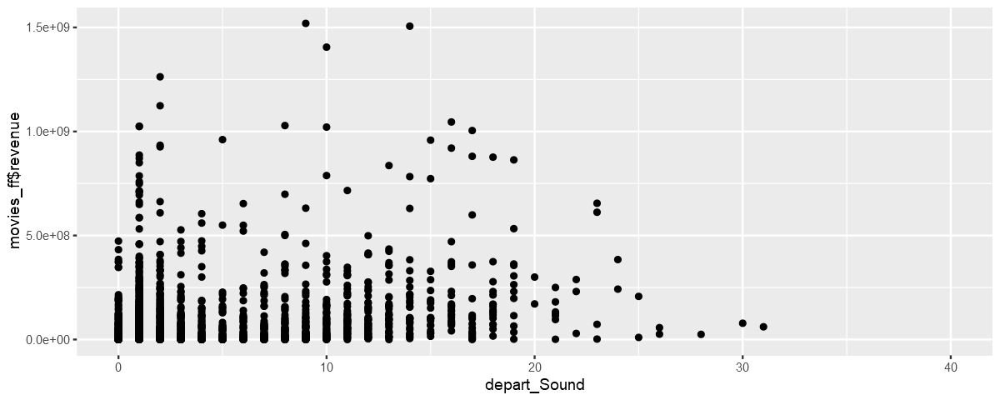

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


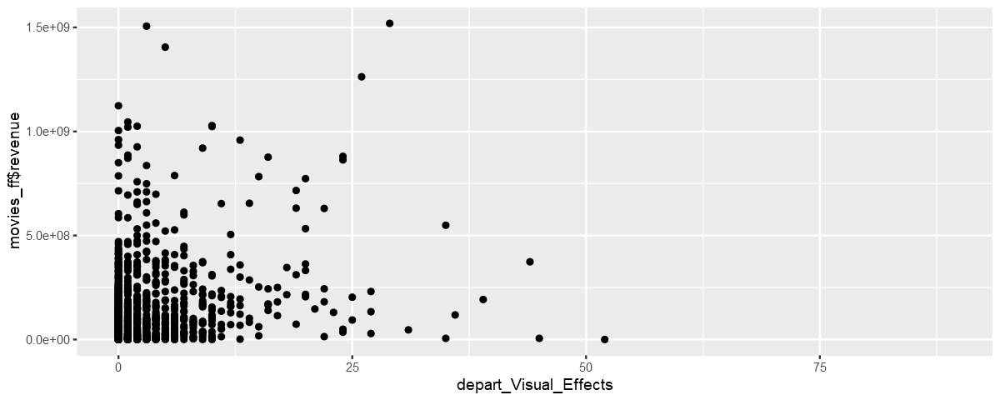

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


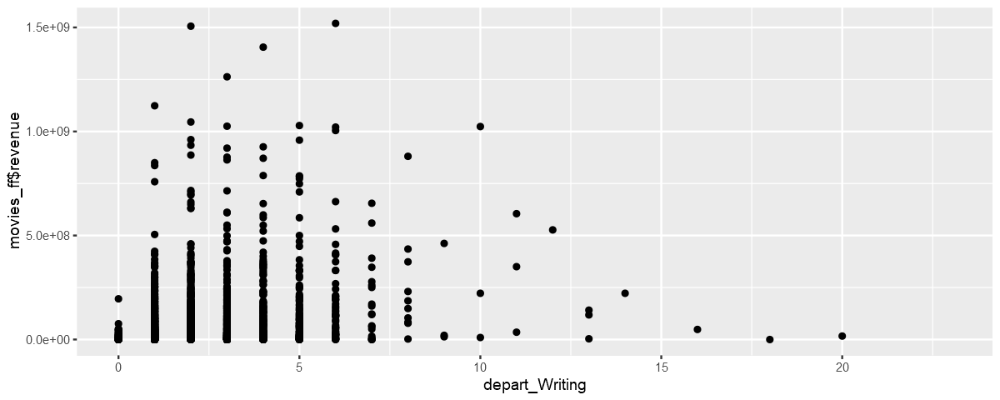

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


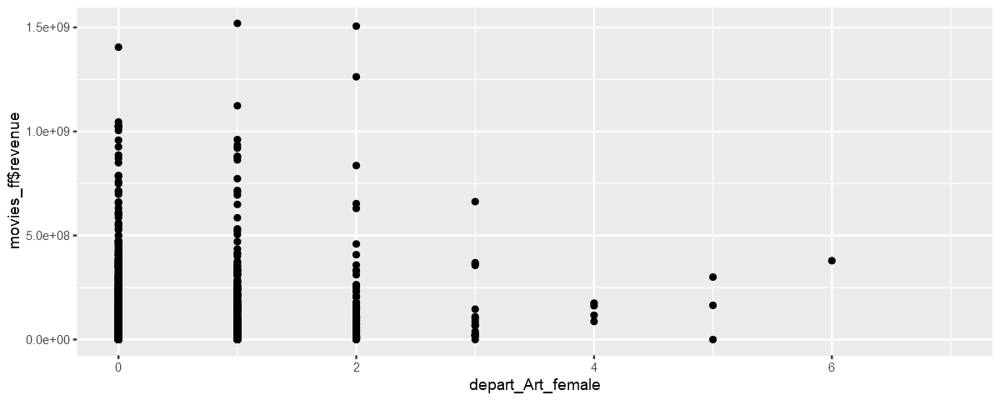

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


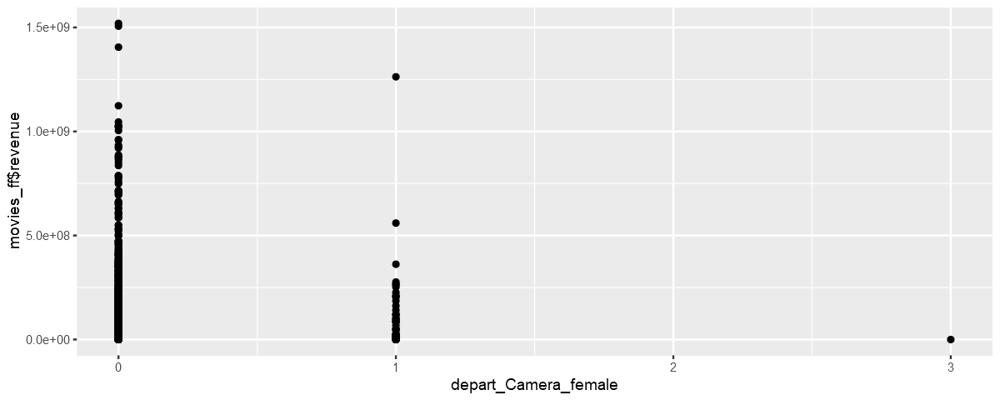

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


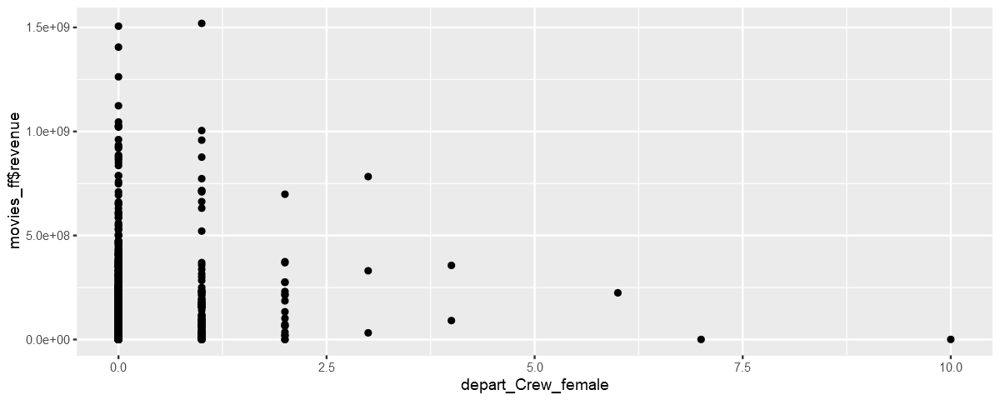

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


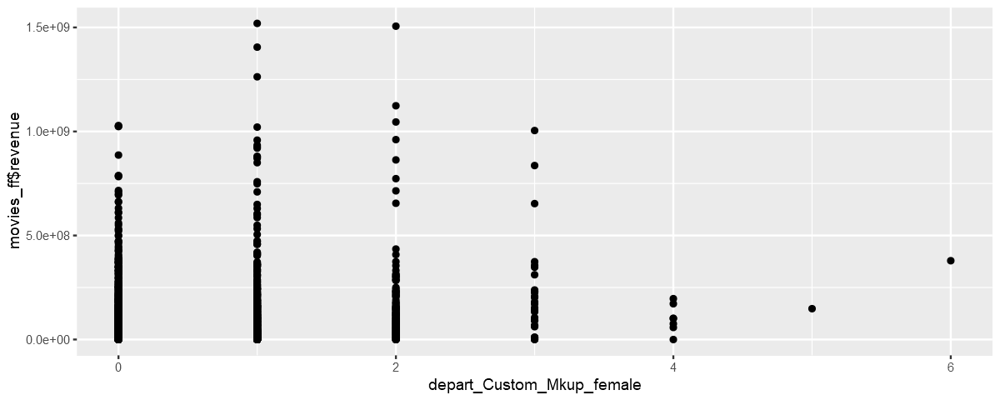

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


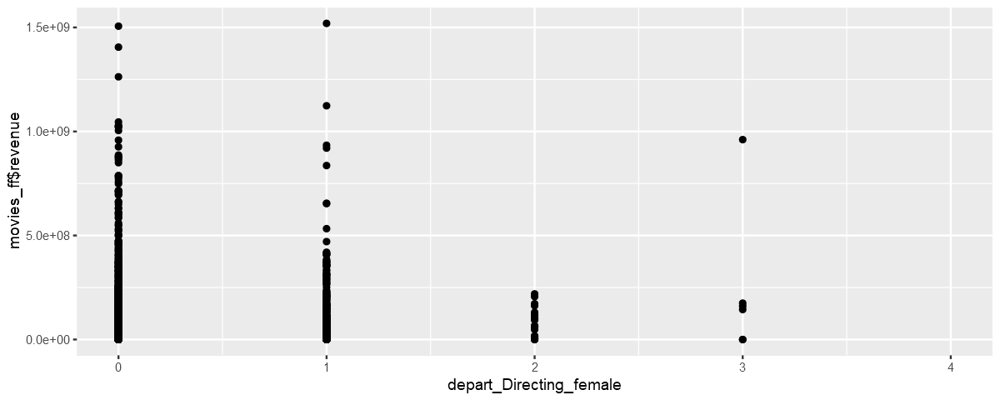

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


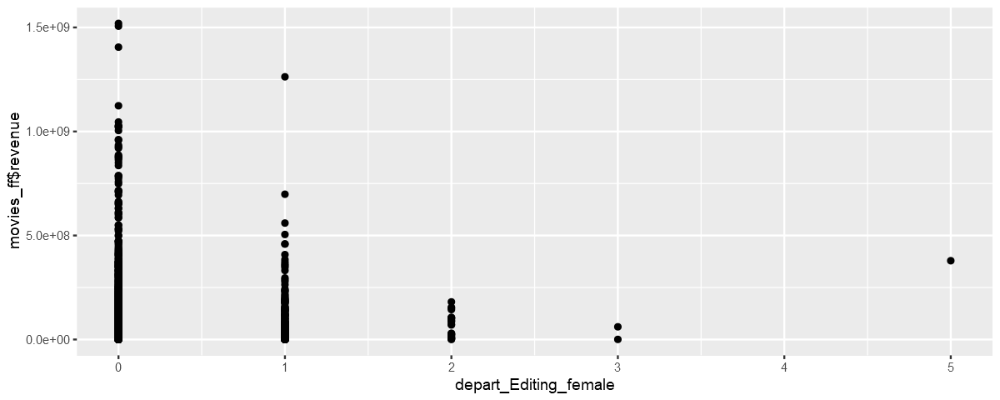

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


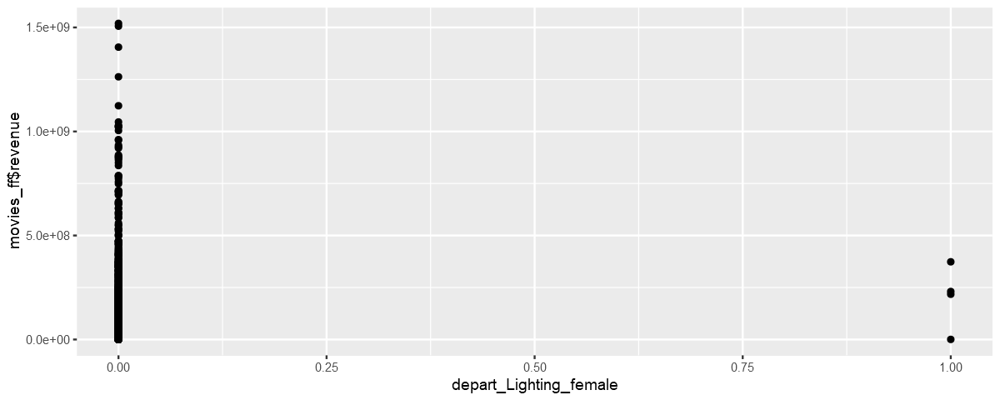

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


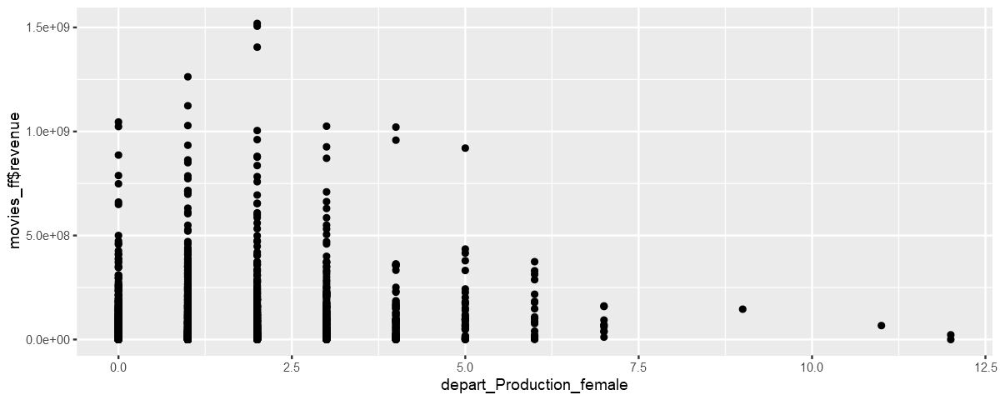

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


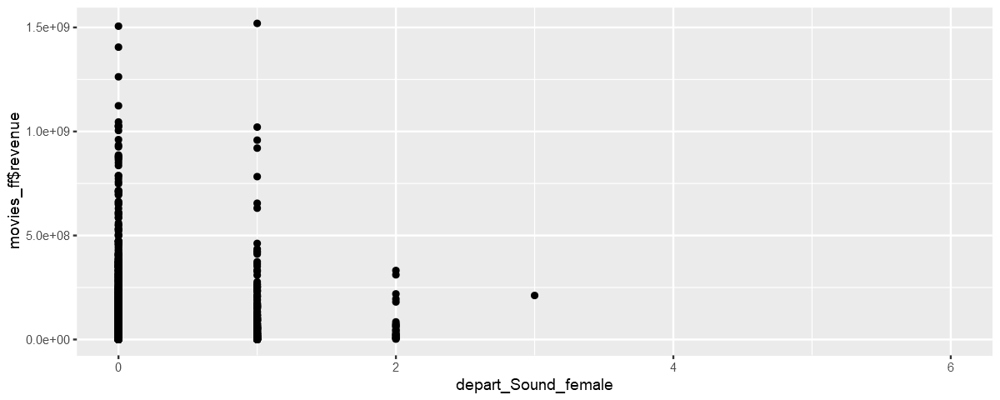

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


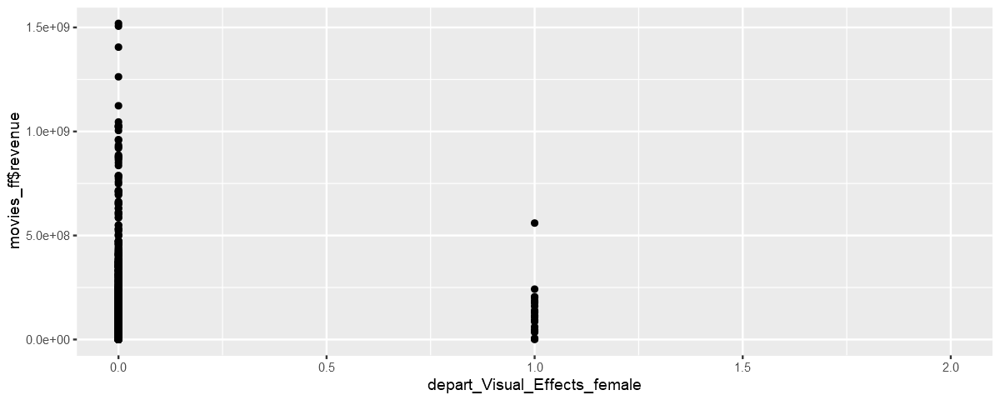

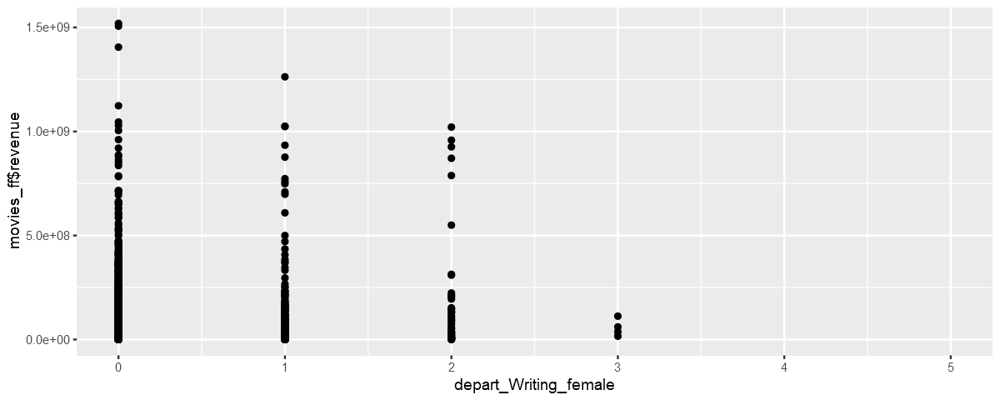

In [68]:

par(mfrow=c(2,5))

nm_cont <- names(movies_continuous2[,1:44])

for (i in 1:44) {
    print(ggplot(data=df) +
          geom_point(aes(x=movies_continuous2[,i], y=df$revenue)) +
          xlab(nm_cont[i]))
} 


## Outliers

In [20]:
outlierMatrix <- function(data,threshold=1.5) {
    vn <- setdiff(names(data),"movie_id")
    outdata <- data.frame(movie_id=data$movie_id)
    for(v in vn) {
        if(is.numeric(data[[v]])) {
            med <- median (data[[v]],na.rm=TRUE)
            outlow <- quantile(data[[v]],probs = 0.25,na.rm = T) 
            outhigh <- quantile(data[[v]],probs = 0.75, na.rm = T)
            irq_level <- (outhigh - outlow) * threshold
            outlow <- outlow - irq_level
            outhigh <- outhigh +  irq_level
            mv <- ifelse(data[[v]] < outlow | data[[v]] > outhigh, 1, 0)
            outdata[paste0(v,"_out")] <- mv
        } else {
            mv <- rep(0,nrow(data))
        }
    }
    outdata$row1 <- NULL
    return(outdata)
}

df_outliers <- outlierMatrix(df)

In [16]:
## Using IRQ for catching univariate outliers (1.5 x IRQ) 1==Outliers
head(outlierMatrix(df,threshold=1.5))


,movie_id,runtime_out,budget_out,popularity_out,revenue_out,sw_lang_en_out,sw_web_presence_out,sw_has_poster_out,sw_tagline_out,release_year_out,...,depart_Camera_female_out,depart_Crew_female_out,depart_Custom_Mkup_female_out,depart_Directing_female_out,depart_Editing_female_out,depart_Lighting_female_out,depart_Production_female_out,depart_Sound_female_out,depart_Visual_Effects_female_out,depart_Writing_female_out
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3,3,0,0,1,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
4,4,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
5,5,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
6,6,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


In [17]:
for (i in 2:length(movies_outliers)){
    no_outliers <- movies_outliers
    no_outliers <- ifelse(movies_outliers[[i]]==1, NA, 0)
}


Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


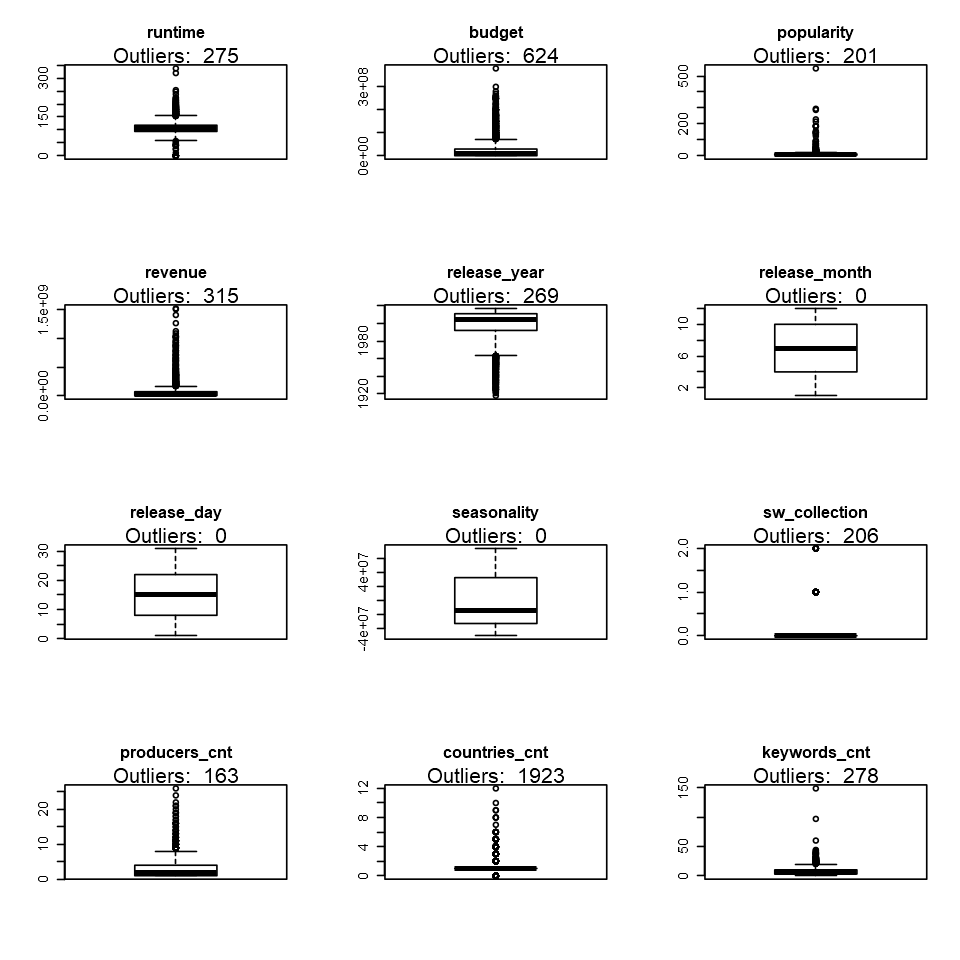

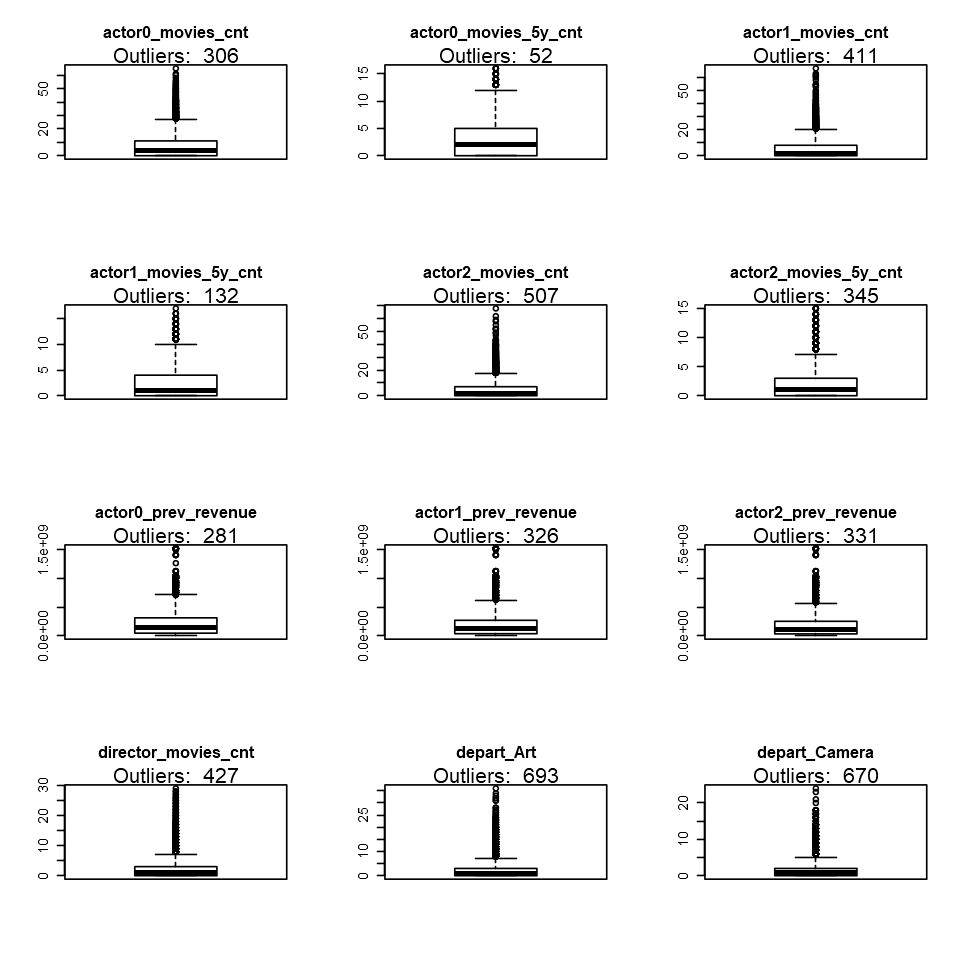

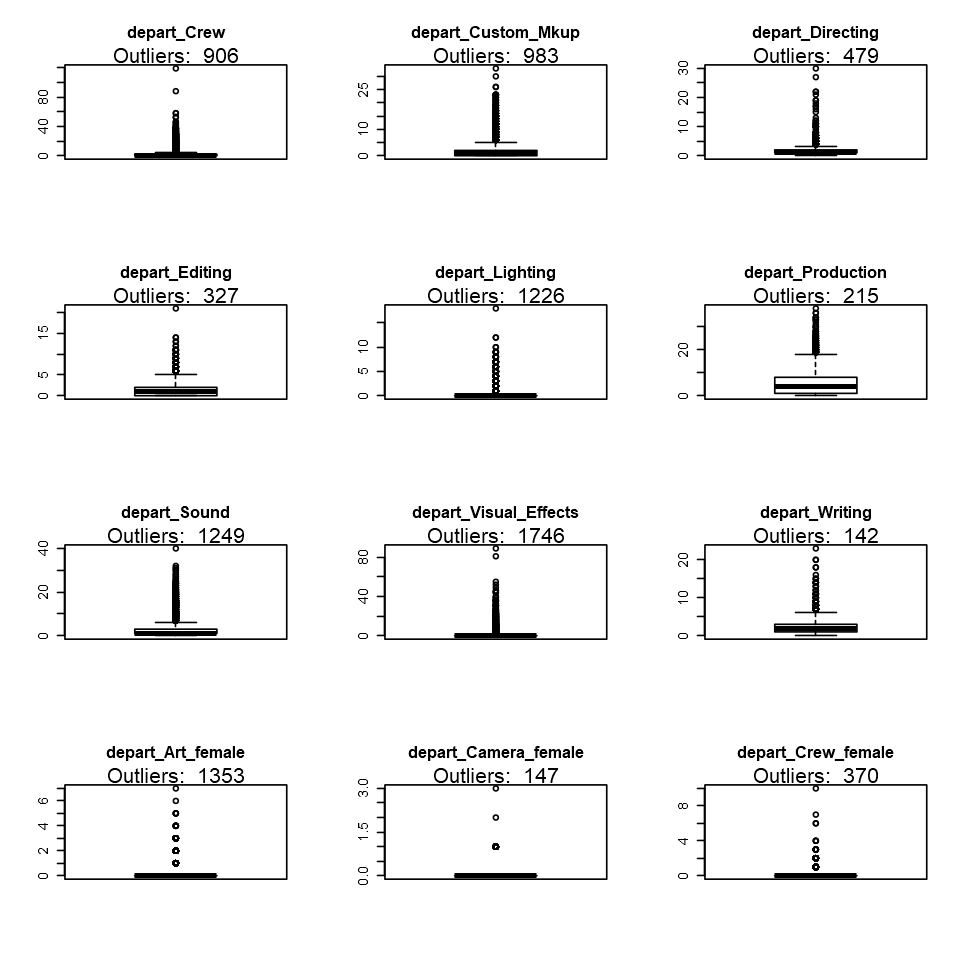

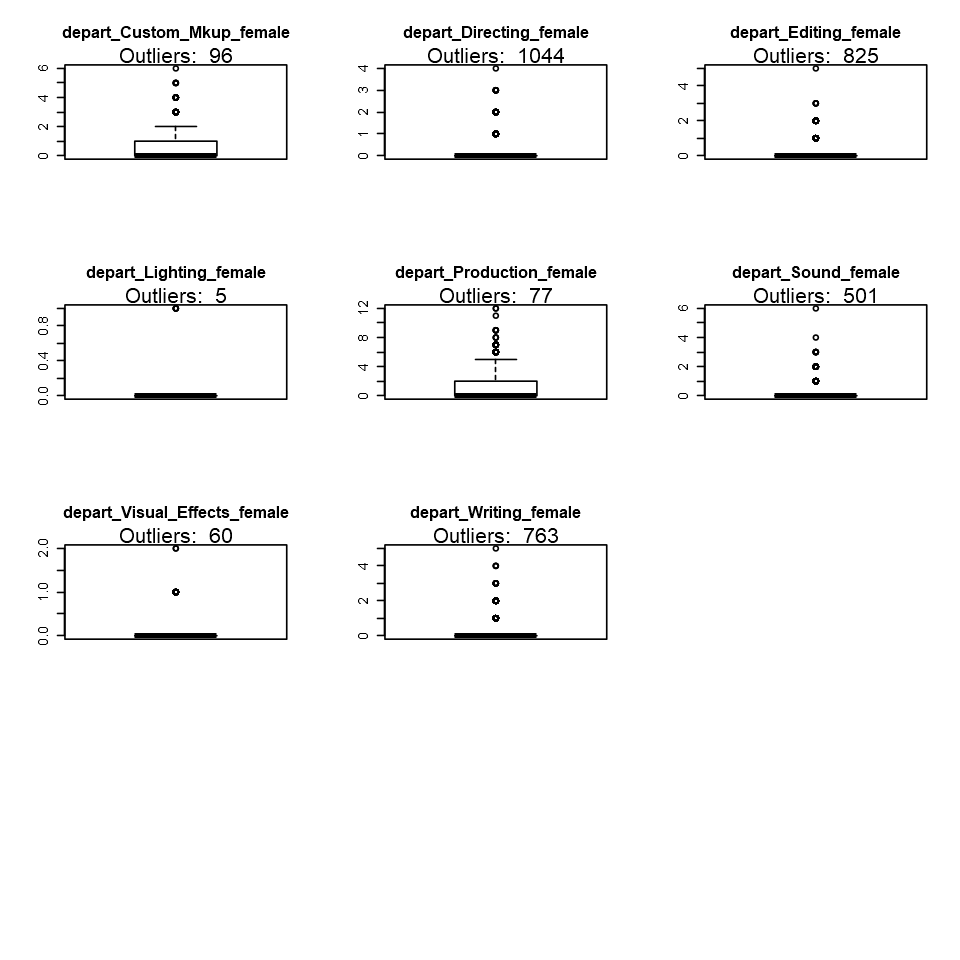

In [71]:
## from some reason i couldn't run this code with 'movies_continuous' which i've created with a loop, therefore i've created
## a "stupid" object called 'movies_continuous2' which i've created by hand.. i spent a lot of time trying to figure out 
## the error with no succsess

## Visual determination of univariate outliers using boxplots + outliers count
options(repr.plot.width = 8, repr.plot.height = 8)
par(mfrow=c(4,3))
for(v in names(movies_continuous2[,1:44])) {
    outlier_values <- boxplot.stats(movies_continuous2[,v])$out
    boxplot(df[[v]],main=v)
    mtext(paste("Outliers: ", paste(length(outlier_values), collapse=", ")), cex=1)
}
par(mfrow=c(1,1))

## Missingness

In [18]:
getMissingness <- function (data, getRows = FALSE) {
    require(dplyr)
    l <- nrow(data)
    vn <- names(data)
    nadf <- data
    cnt <- NULL
    miss <- function(x) return(sum(is.na(x)))
    for (n in vn) {
        nadf[[n]] <- ifelse(is.na(nadf[[n]]) == T, 1, 0)
        cnt <- rbind(cnt, data.frame(n, sum(nadf[[n]])))
    }
    names(cnt) <- c("var", "na.count")
    cnt$rate <- round((cnt$na.count/nrow(nadf)) * 100, 1)
    nadf$na.cnt <- 0
    nadf$na.cnt <- rowSums(nadf)
    cnt <- cnt %>% dplyr::arrange(desc(na.count)) %>% dplyr::filter(na.count > 
        0)
    totmiss <- nadf %>% dplyr::filter(na.cnt == 0) %>% dplyr::tally()
    idx <- NULL
    msg <- (paste("This dataset has ", as.character(totmiss), 
        " (", as.character(round(totmiss/nrow(data) * 100, 1)), 
        "%)", " complete rows. Original data has ", nrow(data), 
        " rows.", sep = ""))
    if (getRows == TRUE & totmiss != 0) {
        nadf$rn <- seq_len(nrow(data))
        idx <- nadf %>% dplyr::filter(na.cnt == 0) %>% dplyr::select(rn)
    }
    print(list(head(cnt, n = 10), msg))
    return(list(missingness = cnt, message = msg, rows = idx$rn))
}

In [13]:
getMissingness(df)

[[1]]
                   var na.count rate
1              revenue     4382 59.4
2  actor2_prev_revenue     3423 46.4
3  actor1_prev_revenue     3201 43.4
4  actor0_prev_revenue     2752 37.3
5     sw_female_actor0      934 12.7
6       sw_male_actor0      934 12.7
7     sw_female_actor2      788 10.7
8       sw_male_actor2      788 10.7
9     sw_female_actor1      782 10.6
10      sw_male_actor1      782 10.6

[[2]]
[1] "This dataset has 1154 (15.6%) complete rows. Original data has 7375 rows."



var,na.count,rate
<fct>,<dbl>,<dbl>
revenue,4382,59.4
actor2_prev_revenue,3423,46.4
actor1_prev_revenue,3201,43.4
actor0_prev_revenue,2752,37.3
sw_female_actor0,934,12.7
sw_male_actor0,934,12.7
sw_female_actor2,788,10.7
sw_male_actor2,788,10.7
sw_female_actor1,782,10.6


In [19]:
missingMatrix <- function(data) {
    vn <- setdiff(names(data),"movie_id")
    missdata <- data.frame(movie_id=data$movie_id)
    for(v in vn) {
        mv <- ifelse(is.na(data[[v]]),1,0)
        missdata[v] <- mv
    }
    missdata$row1 <- NULL
    return(missdata)
}
df_missing <- missingMatrix(data=df)
head(df_missing)

,movie_id,original_language,release_date,runtime_cat,runtime,budget,popularity,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,5,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,6,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Loading required package: naniar

Warning message:
"package 'naniar' was built under R version 3.6.2"
Warning message:
"`cols` is now required.
Please use `cols = c(data)`"


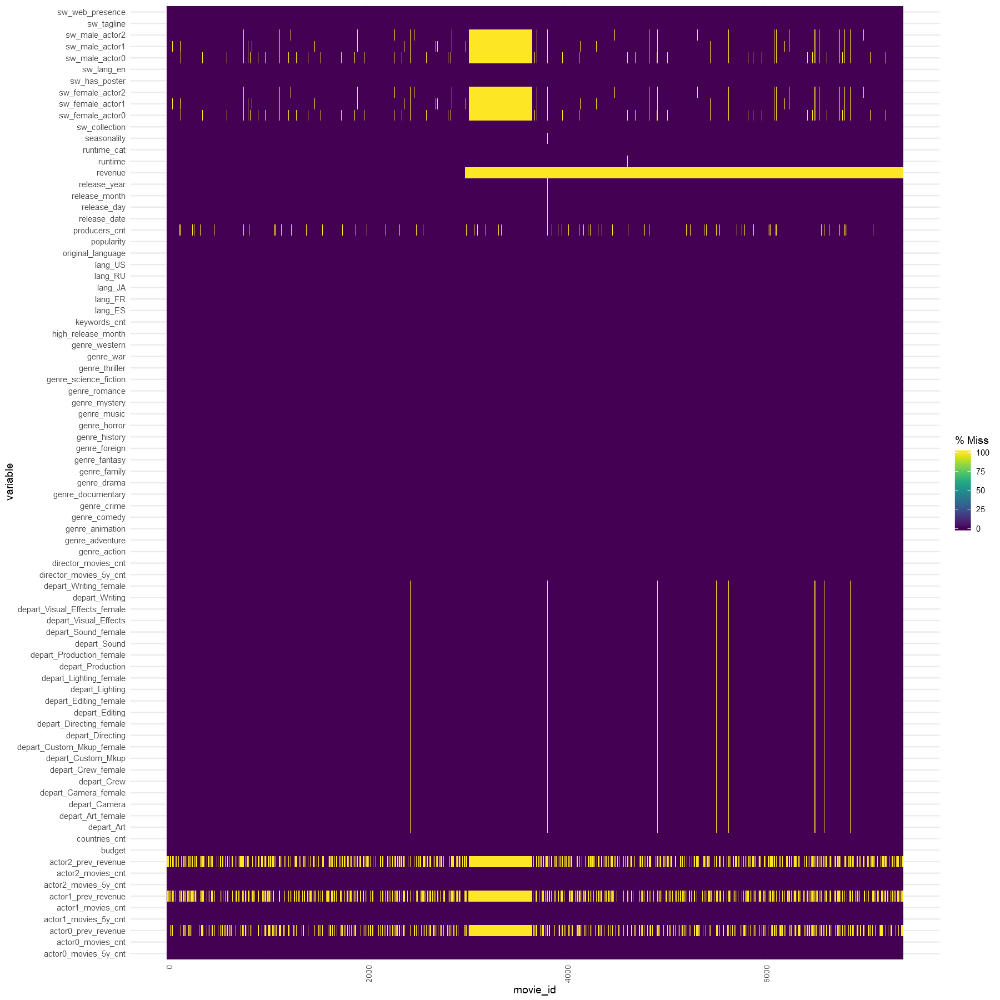

In [75]:
if(!require(naniar)) {install.packages("naniar");require(naniar)}
library(naniar)
options(repr.plot.width = 15, repr.plot.height = 15)

gg_miss_fct(x=df, fct=movie_id) + 
theme(axis.text.x = element_text(angle=90, size=8))

In [14]:
if (!require("VIM")) install.packages("VIM")

Loading required package: VIM

Loading required package: colorspace

Loading required package: grid

Loading required package: data.table

Warning message:
"package 'data.table' was built under R version 3.6.2"

Attaching package: 'data.table'


The following objects are masked from 'package:dplyr':

    between, first, last


VIM is ready to use. 
 Since version 4.0.0 the GUI is in its own package VIMGUI.

          Please use the package to use the new (and old) GUI.


Suggestions and bug-reports can be submitted at: https://github.com/alexkowa/VIM/issues


Attaching package: 'VIM'


The following object is masked from 'package:datasets':

    sleep




In [21]:
df.na <- df
for(i in names(df)) {
    df.na[,i] <- ifelse(is.na(df.na[,i])==T,1,0)
}

In [22]:
head(df.na)

,movie_id,original_language,release_date,runtime_cat,runtime,budget,popularity,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Warning message in brewer.pal(n = ncol(movies_ff), name = "RdYlBu"):
"n too large, allowed maximum for palette RdYlBu is 11
Returning the palette you asked for with that many colors
"


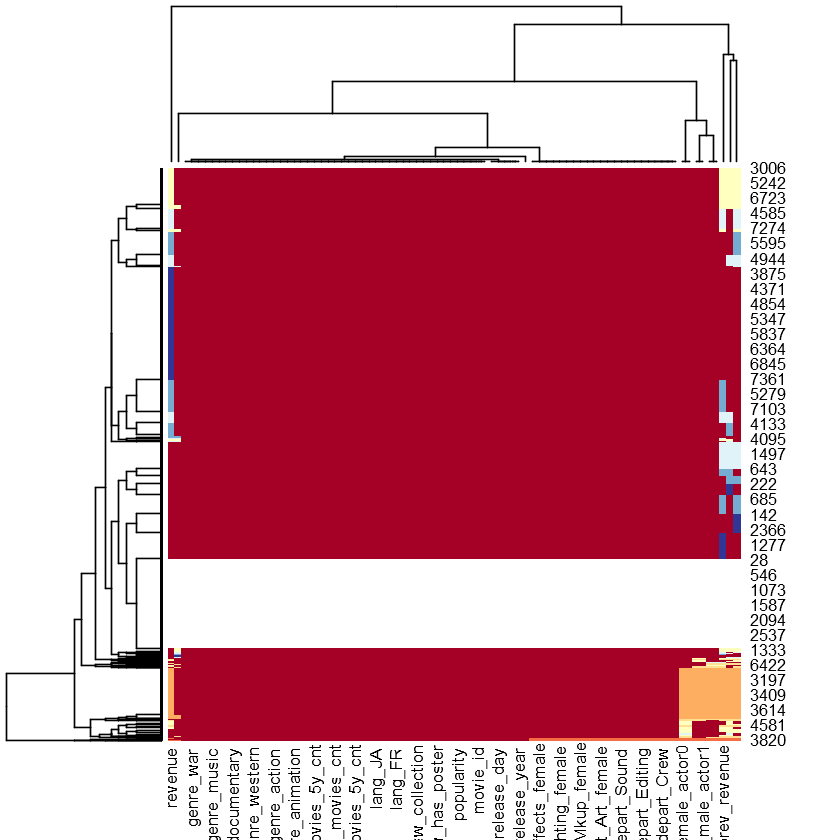

In [20]:
heatmap(as.matrix(df.na),cexCol = 1, cexRow = 1, col=brewer.pal(n=ncol(df), name="RdYlBu"))

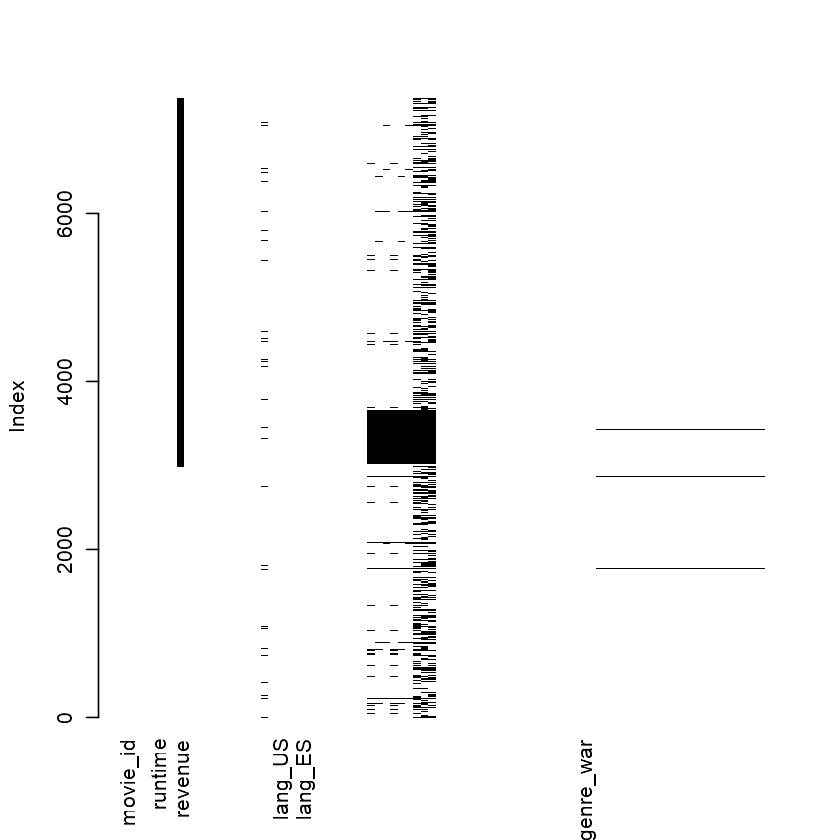

In [22]:
matrixplot(as.matrix(df.na))

# 3 - Data Cleansing

## 3.1 Outleirs

### 3.1.1 For the variables where outliers were found, check the distribution with/without outliers

Joining, by = "movie_id"
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


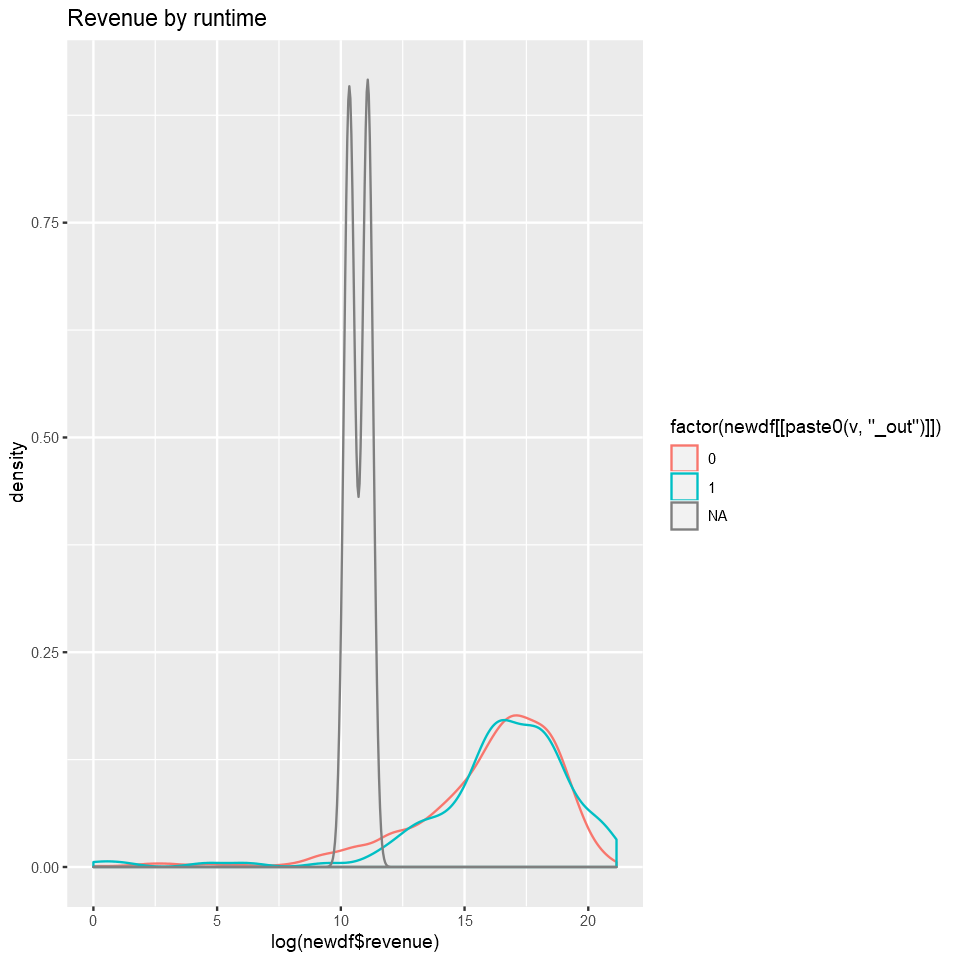

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


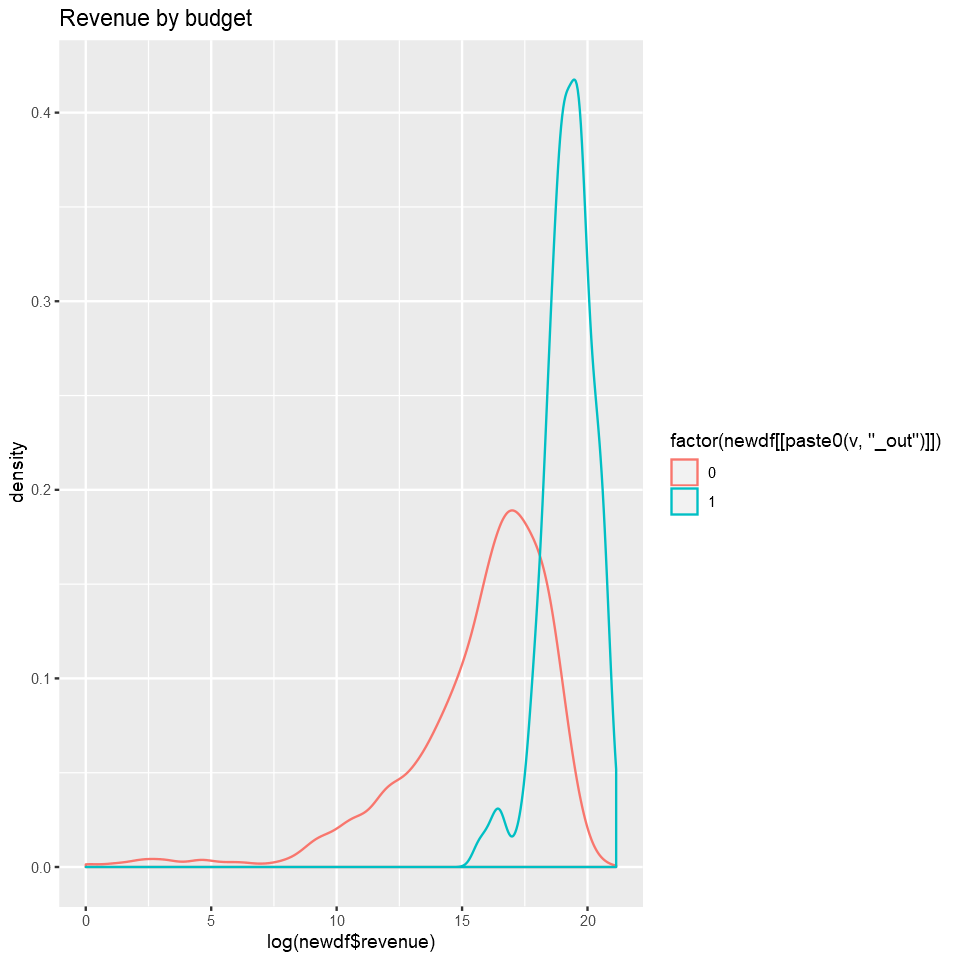

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


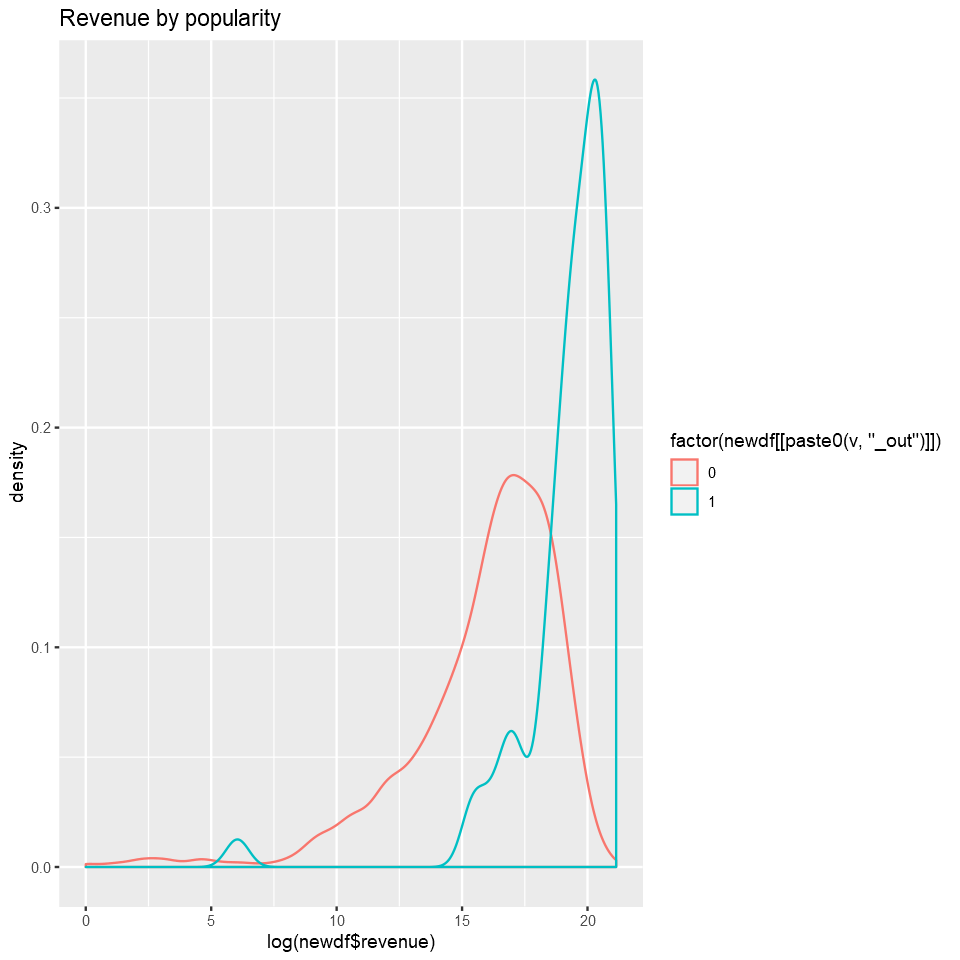

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


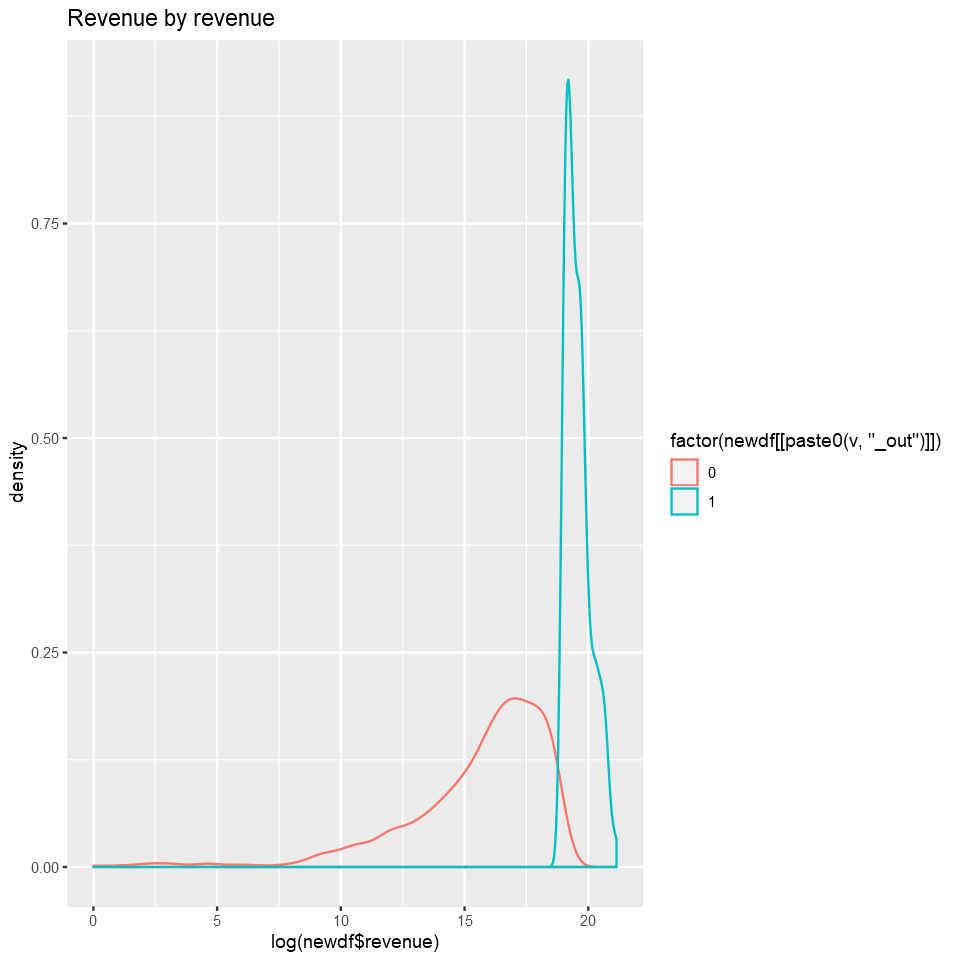

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


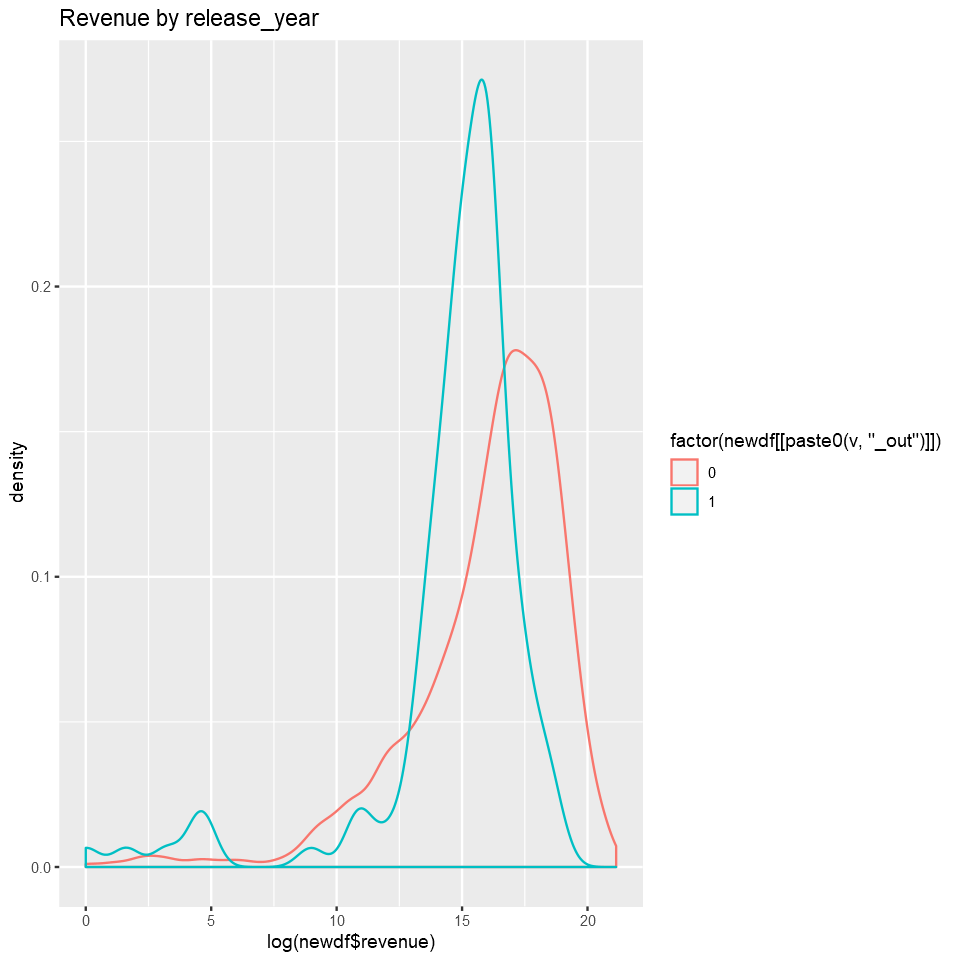

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


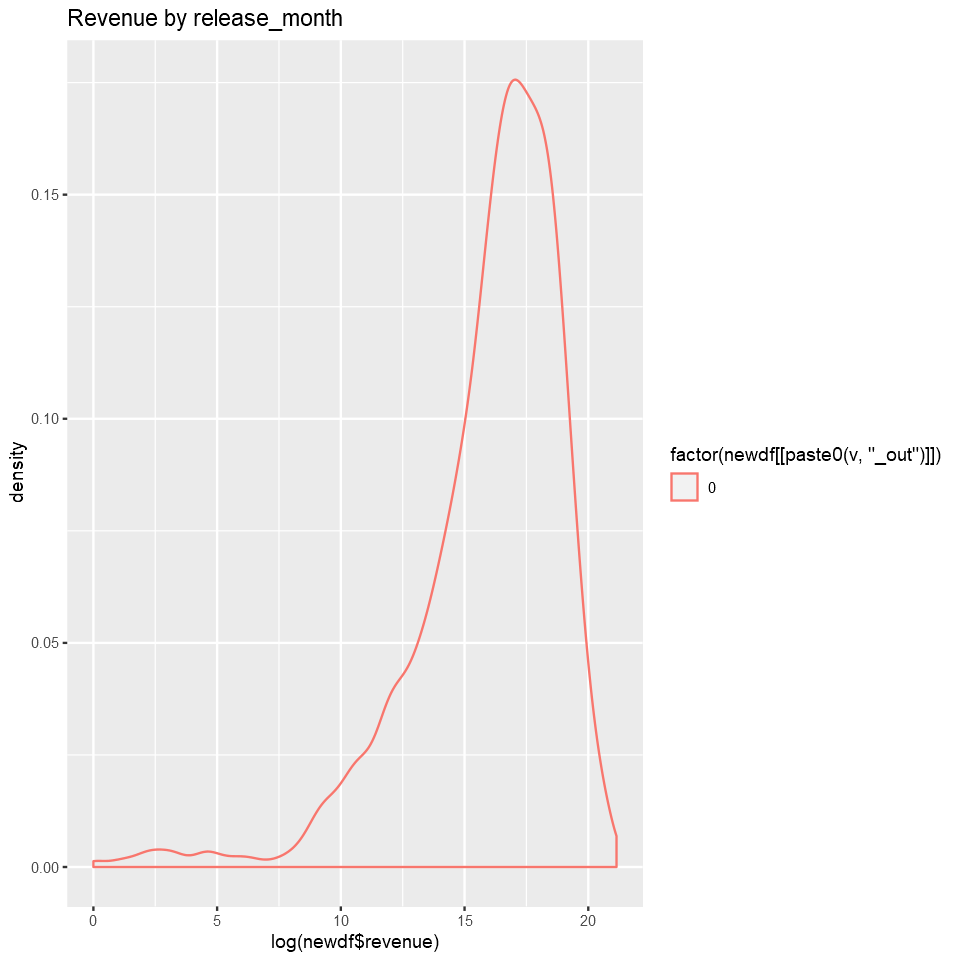

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


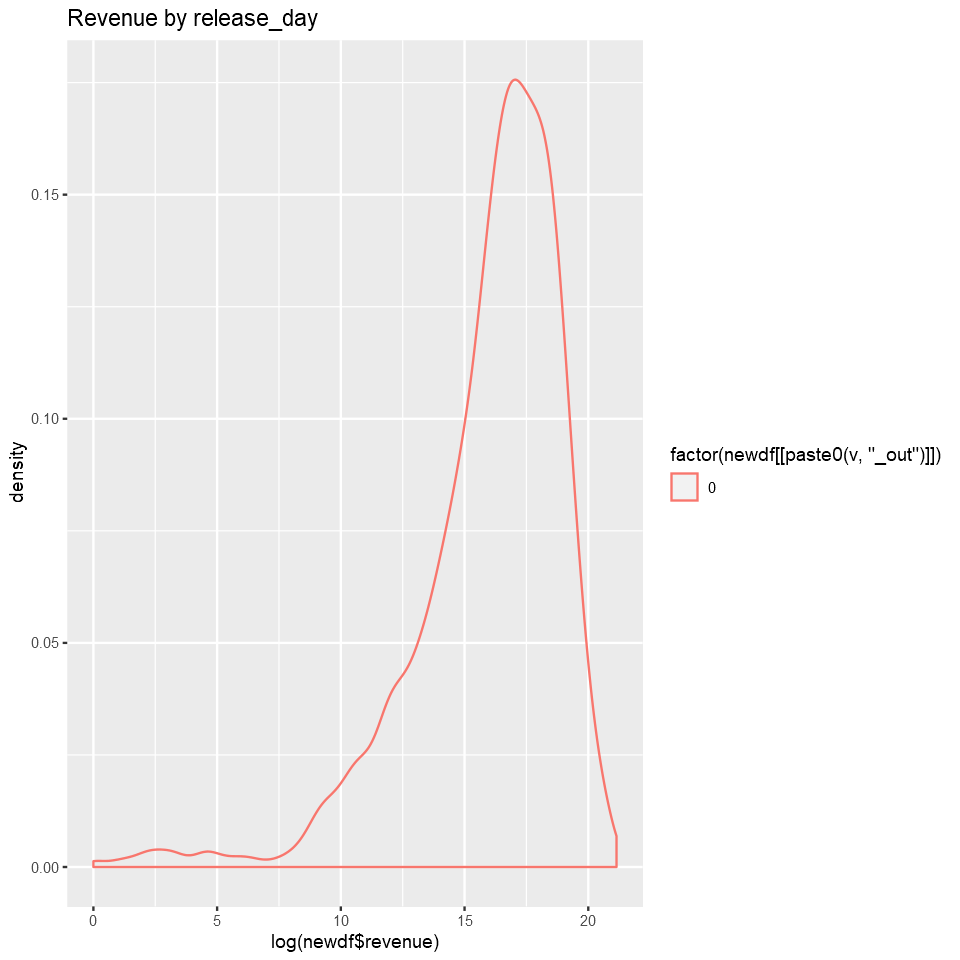

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


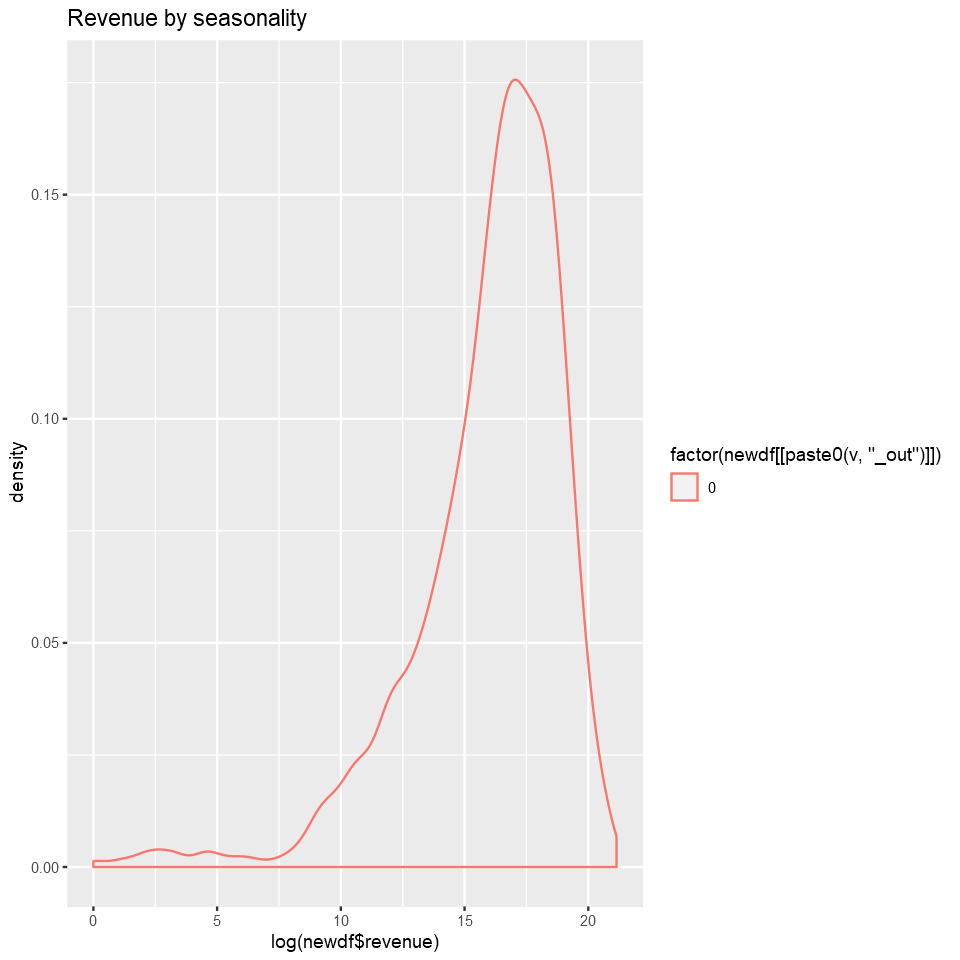

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


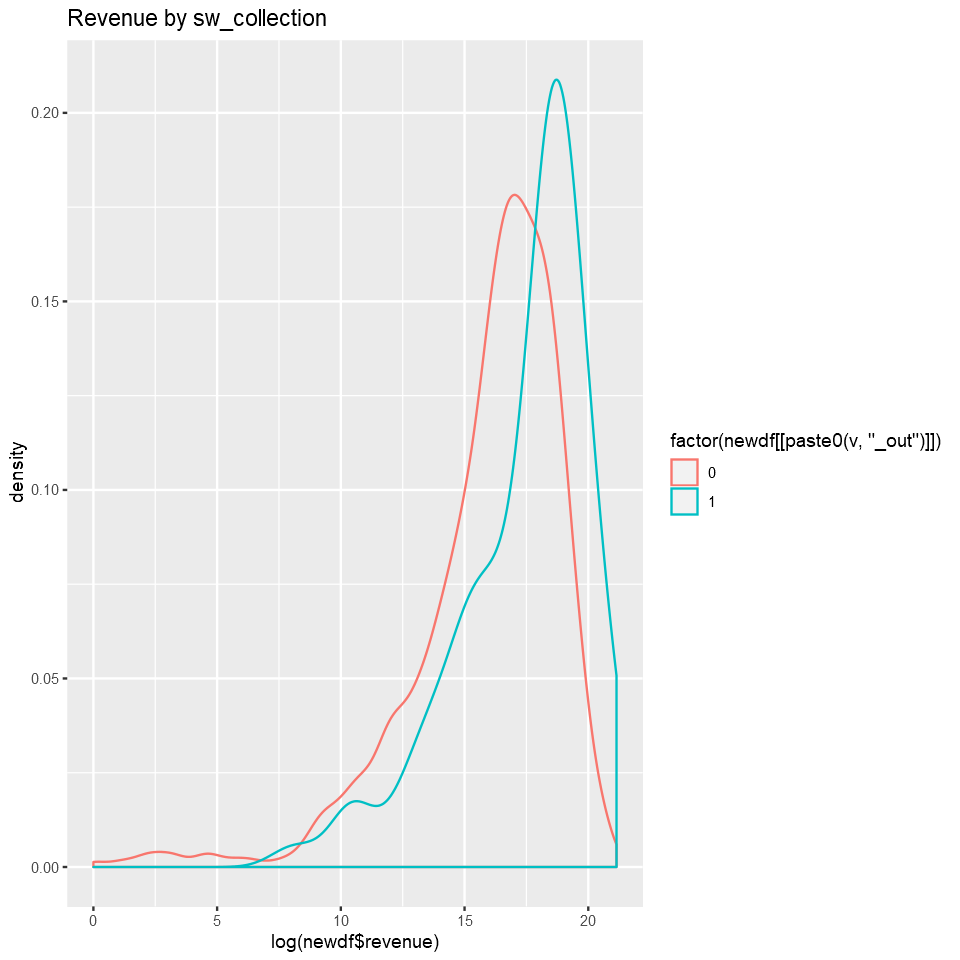

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


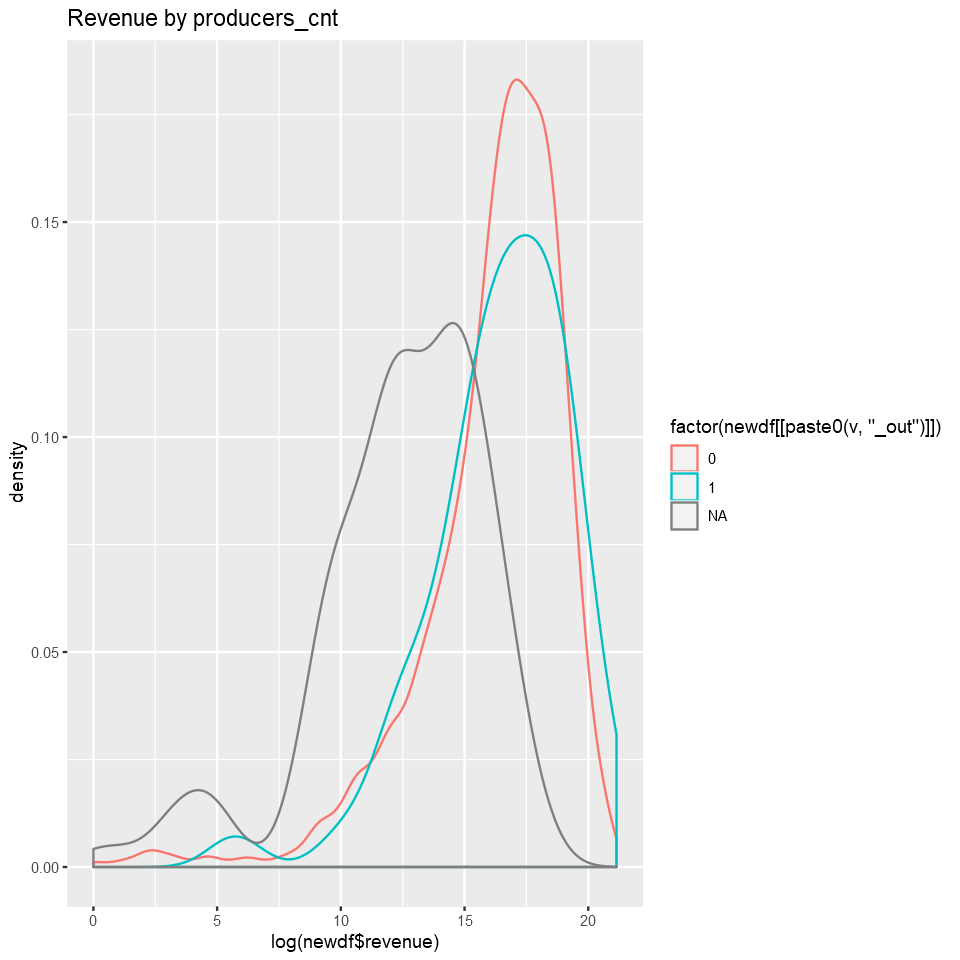

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


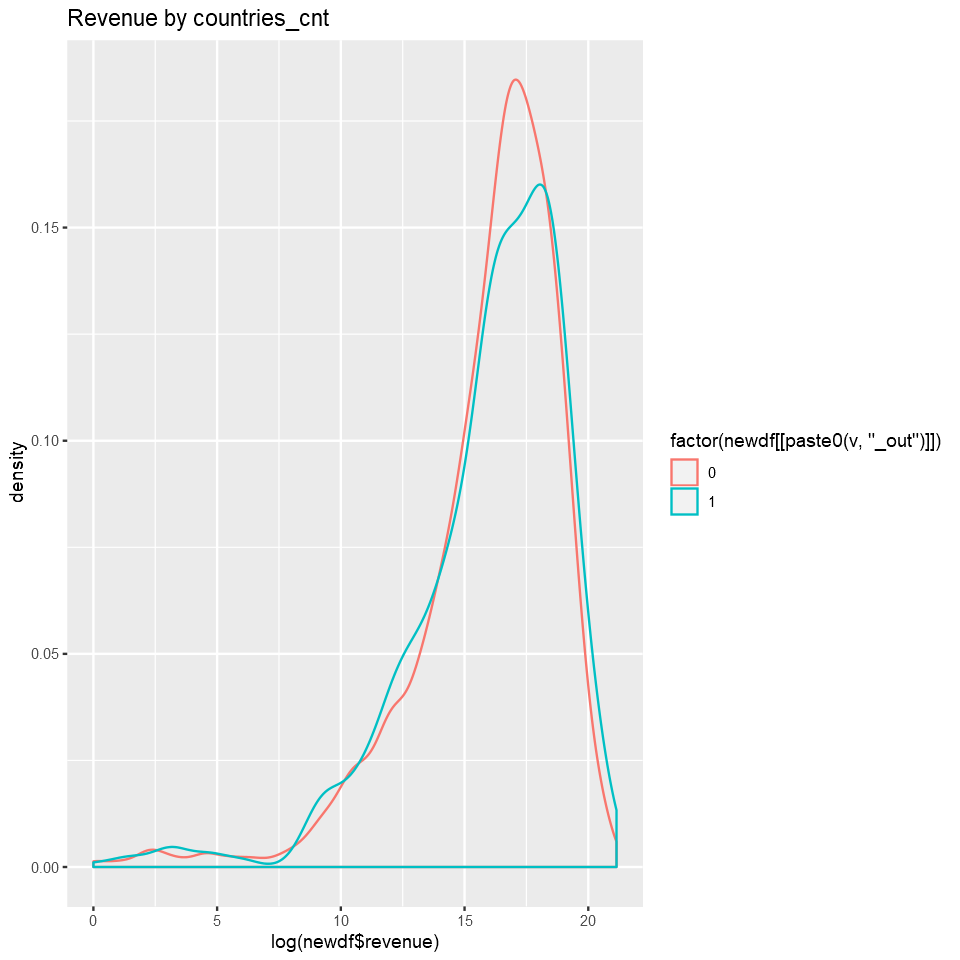

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


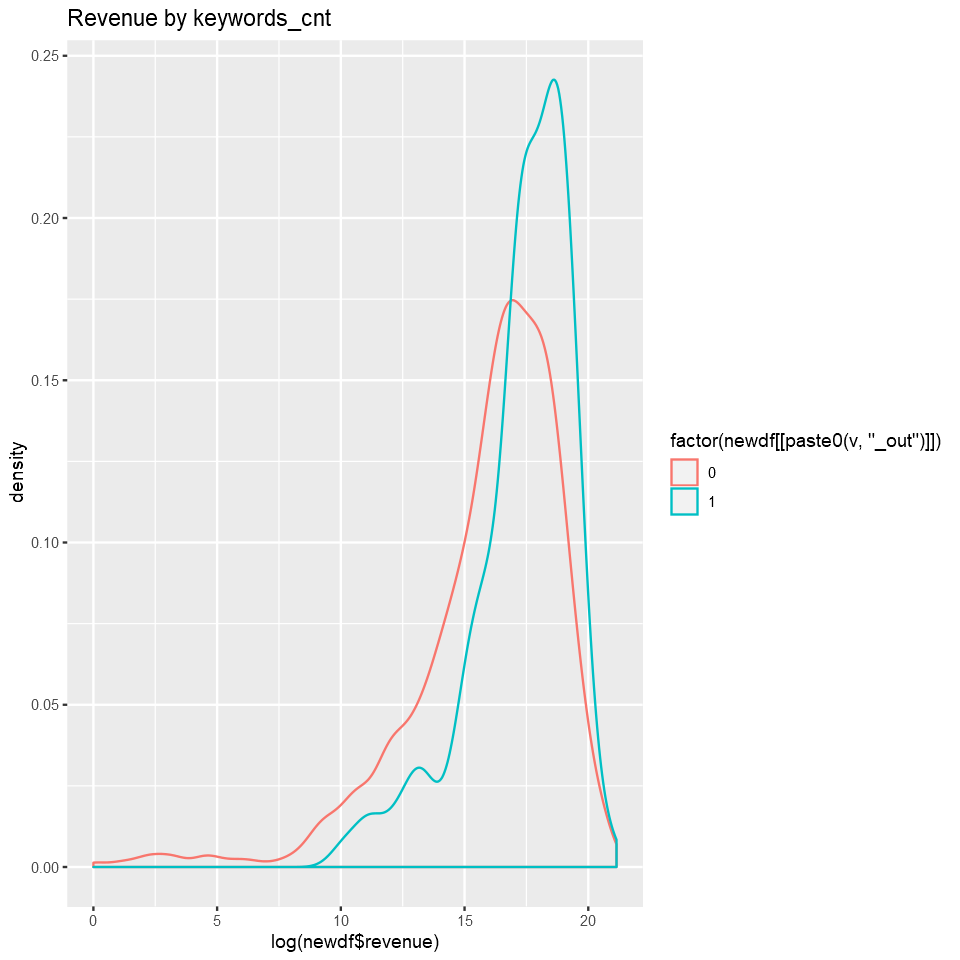

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


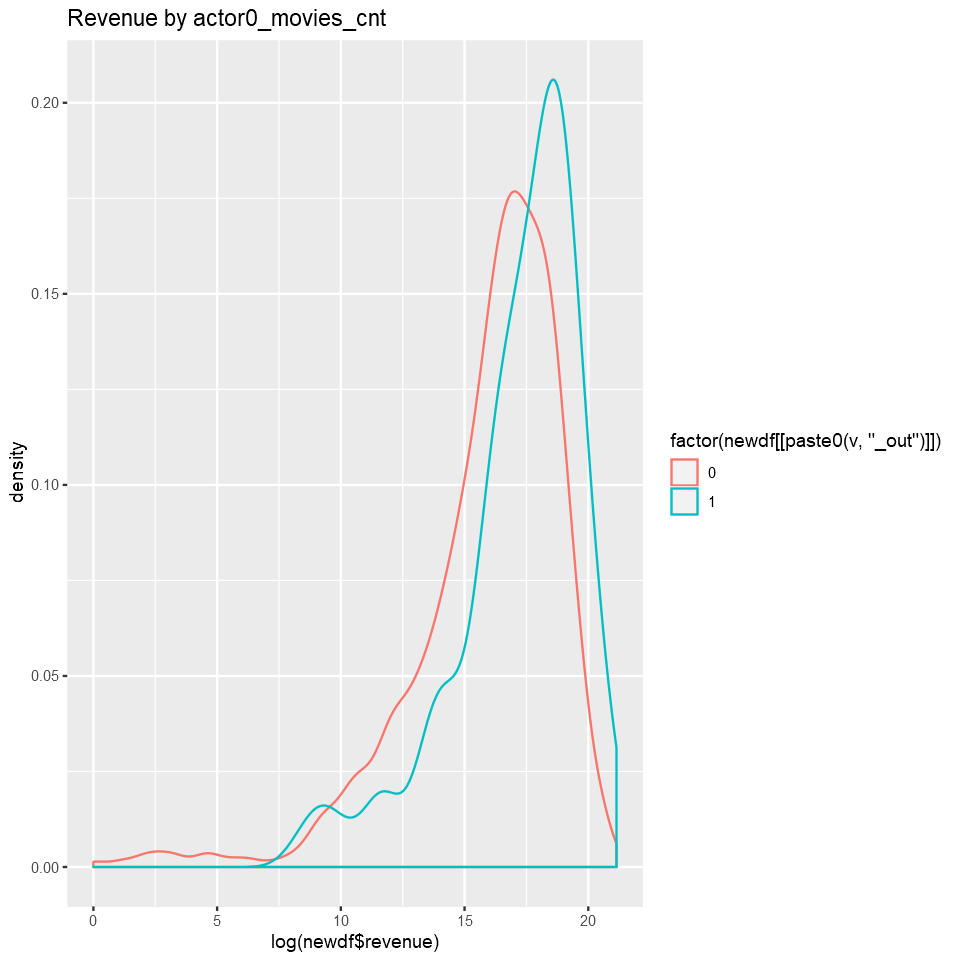

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


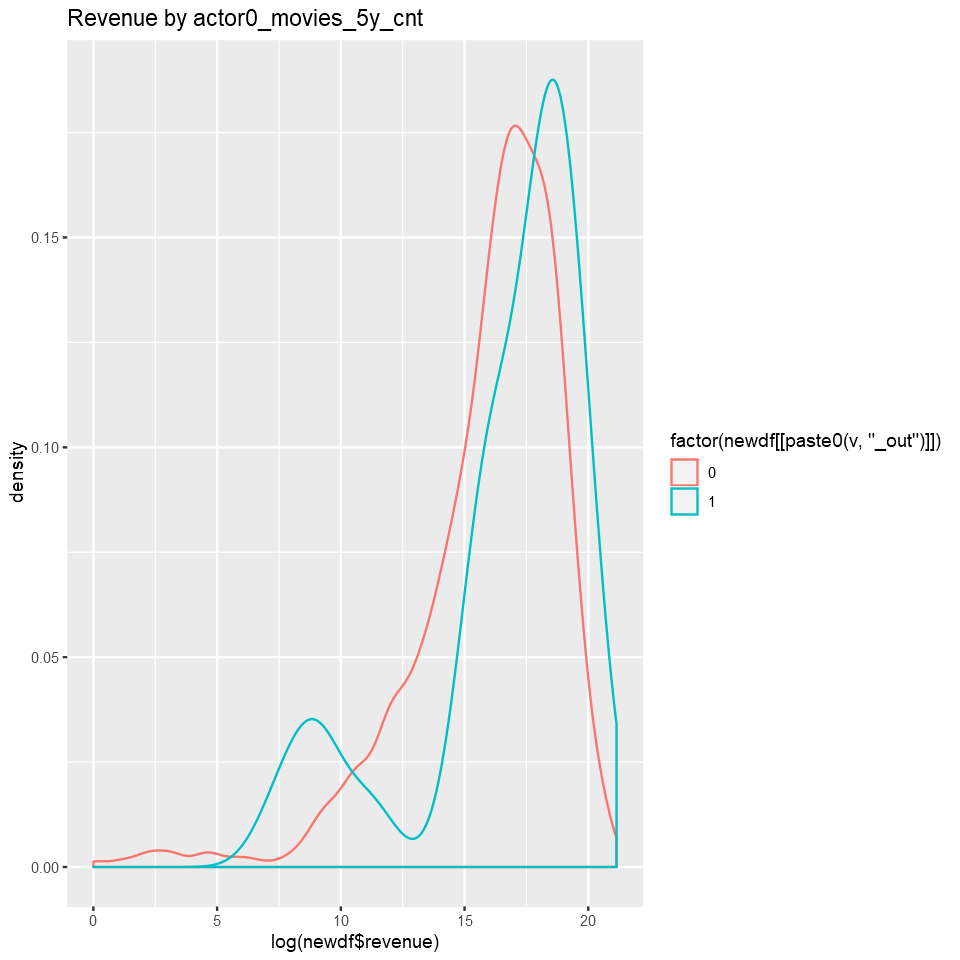

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


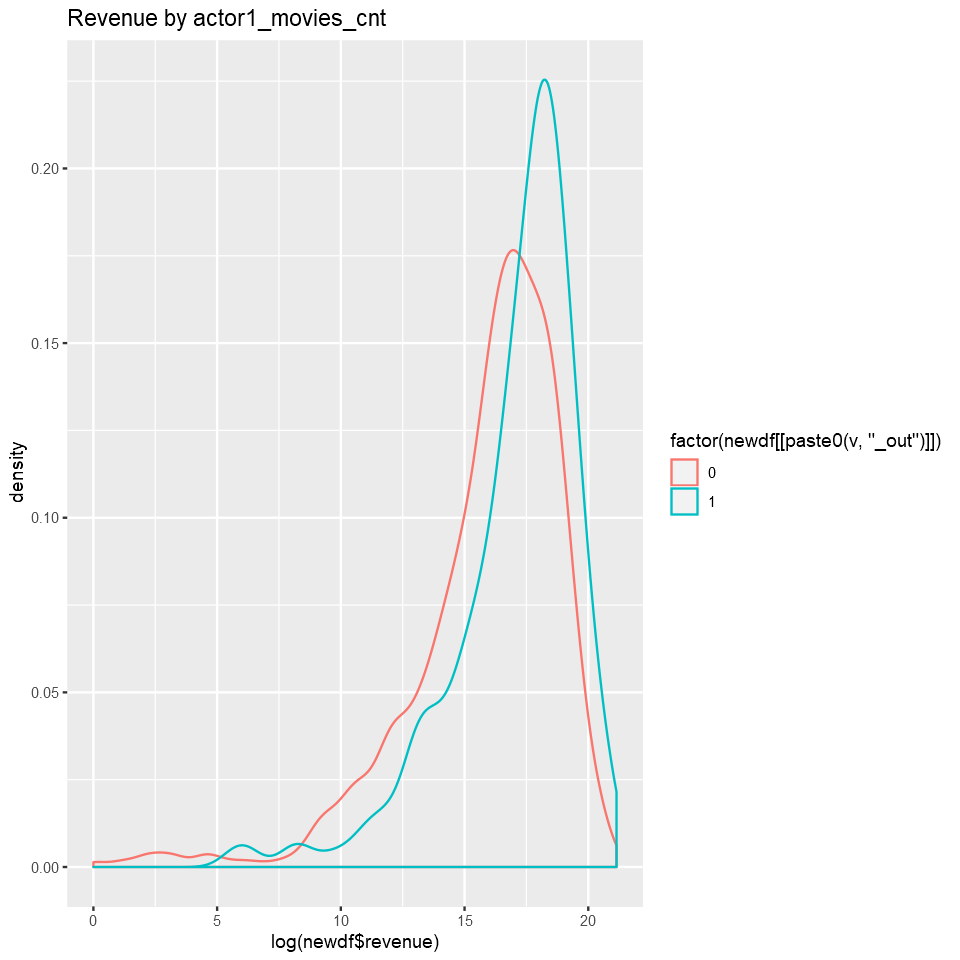

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


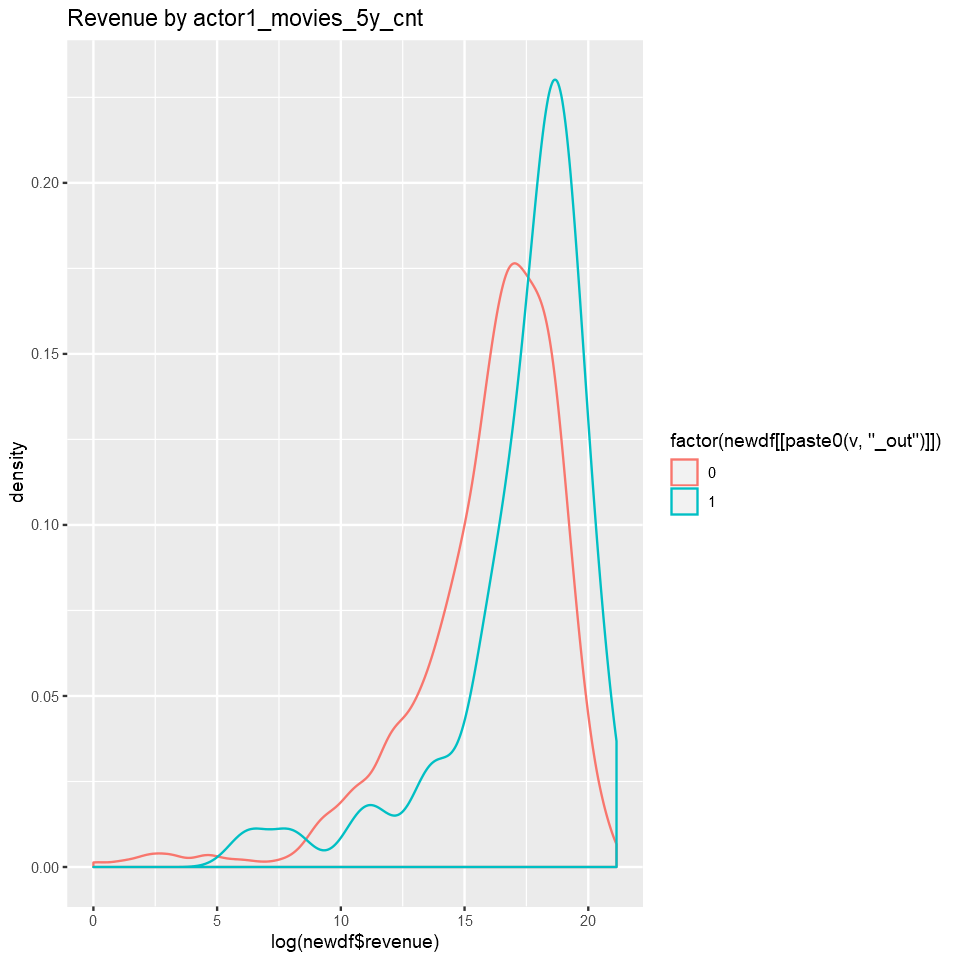

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


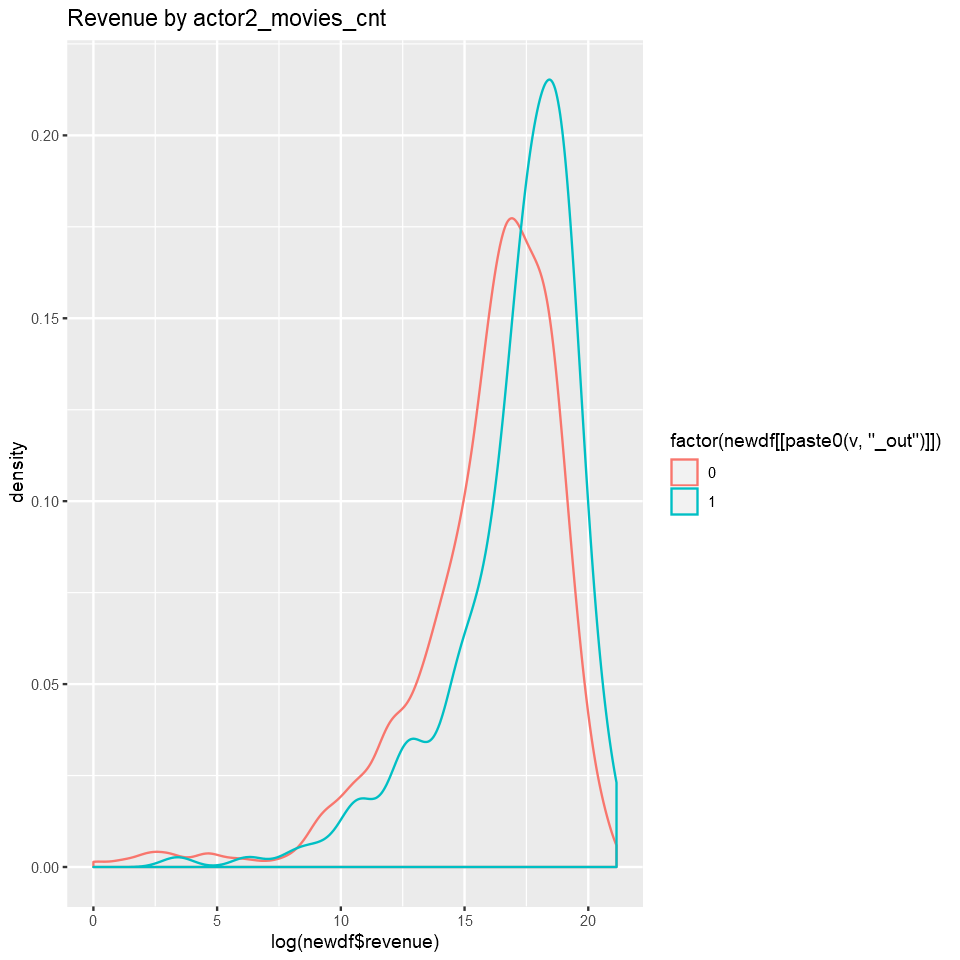

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


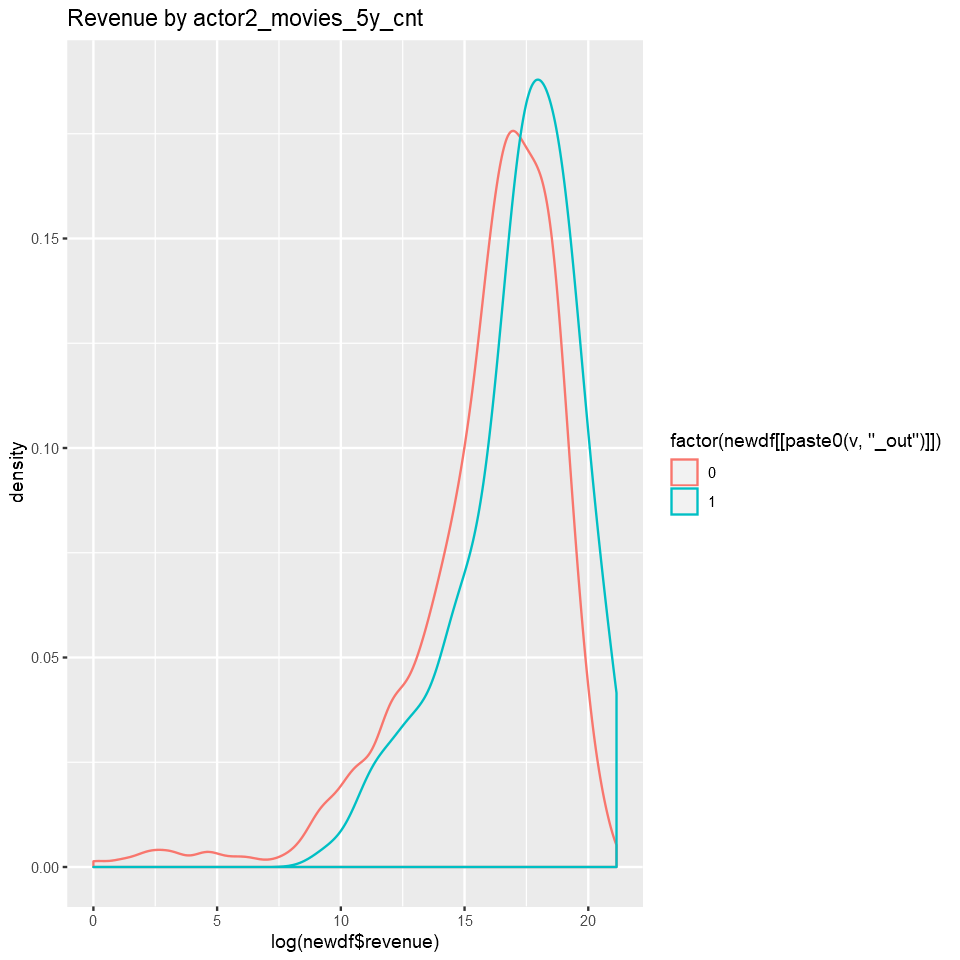

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


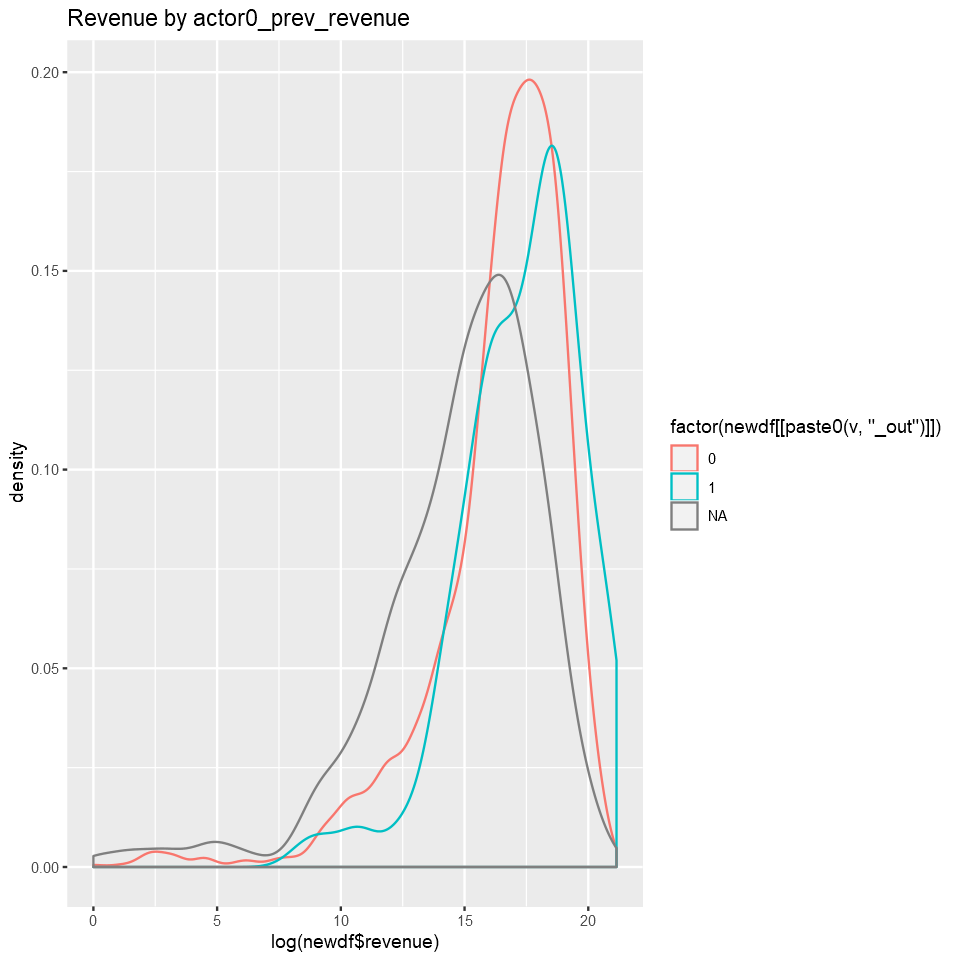

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


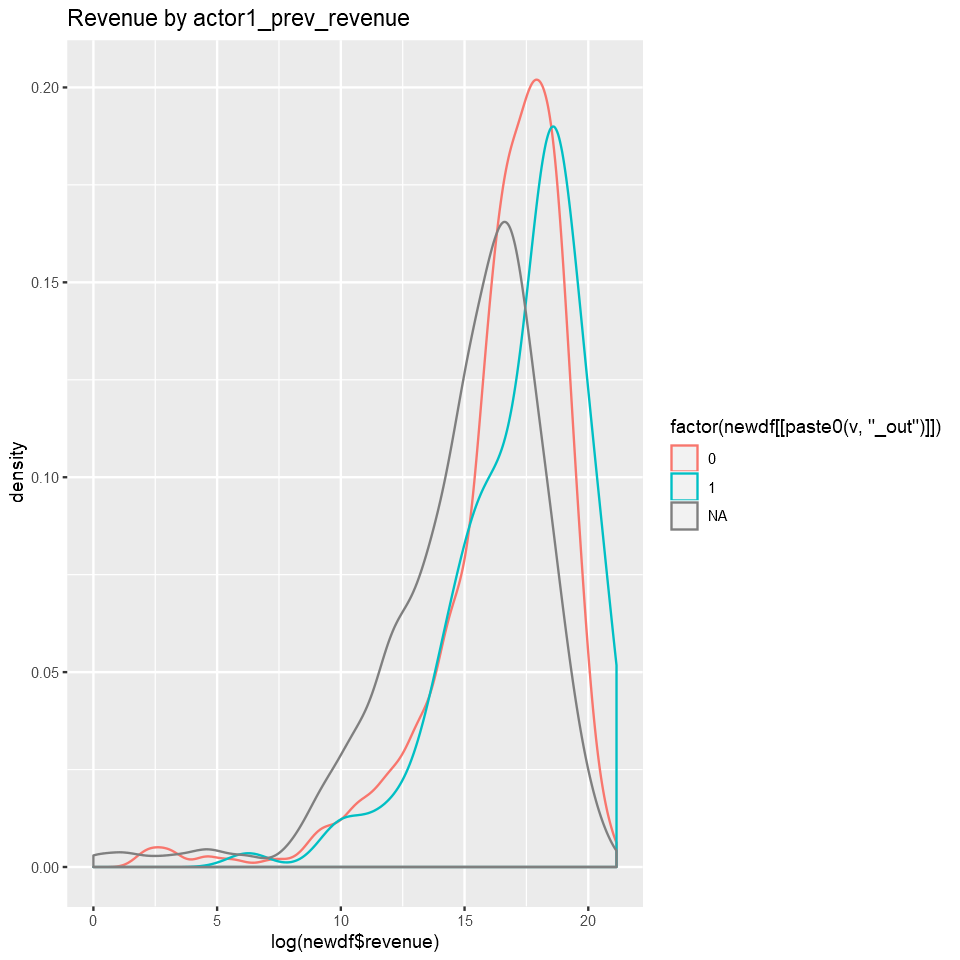

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


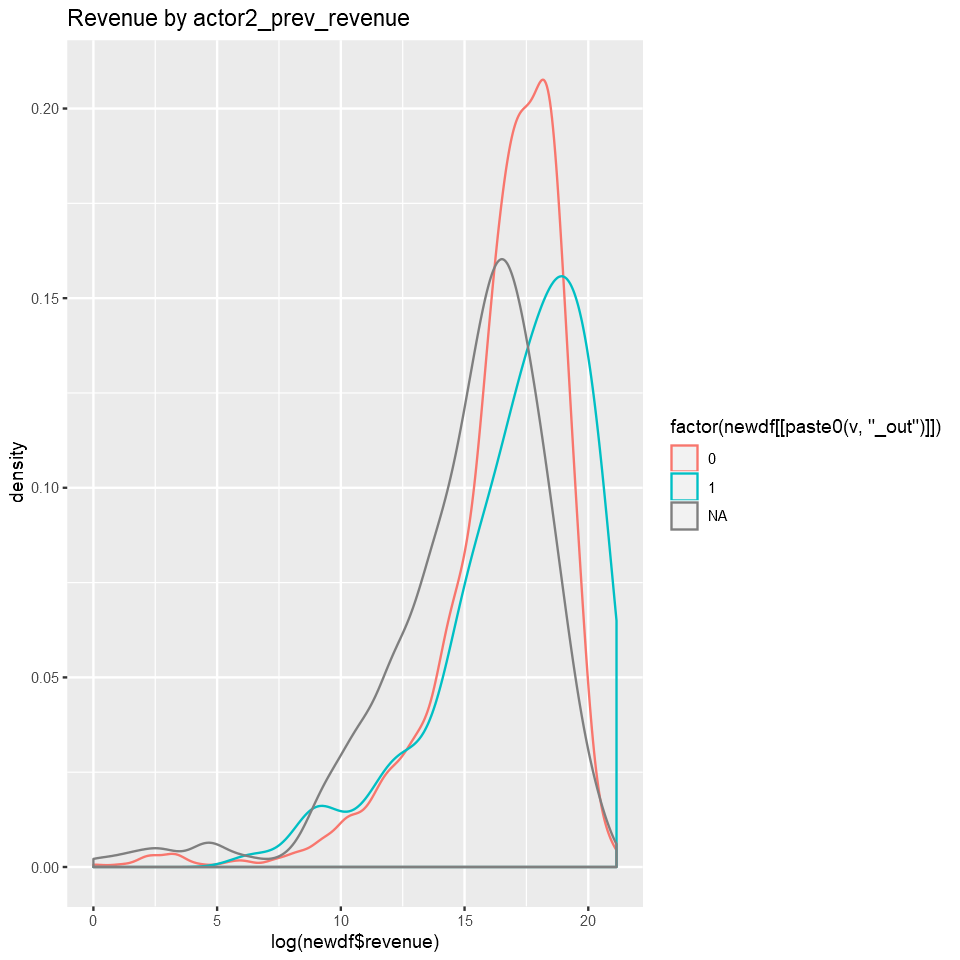

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


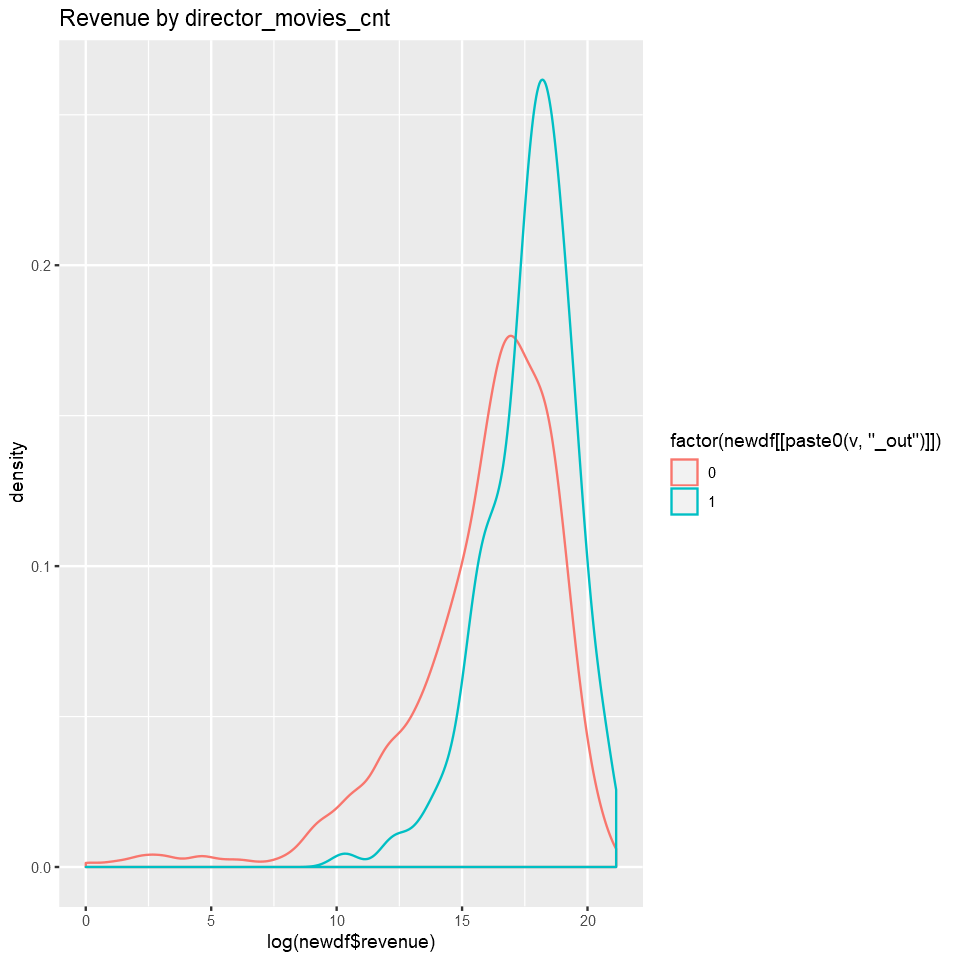

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


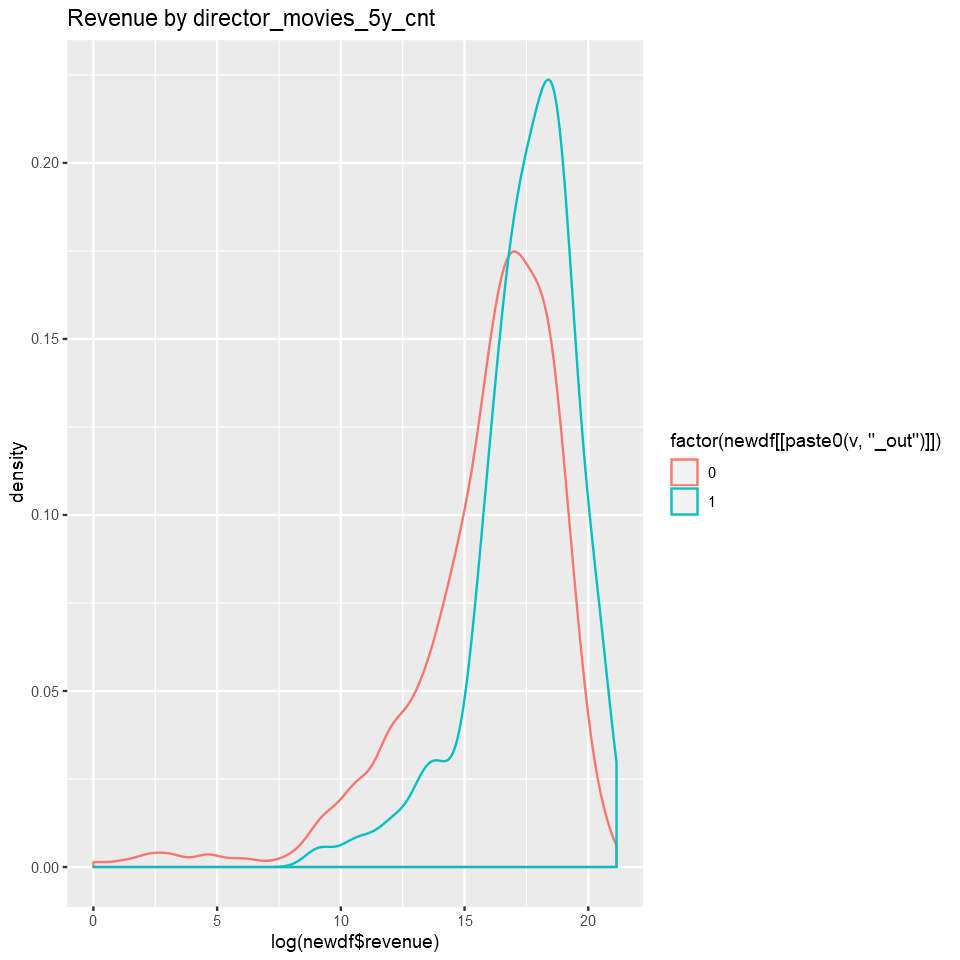

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


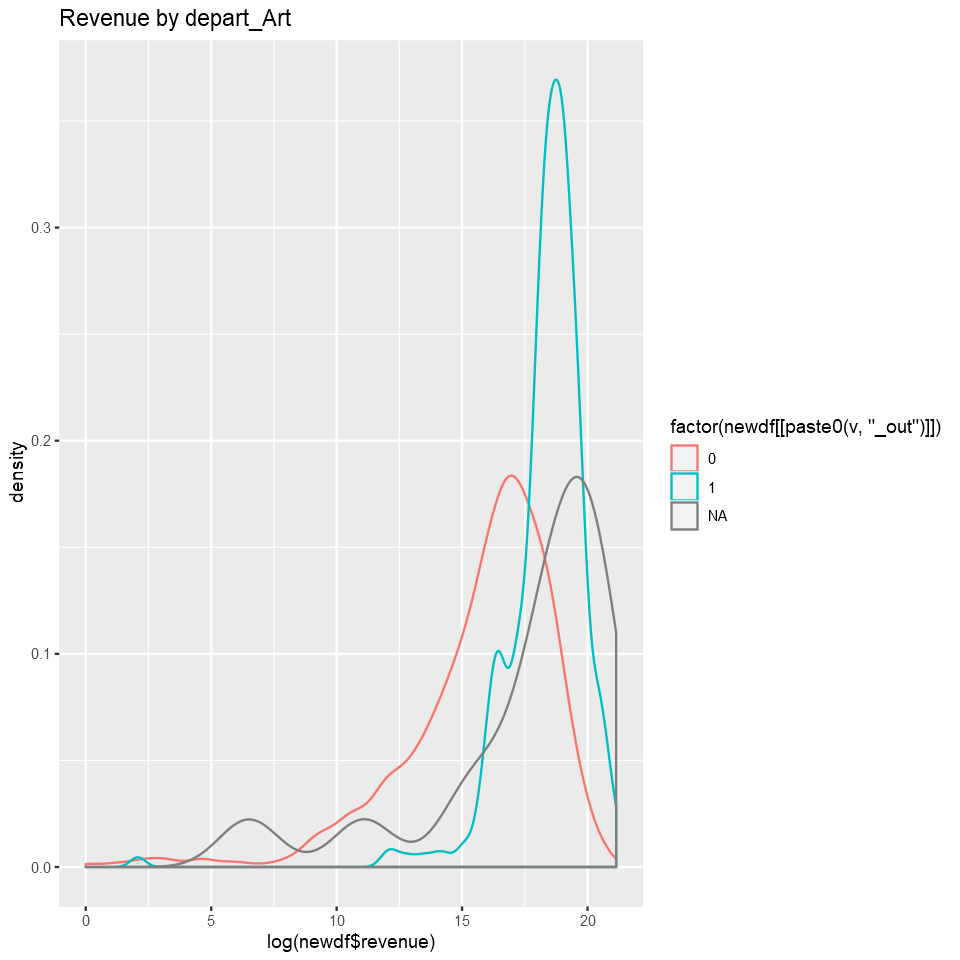

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


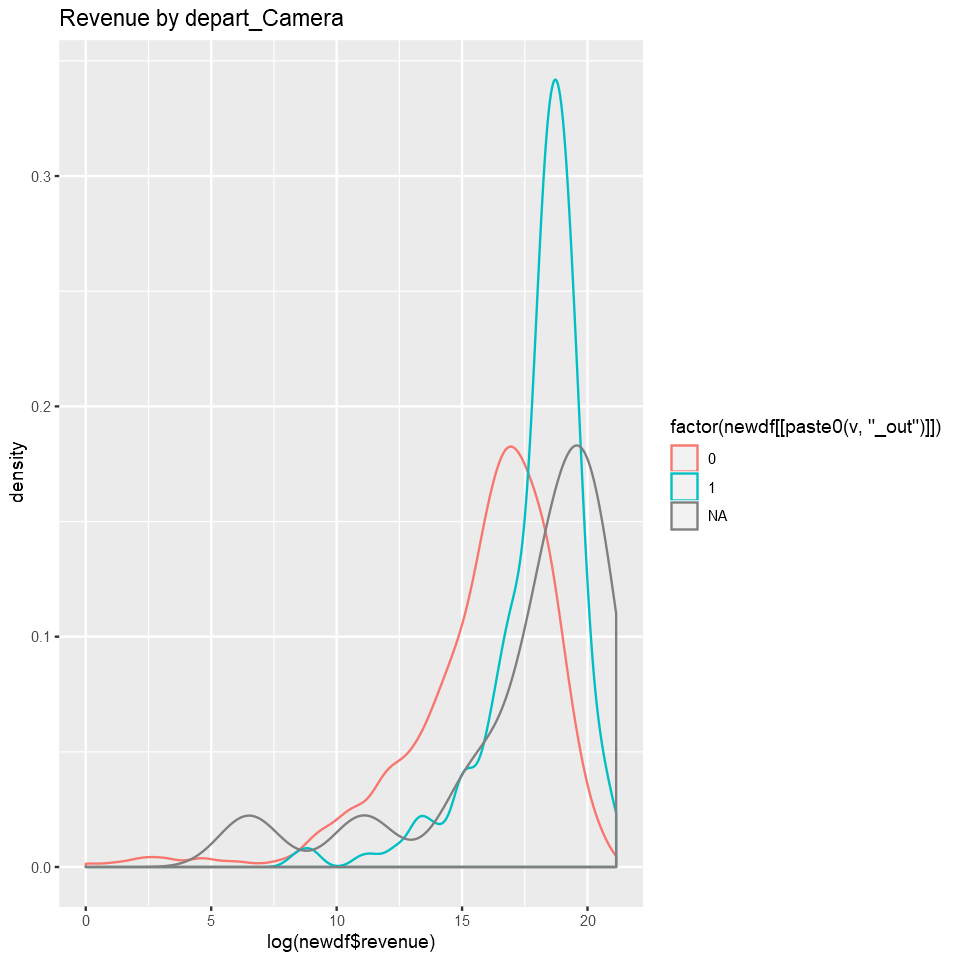

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


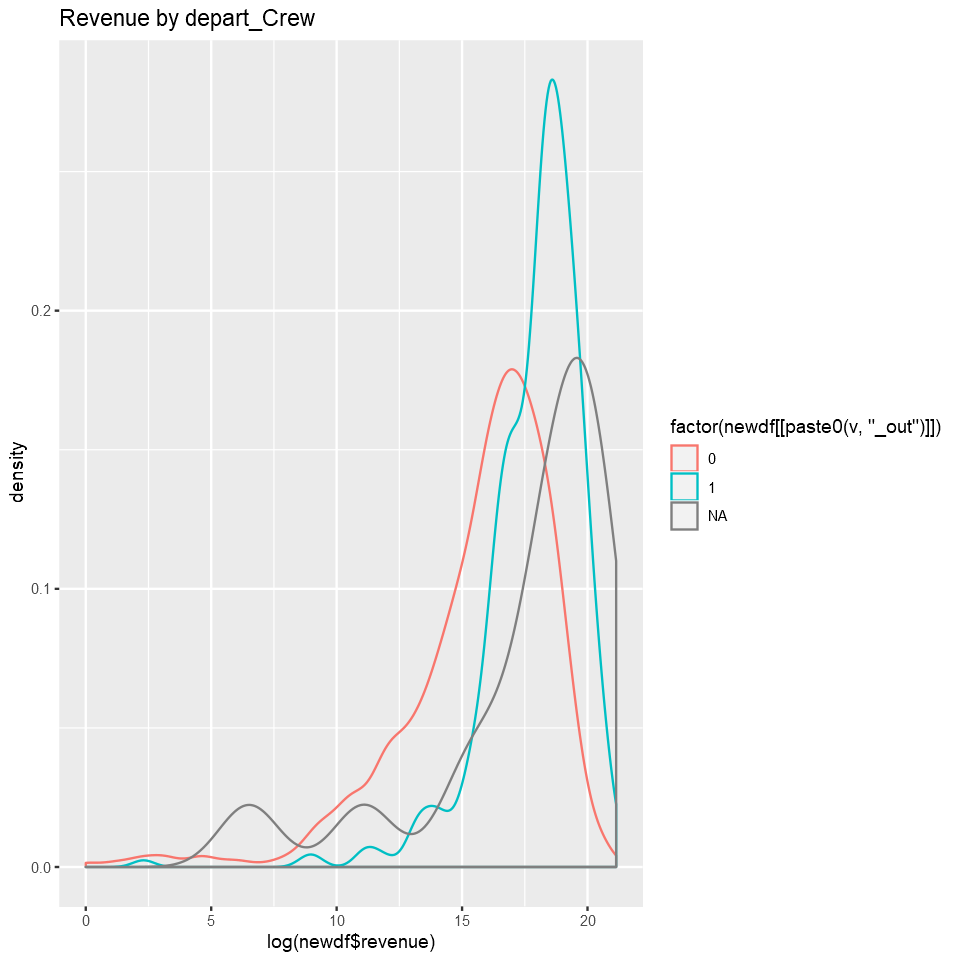

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


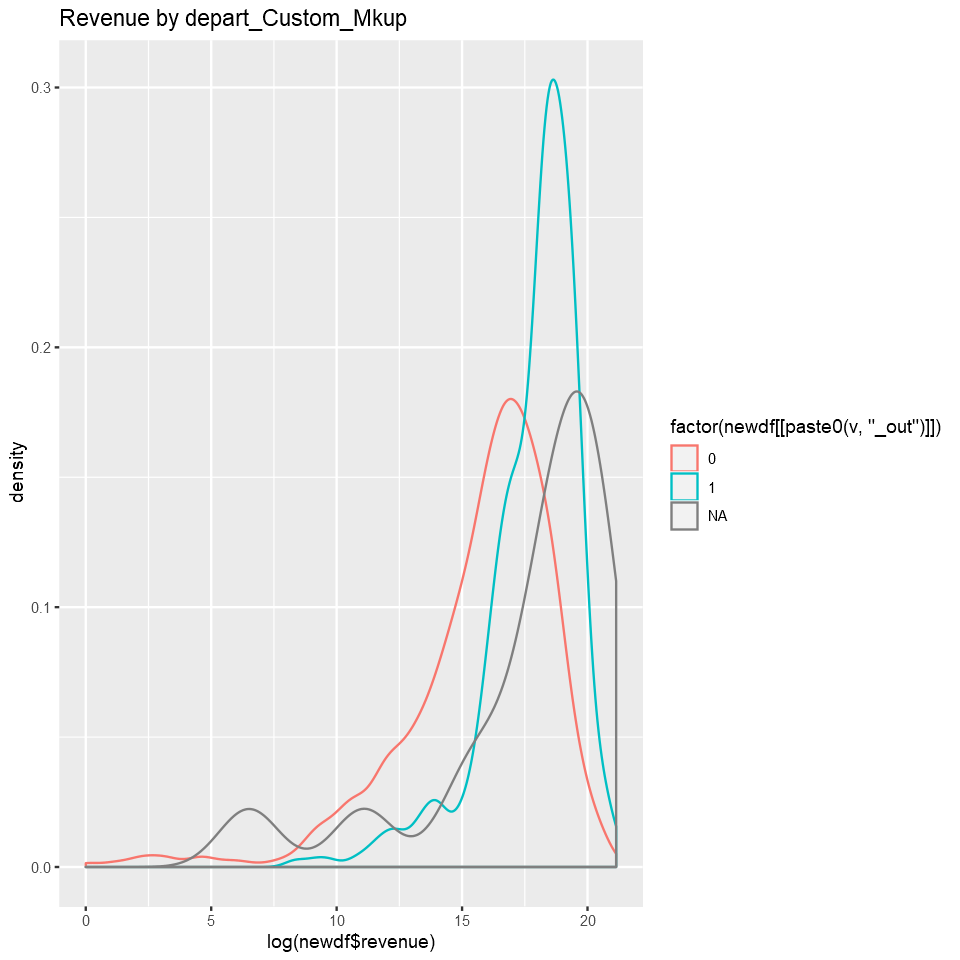

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


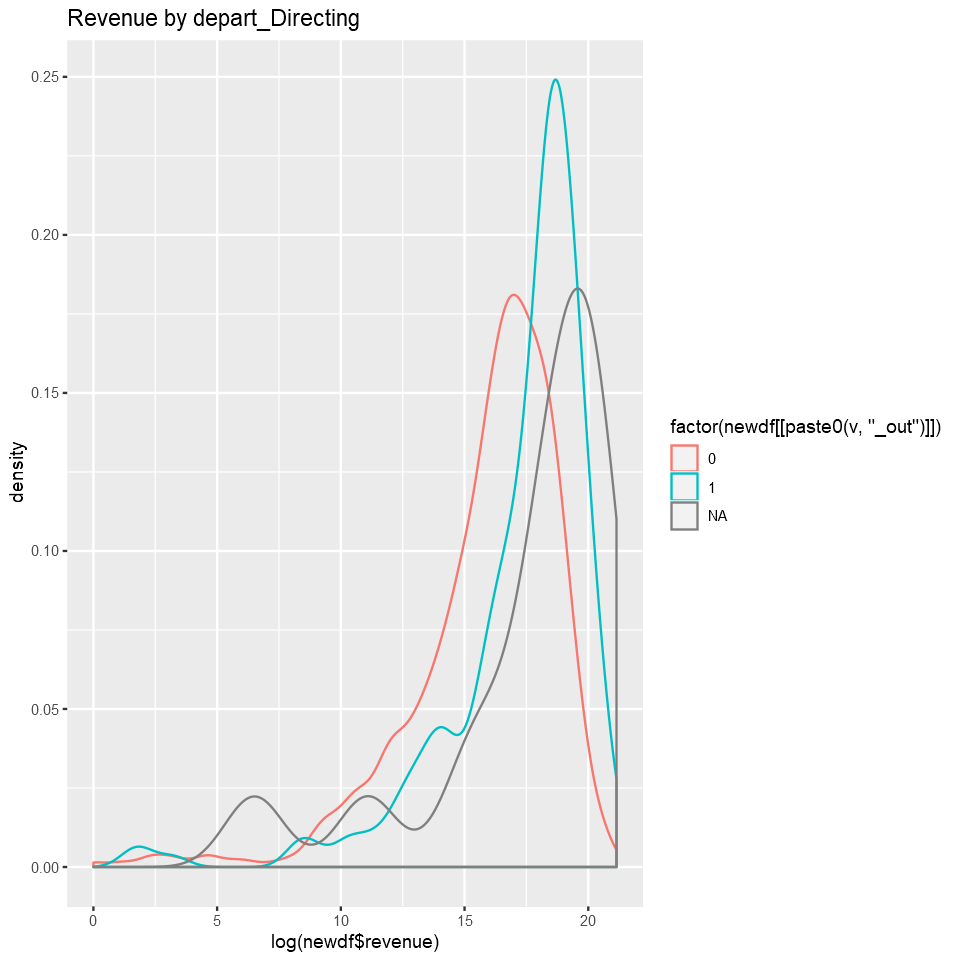

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


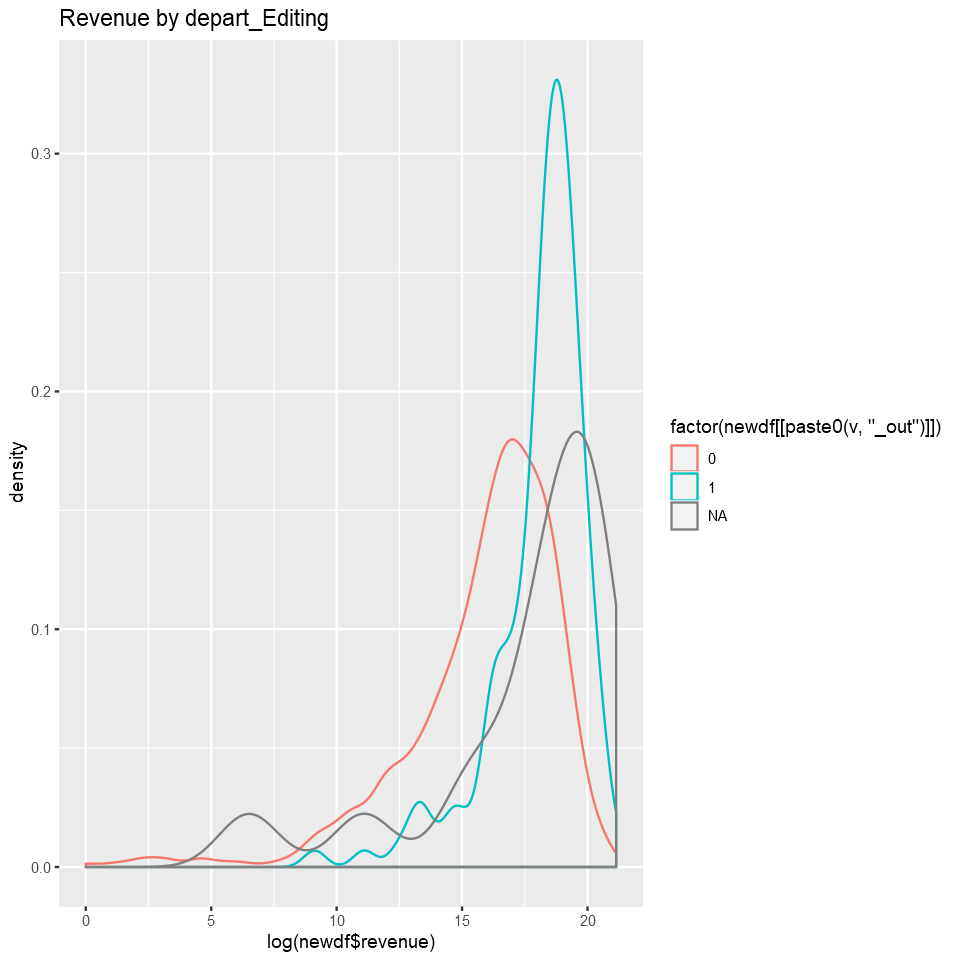

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


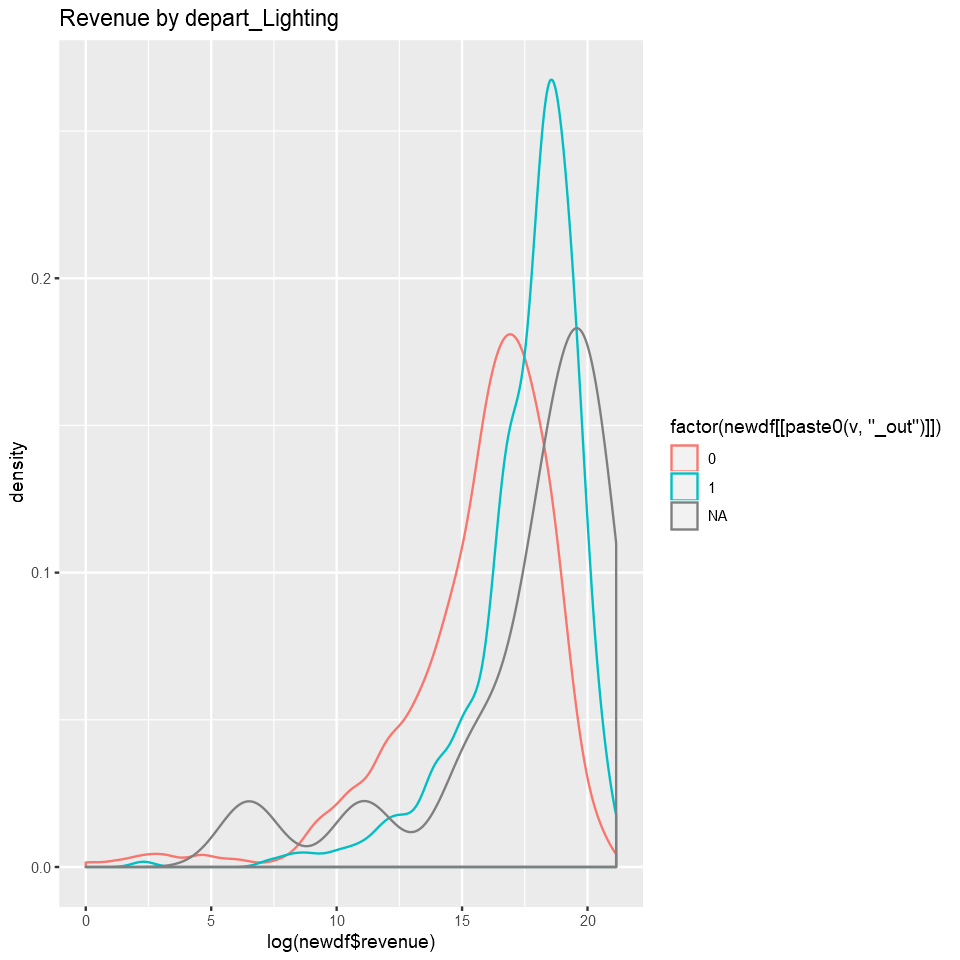

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


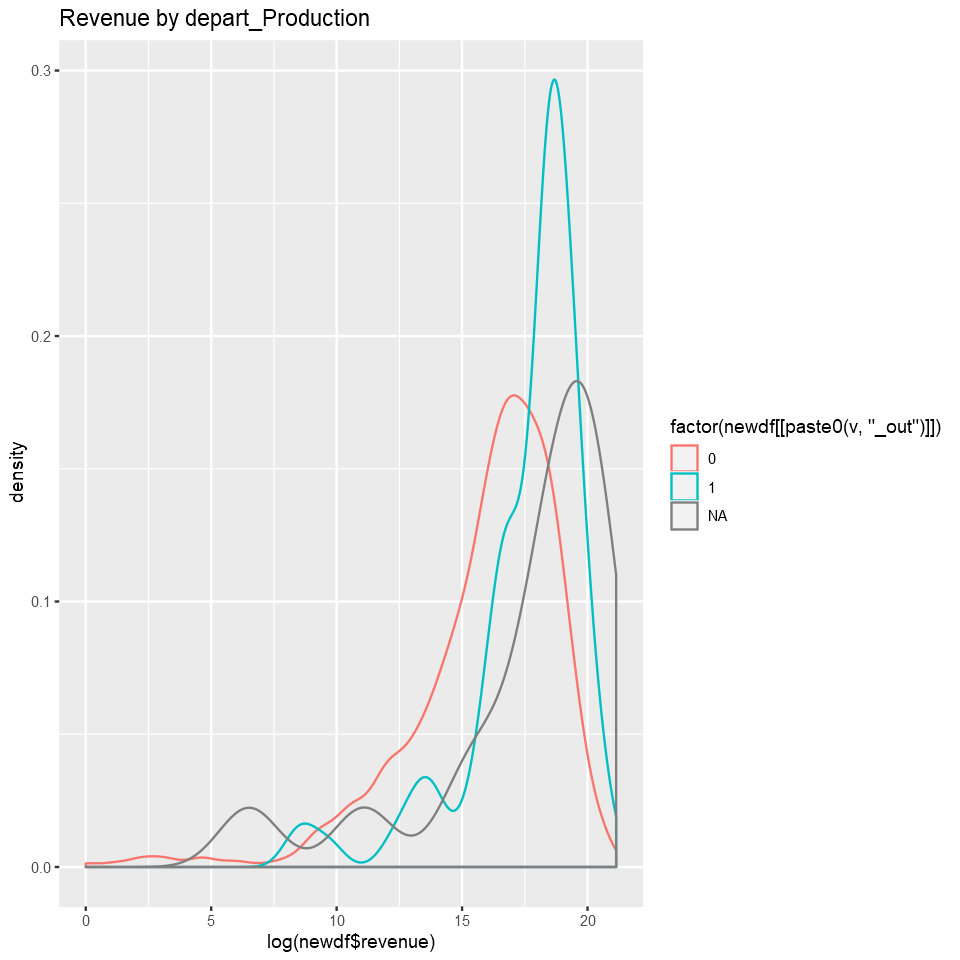

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


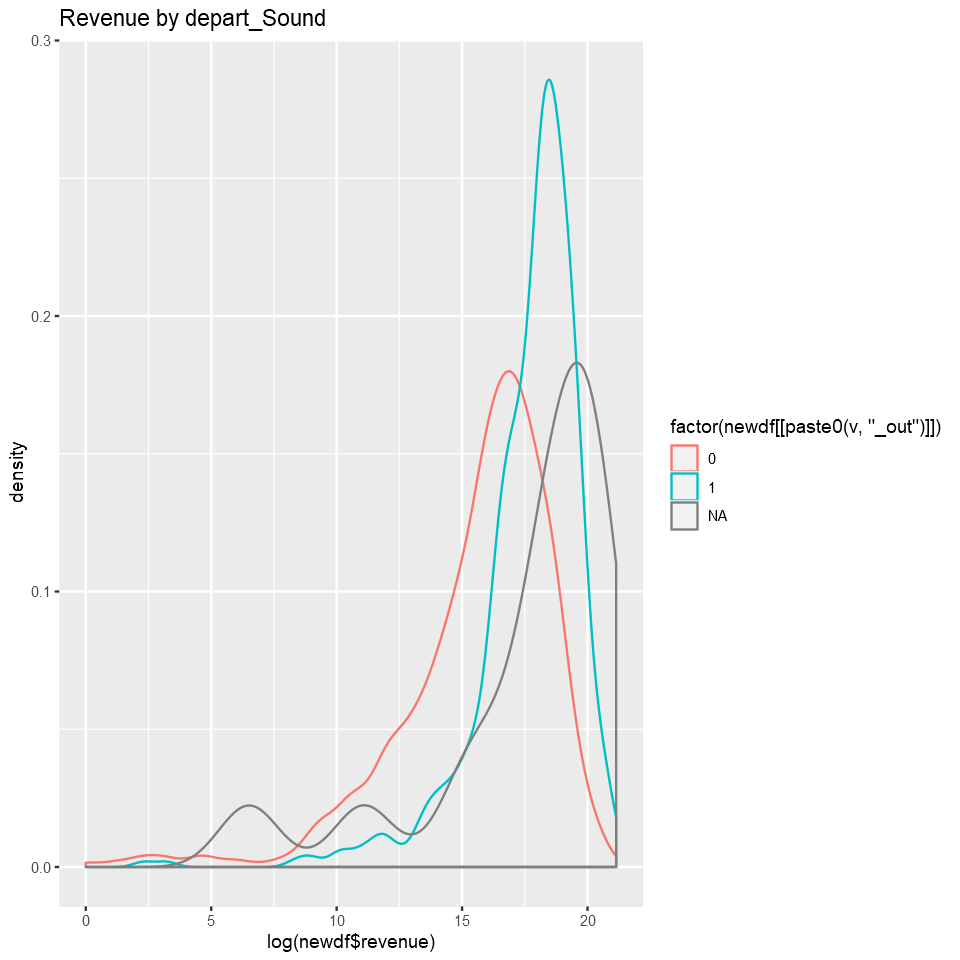

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


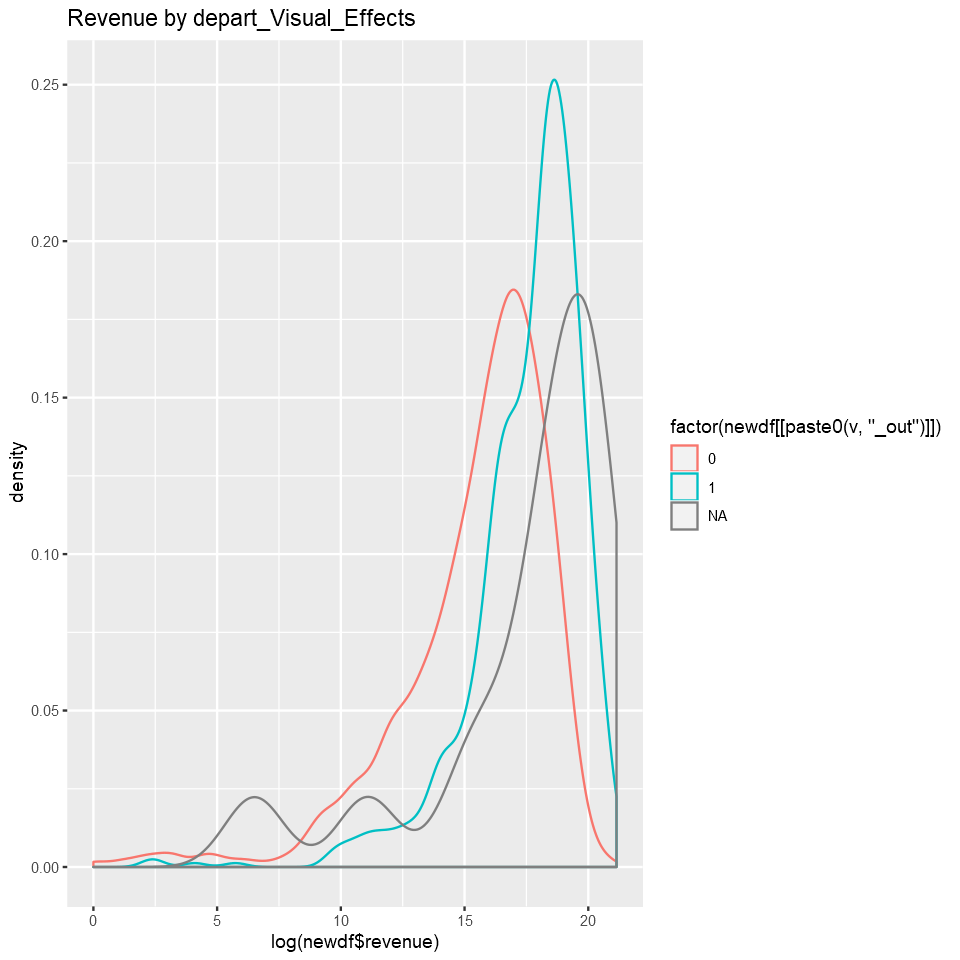

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


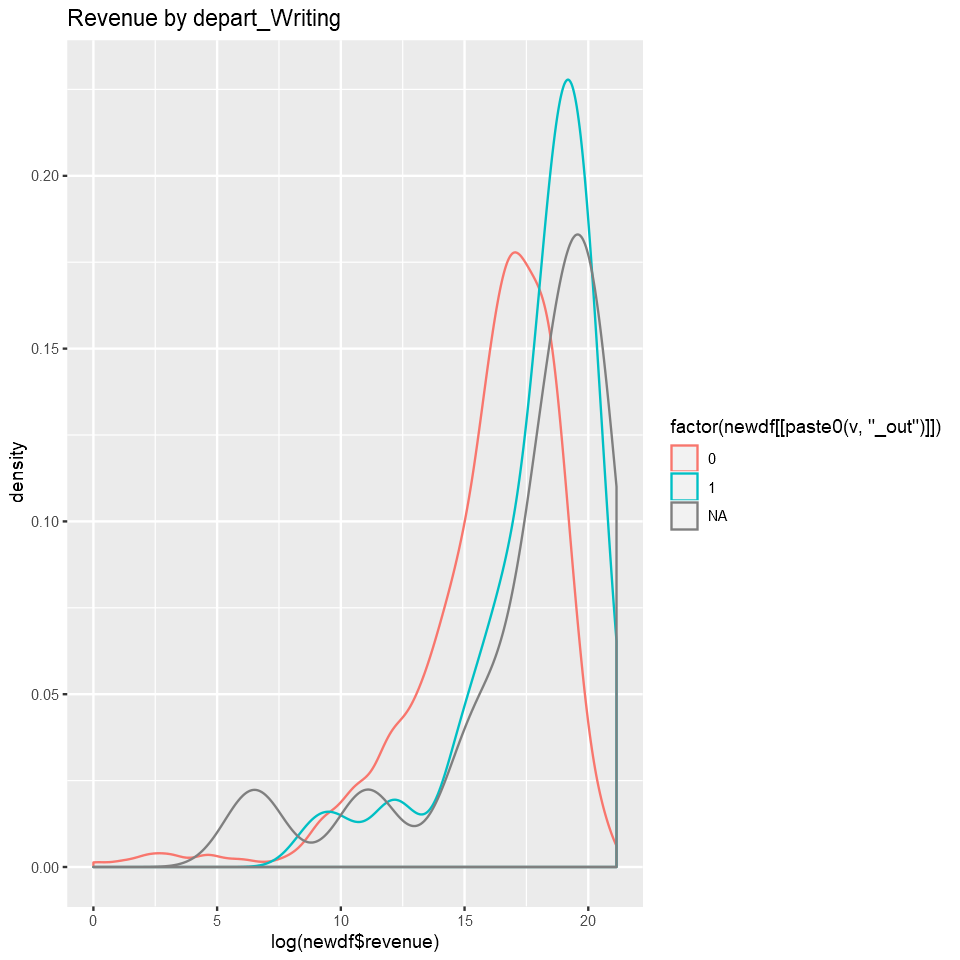

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


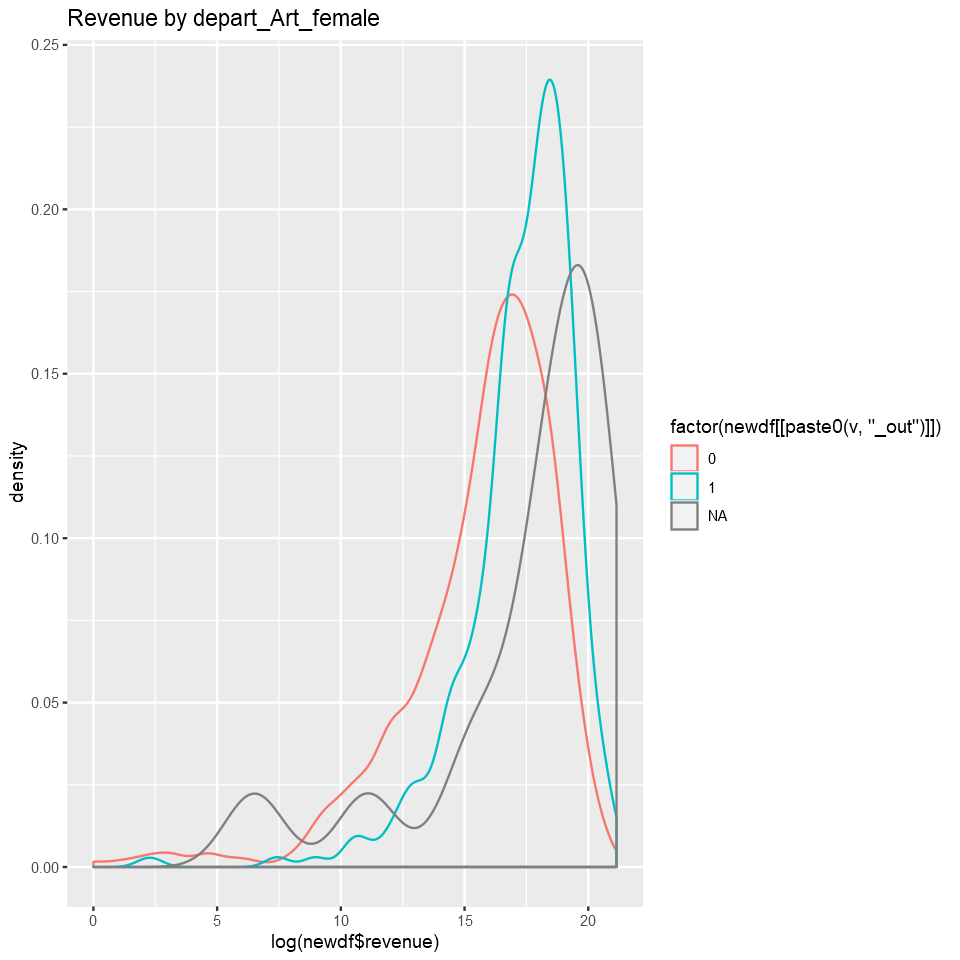

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


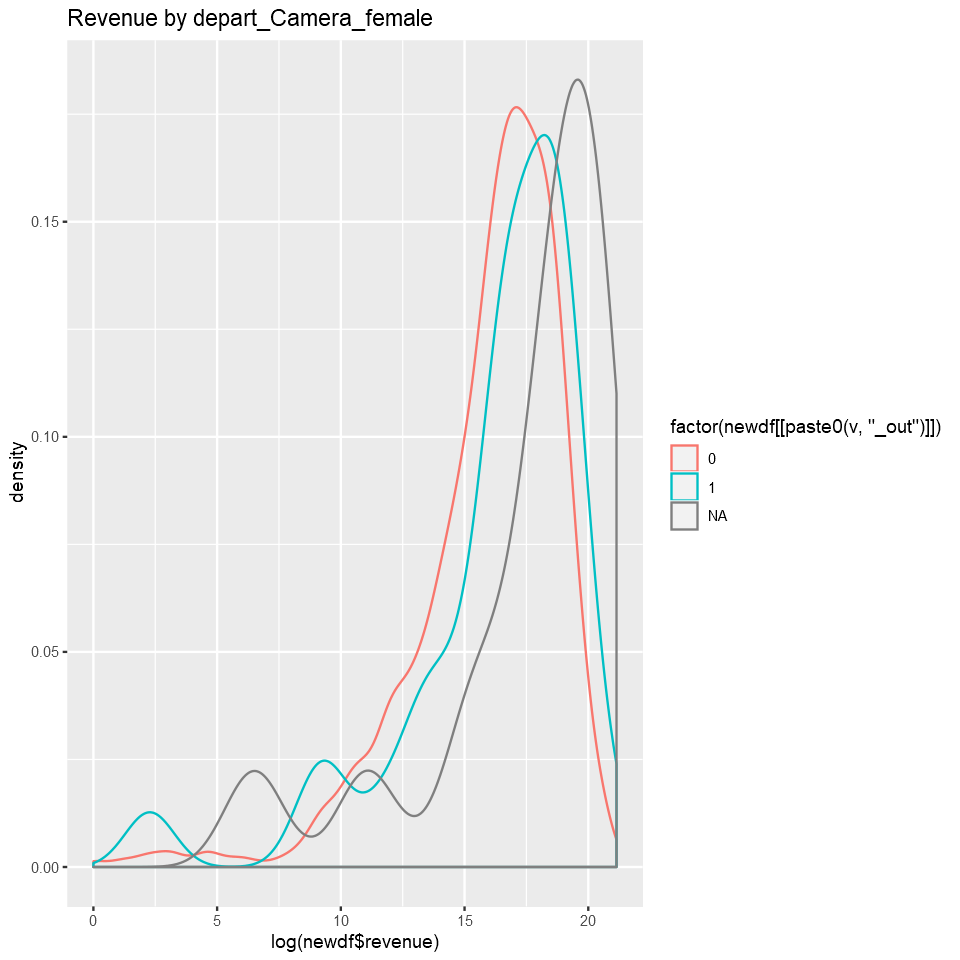

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


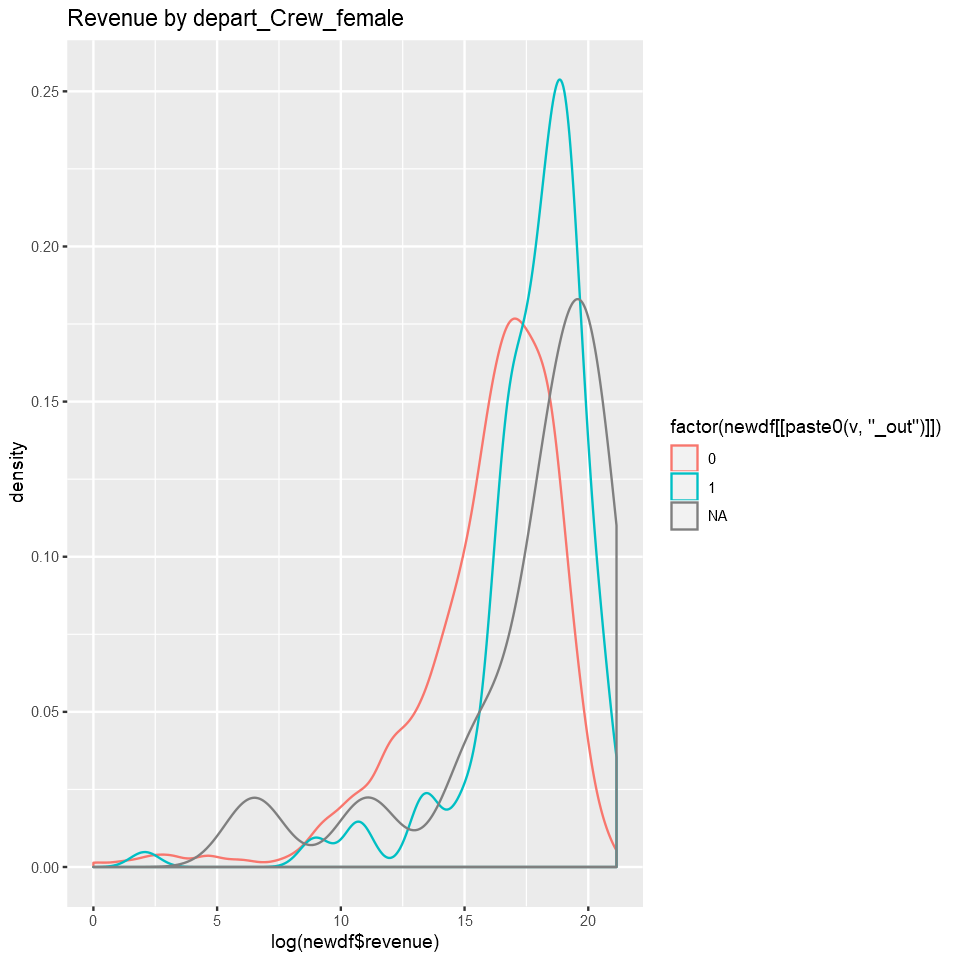

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


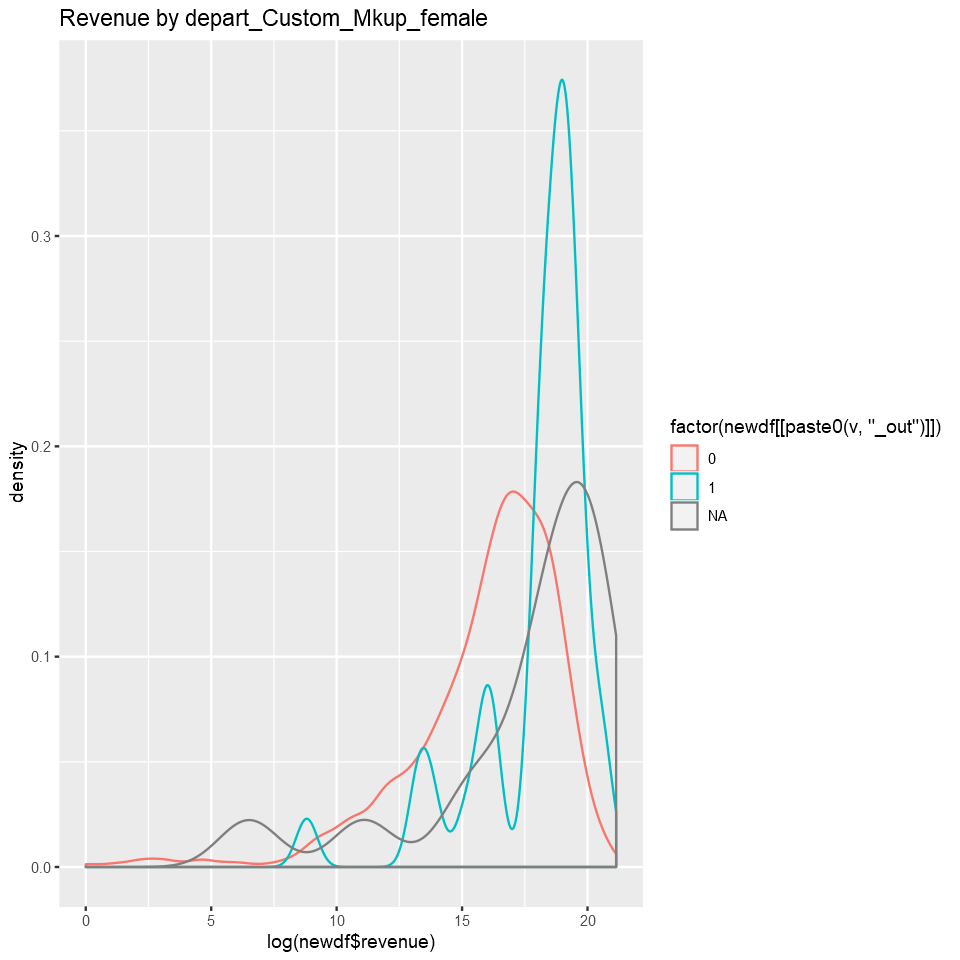

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


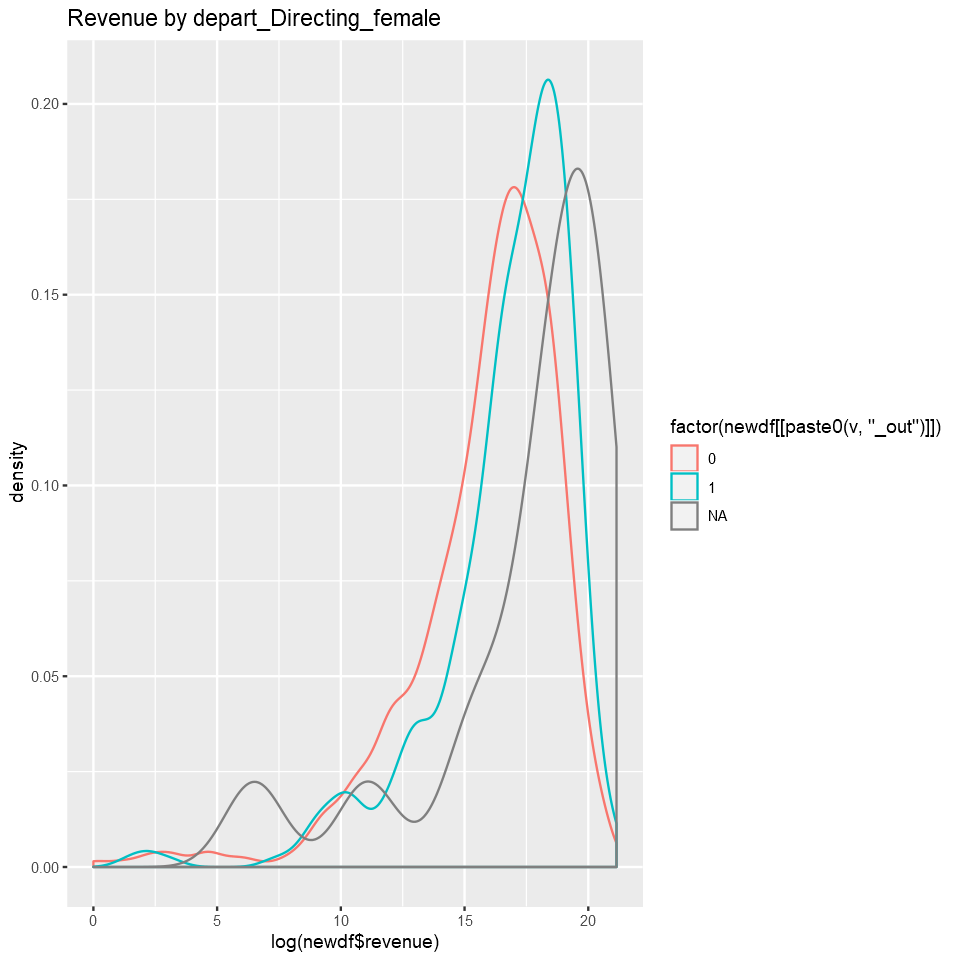

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


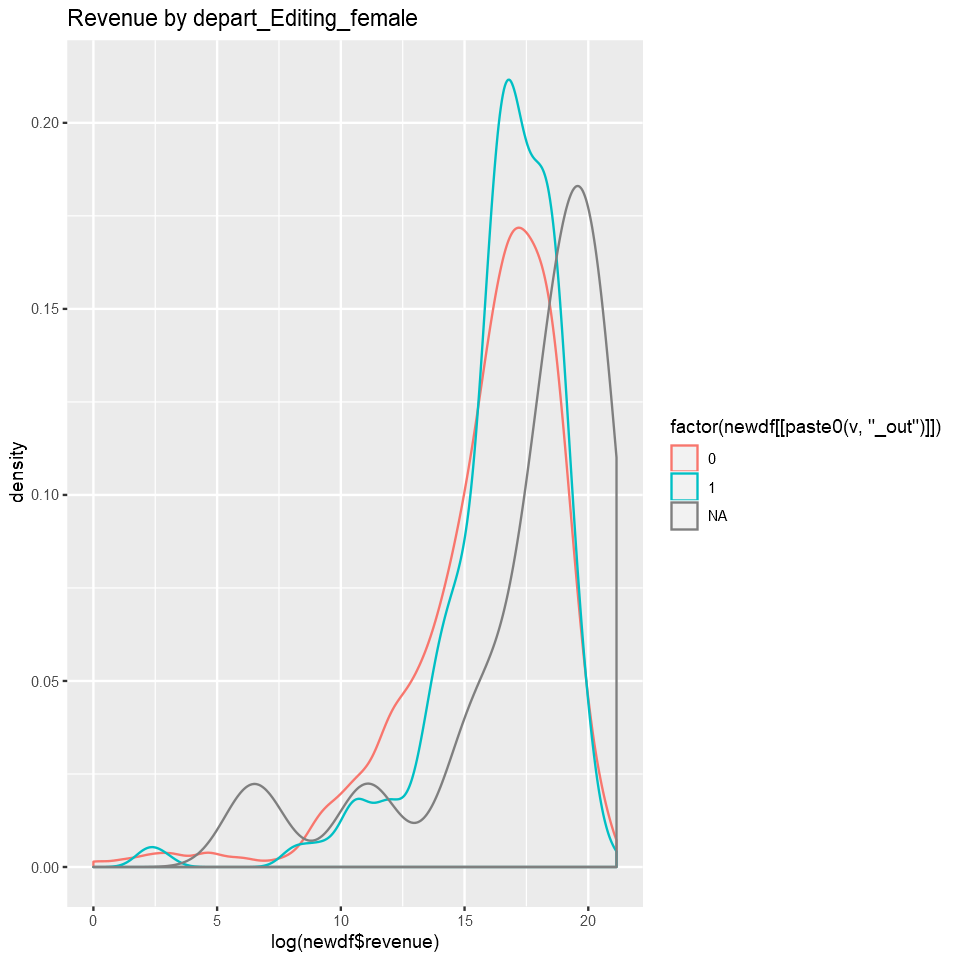

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


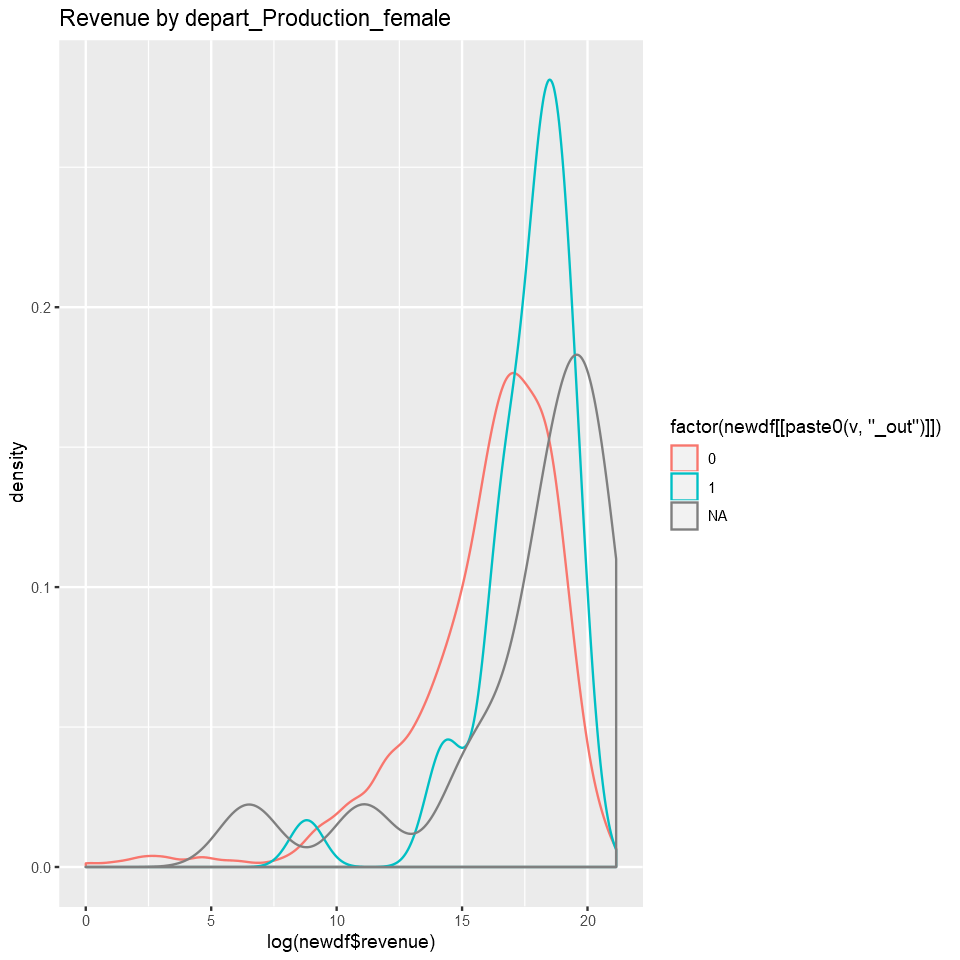

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


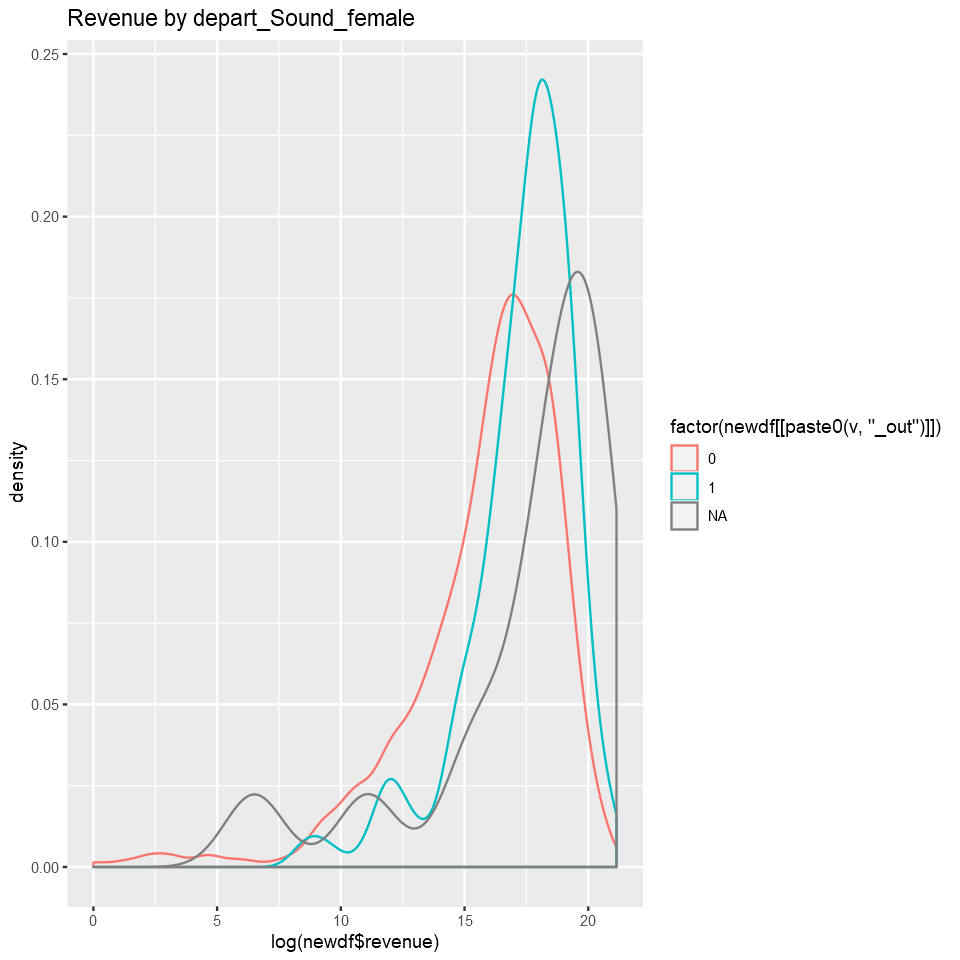

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."


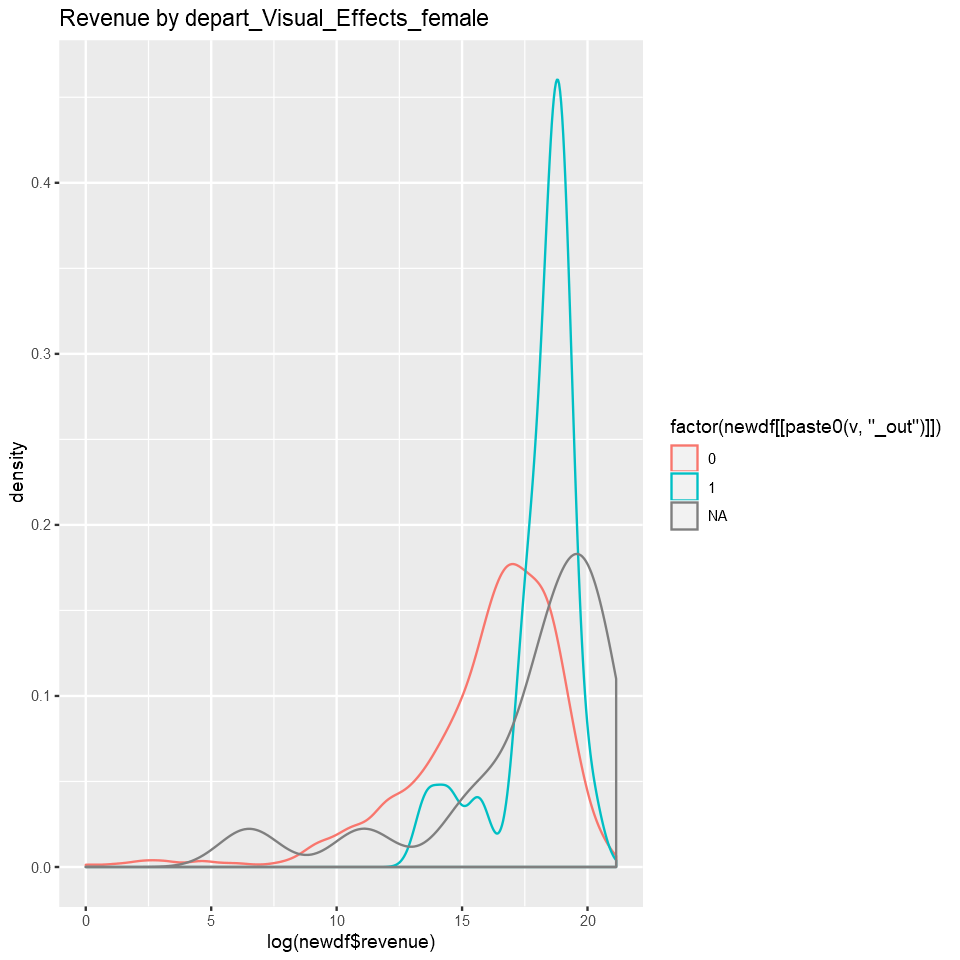

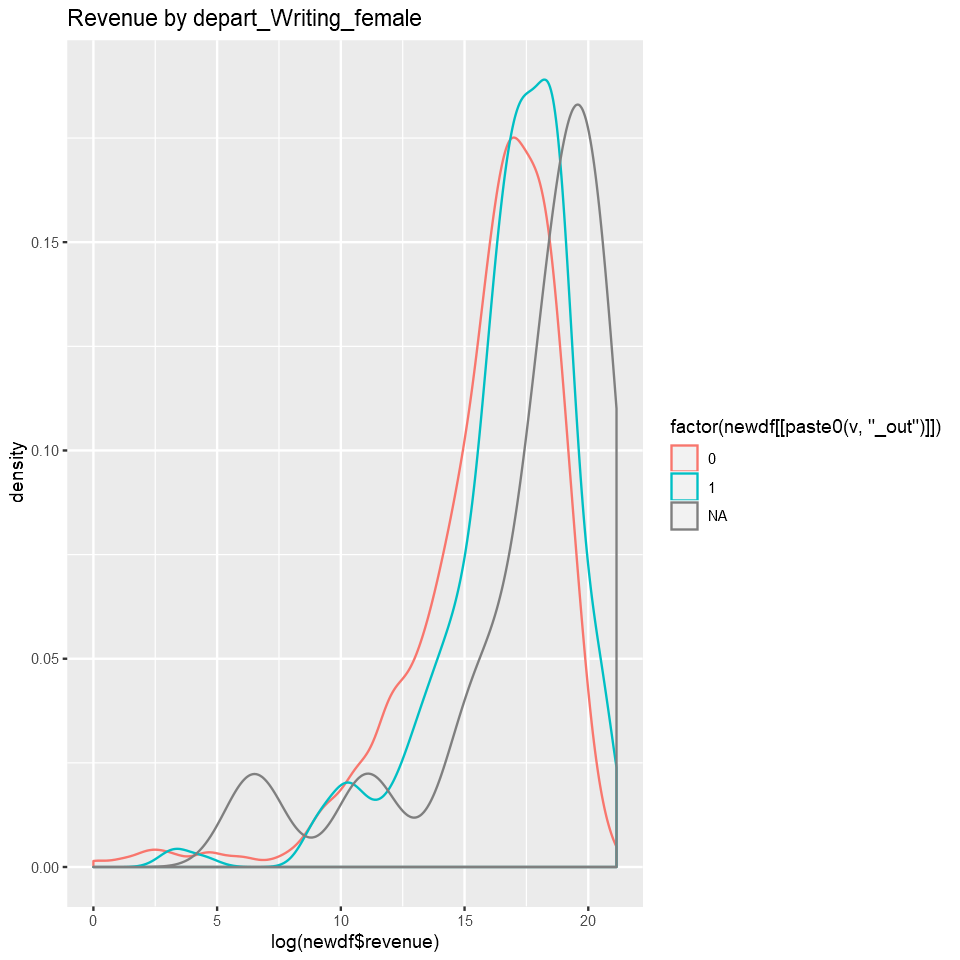

In [35]:
 for (v in movies_continuous){
    newdf <- left_join(df[,c("movie_id","revenue")], movies_outliers[,c("movie_id",paste0(v,"_out"))])
    print(    ggplot (newdf,aes(x=log(newdf$revenue), group = factor(newdf[[paste0(v,"_out")]]),
                                color = factor(newdf[[paste0(v,"_out")]]))) + 
          geom_density() + ggtitle(paste("Revenue by",v)) )
 
    options(repr.plot.width = 8, repr.plot.height = 8)
}

In [28]:
t.test(runtime.out,runtime.noout)


	Welch Two Sample t-test

data:  runtime.out and runtime.noout
t = -547.98, df = 7095.9, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -106.2139 -105.4567
sample estimates:
   mean of x    mean of y 
  0.03731343 105.87258633 


In [85]:
t.test(budget.out,budget.noout)


	Welch Two Sample t-test

data:  budget.out and budget.noout
t = -63.418, df = 6750, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -13934824 -13099175
sample estimates:
   mean of x    mean of y 
8.461017e-02 1.351700e+07 


In [119]:
t.test(popularity.out,popularity.noout)


	Welch Two Sample t-test

data:  popularity.out and popularity.noout
t = -137.36, df = 7190.6, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -7.546610 -7.334244
sample estimates:
 mean of x  mean of y 
0.02725424 7.46768169 


In [130]:
t.test(release_year.out,release_year.noout)


	Welch Two Sample t-test

data:  release_year.out and release_year.noout
t = -14308, df = 7107.5, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -2001.838 -2001.290
sample estimates:
   mean of x    mean of y 
3.647952e-02 2.001600e+03 


In [142]:
t.test(sw_collection.out,sw_collection.noout)


	Welch Two Sample t-test

data:  sw_collection.out and sw_collection.noout
t = 14.556, df = 7374, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 0.02417064 0.03169377
sample estimates:
mean of x mean of y 
0.0279322 0.0000000 


In [145]:
t.test(depart_Art.out,depart_Art.noout)


	Welch Two Sample t-test

data:  depart_Art.out and depart_Art.noout
t = -65.625, df = 6944.8, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -1.558814 -1.468388
sample estimates:
 mean of x  mean of y 
0.09440131 1.60800241 


In [147]:
t.test(depart_Camera.out,depart_Camera.noout)


	Welch Two Sample t-test

data:  depart_Camera.out and depart_Camera.noout
t = -69.693, df = 7412.1, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -1.0491105 -0.9917078
sample estimates:
 mean of x  mean of y 
0.09126822 1.11167741 


In [181]:
t.test(depart_Crew.out,depart_Crew.noout)


	Welch Two Sample t-test

data:  depart_Crew.out and depart_Crew.noout
t = -33.52, df = 7271.8, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -0.5510052 -0.4901185
sample estimates:
mean of x mean of y 
0.1234164 0.6439782 


In [182]:
t.test(depart_Custom_Mkup.out,depart_Custom_Mkup.noout)


	Welch Two Sample t-test

data:  depart_Custom_Mkup.out and depart_Custom_Mkup.noout
t = -44.298, df = 7113, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -0.7764768 -0.7106667
sample estimates:
mean of x mean of y 
0.1339055 0.8774772 


In [183]:
t.test(depart_Directing.out,depart_Directing.noout)


	Welch Two Sample t-test

data:  depart_Directing.out and depart_Directing.noout
t = -161.64, df = 8702.2, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -1.363503 -1.330829
sample estimates:
 mean of x  mean of y 
0.06524997 1.41241621 


In [184]:
t.test(depart_Editing.out,depart_Editing.noout)


	Welch Two Sample t-test

data:  depart_Editing.out and depart_Editing.noout
t = -83.146, df = 7411, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -1.233657 -1.176827
sample estimates:
 mean of x  mean of y 
0.04454434 1.24978614 


In [185]:
t.test(depart_Lighting.out,depart_Lighting.noout)


	Welch Two Sample t-test

data:  depart_Lighting.out and depart_Lighting.noout
t = 38.361, df = 7340, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 0.1584731 0.1755414
sample estimates:
mean of x mean of y 
0.1670072 0.0000000 


In [186]:
t.test(depart_Production.out,depart_Production.noout)


	Welch Two Sample t-test

data:  depart_Production.out and depart_Production.noout
t = -60.45, df = 7554.2, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -0.8759801 -0.8209514
sample estimates:
 mean of x  mean of y 
0.02928756 0.87775330 


In [187]:
t.test(depart_Sound.out,depart_Sound.noout)


	Welch Two Sample t-test

data:  depart_Sound.out and depart_Sound.noout
t = -60.165, df = 6762.5, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -1.294520 -1.212825
sample estimates:
mean of x mean of y 
0.1494347 1.4031070 


In [188]:
t.test(depart_Visual_Effects.out,depart_Visual_Effects.noout)


	Welch Two Sample t-test

data:  depart_Visual_Effects.out and depart_Visual_Effects.noout
t = 47.86, df = 7340, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 0.2281005 0.2475840
sample estimates:
mean of x mean of y 
0.2378423 0.0000000 


In [189]:
t.test(depart_Writing.out,depart_Writing.noout)


	Welch Two Sample t-test

data:  depart_Writing.out and depart_Writing.noout
t = -138.8, df = 7367.7, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -2.096533 -2.038138
sample estimates:
 mean of x  mean of y 
0.01934341 2.08667871 


In [190]:
t.test(depart_Custom_Mkup_female.out,depart_Custom_Mkup_female.noout)


	Welch Two Sample t-test

data:  depart_Custom_Mkup_female.out and depart_Custom_Mkup_female.noout
t = -45.474, df = 7850.3, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -0.3136168 -0.2876960
sample estimates:
 mean of x  mean of y 
0.01307724 0.31373361 


In [191]:
t.test(depart_Lighting_female.out,depart_Lighting_female.noout)


	Welch Two Sample t-test

data:  depart_Lighting_female.out and depart_Lighting_female.noout
t = 2.2367, df = 7340, p-value = 0.02534
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 8.416551e-05 1.278047e-03
sample estimates:
   mean of x    mean of y 
0.0006811061 0.0000000000 


In [89]:
t.test(df$revenue,df$depart_Visual_Effects_female)


	Welch Two Sample t-test

data:  movies_ff$revenue and movies_ff$depart_Visual_Effects_female
t = 26.58, df = 2992, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 61945677 71812946
sample estimates:
   mean of x    mean of y 
6.687931e+07 8.445716e-03 


### 3.1.2 - Influence of the outluers on the outcome

In [ ]:
######################################################################################
########### I was trying to run a for loop for the out-noout scatter plots ###########
########### but it took more than 30 minutes with no outcome, so I had to  ###########
########### do it one-by-one                                               ###########
######################################################################################

#options(repr.plot.width = 12, repr.plot.height = 4)
#for(i in 1:length(movies_outliers)) {
 #   print(i)
  #  p1 <- ggplot() + geom_point(aes(x=movies_outliers[[i]], y=df$revenue, color=factor(movies_outliers[[i]])))
   # p2 <- ggplot() + (aes(x=no_outliers[[i]], y=df$revenue))
    #grid.arrange(p1, p2, nrow = 1)
#}

[1] 1


Warning message:
"Removed 4382 rows containing missing values (geom_point)."


[1] 2


Warning message:
"Removed 4384 rows containing missing values (geom_point)."


In [118]:
runtime.out <- ifelse(df[["runtime"]] > 154 | df[["runtime"]] <59, 1, 0)
table(runtime.out)

runtime.out
   0    1 
7095  275 

In [24]:
runtime.noout <- df[["runtime"]]
runtime.noout <- ifelse(runtime.out==1,NA,runtime.noout)
head(runtime.noout)

[1]  93 113 105 122 118  83

Warning message:
"Removed 4384 rows containing missing values (geom_point)."
Warning message:
"Removed 4509 rows containing missing values (geom_point)."


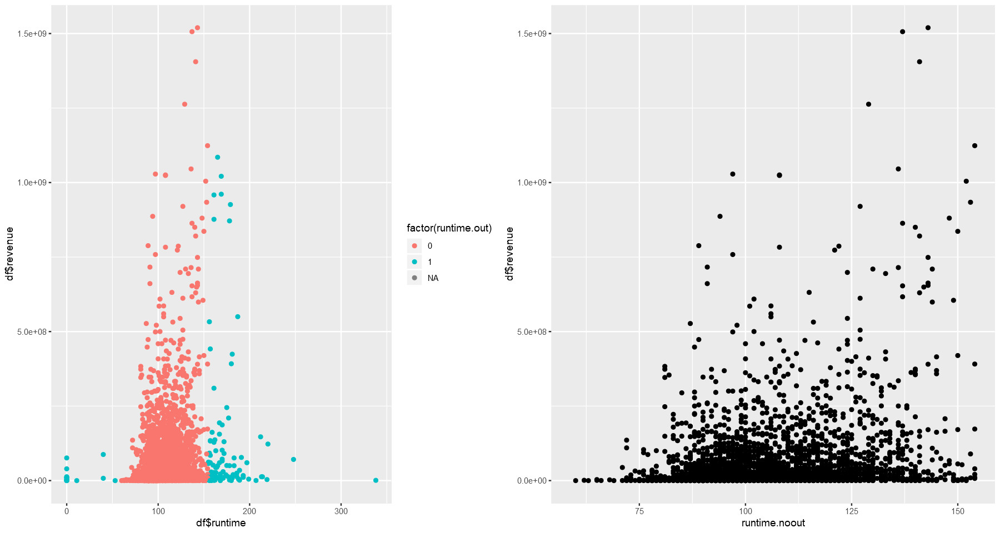

In [25]:
p1 <- ggplot() + geom_point(aes(x=df$runtime, y=df$revenue, color=factor(runtime.out)))
p2 <- ggplot() + geom_point(aes(x=runtime.noout, y=df$revenue))

options(repr.plot.width = 15, repr.plot.height = 8)
grid.arrange(p1, p2, nrow = 1)


In [117]:
budget.out <- ifelse(df[["budget"]] > 72500000, 1, 0)
table(budget.out)

budget.out
   0    1 
6751  624 

In [27]:
budget.noout <- df[["budget"]]
budget.noout  <- ifelse(budget.out ==1,NA,budget.noout )
head(budget.noout )

[1] 14000000 40000000  3300000  1200000        0  8000000

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4631 rows containing missing values (geom_point)."


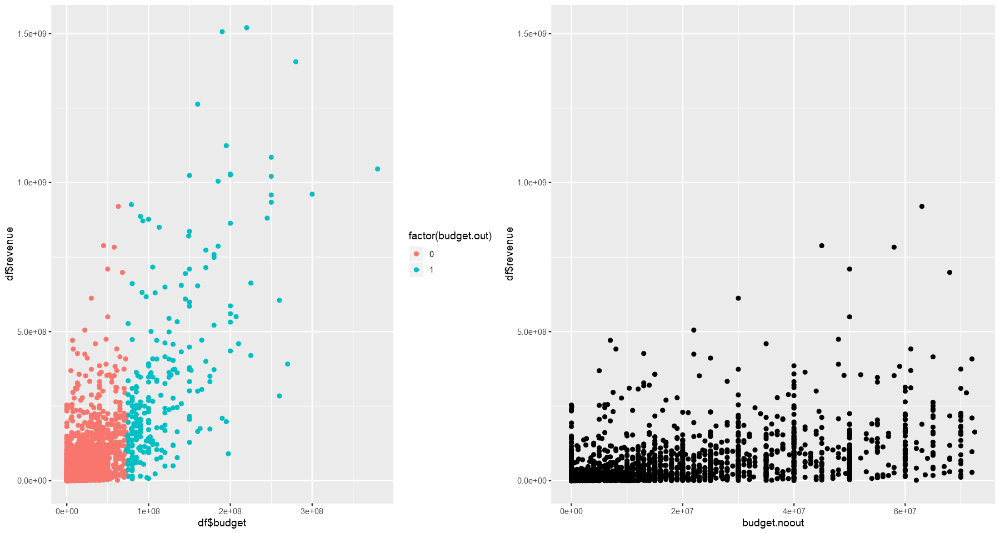

In [28]:
p1 <- ggplot() + geom_point(aes(x=df$budget, y=df$revenue, color=factor(budget.out)))
p2 <- ggplot() + geom_point(aes(x=budget.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)


release_year.out
   0    1 
7105  269 

[1] 1963

[1] 269

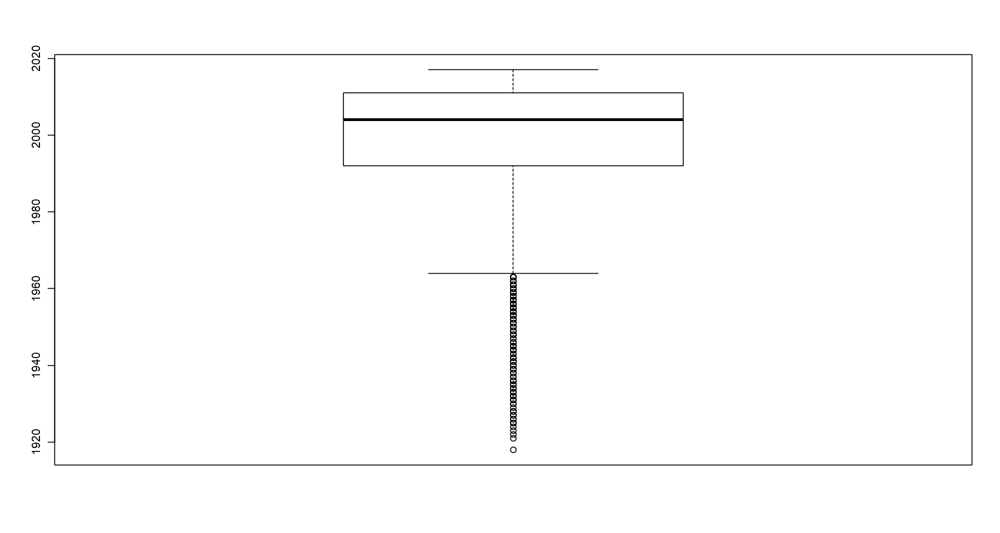

In [127]:
release_year.out <- ifelse(df[["release_year"]] <= 1963, 1, 0)
table(release_year.out)
max(boxplot(df$release_year)$out)
length(boxplot(df$release_year)$out)

In [128]:
release_year.noout <- df[["release_year"]]
release_year.noout  <- ifelse(release_year.out ==1,NA,release_year.noout )
head(release_year.noout)

[1] 2015 2004 2014 2012 2009 1987

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4496 rows containing missing values (geom_point)."


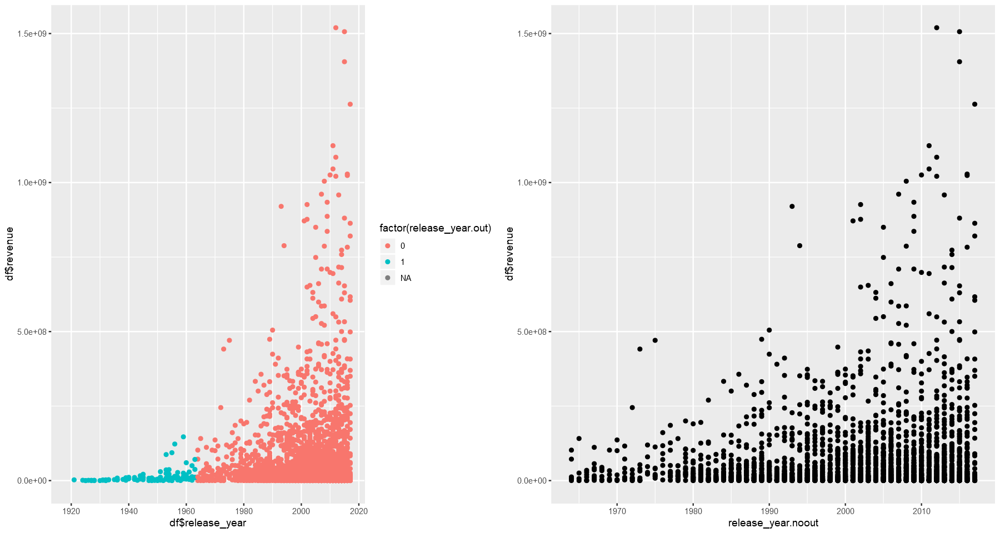

In [129]:
p1 <- ggplot() + geom_point(aes(x=df$release_year, y=df$revenue, color=factor(release_year.out)))
p2 <- ggplot() + geom_point(aes(x=release_year.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

sw_collection.out
   0    1 
7169  206 

[1] 1

[1] 206

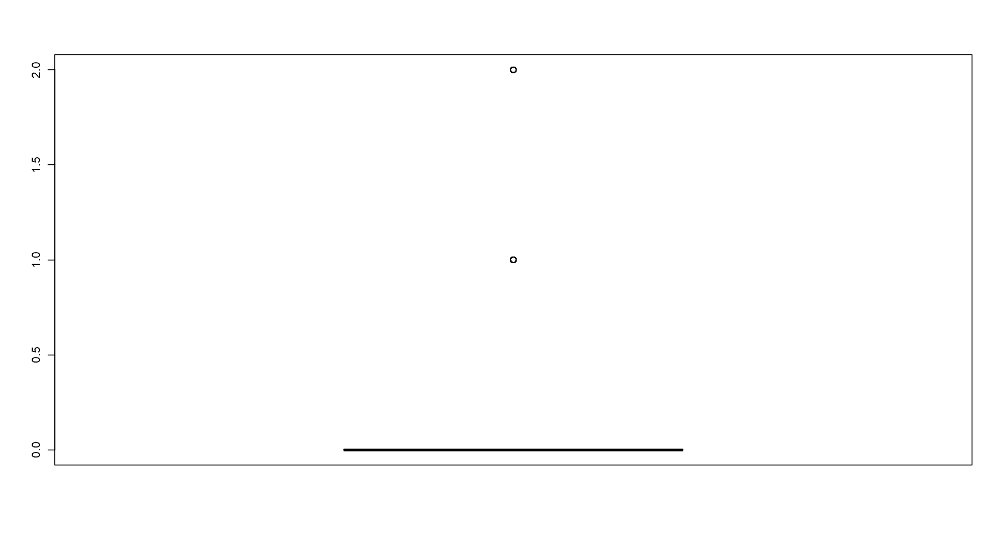

In [139]:
sw_collection.out <- ifelse(df[["sw_collection"]] >= 1, 1, 0)
table(sw_collection.out)
min(boxplot(df$sw_collection)$out)
length(boxplot(df$sw_collection)$out)

In [140]:
sw_collection.noout <- df[["sw_collection"]]
sw_collection.noout  <- ifelse(sw_collection.out ==1,NA,sw_collection.noout )
head(sw_collection.noout )

[1] 0 0 0 0 0 0

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4464 rows containing missing values (geom_point)."


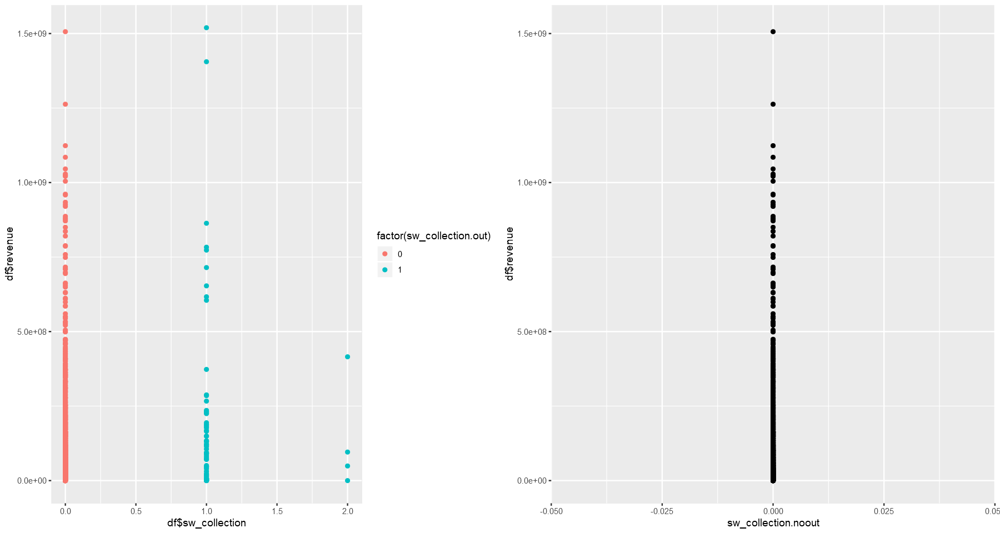

In [141]:
p1 <- ggplot() + geom_point(aes(x=df$sw_collection, y=df$revenue, color=factor(sw_collection.out)))
p2 <- ggplot() + geom_point(aes(x=sw_collection.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)


In [114]:
popularity.out <- ifelse(df[["popularity"]] > 21.364300 | df[["popularity"]] < 0.000001, 1, 0)
table(popularity.out)

popularity.out
   0    1 
7174  201 

In [115]:
popularity.noout <- df[["popularity"]]
popularity.noout  <- ifelse(popularity.out ==1,NA,popularity.noout )
head(popularity.noout )

[1] 6.575393 8.248895       NA 3.174936 1.148070 0.743274

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4451 rows containing missing values (geom_point)."


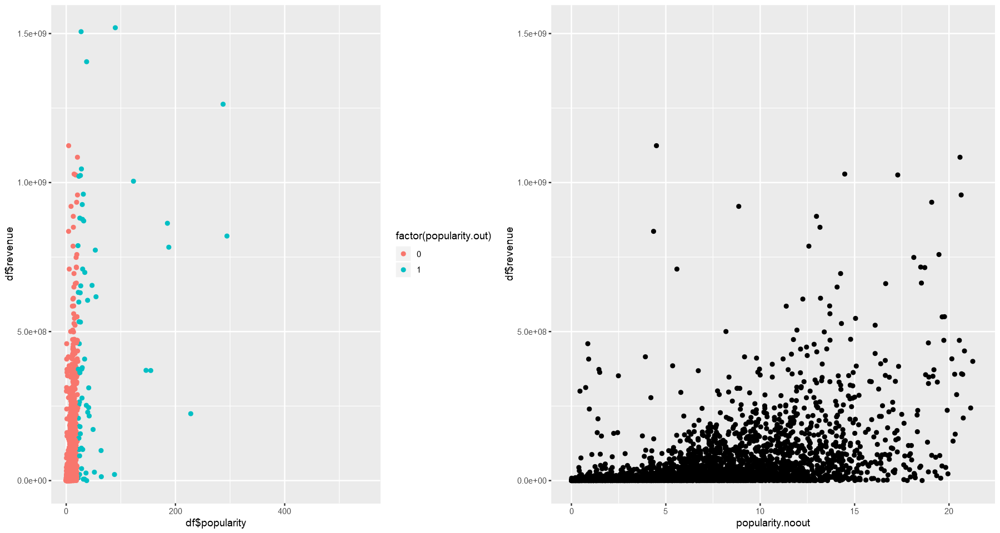

In [116]:
p1 <- ggplot() + geom_point(aes(x=df$popularity, y=df$revenue, color=factor(popularity.out)))
p2 <- ggplot() + geom_point(aes(x=popularity.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)


In [110]:
revenue.out <- ifelse(df[["revenue"]] >= 169852759 , 1, 0)
table(revenue.out)

revenue.out
   0    1 
2678  315 

In [111]:
revenue.noout <- df[["revenue"]]
revenue.noout  <- ifelse(revenue.out ==1,NA,revenue.noout )
head(revenue.noout )

[1] 12314651 95149435 13092000 16000000  3923970  3261638

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4697 rows containing missing values (geom_point)."


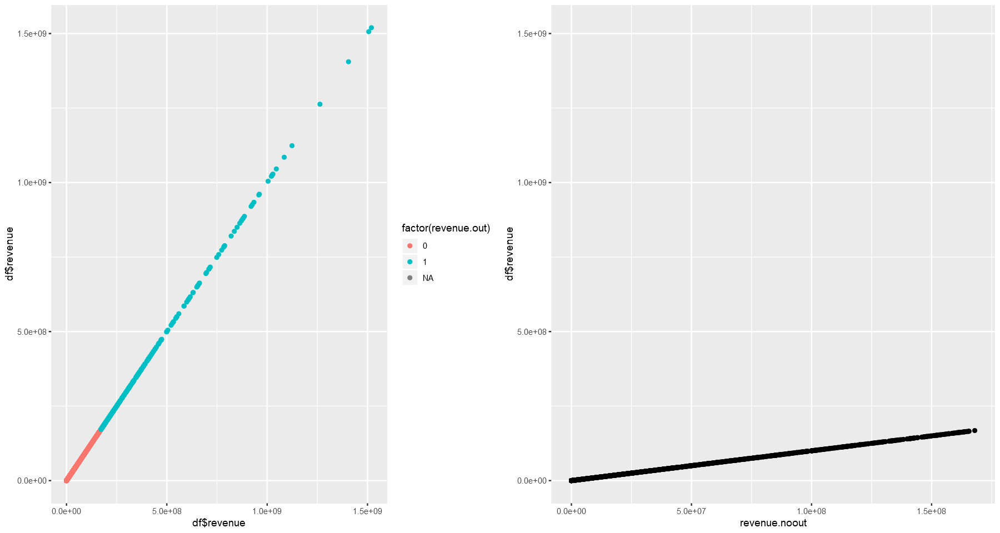

In [112]:
p1 <- ggplot() + geom_point(aes(x=df$revenue, y=df$revenue, color=factor(revenue.out)))
p2 <- ggplot() + geom_point(aes(x=revenue.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)


In [107]:
producers_cnt.out <- ifelse(df[["producers_cnt"]] > 8 , 1, 0)
table(producers_cnt.out)

producers_cnt.out
   0    1 
6817  163 

In [108]:
producers_cnt.noout <- df[["producers_cnt"]]
producers_cnt.noout  <- ifelse(producers_cnt.out ==1,NA,producers_cnt.noout )
head(producers_cnt.noout )

[1]  3  1  3 NA NA NA

Warning message:
"Removed 4531 rows containing missing values (geom_point)."
Warning message:
"Removed 4584 rows containing missing values (geom_point)."


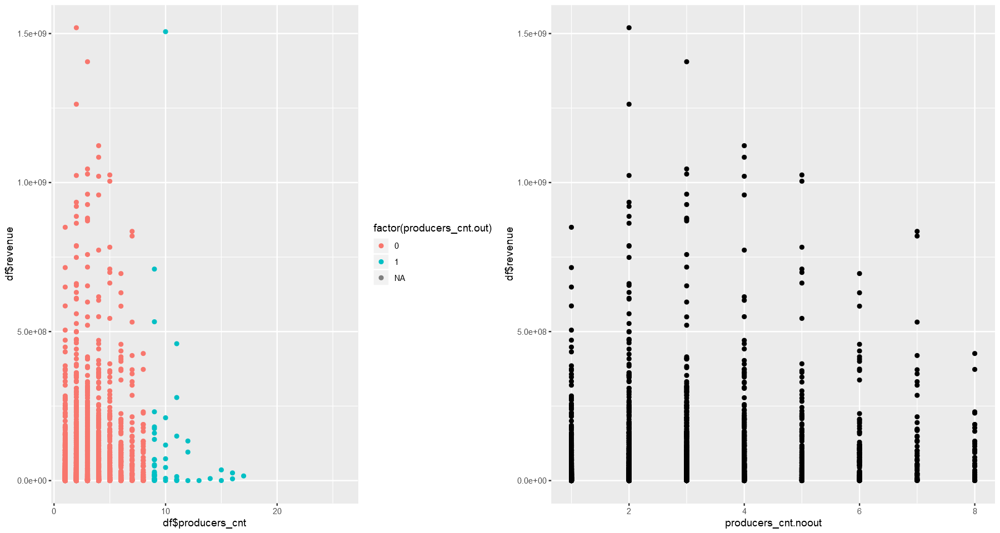

In [109]:
p1 <- ggplot() + geom_point(aes(x=df$producers_cnt, y=df$revenue, color=factor(producers_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=producers_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [106]:
countries_cnt.out <- ifelse(df[["countries_cnt"]] > 1 | df[["countries_cnt"]] <= 0, 1, 0)
table(countries_cnt.out)

countries_cnt.out
   0    1 
5452 1923 

In [33]:
countries_cnt.noout <- df[["countries_cnt"]]
countries_cnt.noout  <- ifelse(countries_cnt.out ==1,NA,countries_cnt.noout )
head(countries_cnt.noout )

[1]  1  1  1  1  1 NA

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 5156 rows containing missing values (geom_point)."


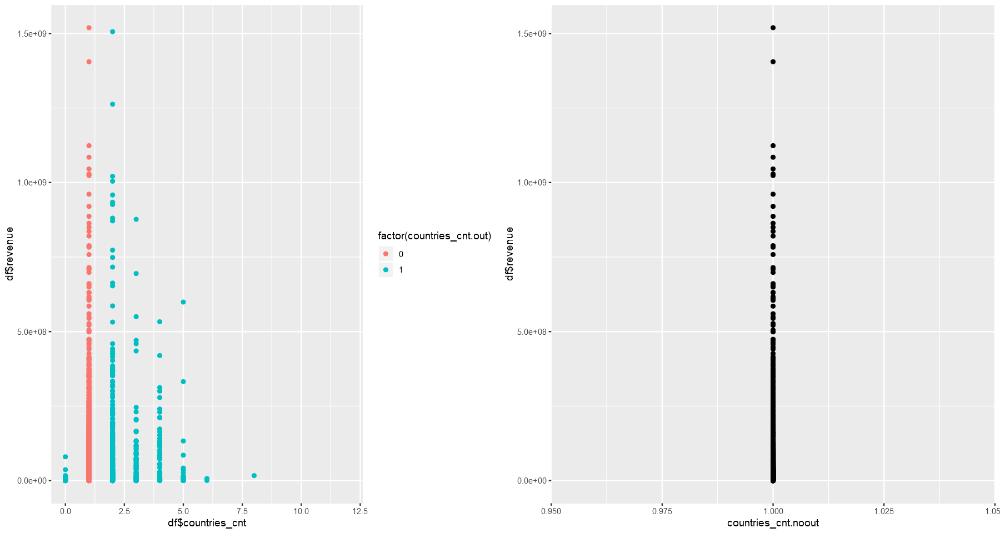

In [34]:
p1 <- ggplot() + geom_point(aes(x=df$countries_cnt, y=df$revenue, color=factor(countries_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=countries_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [105]:
keywords_cnt.out <- ifelse(df[["keywords_cnt"]] >= 21 , 1, 0)
table(keywords_cnt.out)

keywords_cnt.out
   0    1 
7097  278 

In [99]:
keywords_cnt.noout <- df[["keywords_cnt"]]
keywords_cnt.noout  <- ifelse(keywords_cnt.out ==1,NA,keywords_cnt.noout )
head(keywords_cnt.noout )

[1]  4  4 12  7  0  0

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4491 rows containing missing values (geom_point)."


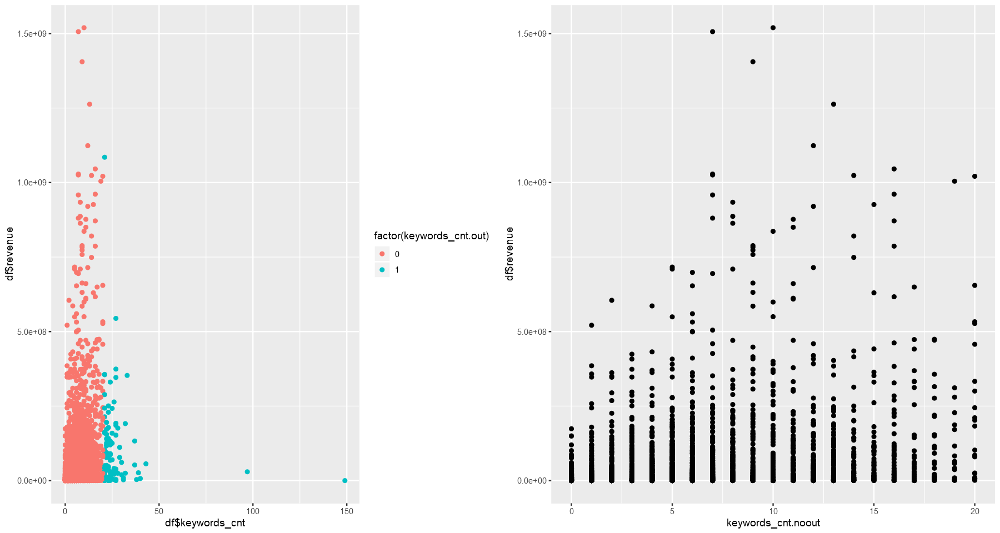

In [100]:
p1 <- ggplot() + geom_point(aes(x=df$keywords_cnt, y=df$revenue, color=factor(keywords_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=keywords_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [102]:
actor0_movies_cnt.out <- ifelse(df[["actor0_movies_cnt"]] >= 28 , 1, 0)
table(actor0_movies_cnt.out)

actor0_movies_cnt.out
   0    1 
7069  306 

In [103]:
actor0_movies_cnt.noout <- df[["actor0_movies_cnt"]]
actor0_movies_cnt.noout  <- ifelse(actor0_movies_cnt.out ==1,NA,actor0_movies_cnt.noout )
head(actor0_movies_cnt.noout)

[1] 18  3  7  2  0  1

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4519 rows containing missing values (geom_point)."


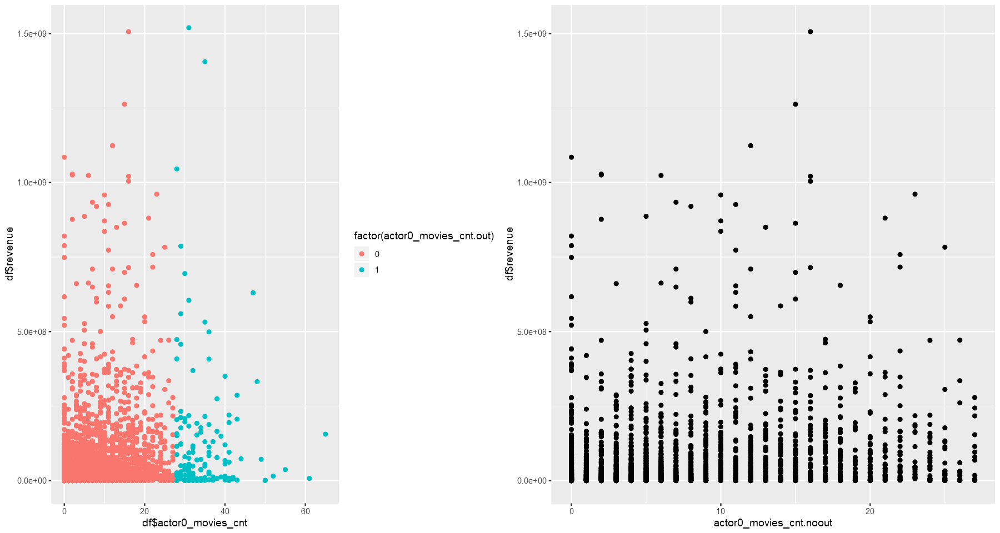

In [104]:
p1 <- ggplot() + geom_point(aes(x=df$actor0_movies_cnt, y=df$revenue, color=factor(actor0_movies_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=actor0_movies_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [98]:
actor0_movies_5y_cnt.out <- ifelse(df[["actor0_movies_5y_cnt"]] >= 13 , 1, 0)
table(actor0_movies_5y_cnt.out)

actor0_movies_5y_cnt.out
   0    1 
7323   52 

In [37]:
actor0_movies_5y_cnt.noout <- df[["actor0_movies_5y_cnt"]]
actor0_movies_5y_cnt.noout  <- ifelse(actor0_movies_5y_cnt.out ==1,NA,actor0_movies_5y_cnt.noout )
head(actor0_movies_5y_cnt.noout )

[1] 11  3  7  1  0  1

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4409 rows containing missing values (geom_point)."


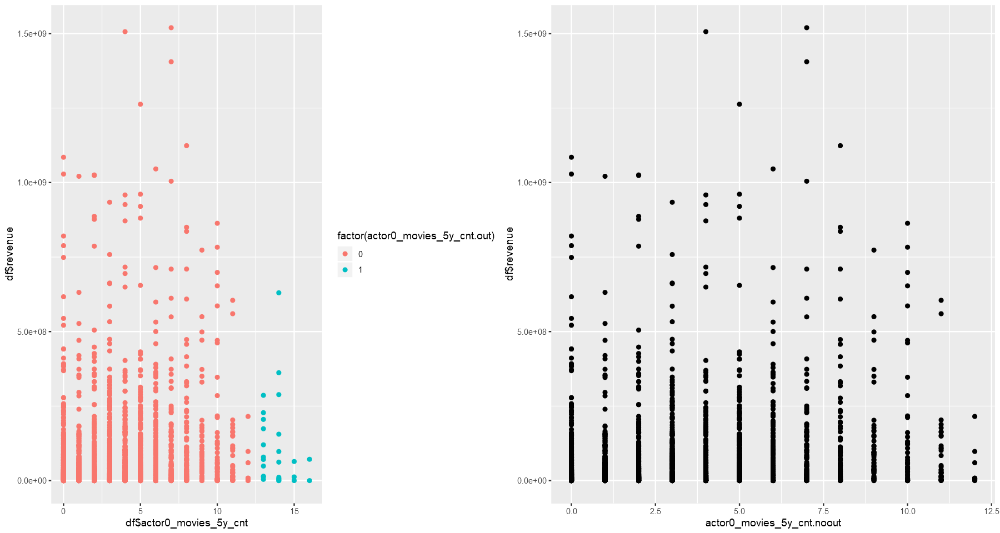

In [38]:
p1 <- ggplot() + geom_point(aes(x=df$actor0_movies_5y_cnt, y=df$revenue, color=factor(actor0_movies_5y_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=actor0_movies_5y_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [97]:
actor1_movies_cnt.out <- ifelse(df[["actor1_movies_cnt"]] >= 21 , 1, 0)
table(actor1_movies_cnt.out)

actor1_movies_cnt.out
   0    1 
6964  411 

In [40]:
actor1_movies_cnt.noout <- df[["revenue"]]
actor1_movies_cnt.noout  <- ifelse(actor1_movies_cnt.out ==1,NA,actor1_movies_cnt.noout )
head(actor1_movies_cnt.noout )

[1] 12314651 95149435       NA 16000000  3923970  3261638

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4571 rows containing missing values (geom_point)."


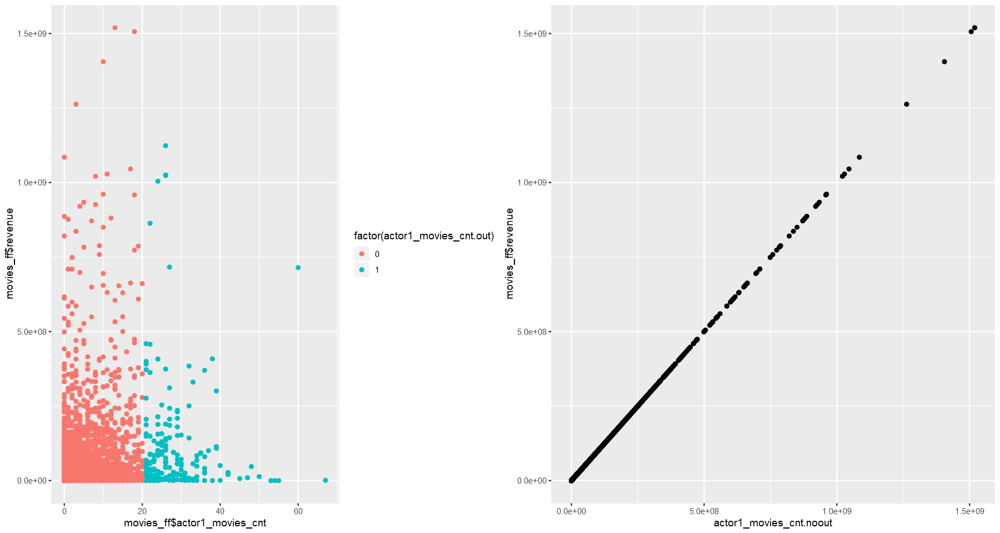

In [175]:
p1 <- ggplot() + geom_point(aes(x=df$actor1_movies_cnt, y=df$revenue, color=factor(actor1_movies_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=actor1_movies_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [96]:
actor1_movies_5y_cnt.out <- ifelse(df[["actor1_movies_5y_cnt"]] >= 11 , 1, 0)
table(actor1_movies_5y_cnt.out)

actor1_movies_5y_cnt.out
   0    1 
7243  132 

In [42]:
actor1_movies_5y_cnt.noout <- df[["actor1_movies_5y_cnt"]]
actor1_movies_5y_cnt.noout  <- ifelse(actor1_movies_5y_cnt.out ==1,NA,actor1_movies_5y_cnt.noout )
head(actor1_movies_5y_cnt.noout )

[1]  4  2 NA  2  0  0

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4409 rows containing missing values (geom_point)."


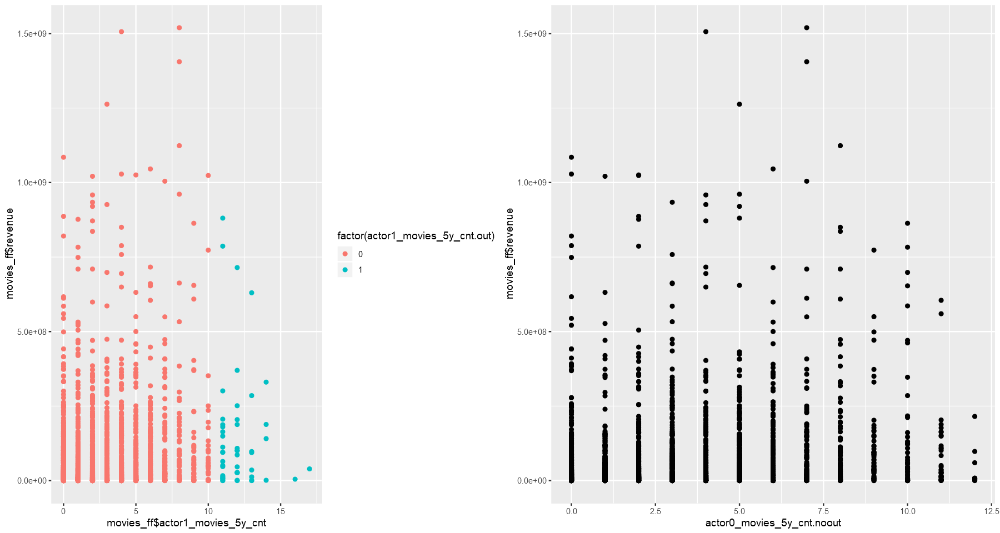

In [176]:
p1 <- ggplot() + geom_point(aes(x=df$actor1_movies_5y_cnt, y=df$revenue, color=factor(actor1_movies_5y_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=actor0_movies_5y_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [95]:
actor2_movies_cnt.out <- ifelse(df[["actor2_movies_cnt"]] >= 18 , 1, 0)
table(actor2_movies_cnt.out)

actor2_movies_cnt.out
   0    1 
6868  507 

In [44]:
actor2_movies_cnt.noout <- df[["actor2_movies_cnt"]]
actor2_movies_cnt.noout  <- ifelse(actor2_movies_cnt.out ==1,NA,actor2_movies_cnt.noout )
head(actor2_movies_cnt.noout )

[1]  8 13  0  0  0  0

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4616 rows containing missing values (geom_point)."


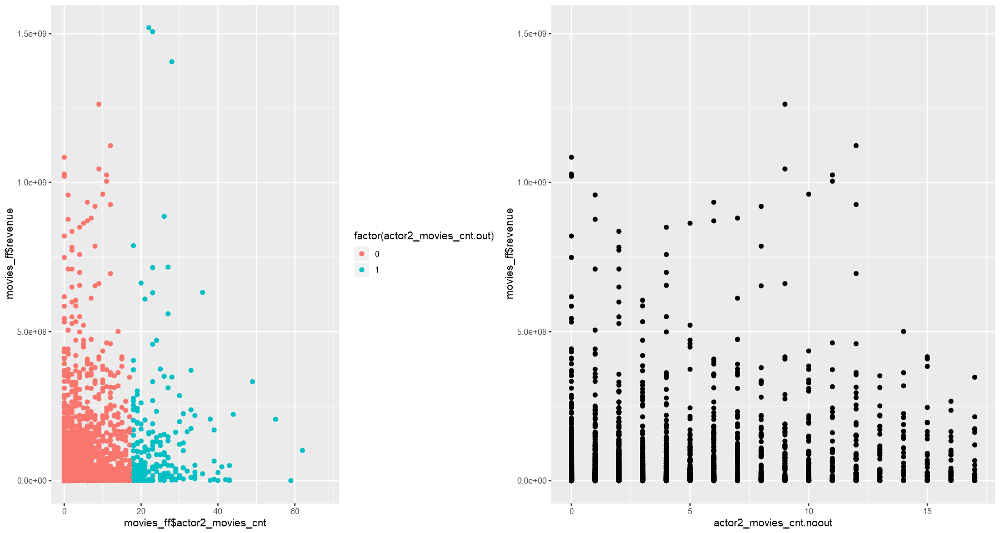

In [177]:
p1 <- ggplot() + geom_point(aes(x=df$actor2_movies_cnt, y=df$revenue, color=factor(actor2_movies_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=actor2_movies_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [94]:
actor2_movies_5y_cnt.out <- ifelse(df[["actor2_movies_5y_cnt"]] >= 8 , 1, 0)
table(actor2_movies_5y_cnt.out)

actor2_movies_5y_cnt.out
   0    1 
7030  345 

In [46]:
actor2_movies_5y_cnt.noout <- df[["actor2_movies_5y_cnt"]]
actor2_movies_5y_cnt.noout  <- ifelse(actor2_movies_5y_cnt.out ==1,NA,actor2_movies_5y_cnt.noout )
head(actor2_movies_5y_cnt.noout )

[1] 6 4 0 0 0 0

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4432 rows containing missing values (geom_point)."


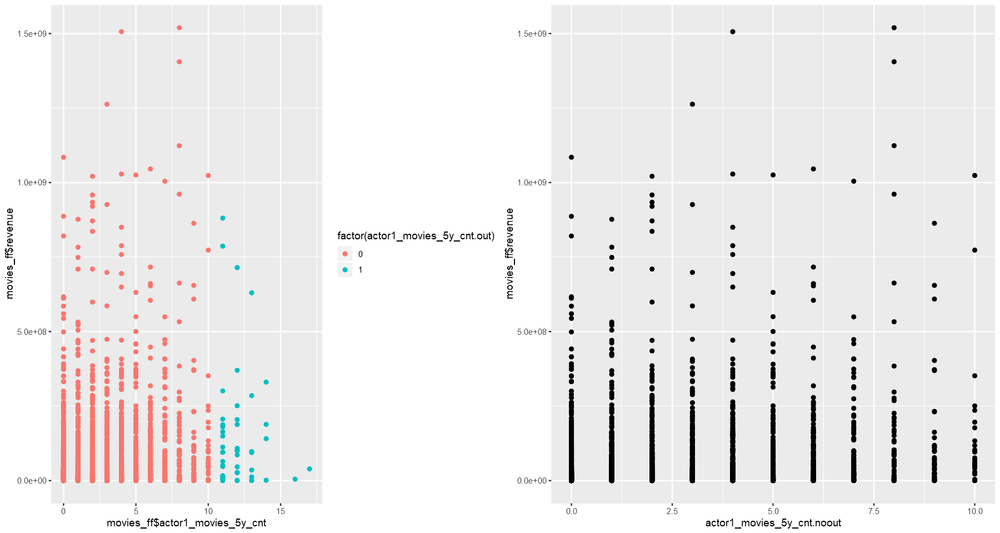

In [178]:
p1 <- ggplot() + geom_point(aes(x=df$actor1_movies_5y_cnt, y=df$revenue, color=factor(actor1_movies_5y_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=actor1_movies_5y_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [93]:
actor0_prev_revenue.out <- ifelse(df[["actor0_prev_revenue"]] >= 714766572 , 1, 0)
table(actor0_prev_revenue.out)

actor0_prev_revenue.out
   0    1 
4342  281 

In [48]:
actor0_prev_revenue.noout <- df[["actor0_prev_revenue"]]
actor0_prev_revenue.noout  <- ifelse(actor0_prev_revenue.out ==1,NA,actor0_prev_revenue.noout )
head(actor0_prev_revenue.noout )

[1] 116980662 165335153  48065672   4100000        NA        NA

Warning message:
"Removed 5310 rows containing missing values (geom_point)."
Warning message:
"Removed 5431 rows containing missing values (geom_point)."


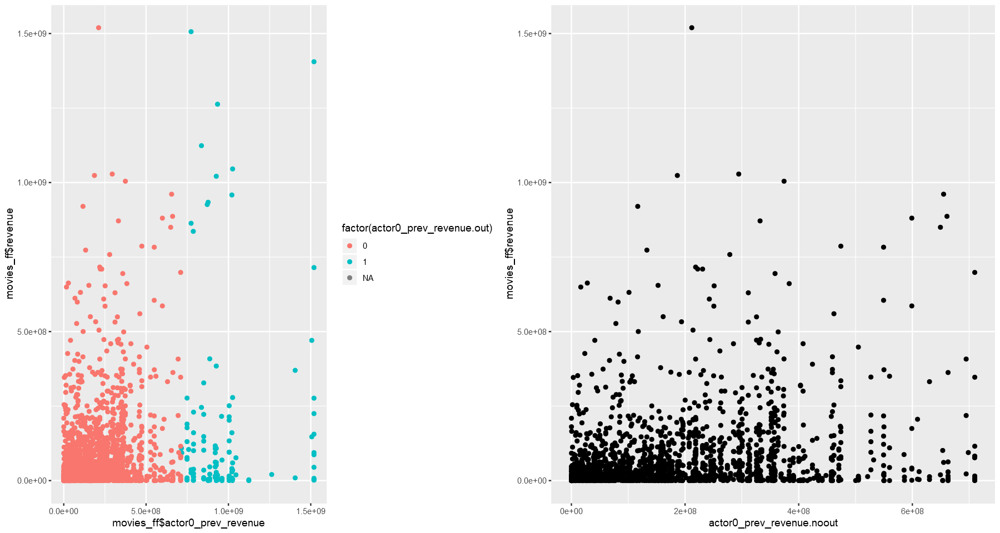

In [181]:
p1 <- ggplot() + geom_point(aes(x=df$actor0_prev_revenue, y=df$revenue, color=factor(actor0_prev_revenue.out)))
p2 <- ggplot() + geom_point(aes(x=actor0_prev_revenue.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [92]:
actor1_prev_revenue.out <- ifelse(df[["actor1_prev_revenue"]] >= 630161890 , 1, 0)
table(actor1_prev_revenue.out)

actor1_prev_revenue.out
   0    1 
3848  326 

In [50]:
actor1_prev_revenue.noout <- df[["actor1_prev_revenue"]]
actor1_prev_revenue.noout  <- ifelse(actor1_prev_revenue.out ==1,NA,actor1_prev_revenue.noout )
head(actor1_prev_revenue.noout )

[1] 219076518 165335153 231411584        NA        NA        NA

Warning message:
"Removed 5534 rows containing missing values (geom_point)."
Warning message:
"Removed 5668 rows containing missing values (geom_point)."


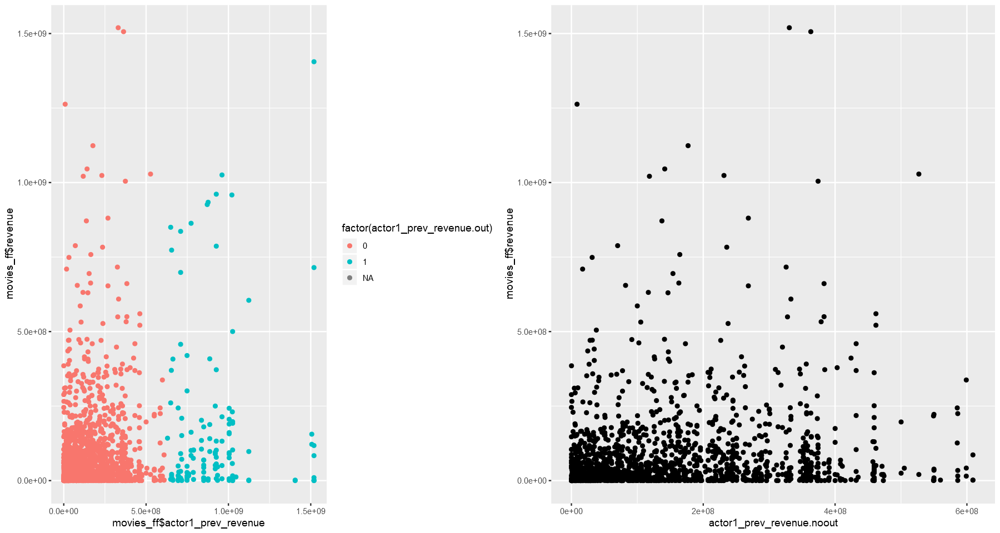

In [182]:
p1 <- ggplot() + geom_point(aes(x=df$actor1_prev_revenue, y=df$revenue, color=factor(actor1_prev_revenue.out)))
p2 <- ggplot() + geom_point(aes(x=actor1_prev_revenue.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [91]:
actor2_prev_revenue.out <- ifelse(df[["actor2_prev_revenue"]] >= 585349010 , 1, 0)
table(actor2_prev_revenue.out)


actor2_prev_revenue.out
   0    1 
3621  331 

In [201]:
actor2_prev_revenue.noout <- df[["actor2_prev_revenue"]]
actor2_prev_revenue.noout  <- ifelse(actor2_prev_revenue.out ==1,NA,actor2_prev_revenue.noout )
head(actor2_prev_revenue.noout )

[1] 121463226 309457509        NA        NA        NA        NA

Warning message:
"Removed 5621 rows containing missing values (geom_point)."
Warning message:
"Removed 5765 rows containing missing values (geom_point)."


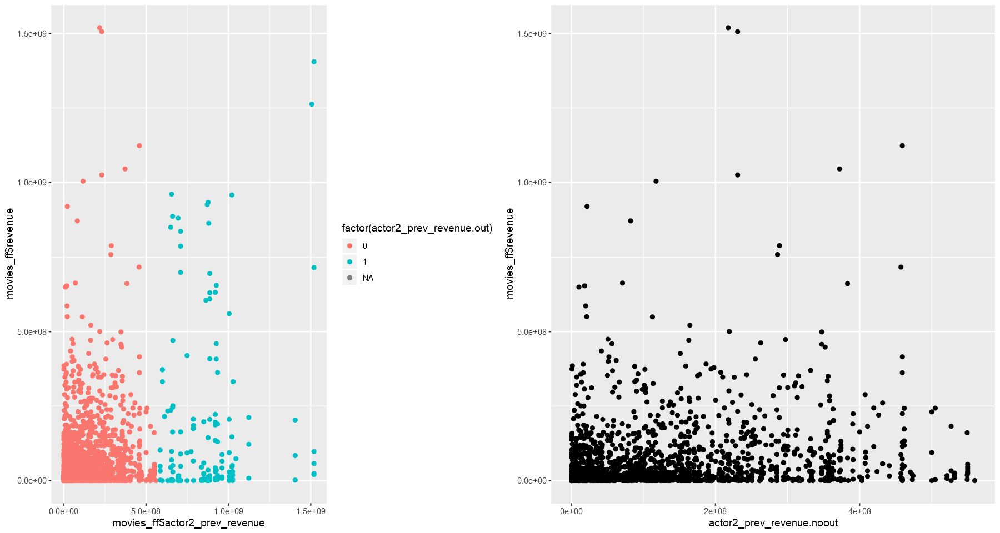

In [183]:
p1 <- ggplot() + geom_point(aes(x=df$actor2_prev_revenue, y=df$revenue, color=factor(actor2_prev_revenue.out)))
p2 <- ggplot() + geom_point(aes(x=actor2_prev_revenue.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [90]:
director_movies_cnt.out <- ifelse(df[["director_movies_cnt"]] >= 8 , 1, 0)
table(director_movies_cnt.out)


director_movies_cnt.out
   0    1 
6948  427 

In [88]:
director_movies_cnt.noout <- df[["director_movies_cnt"]]
director_movies_cnt.noout  <- ifelse(director_movies_cnt.out ==1,NA,director_movies_cnt.noout )
head(director_movies_cnt.noout )

[1]  3 NA  0  0  0  0

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4548 rows containing missing values (geom_point)."


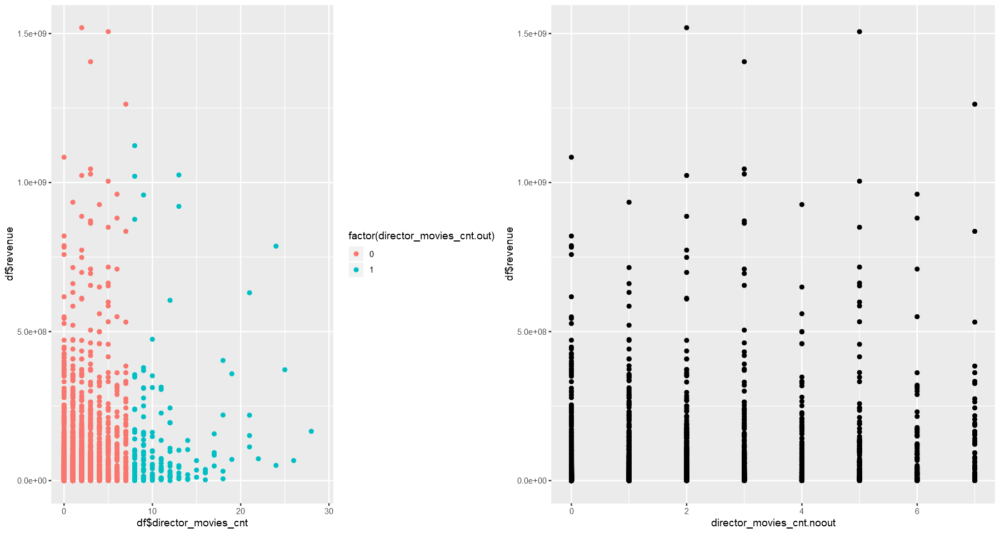

In [89]:
p1 <- ggplot() + geom_point(aes(x=df$director_movies_cnt, y=df$revenue, color=factor(director_movies_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=director_movies_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [53]:
director_movies_5y_cnt.out <- ifelse(df[["director_movies_5y_cnt"]] >= 3 , 1, 0)
table(director_movies_5y_cnt.out)
out_director_movies_5y_cnt$stats

director_movies_5y_cnt.out
   0    1 
7025  350 

ERROR: Error in eval(expr, envir, enclos): object 'out_director_movies_5y_cnt' not found


In [203]:
director_movies_5y_cnt.noout <- df[["director_movies_5y_cnt"]]
director_movies_5y_cnt.noout  <- ifelse(director_movies_5y_cnt.out ==1,NA,director_movies_5y_cnt.noout )
head(director_movies_5y_cnt.noout )

[1] 2 2 0 0 0 0

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4518 rows containing missing values (geom_point)."


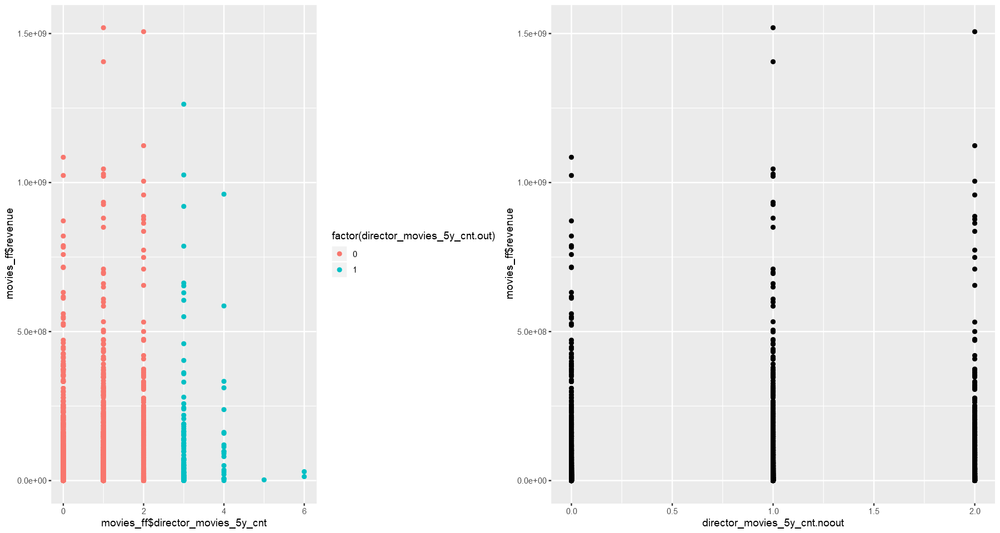

In [185]:
p1 <- ggplot() + geom_point(aes(x=df$director_movies_5y_cnt, y=df$revenue, color=factor(director_movies_5y_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=director_movies_5y_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Art.out
   0    1 
6648  693 

[1] 8

[1] 693

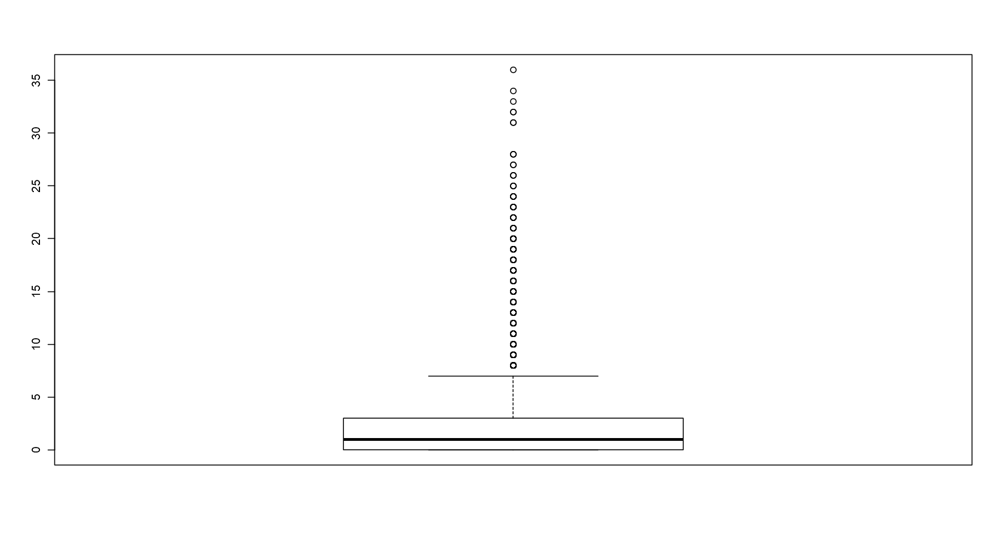

In [54]:
depart_Art.out <- ifelse(df[["depart_Art"]] >= 8 , 1, 0)
table(depart_Art.out)
min(boxplot(df$depart_Art)$out)
length(boxplot(df$depart_Art)$out)

In [144]:
depart_Art.noout <- df[["depart_Art"]]
depart_Art.noout  <- ifelse(depart_Art.out ==1,NA,depart_Art.noout )
head(depart_Art.noout )

[1] NA  0  5  0  0  1

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4684 rows containing missing values (geom_point)."


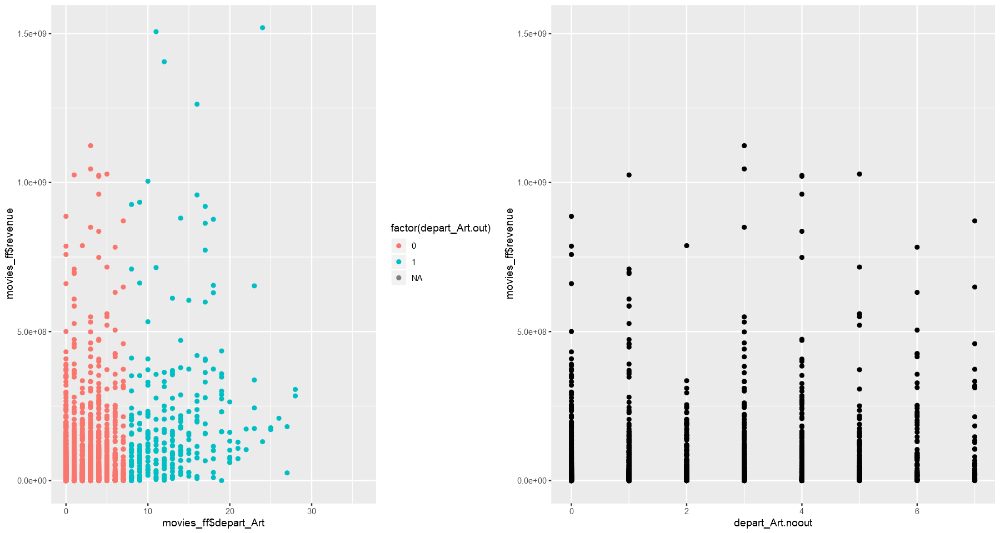

In [188]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Art, y=df$revenue, color=factor(depart_Art.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Art.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Camera.out
   0    1 
6671  670 

[1] 6

[1] 670

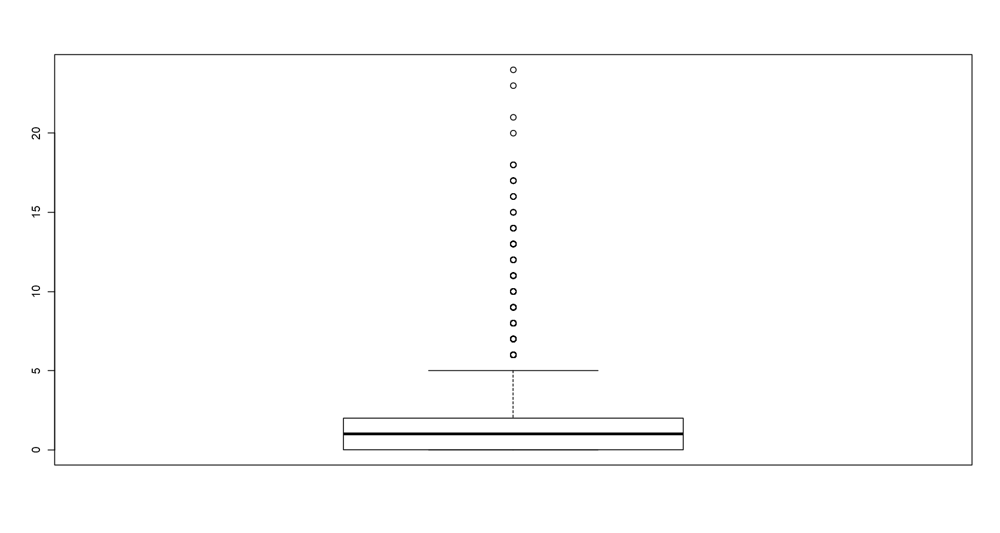

In [55]:
depart_Camera.out <- ifelse(df[["depart_Camera"]] >= 6 , 1, 0)
table(depart_Camera.out)
min(boxplot(df$depart_Camera)$out)
length(boxplot(df$depart_Camera)$out)

In [146]:
depart_Camera.noout <- df[["depart_Camera"]]
depart_Camera.noout  <- ifelse(depart_Camera.out ==1,NA,depart_Camera.noout )
head(depart_Camera.noout )

[1] NA  1  4  0  0  0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4674 rows containing missing values (geom_point)."


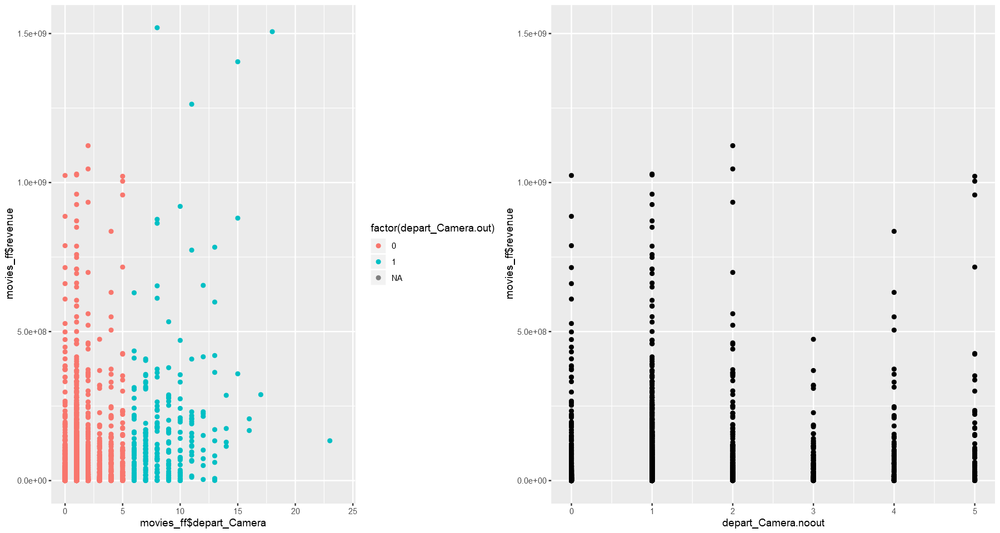

In [189]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Camera, y=df$revenue, color=factor(depart_Camera.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Camera.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Crew.out
   0    1 
6435  906 

[1] 6

[1] 906

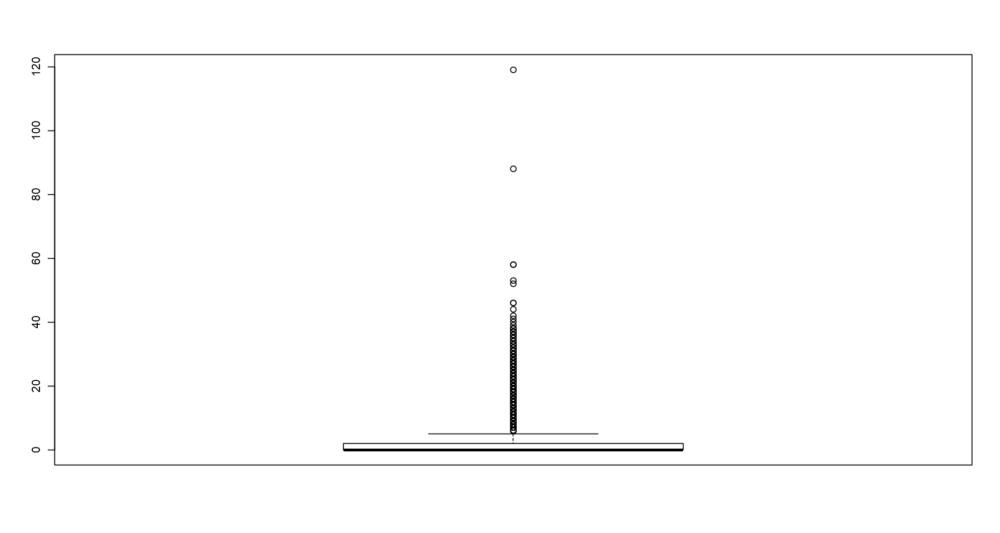

In [56]:
depart_Crew.out <- ifelse(df[["depart_Crew"]] >= 6 , 1, 0)
table(depart_Crew.out)
min(boxplot(df$depart_Crew)$out)
length(boxplot(df$depart_Crew)$out)

In [148]:
depart_Crew.noout <- df[["depart_Crew"]]
depart_Crew.noout  <- ifelse(depart_Crew.out ==1,NA,depart_Crew.noout )
head(depart_Crew.noout )

[1]  4  0 NA  0  0  0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4779 rows containing missing values (geom_point)."


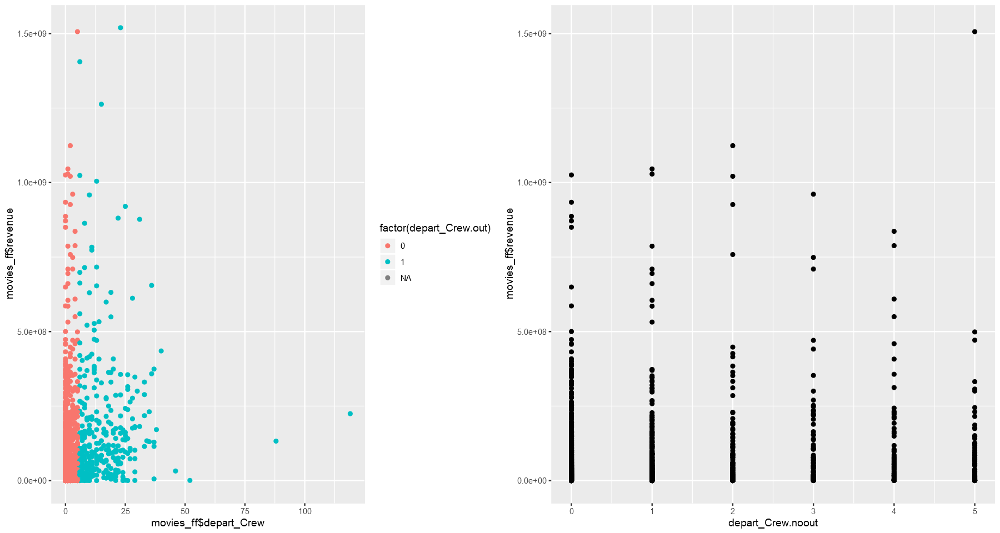

In [190]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Crew, y=df$revenue, color=factor(depart_Crew.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Crew.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Custom_Mkup.out
   0    1 
6358  983 

[1] 6

[1] 983

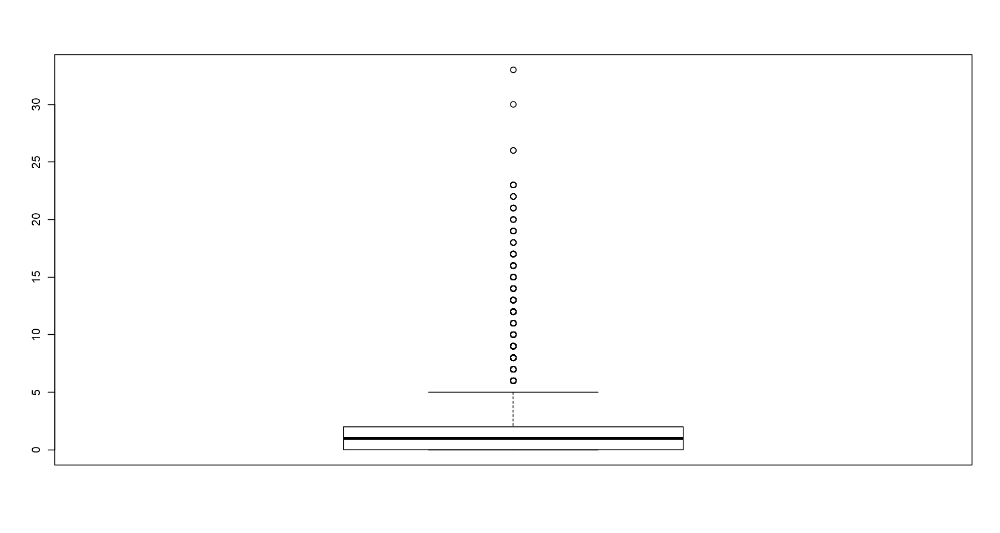

In [149]:
depart_Custom_Mkup.out <- ifelse(df[["depart_Custom_Mkup"]] >= 6 , 1, 0)
table(depart_Custom_Mkup.out)
min(boxplot(df$depart_Custom_Mkup)$out)
length(boxplot(df$depart_Custom_Mkup)$out)

In [150]:
depart_Custom_Mkup.noout <- df[["depart_Custom_Mkup"]]
depart_Custom_Mkup.noout  <- ifelse(depart_Custom_Mkup.out ==1,NA,depart_Custom_Mkup.noout )
head(depart_Custom_Mkup.noout )

[1] NA  0  5  0  0  0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4799 rows containing missing values (geom_point)."


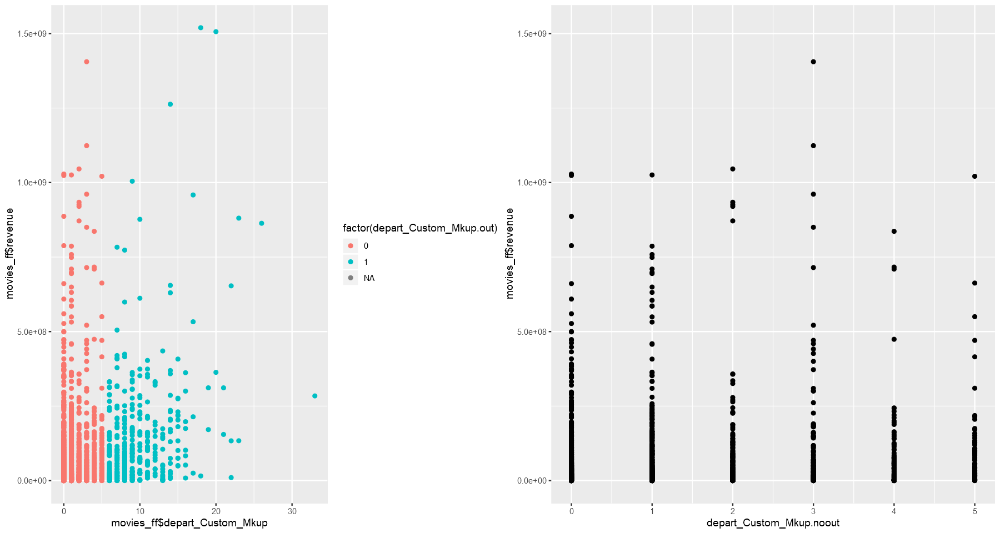

In [191]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Custom_Mkup, y=df$revenue, color=factor(depart_Custom_Mkup.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Custom_Mkup.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Directing.out
   0    1 
6862  479 

[1] 4

[1] 479

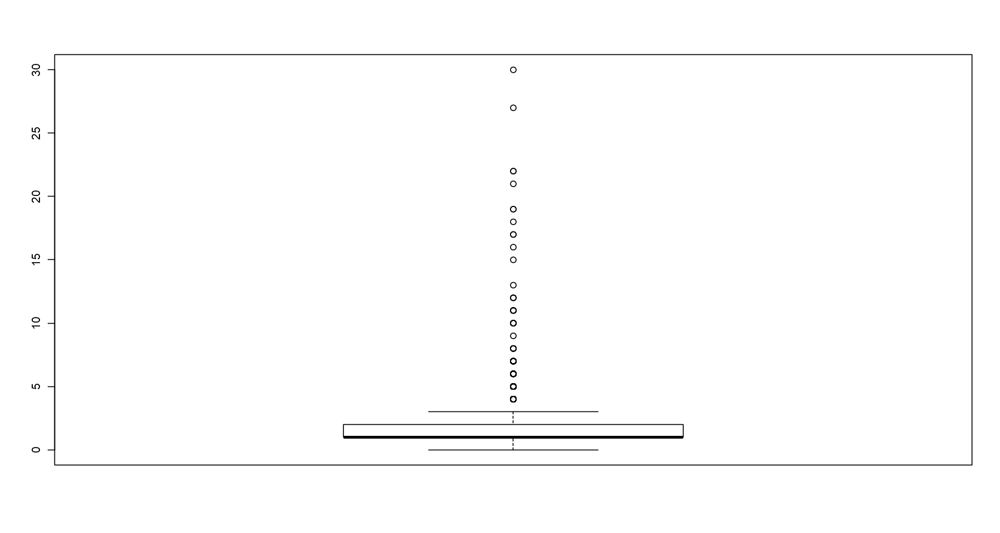

In [151]:
depart_Directing.out <- ifelse(df[["depart_Directing"]] >= 4 , 1, 0)
table(depart_Directing.out)
min(boxplot(df$depart_Directing)$out)
length(boxplot(df$depart_Directing)$out)

In [152]:
depart_Directing.noout <- df[["depart_Directing"]]
depart_Directing.noout  <- ifelse(depart_Directing.out ==1,NA,depart_Directing.noout )
head(depart_Directing.noout )

[1] NA  1  3  1  1  1

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4597 rows containing missing values (geom_point)."


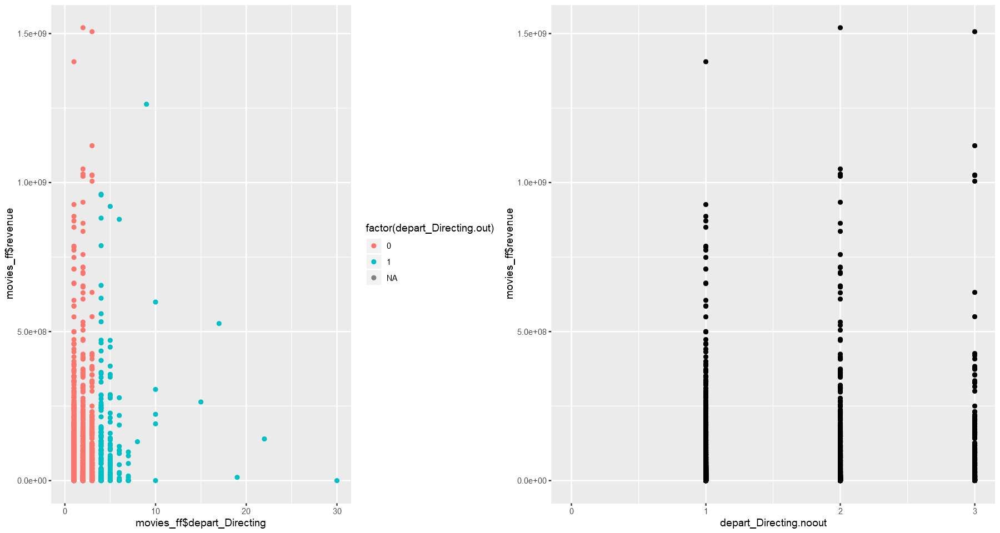

In [192]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Directing, y=df$revenue, color=factor(depart_Directing.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Directing.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Editing.out
   0    1 
7014  327 

[1] 6

[1] 327

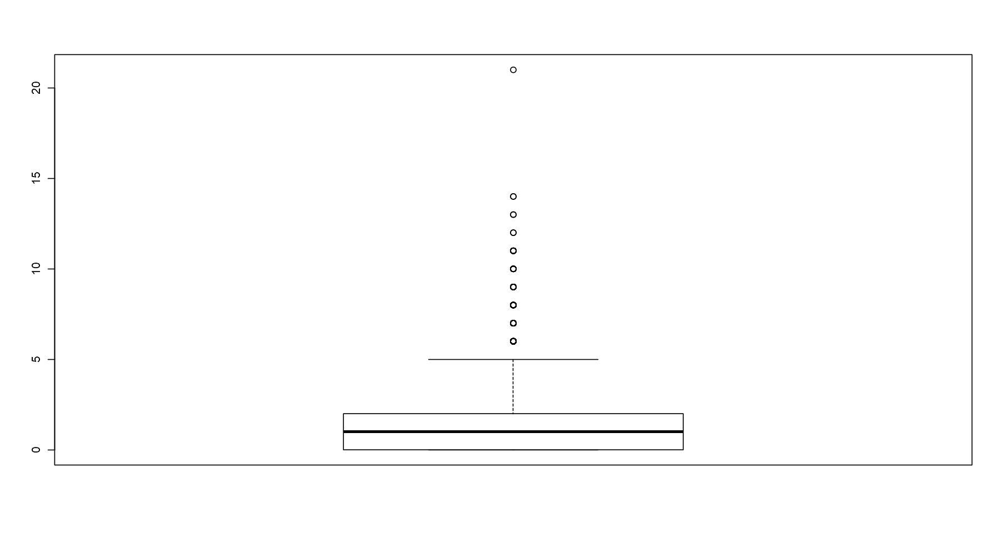

In [153]:
depart_Editing.out <- ifelse(df[["depart_Editing"]] >= 6 , 1, 0)
table(depart_Editing.out)
min(boxplot(df$depart_Editing)$out)
length(boxplot(df$depart_Editing)$out)

In [154]:
depart_Editing.noout <- df[["depart_Editing"]]
depart_Editing.noout  <- ifelse(depart_Editing.out ==1,NA,depart_Editing.noout )
head(depart_Editing.noout )

[1]  2  1 NA  0  0  0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4528 rows containing missing values (geom_point)."


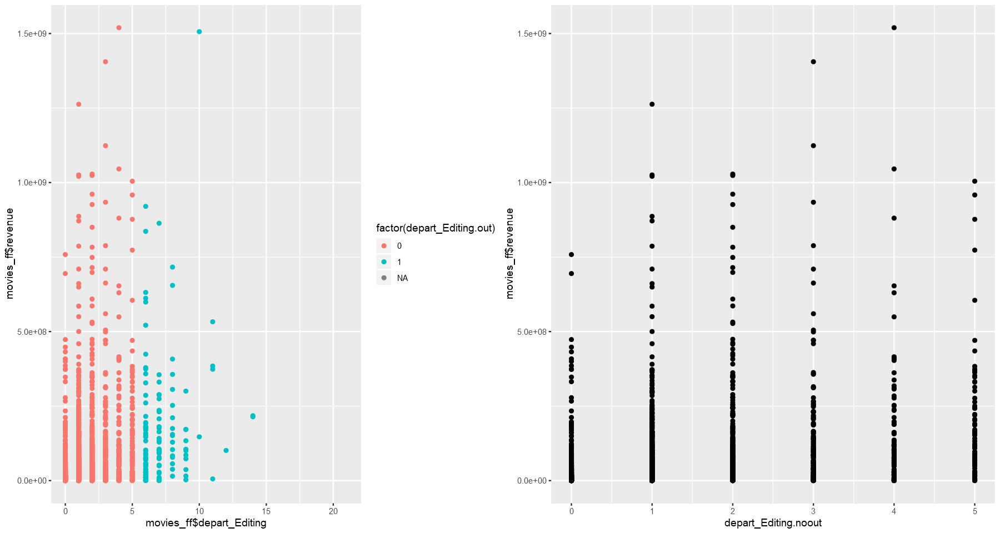

In [193]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Editing, y=df$revenue, color=factor(depart_Editing.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Editing.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Lighting.out
   0    1 
6115 1226 

[1] 1

[1] 1226

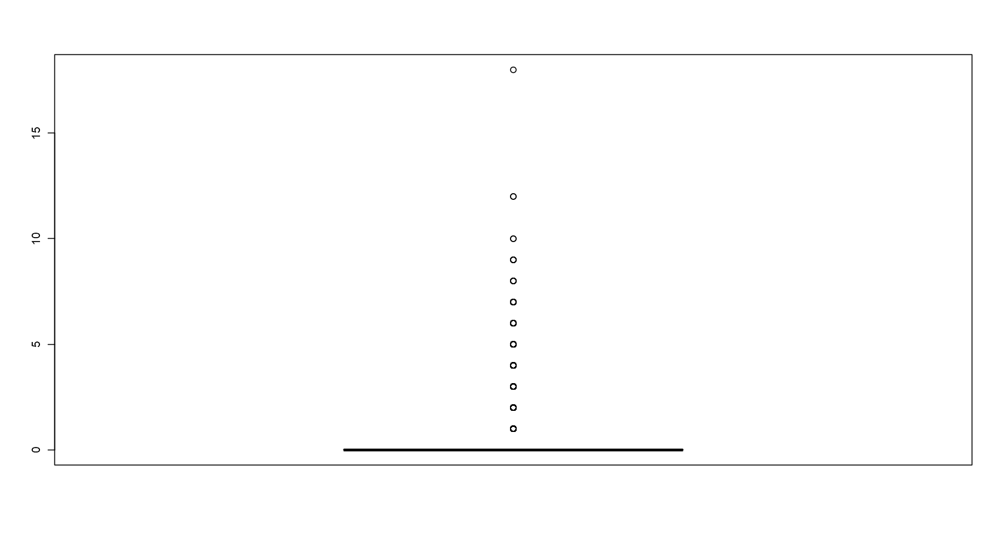

In [155]:
depart_Lighting.out <- ifelse(df[["depart_Lighting"]] >= 1 , 1, 0)
table(depart_Lighting.out)
min(boxplot(df$depart_Lighting)$out)
length(boxplot(df$depart_Lighting)$out)

In [156]:
depart_Lighting.noout <- df[["depart_Lighting"]]
depart_Lighting.noout  <- ifelse(depart_Lighting.out ==1,NA,depart_Lighting.noout )
head(depart_Lighting.noout )

[1] NA  0 NA  0  0  0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4889 rows containing missing values (geom_point)."


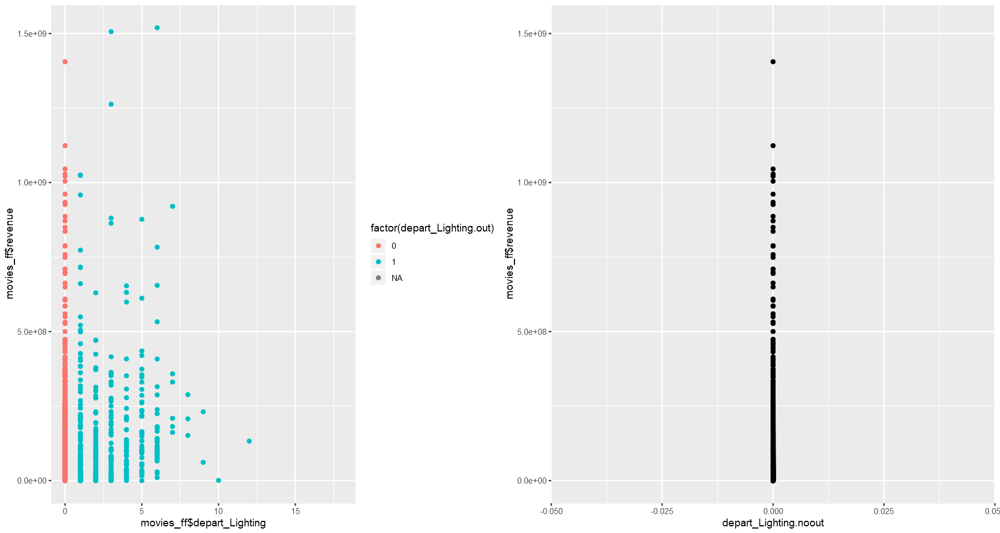

In [194]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Lighting, y=df$revenue, color=factor(depart_Lighting.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Lighting.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Production.out
   0    1 
7126  215 

[1] 19

[1] 215

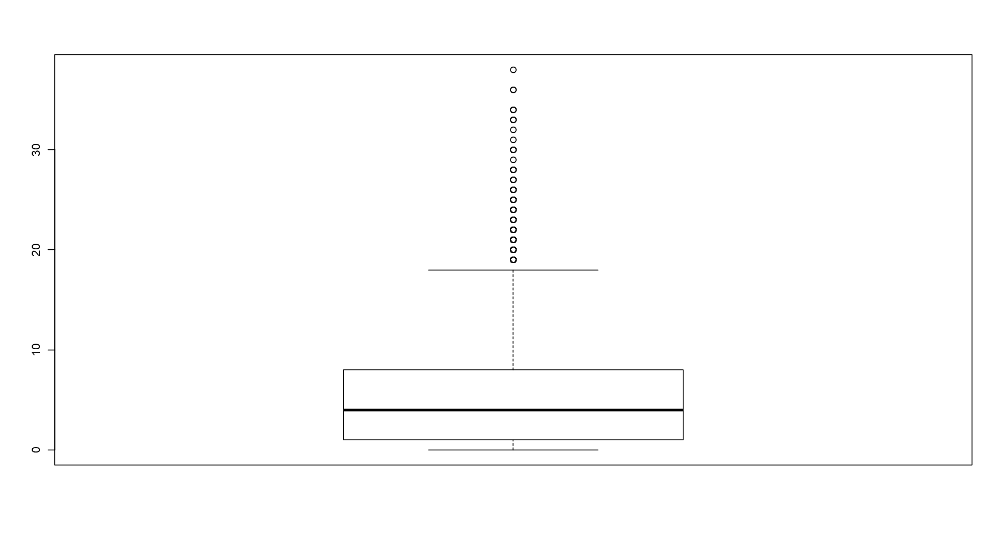

In [157]:
depart_Production.out <- ifelse(df[["depart_Production"]] >= 19 , 1, 0)
table(depart_Production.out)
min(boxplot(df$depart_Production)$out)
length(boxplot(df$depart_Production)$out)

In [158]:
depart_Production.noout <- df[["depart_Production"]]
depart_Production.noout  <- ifelse(depart_Production.out ==1,NA,depart_Production.noout )
head(depart_Production.noout )

[1]  9  4 18  1  0  1

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4432 rows containing missing values (geom_point)."


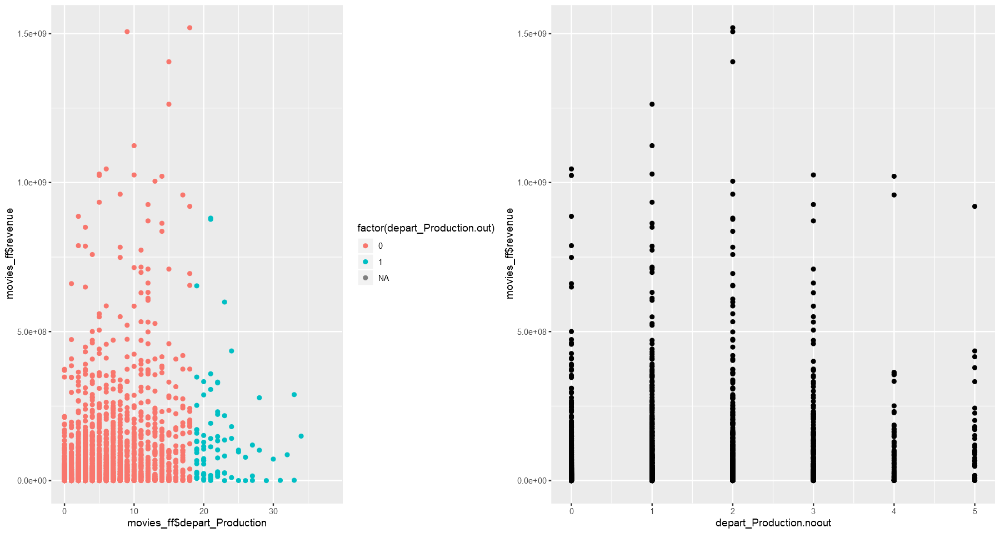

In [195]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Production, y=df$revenue, color=factor(depart_Production.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Production.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Sound.out
   0    1 
6244 1097 

[1] 7

[1] 1249

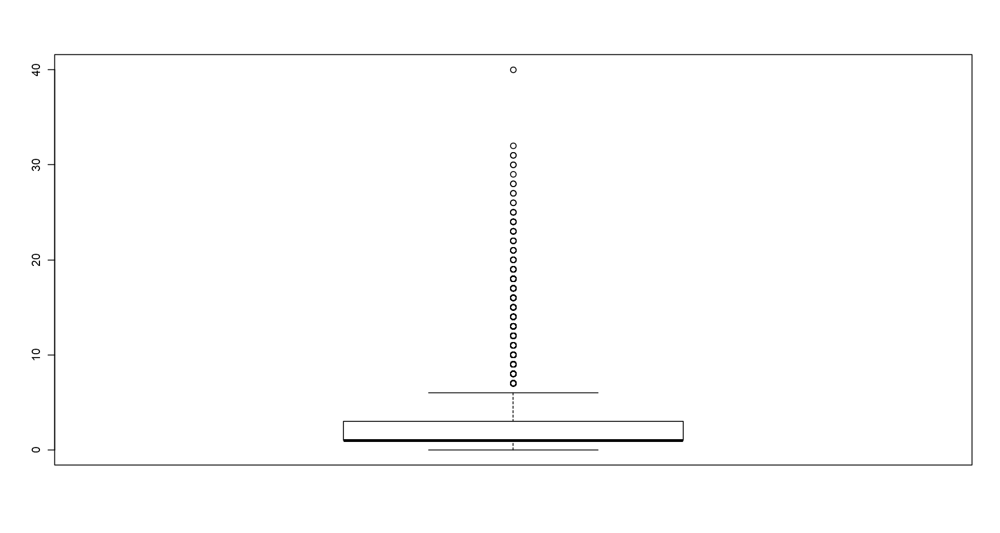

In [159]:
depart_Sound.out <- ifelse(df[["depart_Sound"]] >= 8 , 1, 0)
table(depart_Sound.out)
min(boxplot(df$depart_Sound)$out)
length(boxplot(df$depart_Sound)$out)

In [160]:
depart_Sound.noout <- df[["depart_Sound"]]
depart_Sound.noout  <- ifelse(depart_Sound.out ==1,NA,depart_Sound.noout )
head(depart_Sound.noout )

[1] NA  1 NA  0  0  0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4861 rows containing missing values (geom_point)."


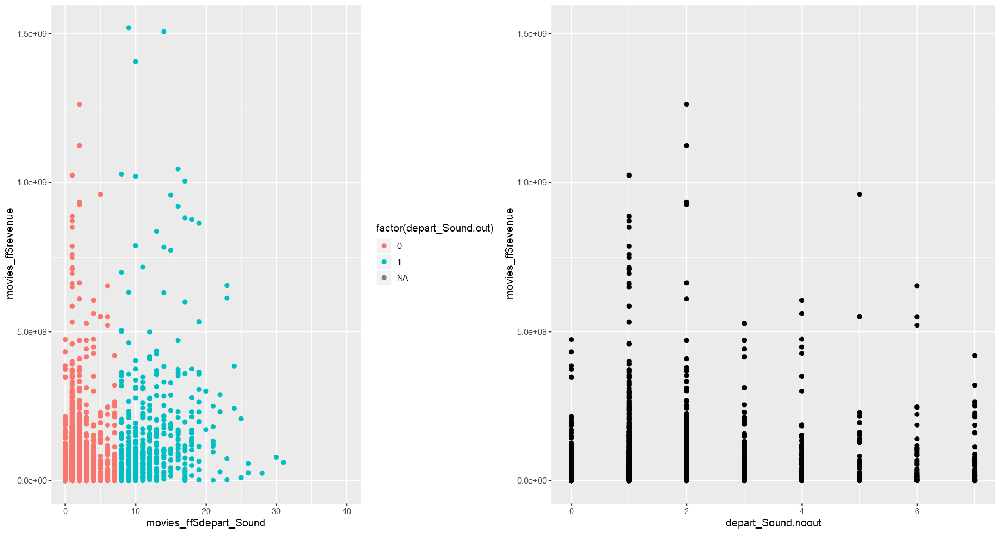

In [201]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Sound, y=df$revenue, color=factor(depart_Sound.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Sound.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Visual_Effects.out
   0    1 
5595 1746 

[1] 1

[1] 1746

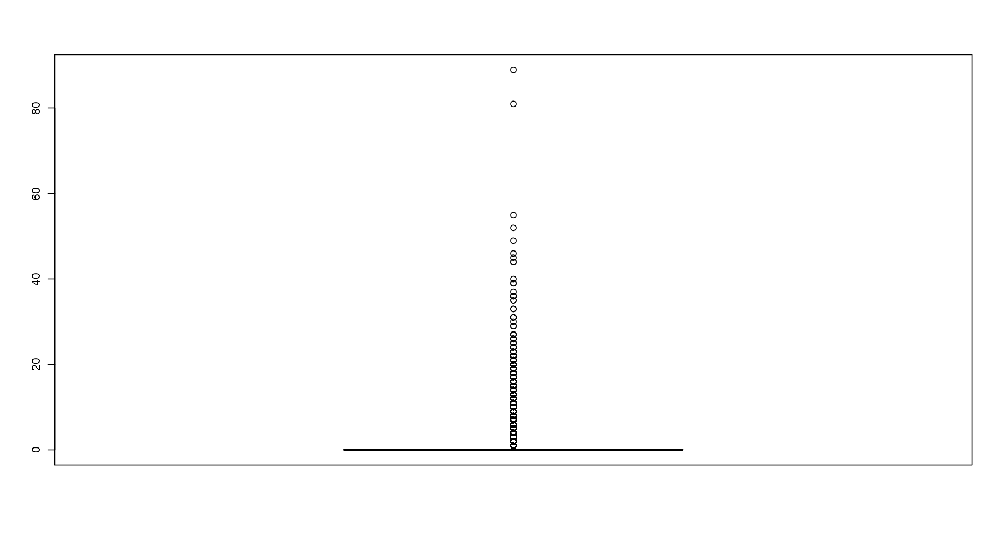

In [161]:
depart_Visual_Effects.out <- ifelse(df[["depart_Visual_Effects"]] >= 1 , 1, 0)
table(depart_Visual_Effects.out)
min(boxplot(df$depart_Visual_Effects)$out)
length(boxplot(df$depart_Visual_Effects)$out)

In [162]:
depart_Visual_Effects.noout <- df[["depart_Visual_Effects"]]
depart_Visual_Effects.noout  <- ifelse(depart_Visual_Effects.out ==1,NA,depart_Visual_Effects.noout )
head(depart_Visual_Effects.noout )

[1] NA  0 NA  0  0 NA

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 5095 rows containing missing values (geom_point)."


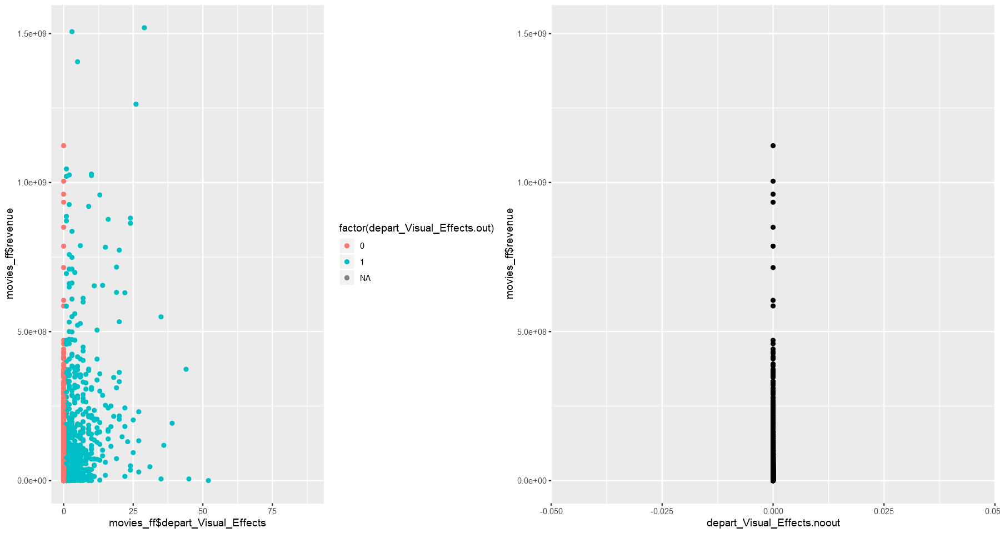

In [202]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Visual_Effects, y=df$revenue, color=factor(depart_Visual_Effects.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Visual_Effects.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Writing.out
   0    1 
7199  142 

[1] 7

[1] 142

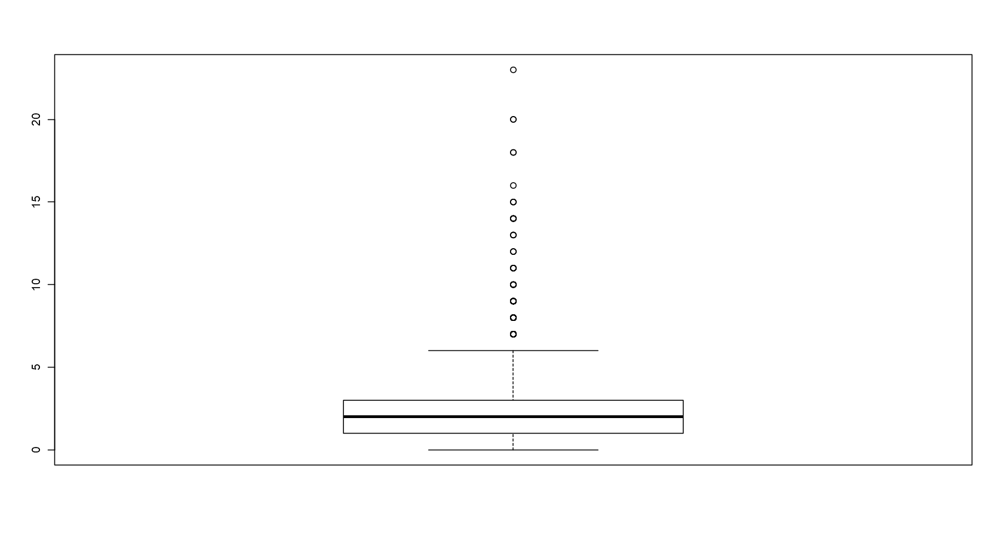

In [163]:
depart_Writing.out <- ifelse(df[["depart_Writing"]] >= 7 , 1, 0)
table(depart_Writing.out)
min(boxplot(df$depart_Writing)$out)
length(boxplot(df$depart_Writing)$out)

In [164]:
depart_Writing.noout <- df[["depart_Writing"]]
depart_Writing.noout  <- ifelse(depart_Writing.out ==1,NA,depart_Writing.noout )
head(depart_Writing.noout )

[1] 2 1 1 1 1 4

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4397 rows containing missing values (geom_point)."


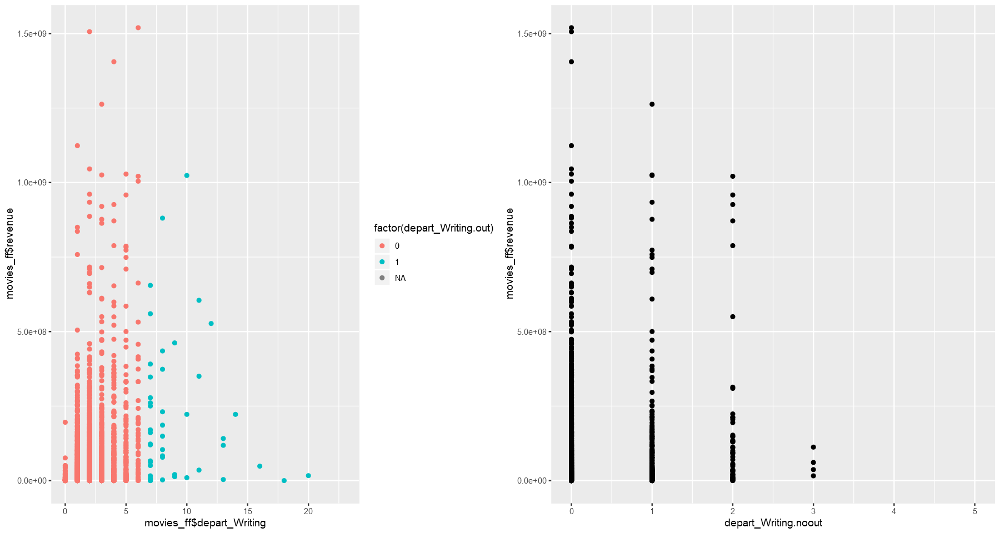

In [203]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Writing, y=df$revenue, color=factor(depart_Writing.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Writing.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Art_female.out
   0    1 
5988 1353 

[1] 1

[1] 1353

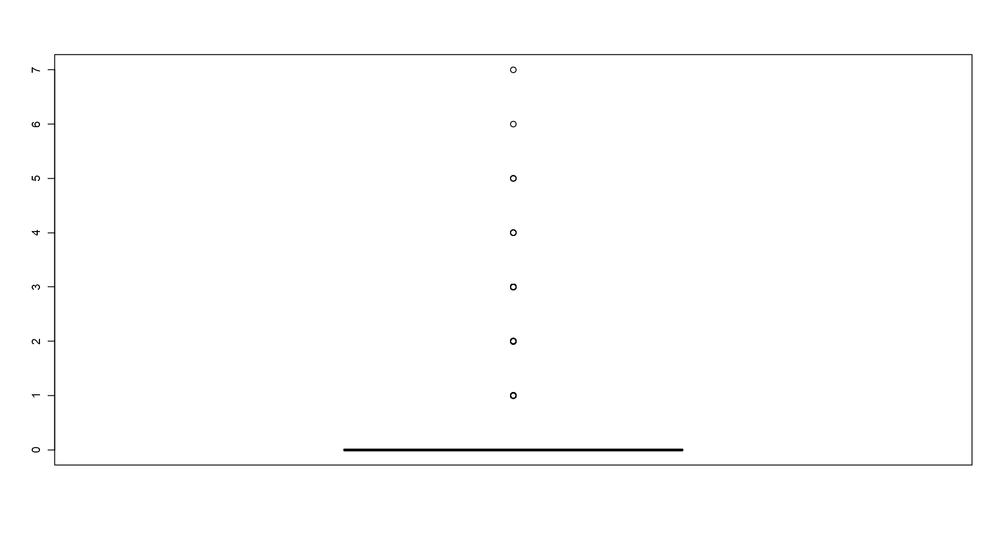

In [165]:
depart_Art_female.out <- ifelse(df[["depart_Art_female"]] >= 1 , 1, 0)
table(depart_Art_female.out)
min(boxplot(df$depart_Art_female)$out)
length(boxplot(df$depart_Art_female)$out)

In [166]:
depart_Art_female.noout <- df[["depart_Art_female"]]
depart_Art_female.noout  <- ifelse(depart_Art_female.out ==1,NA,depart_Art_female.noout )
head(depart_Art_female.noout )

[1]  0  0 NA  0  0  0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4957 rows containing missing values (geom_point)."


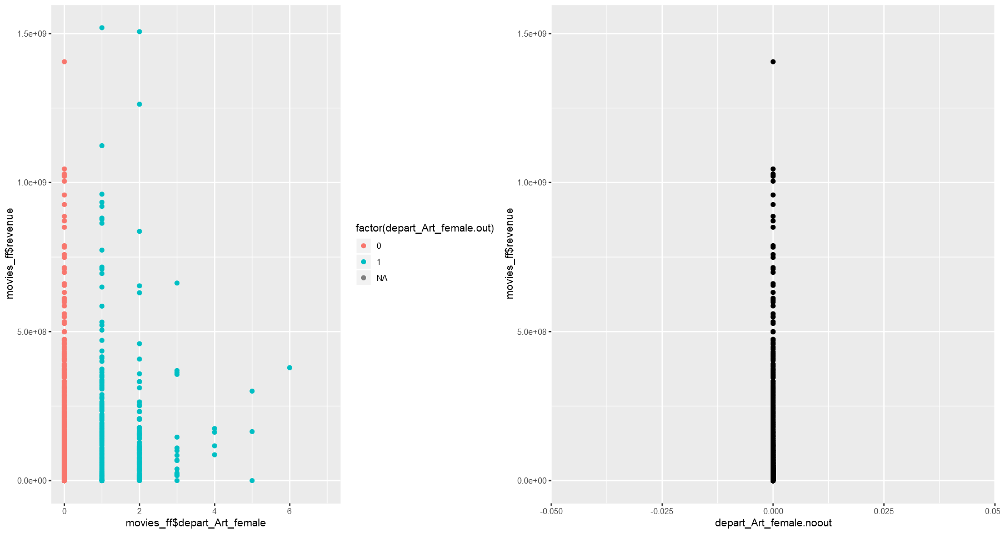

In [204]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Art_female, y=df$revenue, color=factor(depart_Art_female.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Art_female.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Camera_female.out
   0    1 
7194  147 

[1] 1

[1] 147

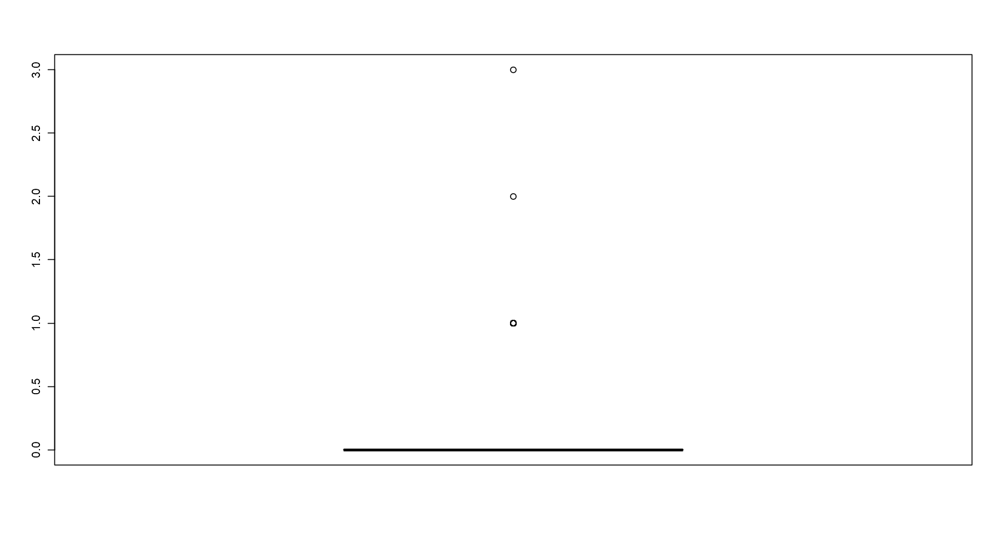

In [167]:
depart_Camera_female.out <- ifelse(df[["depart_Camera_female"]] >= 1 , 1, 0)
table(depart_Camera_female.out)
min(boxplot(df$depart_Camera_female)$out)
length(boxplot(df$depart_Camera_female)$out)

In [168]:
depart_Camera_female.noout <- df[["depart_Camera_female"]]
depart_Camera_female.noout  <- ifelse(depart_Camera_female.out ==1,NA,depart_Camera_female.noout )
head(depart_Camera_female.noout )

[1] 0 0 0 0 0 0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4460 rows containing missing values (geom_point)."


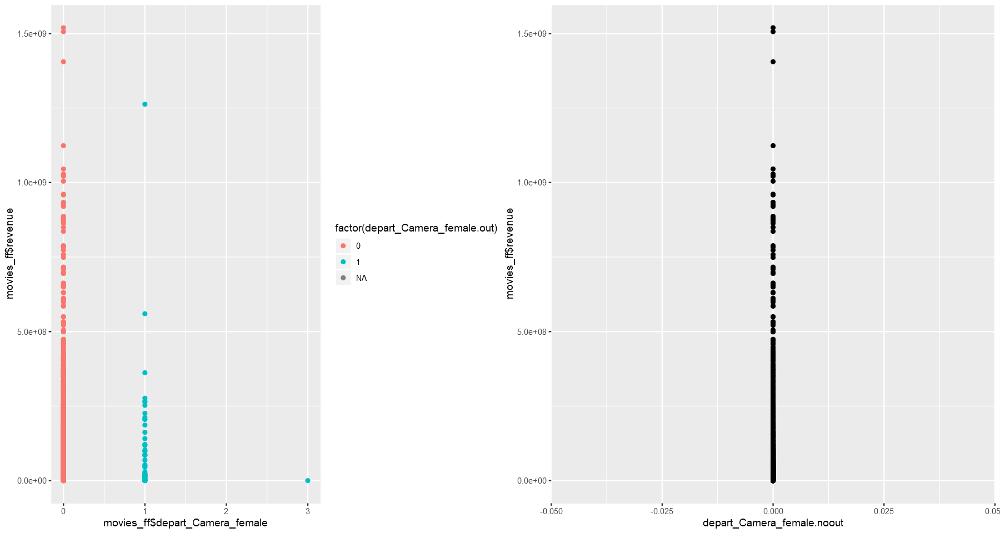

In [205]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Camera_female, y=df$revenue, color=factor(depart_Camera_female.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Camera_female.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Crew_female.out
   0    1 
6971  370 

[1] 1

[1] 370

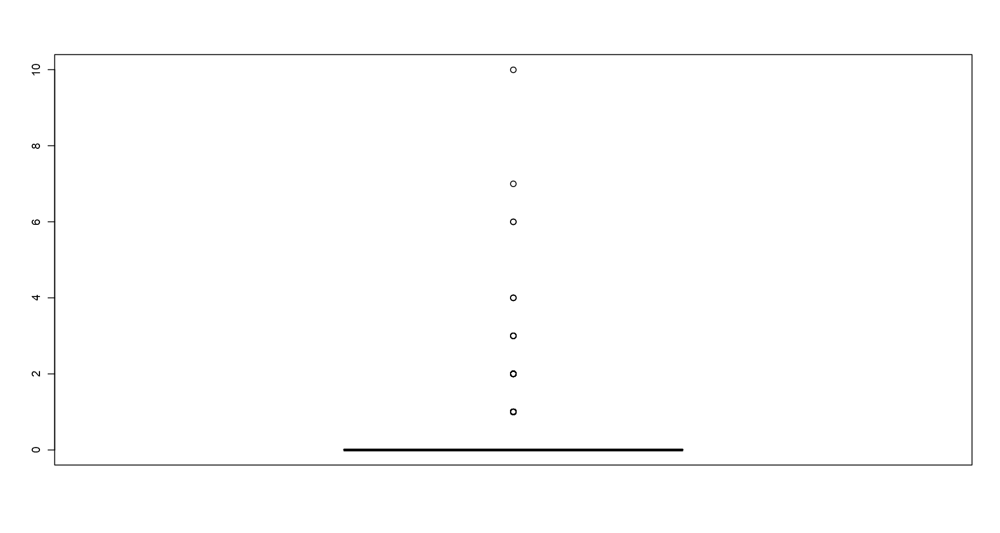

In [169]:
depart_Crew_female.out <- ifelse(df[["depart_Crew_female"]] >= 1 , 1, 0)
table(depart_Crew_female.out)
min(boxplot(df$depart_Crew_female)$out)
length(boxplot(df$depart_Crew_female)$out)

In [170]:
depart_Crew_female.noout <- df[["depart_Crew_female"]]
depart_Crew_female.noout  <- ifelse(depart_Crew_female.out ==1,NA,depart_Crew_female.noout )
head(depart_Crew_female.noout )

[1]  0  0 NA  0  0  0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4538 rows containing missing values (geom_point)."


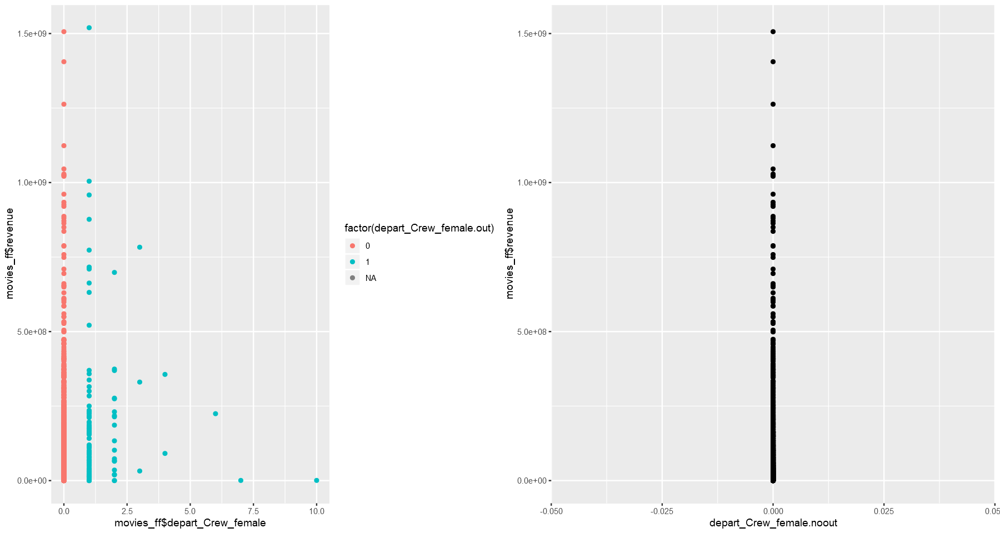

In [206]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Crew_female, y=df$revenue, color=factor(depart_Crew_female.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Crew_female.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Custom_Mkup_female.out
   0    1 
7245   96 

[1] 3

[1] 96

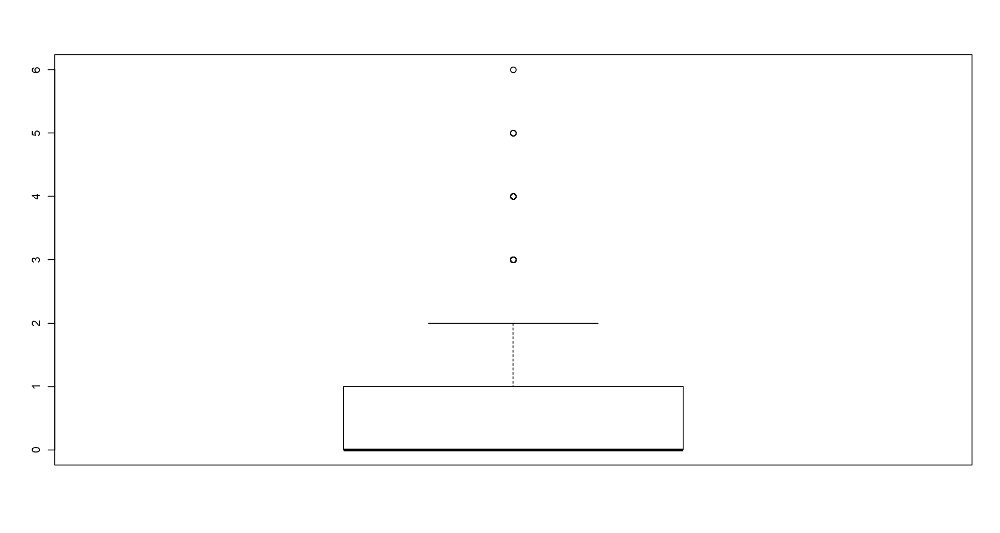

In [171]:
depart_Custom_Mkup_female.out <- ifelse(df[["depart_Custom_Mkup_female"]] >= 3 , 1, 0)
table(depart_Custom_Mkup_female.out)
min(boxplot(df$depart_Custom_Mkup_female)$out)
length(boxplot(df$depart_Custom_Mkup_female)$out)

In [172]:
depart_Custom_Mkup_female.noout <- df[["depart_Custom_Mkup_female"]]
depart_Custom_Mkup_female.noout  <- ifelse(depart_Custom_Mkup_female.out ==1,NA,depart_Custom_Mkup_female.noout )
head(depart_Custom_Mkup_female.noout )

[1] 0 0 0 0 0 0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4438 rows containing missing values (geom_point)."


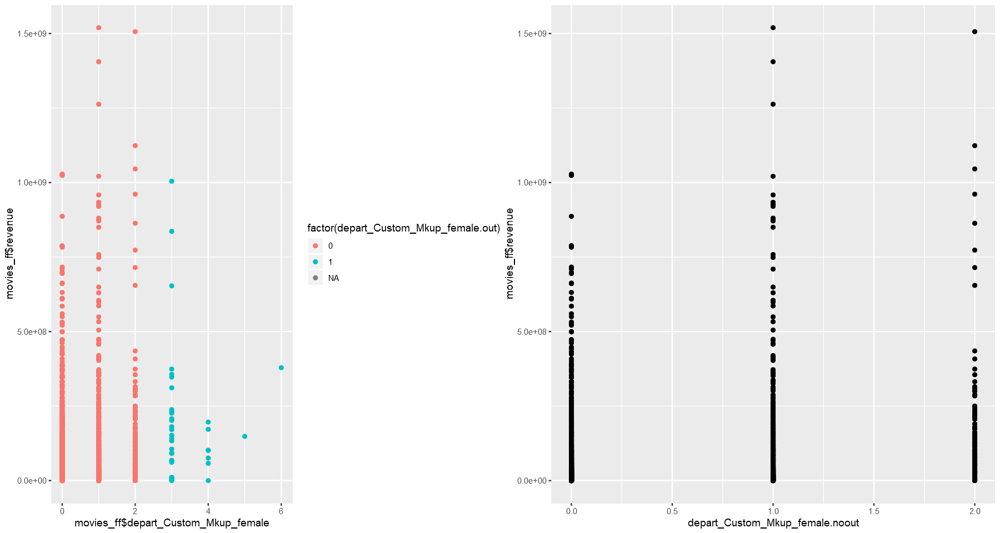

In [208]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Custom_Mkup_female, y=df$revenue, color=factor(depart_Custom_Mkup_female.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Custom_Mkup_female.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Directing_female.out
   0    1 
6297 1044 

[1] 1

[1] 1044

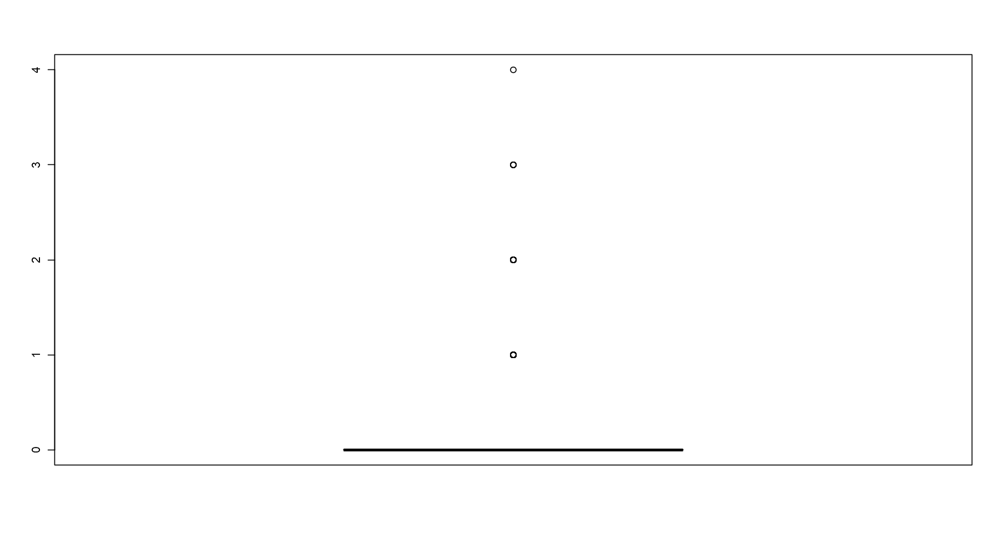

In [173]:
depart_Directing_female.out <- ifelse(df[["depart_Directing_female"]] >= 1 , 1, 0)
table(depart_Directing_female.out)
min(boxplot(df$depart_Directing_female)$out)
length(boxplot(df$depart_Directing_female)$out)

In [174]:
depart_Directing_female.noout <- df[["depart_Directing_female"]]
depart_Directing_female.noout  <- ifelse(depart_Directing_female.out ==1,NA,depart_Directing_female.noout )
head(depart_Directing_female.noout )

[1] 0 0 0 0 0 0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4825 rows containing missing values (geom_point)."


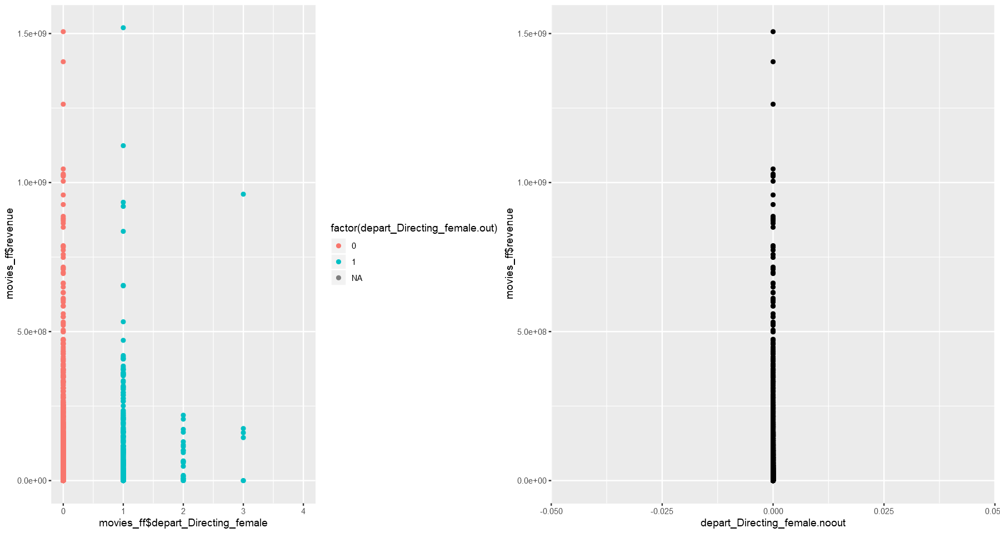

In [209]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Directing_female, y=df$revenue, color=factor(depart_Directing_female.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Directing_female.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Editing_female.out
   0    1 
6516  825 

[1] 1

[1] 825

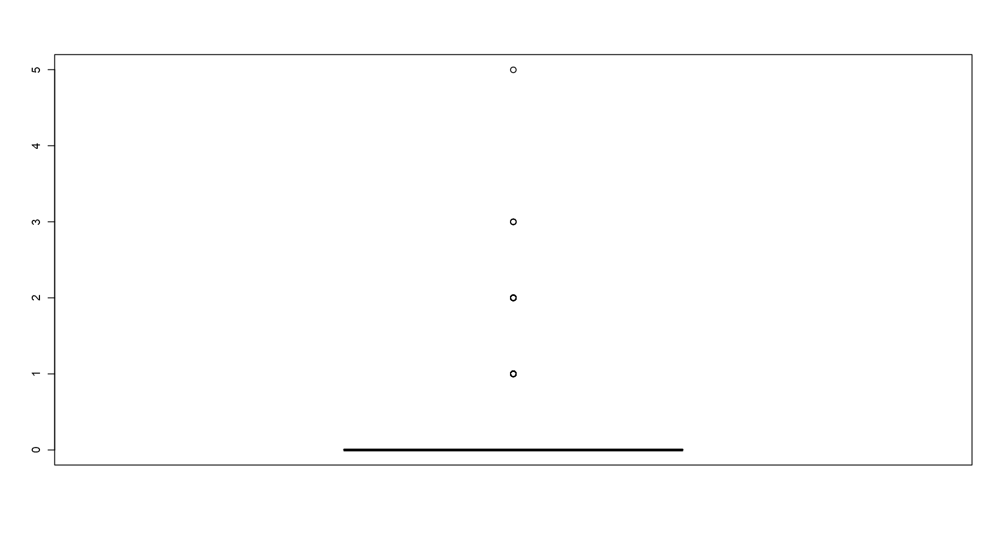

In [175]:
depart_Editing_female.out <- ifelse(df[["depart_Editing_female"]] >= 1 , 1, 0)
table(depart_Editing_female.out)
min(boxplot(df$depart_Editing_female)$out)
length(boxplot(df$depart_Editing_female)$out)

In [176]:
depart_Editing_female.noout <- df[["depart_Editing_female"]]
depart_Editing_female.noout  <- ifelse(depart_Editing_female.out ==1,NA,depart_Editing_female.noout )
head(depart_Editing_female.noout )

[1] 0 0 0 0 0 0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4748 rows containing missing values (geom_point)."


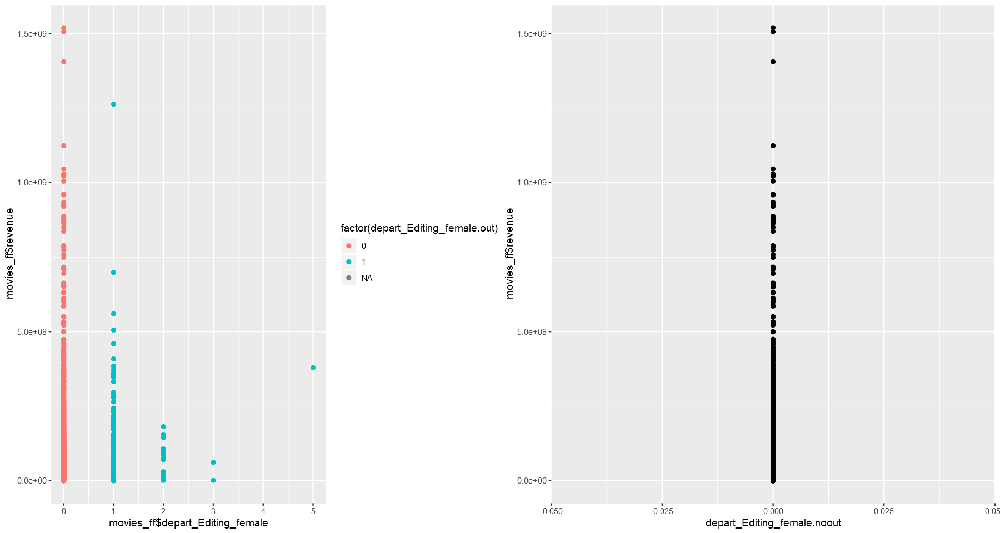

In [210]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Editing_female, y=df$revenue, color=factor(depart_Editing_female.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Editing_female.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Lighting_female.out
   0    1 
7336    5 

[1] 1

[1] 5

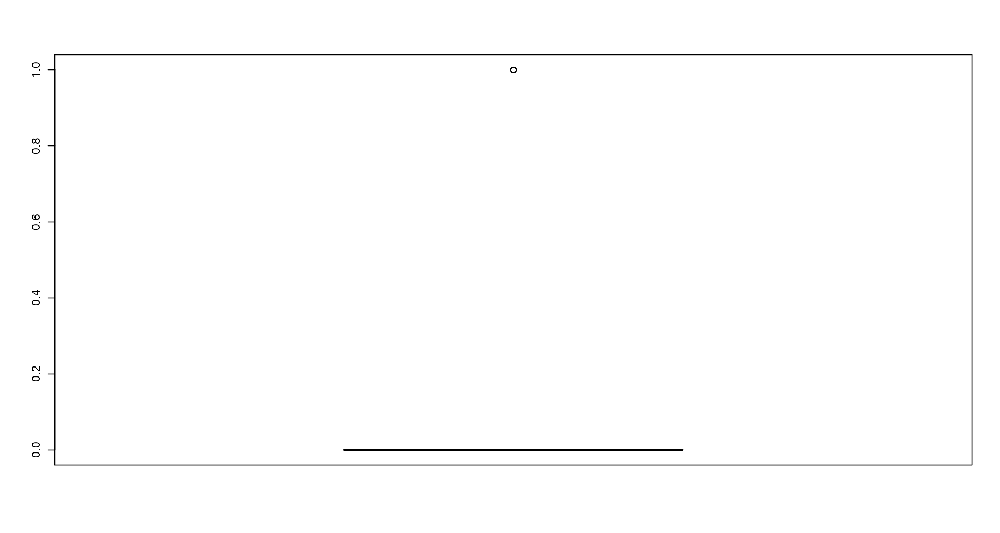

In [177]:
depart_Lighting_female.out <- ifelse(df[["depart_Lighting_female"]] >= 1 , 1, 0)
table(depart_Lighting_female.out)
min(boxplot(df$depart_Lighting_female)$out)
length(boxplot(df$depart_Lighting_female)$out)

In [178]:
depart_Lighting_female.noout <- df[["depart_Lighting_female"]]
depart_Lighting_female.noout  <- ifelse(depart_Lighting_female.out ==1,NA,depart_Lighting_female.noout )
head(depart_Lighting_female.noout )

[1] 0 0 0 0 0 0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4401 rows containing missing values (geom_point)."


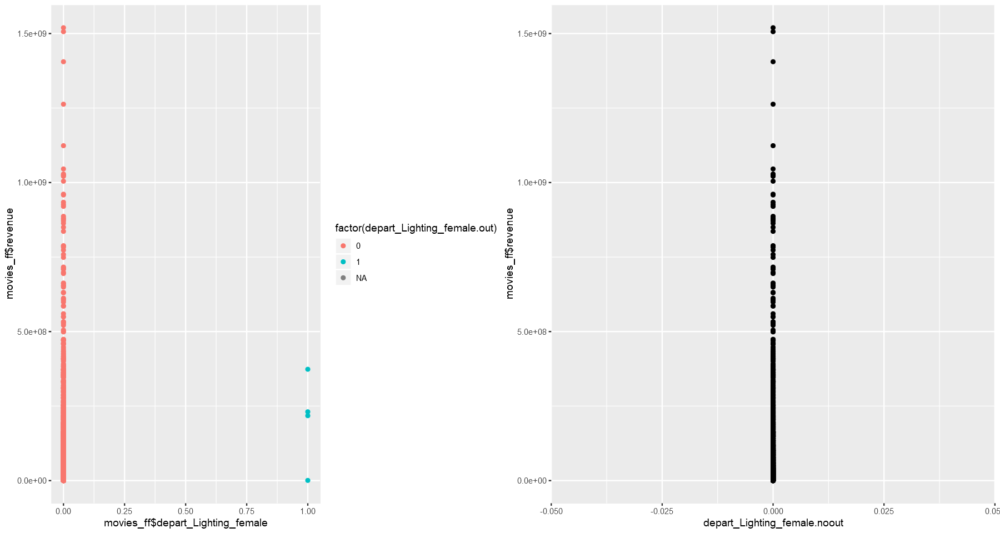

In [211]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Lighting_female, y=df$revenue, color=factor(depart_Lighting_female.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Lighting_female.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Production_female.out
   0    1 
7264   77 

[1] 6

[1] 77

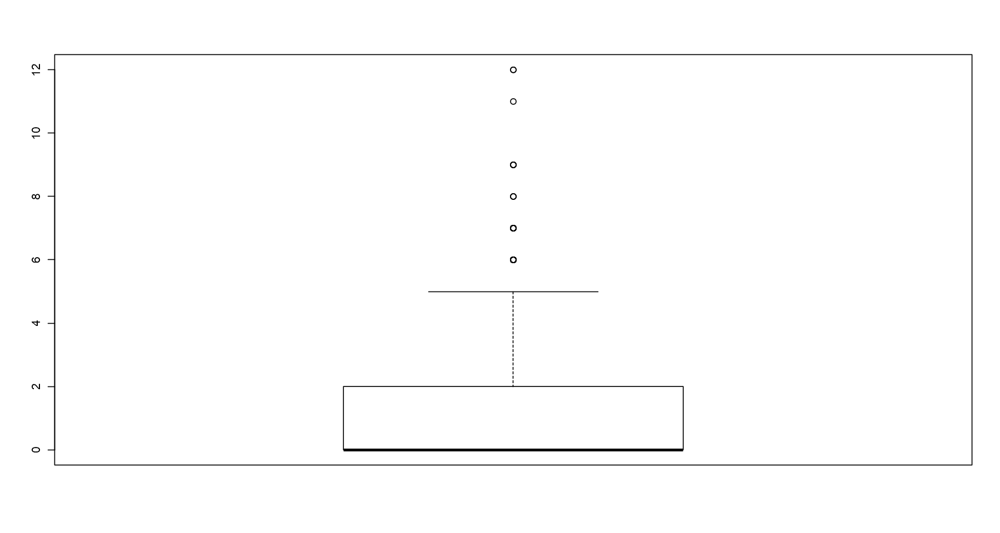

In [179]:
depart_Production_female.out <- ifelse(df[["depart_Production_female"]] >= 6 , 1, 0)
table(depart_Production_female.out)
min(boxplot(df$depart_Production_female)$out)
length(boxplot(df$depart_Production_female)$out)

In [180]:
depart_Production_female.noout <- df[["depart_Production_female"]]
depart_Production.noout  <- ifelse(depart_Production_female.out ==1,NA,depart_Production_female.noout )
head(depart_Production_female.noout )

[1] 0 3 2 0 0 0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4397 rows containing missing values (geom_point)."


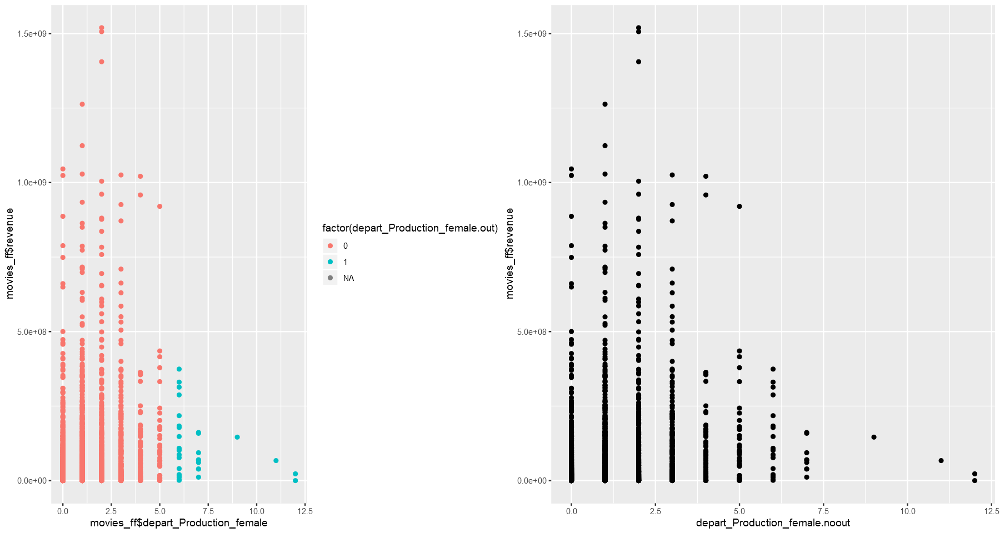

In [212]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Production_female, y=df$revenue, color=factor(depart_Production_female.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Production_female.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Sound_female.out
   0    1 
6840  501 

[1] 1

[1] 501

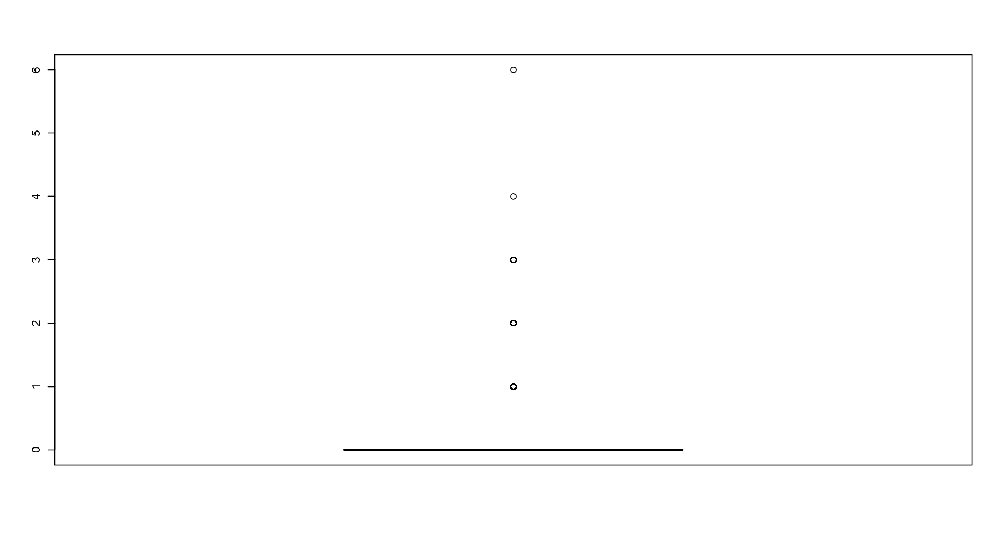

In [78]:
depart_Sound_female.out <- ifelse(df[["depart_Sound_female"]] >= 1 , 1, 0)
table(depart_Sound_female.out)
min(boxplot(df$depart_Sound_female)$out)
length(boxplot(df$depart_Sound_female)$out)

In [79]:
depart_Sound_female.noout <- df[["depart_Sound_female"]]
depart_Sound_female.noout  <- ifelse(depart_Sound_female.out ==1,NA,depart_Sound_female.noout )
head(depart_Sound_female.noout )

[1] 0 0 0 0 0 0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4613 rows containing missing values (geom_point)."


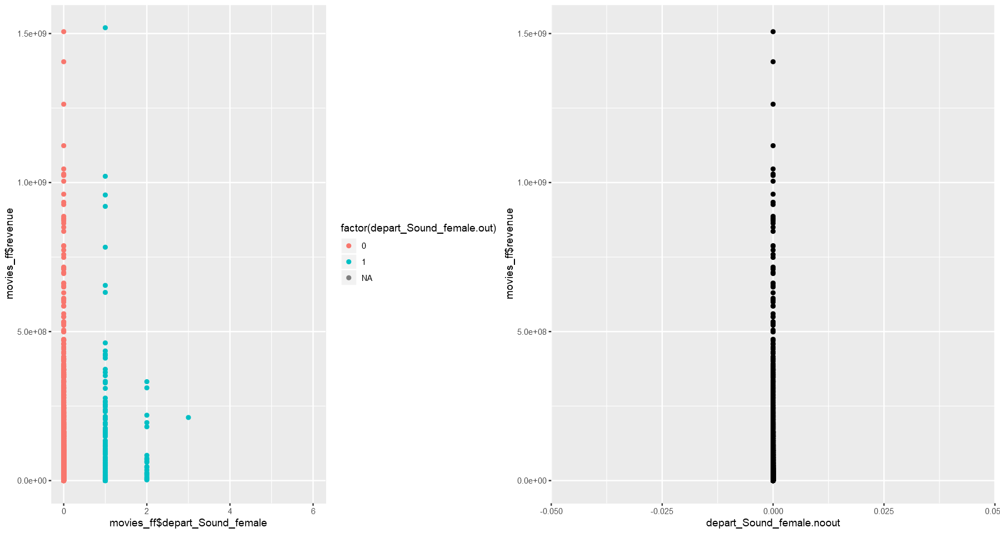

In [213]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Sound_female, y=df$revenue, color=factor(depart_Sound_female.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Sound_female.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Visual_Effects_female.out
   0    1 
7281   60 

[1] 1

[1] 60

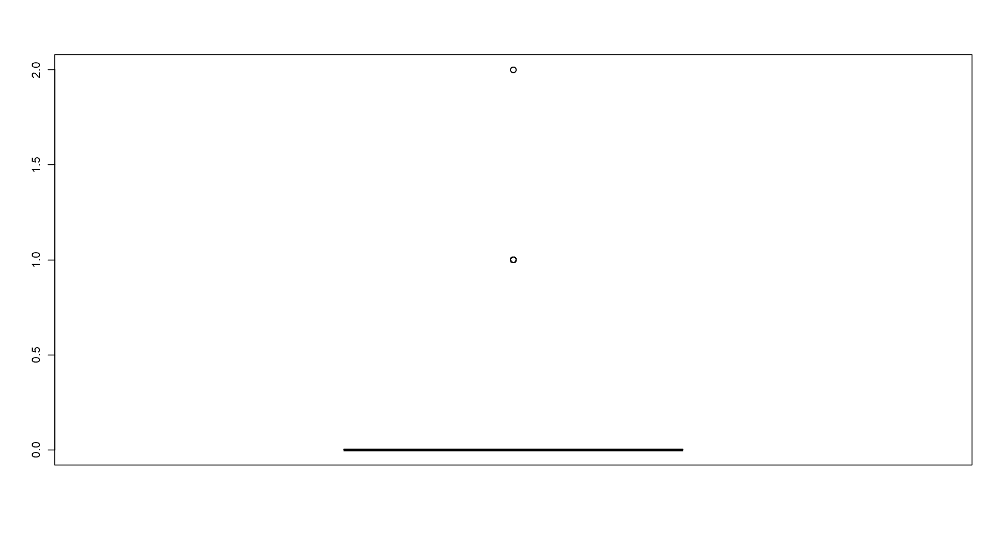

In [80]:
depart_Visual_Effects_female.out <- ifelse(df[["depart_Visual_Effects_female"]] >= 1 , 1, 0)
table(depart_Visual_Effects_female.out)
min(boxplot(df$depart_Visual_Effects_female)$out)
length(boxplot(df$depart_Visual_Effects_female)$out)

In [81]:
depart_Visual_Effects_female.noout <- df[["depart_Visual_Effects_female"]]
depart_Visual_Effects_female.noout  <- ifelse(depart_Visual_Effects_female.out ==1,NA,depart_Visual_Effects_female.noout )
head(depart_Visual_Effects_female.noout )

[1] 0 0 0 0 0 0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4419 rows containing missing values (geom_point)."


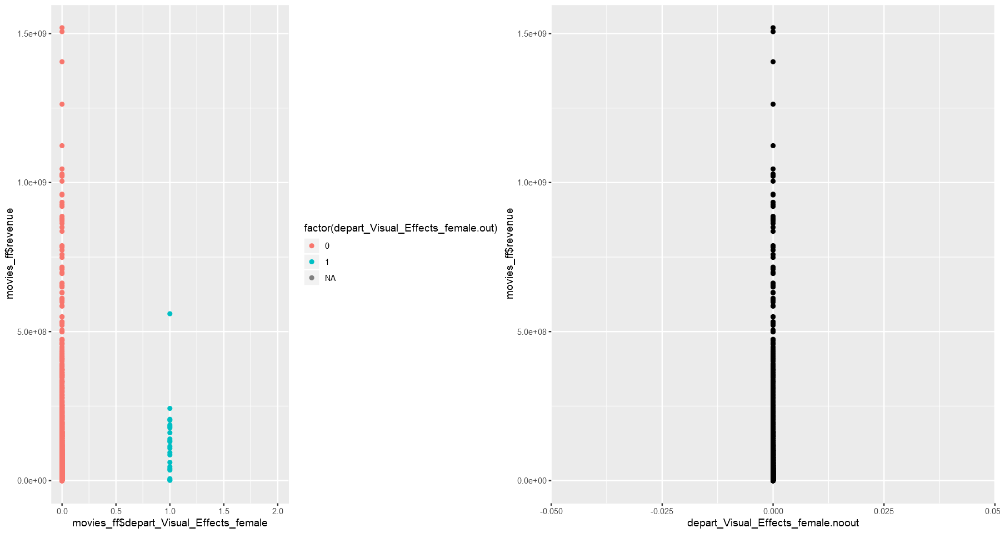

In [214]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Visual_Effects_female, y=df$revenue, color=factor(depart_Visual_Effects_female.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Visual_Effects_female.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

depart_Writing_female.out
   0    1 
6578  763 

[1] 1

[1] 763

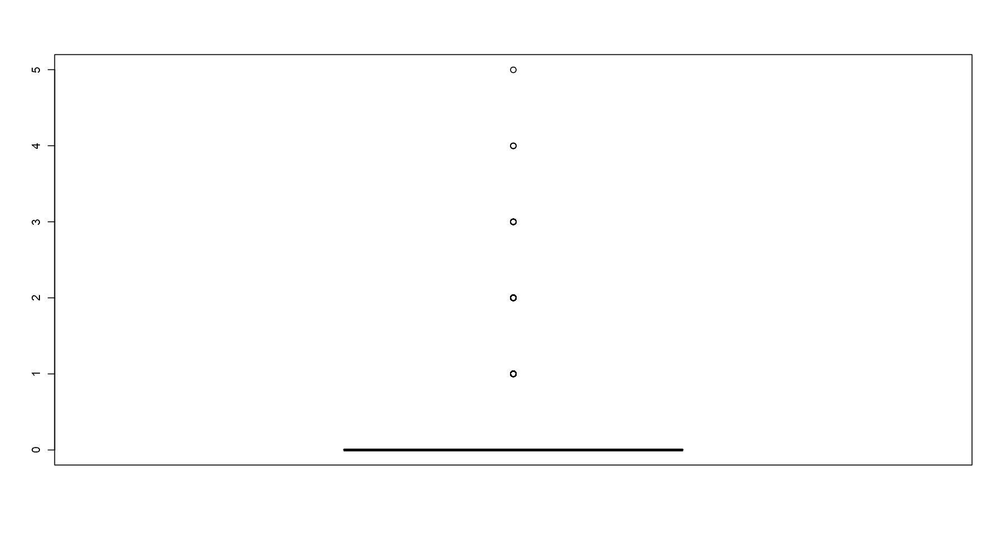

In [82]:
depart_Writing_female.out <- ifelse(df[["depart_Writing_female"]] >= 1 , 1, 0)
table(depart_Writing_female.out)
min(boxplot(df$depart_Writing_female)$out)
length(boxplot(df$depart_Writing_female)$out)

In [83]:
depart_Writing_female.noout <- df[["depart_Writing_female"]]
depart_Writing_female.noout  <- ifelse(depart_Writing_female.out ==1,NA,depart_Writing_female.noout )
head(depart_Writing_female.noout )

[1]  0 NA  0  0  0  0

Warning message:
"Removed 4397 rows containing missing values (geom_point)."
Warning message:
"Removed 4716 rows containing missing values (geom_point)."


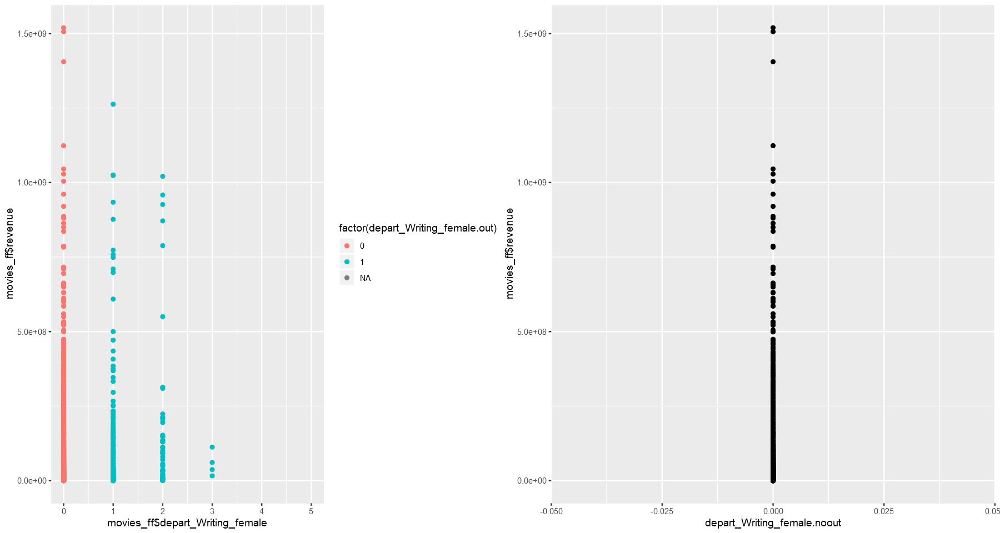

In [215]:
p1 <- ggplot() + geom_point(aes(x=df$depart_Writing_female, y=df$revenue, color=factor(depart_Writing_female.out)))
p2 <- ggplot() + geom_point(aes(x=depart_Writing_female.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

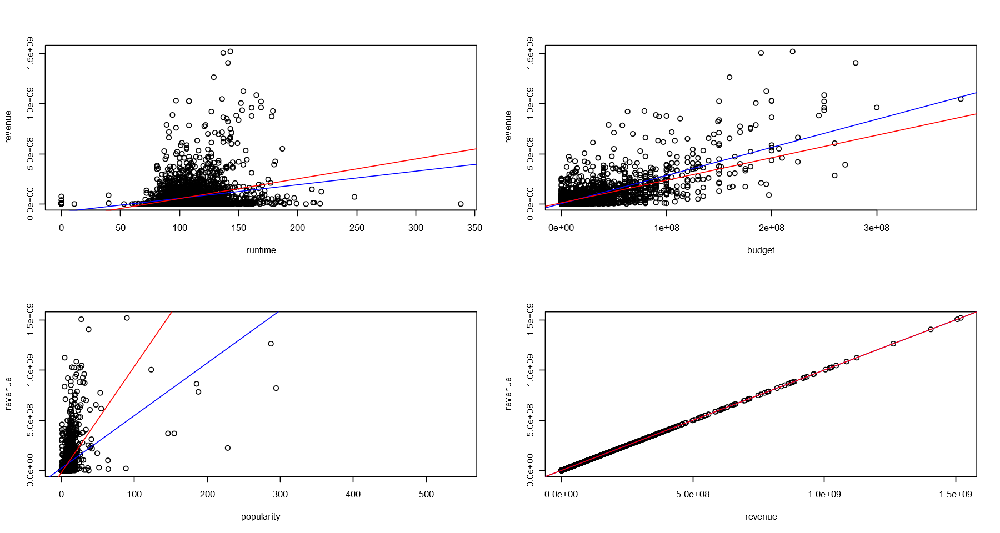

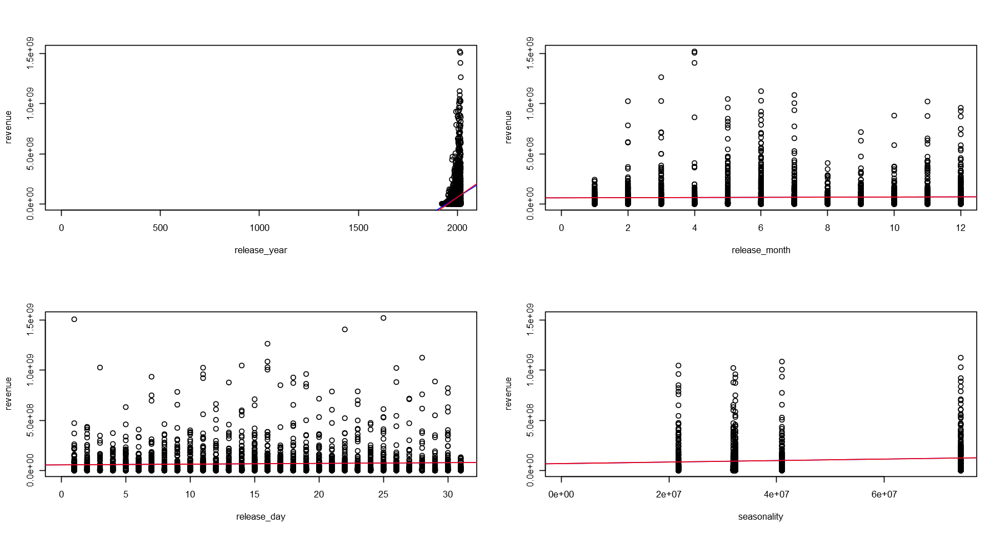

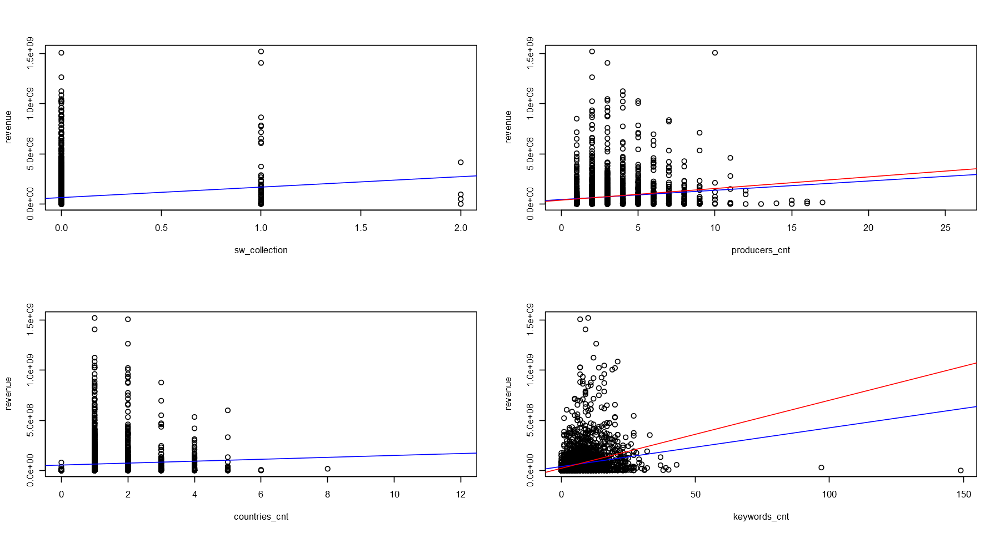

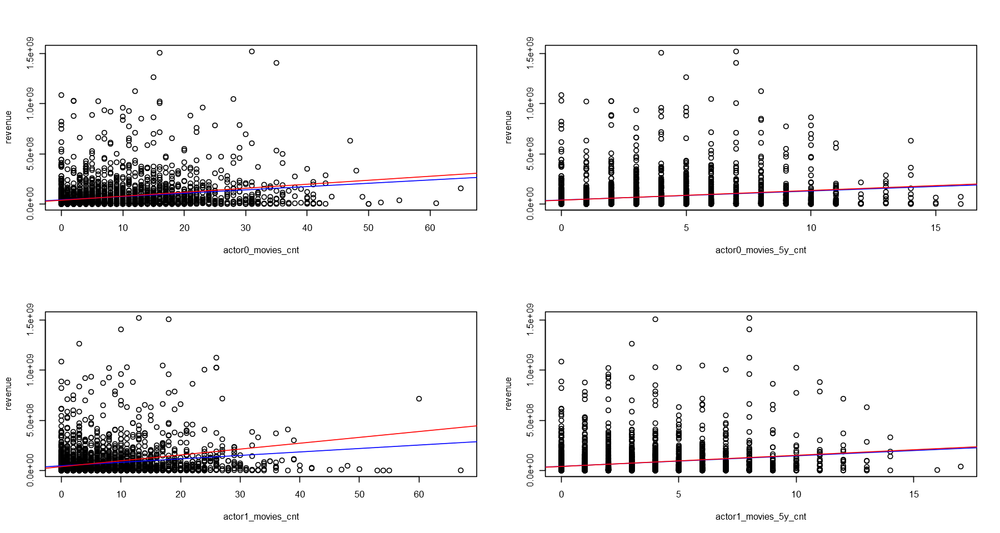

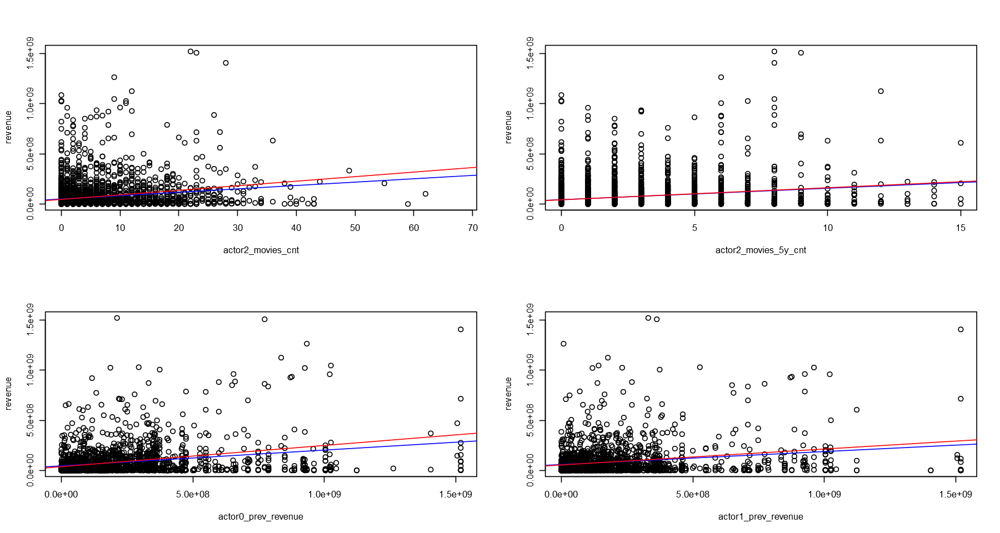

...

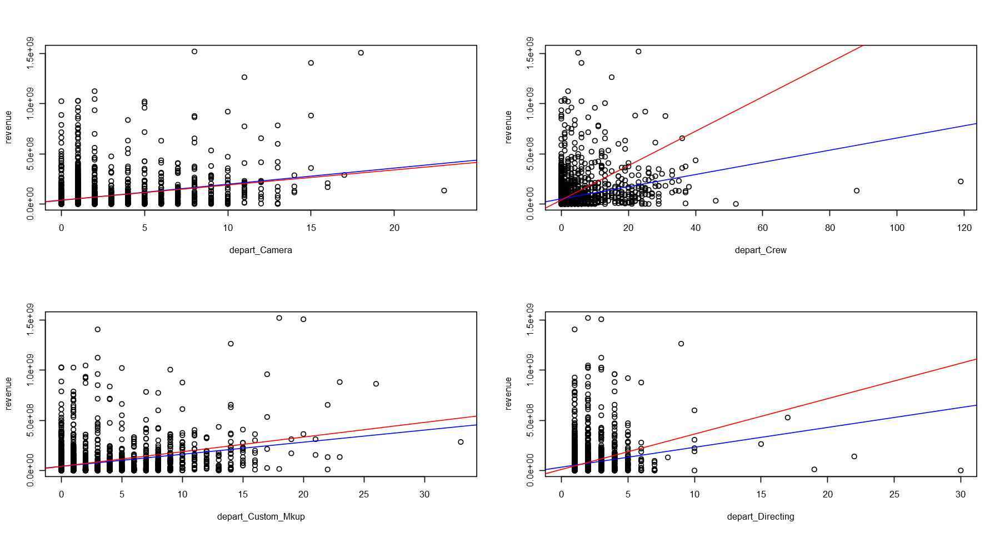

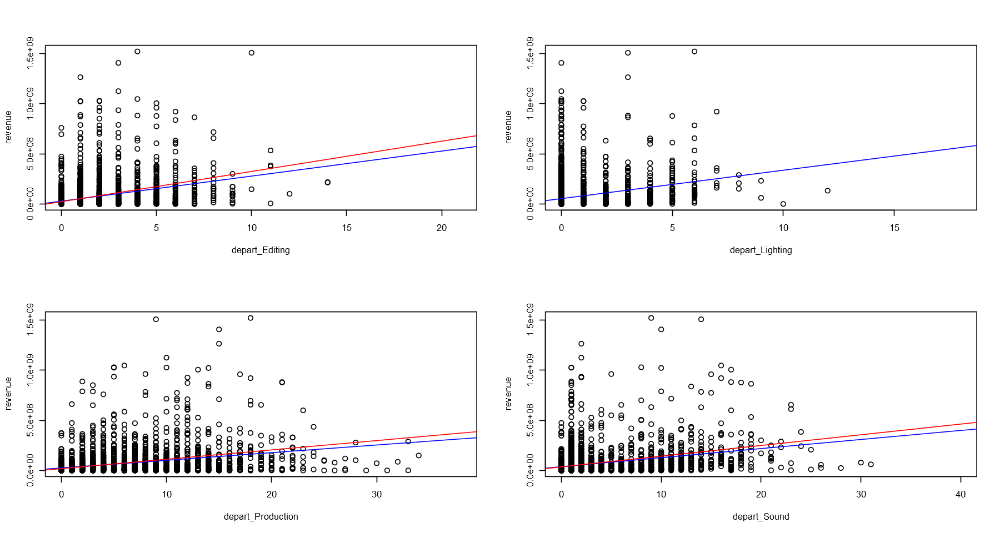

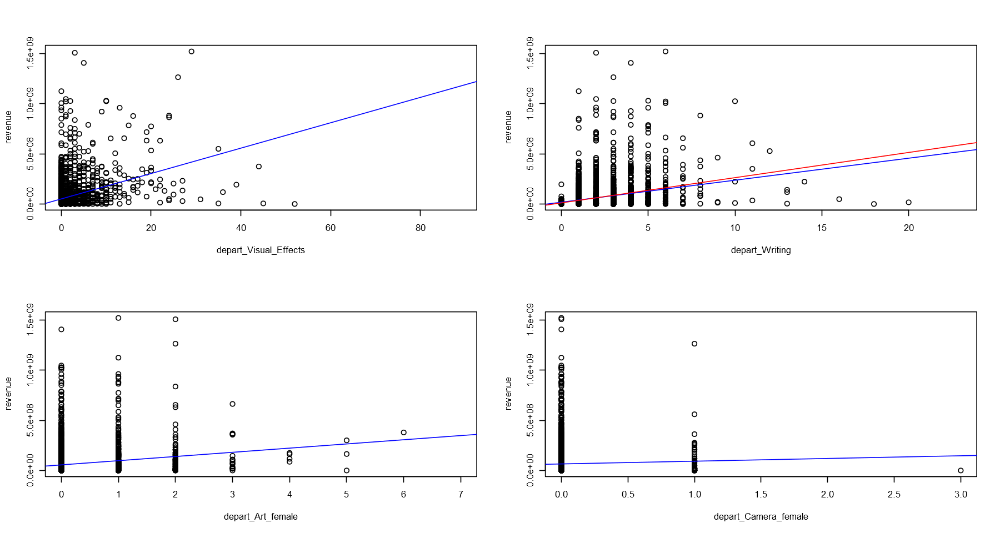

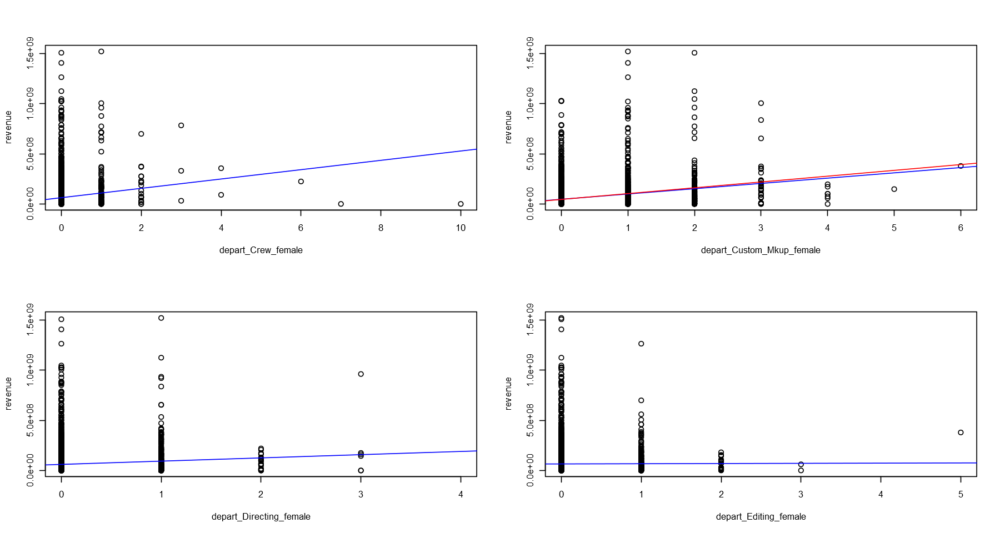

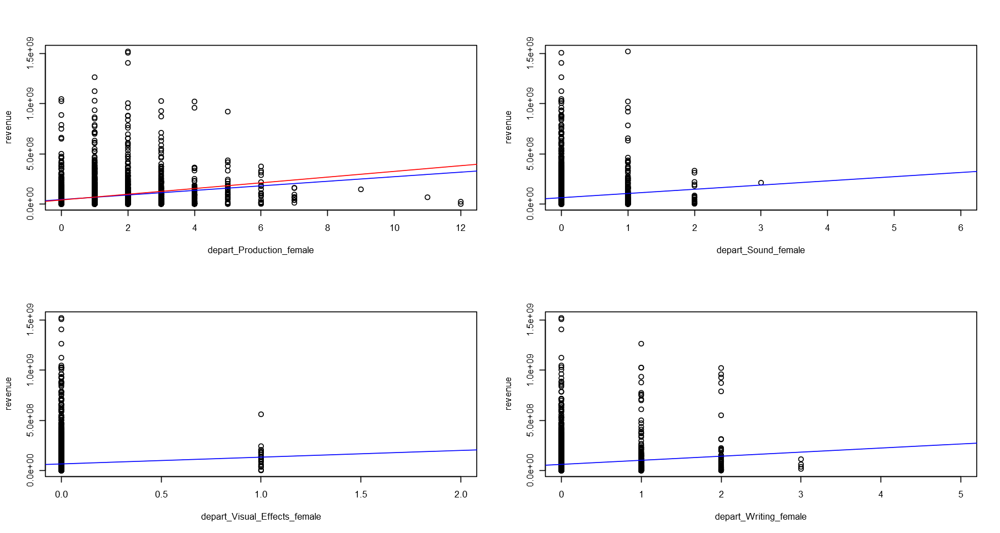

In [84]:
par(mfrow=c(2,2))
for (v in movies_continuous){
            a <- max(df[[v]],na.rm=TRUE)
            b1 <- df %>% select(revenue,v)   
            b2 <- df %>% select(revenue,v) %>% filter(movies_outliers[[paste0(v,'_out')]]==0) 
            plot (b1[[v]],b1$revenue,xlab=v,ylab='revenue',xlim=c(0,a))
            abline(coef(lm(b1$revenue~b1[[v]])), col='blue')
            if (length(unique(b2[[v]]))!=1){
            abline(coef(lm(b2$revenue~b2[[v]])), col = "red")}
    }

### 3.1.3 Table with variables having outliers.

לפי הגרפים למעלה ניתן לראות כי מחיקה של של ערכי קיצון תשנה את ההתפלגות של של הנתונים בחלק מהערכים , לכן במקרה כזה נעשה טרנספורמציה לנתונים, נבדוק את  הנתונים מחדש לאחר טרנספורמציה ונעדכן את הדאטה בהתאם 
במקרים בהם ההתפלגות והתוצאה לא משתנות ניתן למחוק את ערכי הקיצון ע"י שימוש בוקטור של החסרים 

| Variable                     | Treatment | Why                                                      |
|------------------------------|-----------|----------------------------------------------------------|
| runtime                      | Drop      | It dosen't change the assumption nor the results         |
| budget                       | Drop      | It changes the assumption but dosen't change the results |
| popularity                   | Leave     | It changes both the assumption the results               |
| realse_year                  | Drop      | It changes the assumption but dosen't change the results |
| sw_collection                | Drop      | It changes the assumption but dosen't change the results |
| producers_cnt                | Drop      | It dosen't change the assumption nor the results         |
| countries_cnt                | Drop      | It dosen't change the assumption nor the results         |
| keywords_cnt                 | Leave     | It changes both the assumption the results               |
| actor0_movies_cnt            | Drop      | It dosen't change the assumption nor the results         |
| actor0_movies_5y_cnt         | Drop      | It dosen't change the assumption nor the results         |
| actor1_movies_cnt            | Drop      | It dosen't change the assumption nor the results         |
| actor1_movies_5y_cnt         | Drop      | It dosen't change the assumption nor the results         |
| actor2_movies_cnt            | Drop      | It dosen't change the assumption nor the results         |
| actor2_movies_5y_cnt         | Drop      | It dosen't change the assumption nor the results         |
| actor0_prev_revenue          | Drop      | It dosen't change the assumption nor the results         |
| actor1_prev_revenue          | Drop      | It dosen't change the assumption nor the results         |
| actor2_prev_revenue          | Drop      | It dosen't change the assumption nor the results         |
| director_movies_cnt          | Drop      | It dosen't change the assumption nor the results         |
| depart_Art                   | Drop      | It changes the assumption but dosen't change the results |
| depart_Camera                | Drop      | It changes the assumption but dosen't change the results |
| depart_Crew                  | Leave     | It changes both the assumption the results               |
| depart_Custom_Mkup           | Drop      | It changes the assumption but dosen't change the results |
| depart_Directing             | Leave     | It changes both the assumption the results               |
| depart_Editing               | Drop      | It changes the assumption but dosen't change the results |
| depart_Lighting              | Drop      | It changes the assumption but dosen't change the results |
| depart_Production            | Drop      | It changes the assumption but dosen't change the results |
| depart_Sound                 | Drop      | It changes the assumption but dosen't change the results |
| depart_Visual_Effects        | Drop      | It changes the assumption but dosen't change the results |
| depart_Writing               | Drop      | It changes the assumption but dosen't change the results |
| depart_Art_female            | Drop      | It changes the assumption but dosen't change the results |
| depart_Camera_female         | Drop      | It changes the assumption but dosen't change the results |
| depart_Crew_female           | Drop      | It changes the assumption but dosen't change the results |
| depart_Custom_Mkup_female    | Drop      | It changes the assumption but dosen't change the results |
| depart_Directing_female      | Drop      | It changes the assumption but dosen't change the results |
| depart_Editing_female        | Drop      | It changes the assumption but dosen't change the results |
| depart_Lighting_female       | Drop      | It changes the assumption but dosen't change the results |
| depart_Production_female     | Drop      | It changes the assumption but dosen't change the results |
| depart_Sound_female          | Drop      | It changes the assumption but dosen't change the results |
| depart_Visual_Effects_female | Drop      | It changes the assumption but dosen't change the results |
| depart_Writing_female        | Drop      | It changes the assumption but dosen't change the results |

### 3.1.4 Cleansed dataset for Outliers

In [237]:
## save the original table into another table and put the dataset after the outlier treatment into df
df.orig <- df

### Transforming Popularity

In [229]:
mod1 <- lm(df$revenue ~ df$popularity)
mod2 <- lm(df$revenue ~ popularity.noout)

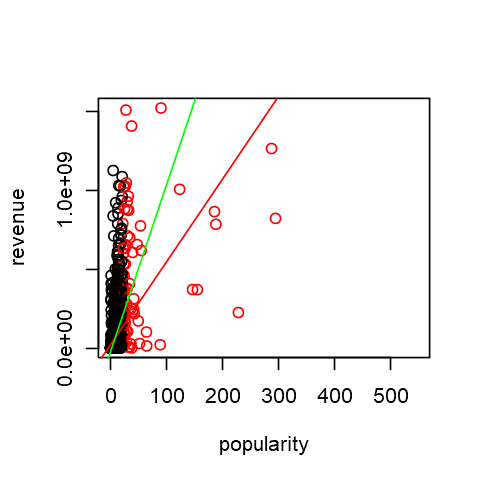

In [230]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(df$popularity, df$revenue, col=factor(popularity.out),xlab="popularity",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

#### log popularity

In [231]:
mod1 <- lm(df$revenue ~ df$popularity)
mod2 <- lm(df$revenue ~ log (df$popularity))

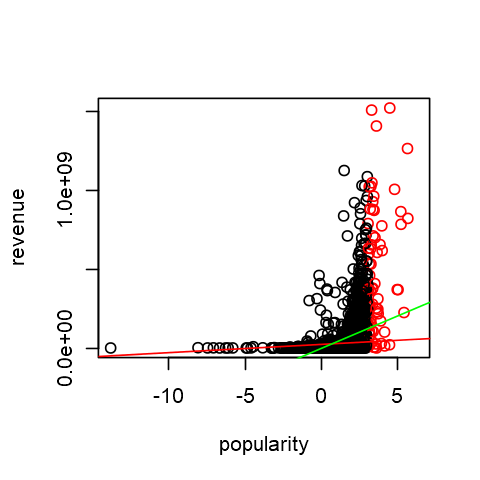

In [232]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(log(df$popularity), df$revenue, col=factor(popularity.out),xlab="popularity",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

#### sqrt popularity

In [233]:
mod1 <- lm(df$revenue ~ df$popularity)
mod2 <- lm(df$revenue ~ sqrt (df$popularity))

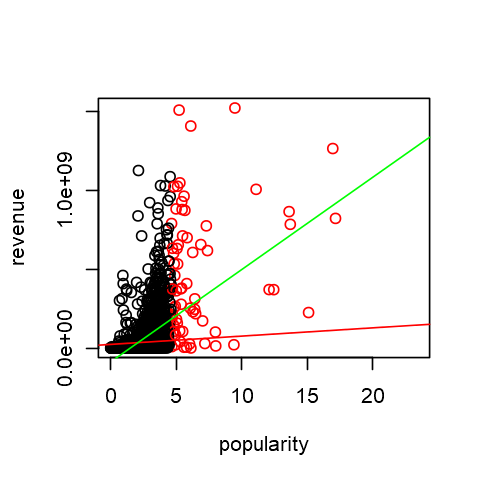

In [234]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(sqrt(df$popularity), df$revenue, col=factor(popularity.out),xlab="popularity",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

#### sqrt (log (popularity))

In [235]:
mod1 <- lm(df$revenue ~ df$popularity)
mod2 <- lm(df$revenue ~ sqrt(log (df$popularity)))

Warning message in sqrt(log(df$popularity)):
"NaNs produced"


Warning message in sqrt(log(df$popularity)):
"NaNs produced"


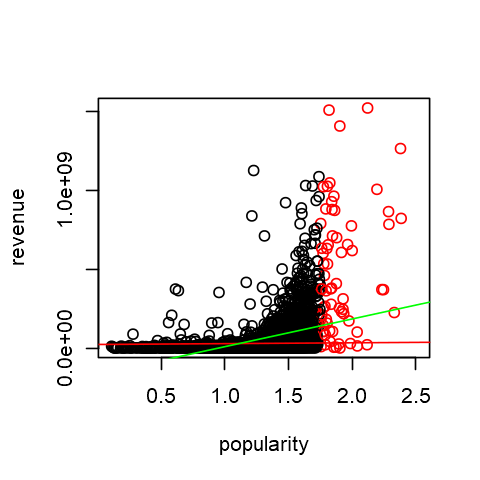

In [236]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(sqrt(log(df$popularity)), df$revenue, col=factor(popularity.out),xlab="popularity",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

#### log (sqrt(popularity))

In [225]:
mod1 <- lm(df$revenue ~ df$popularity)
mod2 <- lm(df$revenue ~ log(sqrt(df$popularity)))

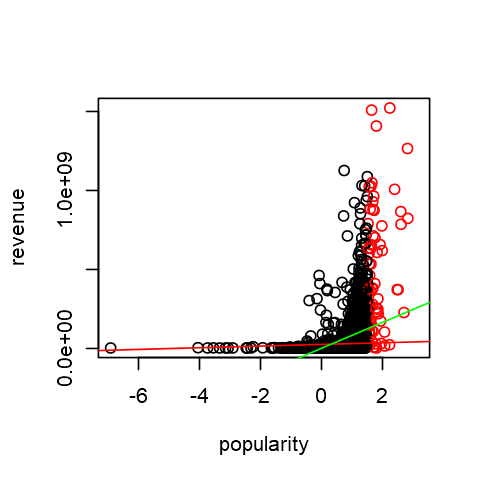

In [226]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(log(sqrt(df$popularity)), df$revenue, col=factor(popularity.out),xlab="popularity",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

### Transforming keywords_cnt

In [223]:
mod1 <- lm(df$revenue ~ df$keywords_cnt)
mod2 <- lm(df$revenue ~ keywords_cnt.noout)

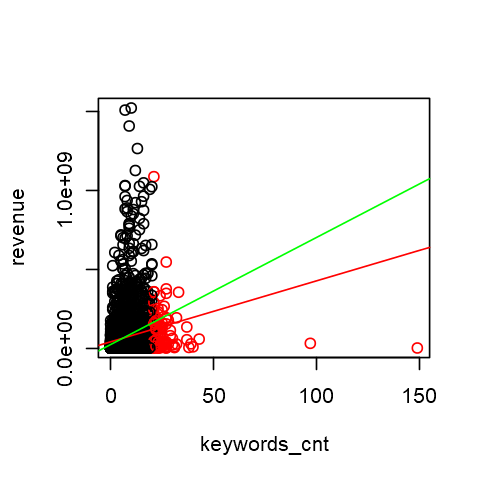

In [224]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(df$keywords_cnt, df$revenue, col=factor(keywords_cnt.out),xlab="keywords_cnt",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

#### sqrt keywords_cnt

In [238]:
mod1 <- lm(df$revenue ~ df$keywords_cnt)
mod2 <- lm(df$revenue ~ sqrt (df$keywords_cnt))

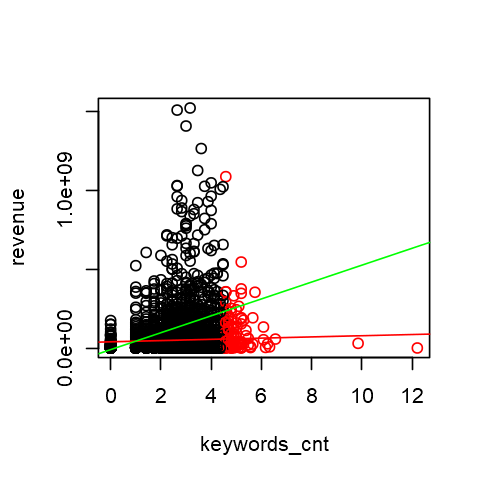

In [243]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(sqrt(df$keywords_cnt), df$revenue, col=factor(keywords_cnt.out),xlab="keywords_cnt",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

#### sqrt (log(keywords_cnt)

In [245]:
mod1 <- lm(df$revenue ~ df$keywords_cnt)
mod2 <- lm(df$revenue ~ sqrt(log (df$keywords_cnt)))

Warning message in sqrt(log(movies_ff$keywords_cnt)):
"NaNs produced"


Warning message in sqrt(log(movies_ff$keywords_cnt)):
"NaNs produced"


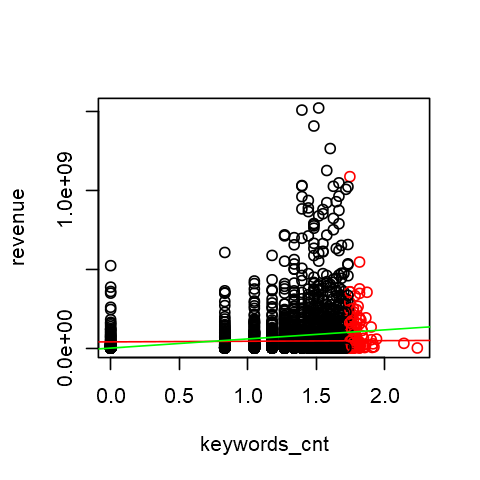

In [246]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(sqrt(log (df$keywords_cnt)), df$revenue, col=factor(keywords_cnt.out),xlab="keywords_cnt",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

#### log (sqrt(keywords_cnt)

In [245]:
mod1 <- lm(df$revenue ~ df$keywords_cnt)
mod2 <- lm(df$revenue ~ log(sqrt (df$keywords_cnt)))

Warning message in sqrt(log(movies_ff$keywords_cnt)):
"NaNs produced"


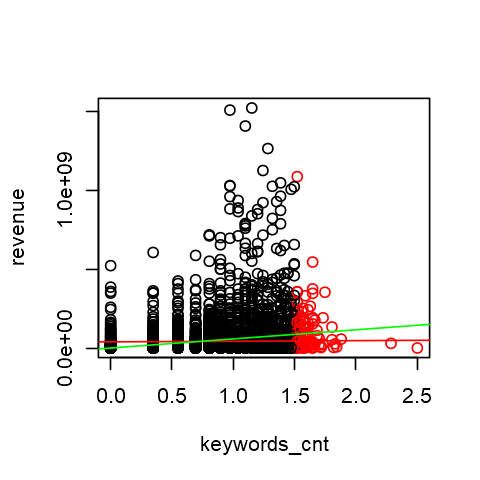

In [247]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(log(sqrt (df$keywords_cnt)), df$revenue, col=factor(keywords_cnt.out),xlab="keywords_cnt",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

### Transforming depart_Crew

In [234]:
mod1 <- lm(df$revenue ~ df$depart_Crew)
mod2 <- lm(df$revenue ~ depart_Crew.noout)

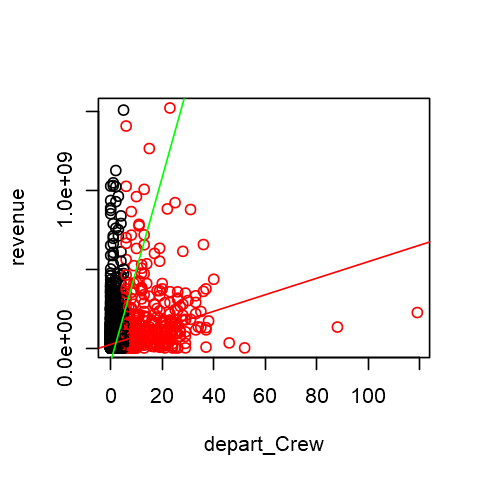

In [233]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(df$depart_Crew, df$revenue, col=factor(depart_Crew.out),xlab="depart_Crew",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

#### log depart_Crew

In [225]:
mod1 <- lm(df$revenue ~ df$depart_Crew)
mod2 <- lm(df$revenue ~ log (df$depart_Crew))

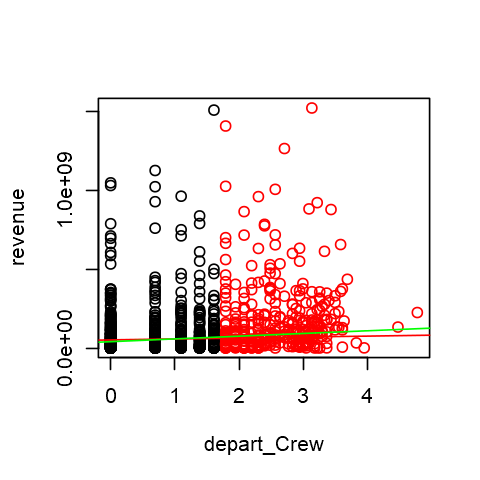

In [235]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(log(df$depart_Crew), df$revenue, col=factor(depart_Crew.out),xlab="depart_Crew",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

### Transforming depart_Directing

In [250]:
mod1 <- lm(df$revenue ~ df$depart_Directing)
mod2 <- lm(df$revenue ~ depart_Directing.noout)

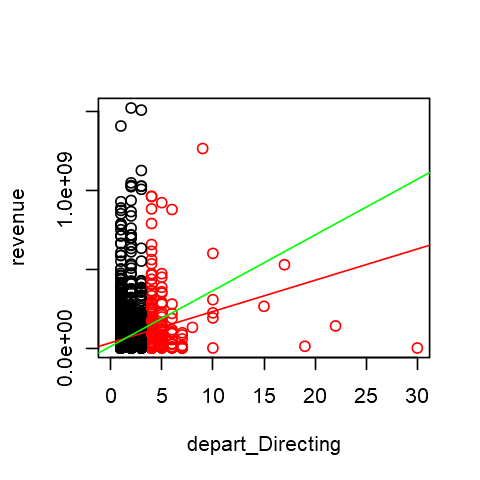

In [251]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(df$depart_Directing, df$revenue, col=factor(depart_Directing.out),xlab="depart_Directing",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

#### log depart_Directing

In [252]:
mod1 <- lm(df$revenue ~ df$depart_Directing)
mod2 <- lm(df$revenue ~ log (df$depart_Directing))

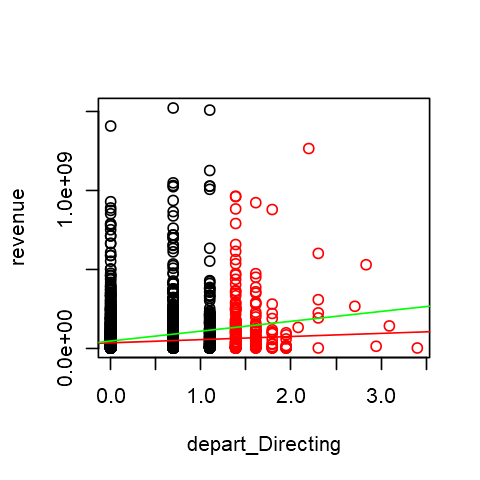

In [253]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(log(df$depart_Directing), df$revenue, col=factor(depart_Directing.out),xlab="depart_Directing",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

#### sqrt depart_Directing

In [254]:
mod1 <- lm(df$revenue ~ df$depart_Directing)
mod2 <- lm(df$revenue ~ sqrt (df$depart_Directing))

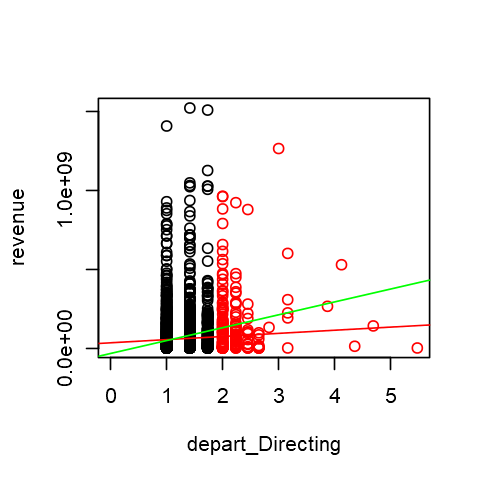

In [255]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(sqrt(df$depart_Directing), df$revenue, col=factor(depart_Directing.out),xlab="depart_Directing",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

#### sqrt (log (depart_Directing))

In [256]:
mod1 <- lm(df$revenue ~ df$depart_Directing)
mod2 <- lm(df$revenue ~ sqrt(log (df$depart_Directing)))

Warning message in sqrt(log(movies_ff$depart_Directing)):
"NaNs produced"


Warning message in sqrt(log(movies_ff$depart_Directing)):
"NaNs produced"


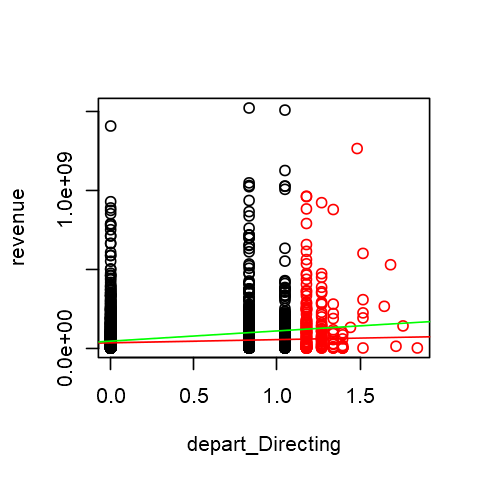

In [257]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(sqrt(log(df$depart_Directing)), df$revenue, col=factor(depart_Directing.out),xlab="depart_Directing",ylab="revenue")
abline(mod1, col="red") 
abline(mod2, col="green")

In [310]:
df$runtime                        <- runtime.noout
df$budget                         <- budget.noout
df$popularity                     <- log(df$popularity)
df$revenue                        <- revenue.noout
df$release_year                   <- release_year.noout
df$sw_collection                  <- sw_collection.noout
df$producers_cnt                  <- producers_cnt.noout
df$countries_cnt                  <- countries_cnt.noout
df$keywords_cnt                   <- sqrt(log (df$keywords_cnt))
df$actor0_movies_cnt              <- actor0_movies_cnt.noout
df$actor0_movies_5y_cnt           <- actor0_movies_5y_cnt.noout
df$actor1_movies_cnt              <- actor1_movies_cnt.noout
df$actor1_movies_5y_cnt           <- actor1_movies_5y_cnt.noout
df$actor2_movies_cnt              <- actor2_movies_cnt.noout
df$actor2_movies_5y_cnt           <- actor2_movies_5y_cnt.noout
df$actor0_prev_revenue            <- actor0_prev_revenue.noout
df$actor1_prev_revenue            <- actor1_prev_revenue.noout
df$actor2_prev_revenue            <- actor2_prev_revenue.noout
df$director_movies_cnt            <- director_movies_cnt.noout
df$director_movies_5y_cnt         <- director_movies_5y_cnt.noout
df$depart_Art                     <- depart_Art.noout
df$depart_Camera                  <- depart_Camera.noout
df$depart_Crew                    <- log(df$depart_Crew)
df$depart_Custom_Mkup             <- depart_Custom_Mkup.noout
df$depart_Directing               <- log(df$depart_Directing)
df$depart_Editing                 <- depart_Editing.noout
df$depart_Lighting                <- depart_Lighting.noout
df$depart_Production              <- depart_Production.noout
df$depart_Sound                   <- depart_Sound.noout
df$depart_Visual_Effects          <- depart_Visual_Effects.noout
df$depart_Writing                 <- depart_Writing.noout
df$depart_Art_female              <- depart_Art_female.noout
df$depart_Camera_female           <- depart_Camera_female.noout
df$depart_Crew_female             <- depart_Crew_female.noout
df$depart_Custom_Mkup_female      <- depart_Custom_Mkup_female.noout
df$depart_Directing_female        <- depart_Directing_female.noout
df$depart_Editing_female          <- depart_Editing_female.noout
df$depart_Lighting_female         <- depart_Lighting_female.noout
df$depart_Production_female       <- depart_Production_female.noout
df$depart_Sound_female            <- depart_Sound_female.noout
df$depart_Visual_Effects_female   <- depart_Visual_Effects_female.noout
df$depart_Writing_female          <- depart_Writing_female.noout

Warning message in log(df$popularity):
"NaNs produced"
Warning message in sqrt(log(df$keywords_cnt)):
"NaNs produced"
Warning message in log(df$depart_Crew):
"NaNs produced"
Warning message in log(df$depart_Directing):
"NaNs produced"


## 3.2 Missing values
רק לאחר שהורדנו קיצון

### 3.2.1. Show the distribution of each numeric variable by missingness of other variables

In [254]:
## remade the missing matrix to include the new missing values generated by the outliers treatment
df.na <- df
for(i in names(df)) {
    df.na[,i] <- ifelse(is.na(df.na[,i])==T,1,0)
}

In [255]:
## just converted the categorical variable to factors...
df$original_language <- factor(df$original_language)
df$release_date      <- factor(df$release_date)
df$runtime_cat       <- factor(df$runtime_cat)
summary (df)

    movie_id    original_language     release_date  runtime_cat  
 Min.   :   1   en     :6336      2010-09-10:  10   Large :1769  
 1st Qu.:1848   fr     : 199      2011-09-09:   8   Medium:3884  
 Median :3696   hi     : 118      2005-09-16:   7   Short :1722  
 Mean   :3698   ru     : 105      2008-12-25:   7                
 3rd Qu.:5550   es     :  95      2009-01-16:   7                
 Max.   :7398   ja     :  90      (Other)   :7335                
                (Other): 432      NA's      :   1                
    runtime          budget           popularity         revenue         
 Min.   : 59.0   Min.   :       0   Min.   :-4.5127   Min.   :        1  
 1st Qu.: 94.0   1st Qu.:       0   1st Qu.: 0.4827   1st Qu.:  1749265  
 Median :103.0   Median : 5500000   Median : 0.7256   Median : 12000000  
 Mean   :105.9   Mean   :13517000   Mean   : 0.5484   Mean   : 30454231  
 3rd Qu.:116.0   3rd Qu.:20000000   3rd Qu.: 0.8833   3rd Qu.: 42763574  
 Max.   :154.0   Max.   :725

In [256]:
getMissingness(df)

[[1]]
                     var na.count rate
1                revenue     4697 63.7
2      actor1_movies_cnt     4571 62.0
3            depart_Crew     4465 60.5
4    actor2_prev_revenue     3754 50.9
5    actor1_prev_revenue     3527 47.8
6    actor0_prev_revenue     3033 41.1
7          countries_cnt     1923 26.1
8  depart_Visual_Effects     1780 24.1
9           keywords_cnt     1566 21.2
10     depart_Art_female     1387 18.8

[[2]]
[1] "This dataset has 19 (0.3%) complete rows. Original data has 7375 rows."



var,na.count,rate
<fct>,<dbl>,<dbl>
revenue,4697,63.7
actor1_movies_cnt,4571,62.0
depart_Crew,4465,60.5
actor2_prev_revenue,3754,50.9
actor1_prev_revenue,3527,47.8
actor0_prev_revenue,3033,41.1
countries_cnt,1923,26.1
depart_Visual_Effects,1780,24.1
keywords_cnt,1566,21.2


In [257]:
missing_5_pct <- function (data, getRows = FALSE) {
       l <- nrow(data)
      vn <- names(data)
    nadf <- data
     cnt <- NULL
    miss <- function(x) return(sum(is.na(x)))
    for (n in vn) {
        nadf[[n]] <- ifelse(is.na(nadf[[n]]) == T, 1, 0)
        cnt <- rbind(cnt, data.frame(n, sum(nadf[[n]])))
    }
    names(cnt) <- c("var", "na.count")
    cnt$rate <- round((cnt$na.count/nrow(nadf)) * 100, 1)
    nadf$na.cnt <- 0
    nadf$na.cnt <- rowSums(nadf)
    cnt <- cnt %>% dplyr::arrange(desc(na.count)) %>% dplyr::filter(rate > 
        5)
    }
na_5_pct <-missing_5_pct(df)
na_5_pct

var,na.count,rate
<fct>,<dbl>,<dbl>
revenue,4697,63.7
actor1_movies_cnt,4571,62.0
depart_Crew,4465,60.5
actor2_prev_revenue,3754,50.9
actor1_prev_revenue,3527,47.8
actor0_prev_revenue,3033,41.1
countries_cnt,1923,26.1
depart_Visual_Effects,1780,24.1
keywords_cnt,1566,21.2


In [259]:
missing_less_5_pct <- function (data, getRows = FALSE) {
       l <- nrow(data)
      vn <- names(data)
    nadf <- data
     cnt <- NULL
    miss <- function(x) return(sum(is.na(x)))
    for (n in vn) {
        nadf[[n]] <- ifelse(is.na(nadf[[n]]) == T, 1, 0)
        cnt <- rbind(cnt, data.frame(n, sum(nadf[[n]])))
    }
    names(cnt) <- c("var", "na.count")
    cnt$rate <- round((cnt$na.count/nrow(nadf)) * 100, 1)
    nadf$na.cnt <- 0
    nadf$na.cnt <- rowSums(nadf)
    cnt <- cnt %>% dplyr::arrange(desc(na.count)) %>% dplyr::filter(rate < 
        5)
    }
na_less_5_pct <-missing_less_5_pct(df)
na_less_5_pct

var,na.count,rate
<fct>,<dbl>,<dbl>
depart_Editing,361,4.9
director_movies_5y_cnt,350,4.7
actor2_movies_5y_cnt,345,4.7
actor0_movies_cnt,306,4.1
runtime,280,3.8
release_year,270,3.7
sw_collection,206,2.8
depart_Camera_female,181,2.5
depart_Writing,176,2.4


In [260]:
na_5_pct <- na_5_pct$var
na_less_5_pct <- na_less_5_pct$var

ERROR: Error in na_5_pct$var: $ operator is invalid for atomic vectors


Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


[1] "revenue by NA actor1_movies_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 4.1838, df = 165.86, p-value = 4.636e-05
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  8455172 23566188
sample estimates:
mean of x mean of y 
 45550185  29539505 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


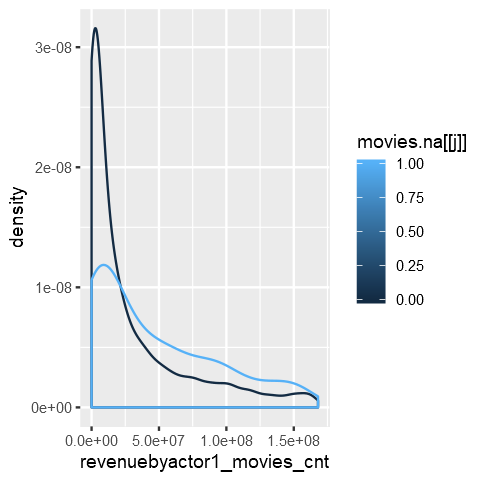

[1] "revenue by NA actor2_prev_revenue"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -10.603, df = 2649.4, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -18967974 -13047351
sample estimates:
mean of x mean of y 
 21954269  37961932 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


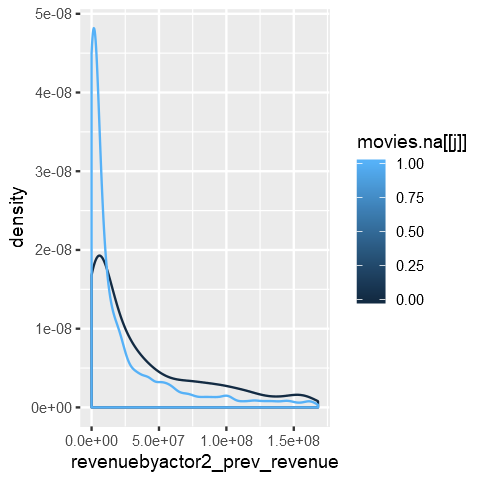

[1] "revenue by NA actor1_prev_revenue"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -9.8472, df = 2675.8, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -17786901 -11879503
sample estimates:
mean of x mean of y 
 22217871  37051073 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


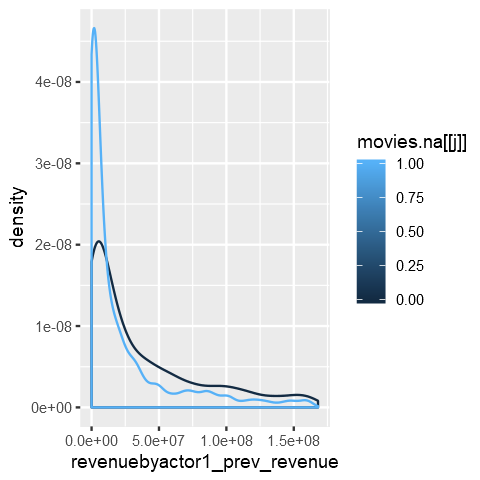

[1] "revenue by NA actor0_prev_revenue"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -9.6759, df = 2373, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -17561660 -11642897
sample estimates:
mean of x mean of y 
 21173768  35776047 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


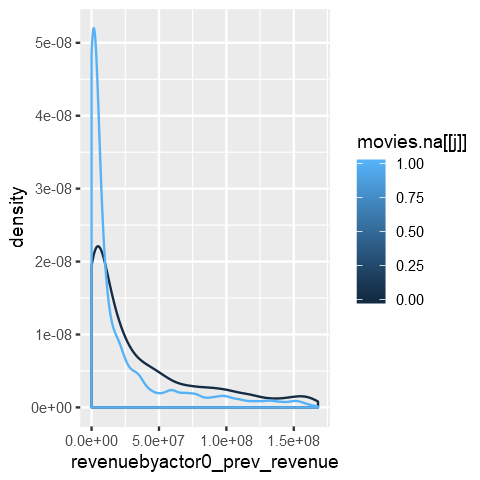

[1] "revenue by NA countries_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 1.042, df = 1104.4, p-value = 0.2976
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -1706014  5570270
sample estimates:
mean of x mean of y 
 31896472  29964344 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


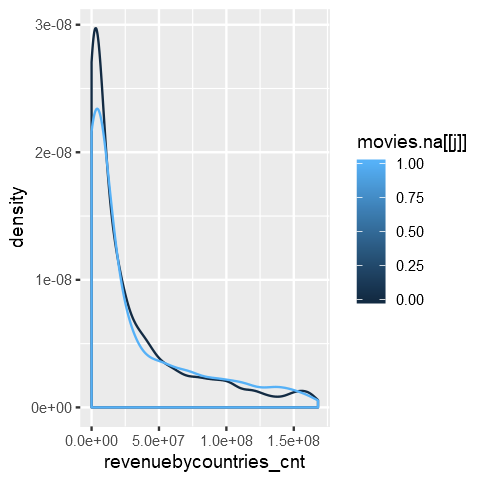

[1] "revenue by NA depart_Visual_Effects"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 11.161, df = 645.87, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 21228123 30292799
sample estimates:
mean of x mean of y 
 51308853  25548392 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


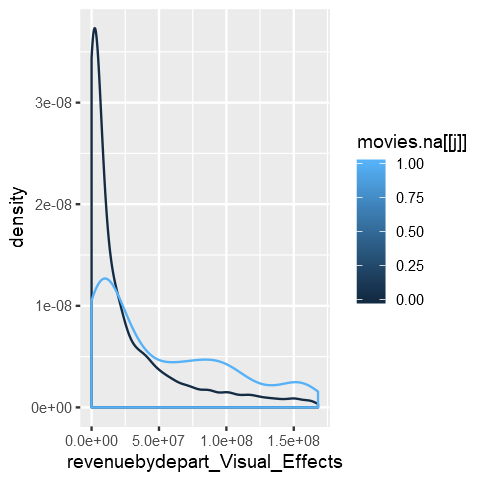

[1] "revenue by NA depart_Art_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 8.7922, df = 575.25, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 16268483 25627746
sample estimates:
mean of x mean of y 
 47835377  26887263 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


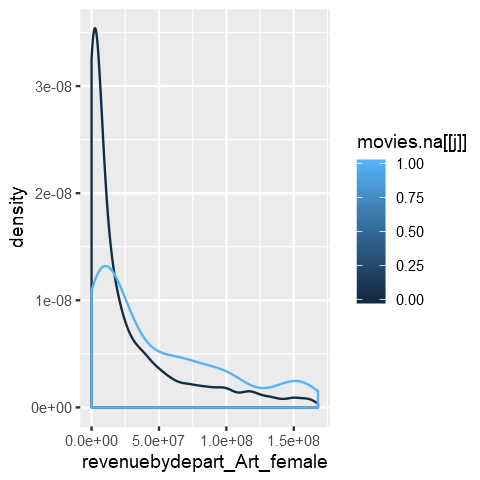

[1] "revenue by NA depart_Lighting"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 9.605, df = 441.98, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 20088503 30424232
sample estimates:
mean of x mean of y 
 52239969  26983602 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


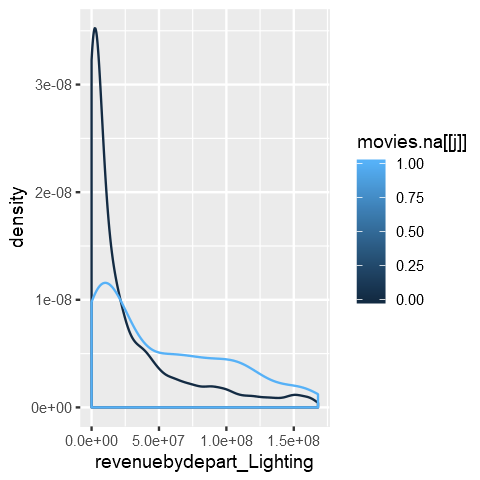

[1] "revenue by NA depart_Sound"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 12.619, df = 402.72, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 29032800 39747698
sample estimates:
mean of x mean of y 
 60439754  26049505 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


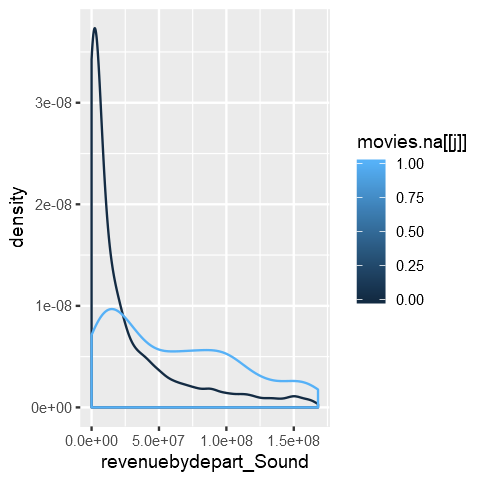

[1] "revenue by NA depart_Directing_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 5.0521, df = 439.54, p-value = 6.418e-07
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  8052530 18306848
sample estimates:
mean of x mean of y 
 41857270  28677581 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


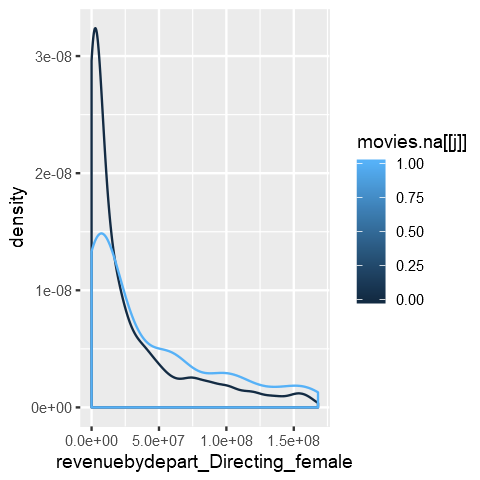

[1] "revenue by NA depart_Custom_Mkup"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 10.689, df = 338.15, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 26063011 37817936
sample estimates:
mean of x mean of y 
 58864315  26923842 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


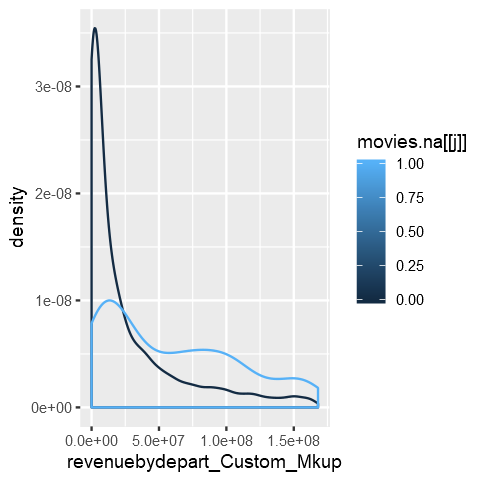

[1] "revenue by NA sw_female_actor0"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -7.7432, df = 172.28, p-value = 7.912e-13
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -23461694 -13930080
sample estimates:
mean of x mean of y 
 12714780  31410667 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


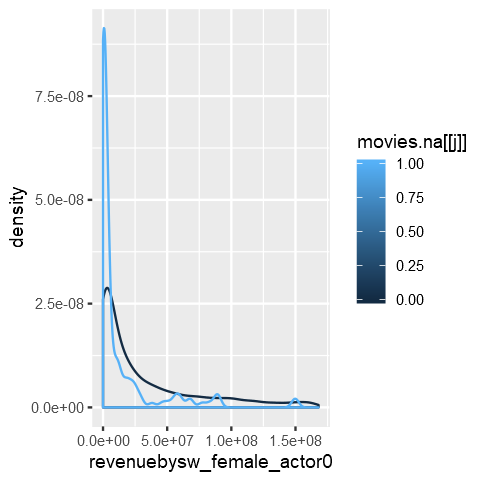

[1] "revenue by NA sw_male_actor0"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -7.7432, df = 172.28, p-value = 7.912e-13
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -23461694 -13930080
sample estimates:
mean of x mean of y 
 12714780  31410667 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


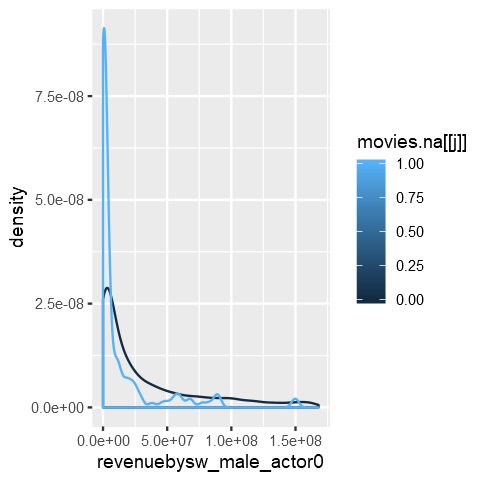

[1] "revenue by NA depart_Editing_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 2.0651, df = 408.37, p-value = 0.03954
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  241747 9807734
sample estimates:
mean of x mean of y 
 34876678  29851937 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


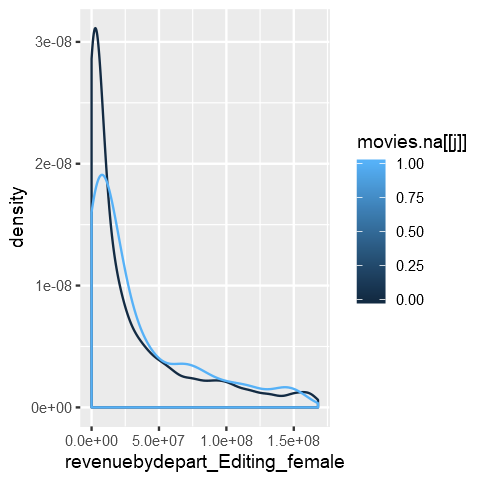

[1] "revenue by NA depart_Writing_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 3.6802, df = 322.23, p-value = 0.0002731
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  4934354 16269275
sample estimates:
mean of x mean of y 
 39967360  29365545 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


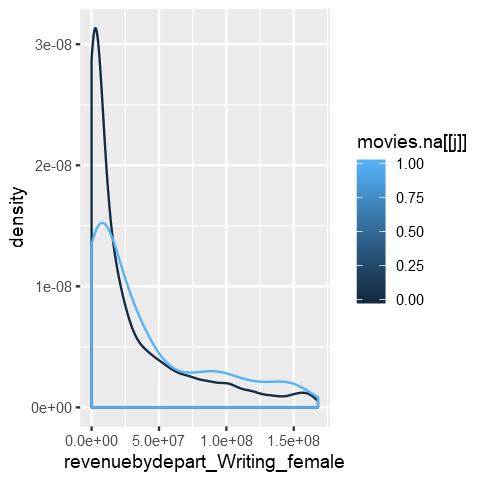

[1] "revenue by NA sw_female_actor2"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -4.2887, df = 64.808, p-value = 6.108e-05
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -23223779  -8465777
sample estimates:
mean of x mean of y 
 14964451  30809229 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


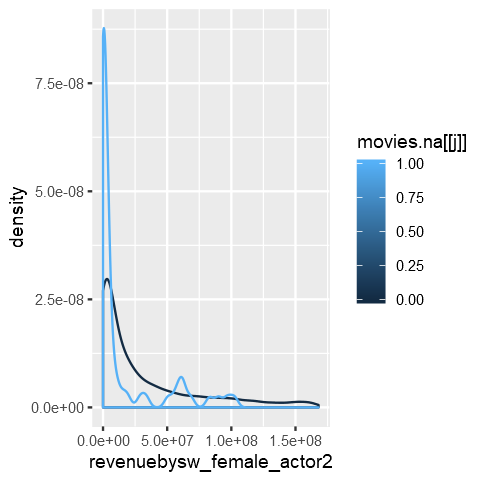

[1] "revenue by NA sw_male_actor2"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -4.2887, df = 64.808, p-value = 6.108e-05
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -23223779  -8465777
sample estimates:
mean of x mean of y 
 14964451  30809229 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


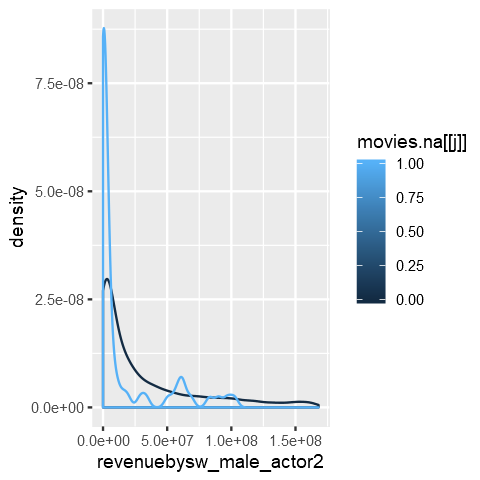

[1] "revenue by NA sw_female_actor1"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -5.8888, df = 64.061, p-value = 1.564e-07
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -24476461 -12076450
sample estimates:
mean of x mean of y 
 12566781  30843236 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


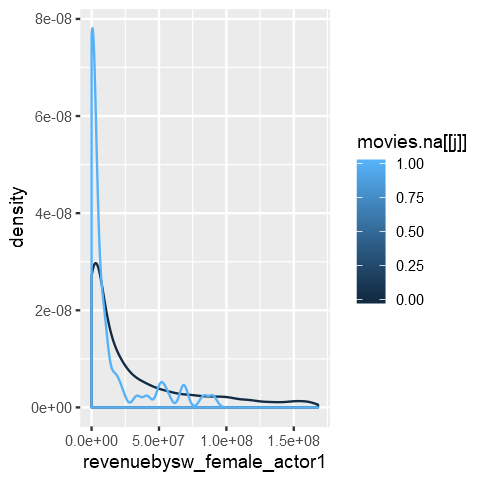

[1] "revenue by NA sw_male_actor1"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -5.8888, df = 64.061, p-value = 1.564e-07
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -24476461 -12076450
sample estimates:
mean of x mean of y 
 12566781  30843236 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


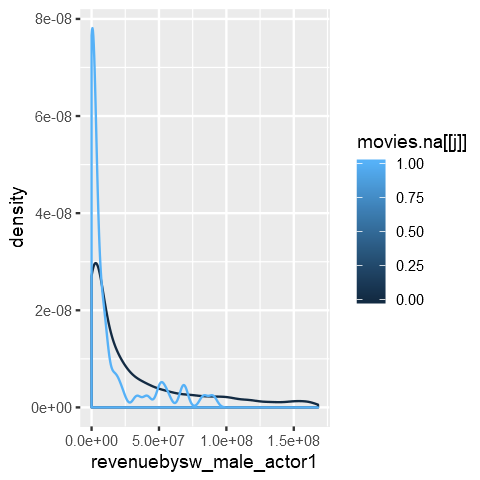

[1] "revenue by NA depart_Art"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 12.058, df = 204.75, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 37271242 51841954
sample estimates:
mean of x mean of y 
 71866244  27309646 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


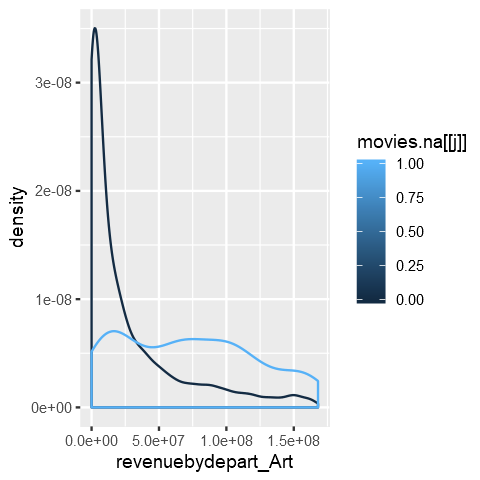

[1] "revenue by NA depart_Camera"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 9.8985, df = 212.08, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 29799786 44619910
sample estimates:
mean of x mean of y 
 64940729  27730881 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


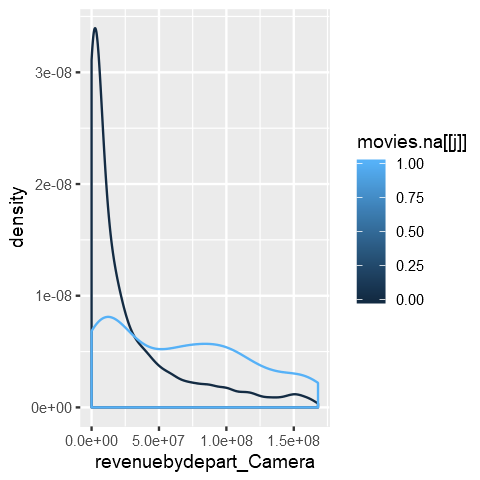

[1] "revenue by NA keywords_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -14.235, df = 523.35, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -25332974 -19188586
sample estimates:
mean of x mean of y 
 10437816  32698596 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


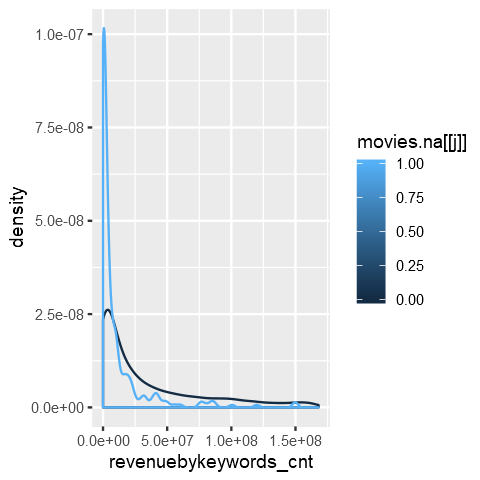

[1] "revenue by NA budget"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 13.789, df = 87.887, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 59192828 79127762
sample estimates:
mean of x mean of y 
 97419371  28259076 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


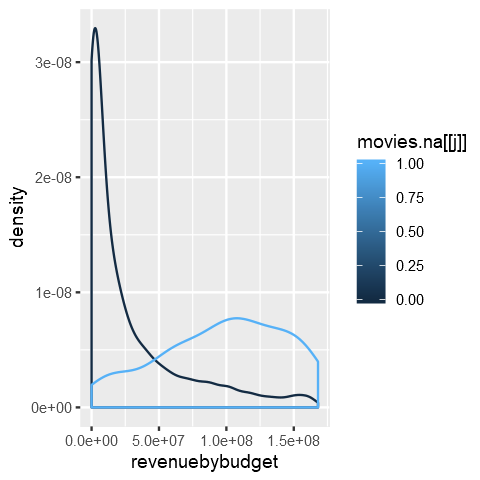

[1] "revenue by NA popularity"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -30.4, df = 1824.2, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -31505681 -27686855
sample estimates:
mean of x mean of y 
  3322476  32918744 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


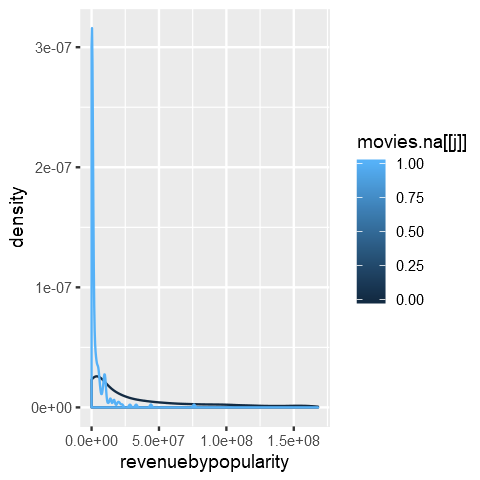

[1] "revenue by NA producers_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -10.56, df = 271.34, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -25645854 -17585794
sample estimates:
mean of x mean of y 
 10396231  32012055 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


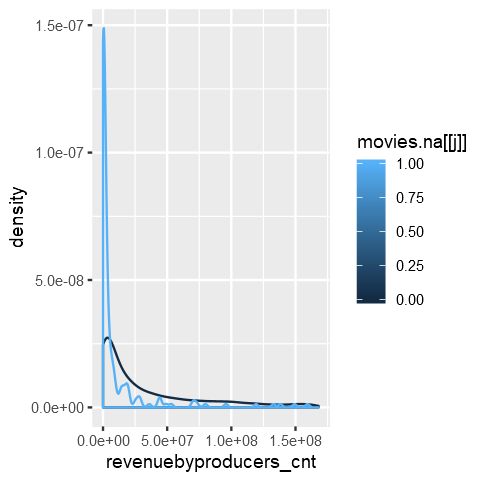

[1] "revenue by NA depart_Sound_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 5.0347, df = 197.28, p-value = 1.076e-06
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 10831422 24780411
sample estimates:
mean of x mean of y 
 47069983  29264067 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


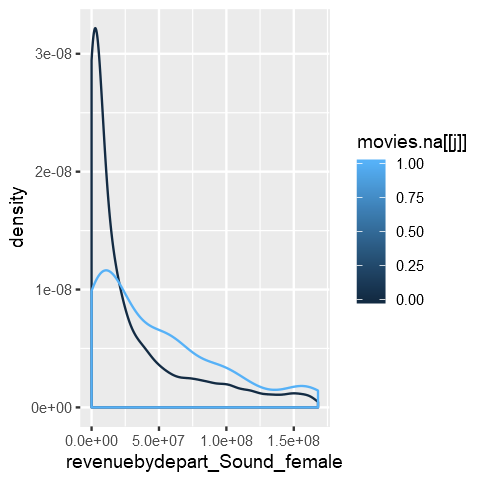

[1] "revenue by NA actor2_movies_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 4.2721, df = 198.93, p-value = 3e-05
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  8246848 22387300
sample estimates:
mean of x mean of y 
 44736058  29418984 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


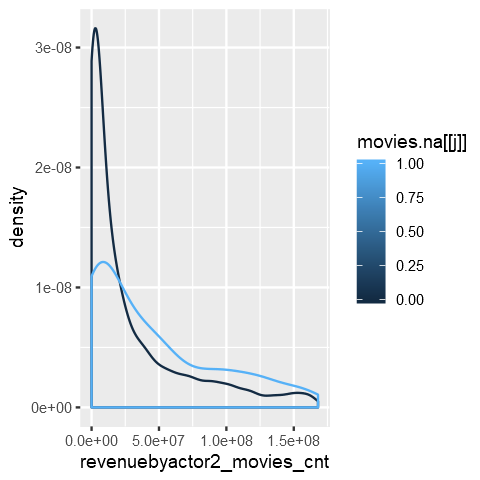

[1] "revenue by NA director_movies_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 5.9535, df = 138.95, p-value = 2.037e-08
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 17168384 34241891
sample estimates:
mean of x mean of y 
 54901947  29196810 



Warning message:
"Removed 4697 rows containing non-finite values (stat_density)."


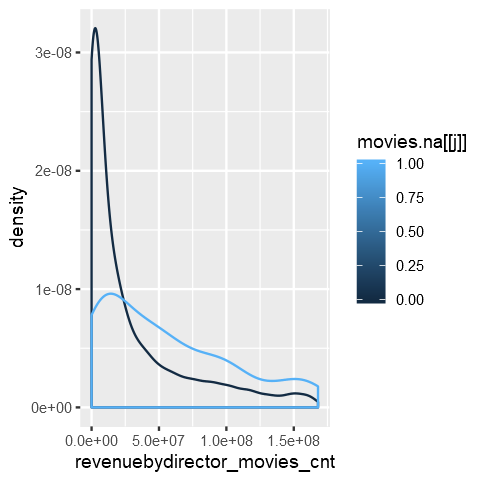

[1] "revenue by NA depart_Crew_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 4.5101, df = 105.1, p-value = 1.692e-05
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 12605900 32385921
sample estimates:
mean of x mean of y 
 52101714  29605804 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


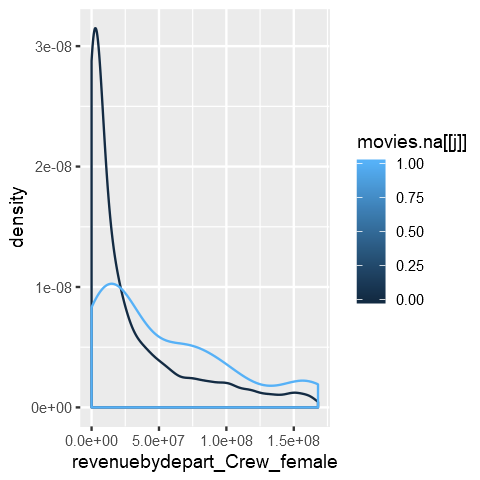

[1] "actor1_movies_cnt by NA revenue"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 23.829, df = 279.7, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 313403218 369846429
sample estimates:
mean of x mean of y 
371164329  29539505 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


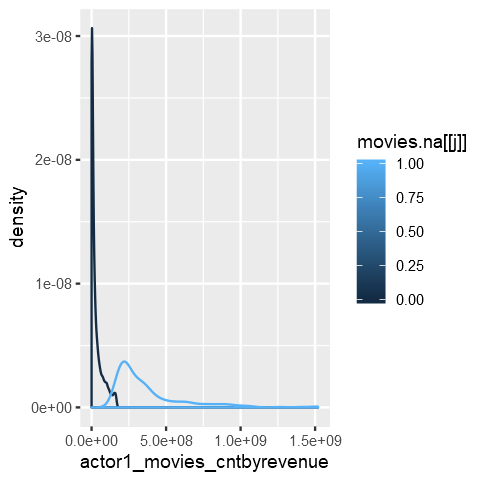

[1] "actor1_movies_cnt by NA actor2_prev_revenue"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -2.4469, df = 2577.2, p-value = 0.01447
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -22283522  -2457103
sample estimates:
mean of x mean of y 
 57037446  69407758 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


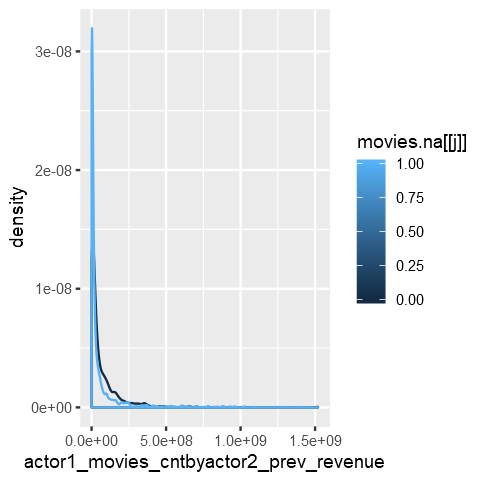

[1] "actor1_movies_cnt by NA actor1_prev_revenue"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -5.6828, df = 2732.7, p-value = 1.465e-08
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -37980027 -18493909
sample estimates:
mean of x mean of y 
 47791625  76028593 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


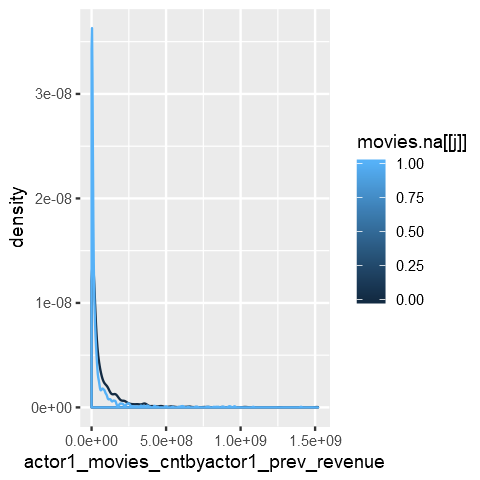

[1] "actor1_movies_cnt by NA actor0_prev_revenue"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -4.6514, df = 1957.4, p-value = 3.518e-06
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -35054961 -14261491
sample estimates:
mean of x mean of y 
 47702315  72360541 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


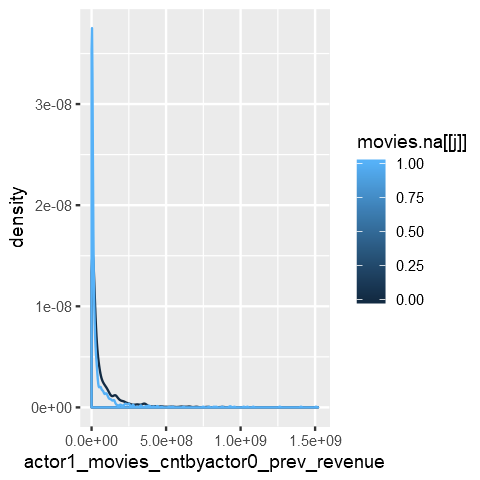

[1] "actor1_movies_cnt by NA countries_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 2.3741, df = 1042.7, p-value = 0.01777
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  2639666 27794700
sample estimates:
mean of x mean of y 
 74852048  59634865 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


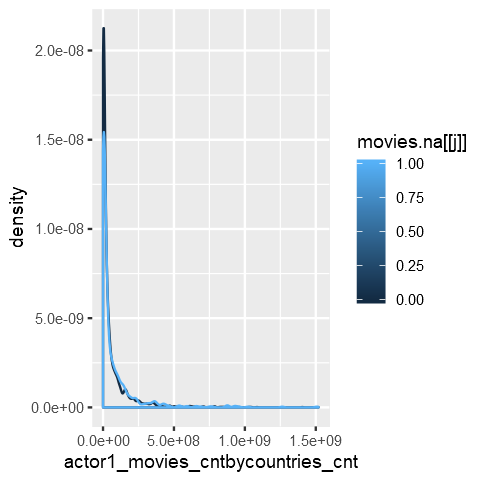

[1] "actor1_movies_cnt by NA depart_Visual_Effects"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 12.914, df = 671.06, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  98022323 133175812
sample estimates:
mean of x mean of y 
153116574  37517506 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


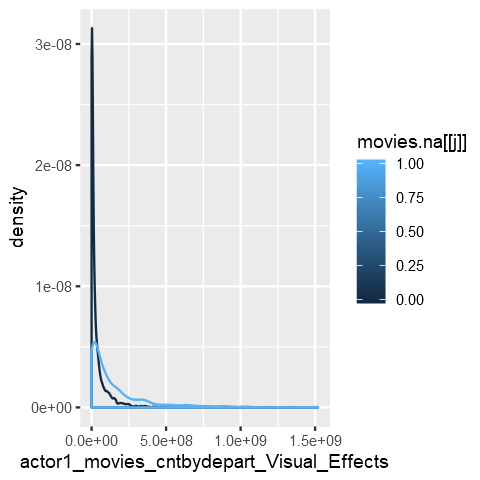

[1] "actor1_movies_cnt by NA depart_Art_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 7.2511, df = 588.4, p-value = 1.307e-12
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 46719622 81429538
sample estimates:
mean of x mean of y 
115929070  51854489 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


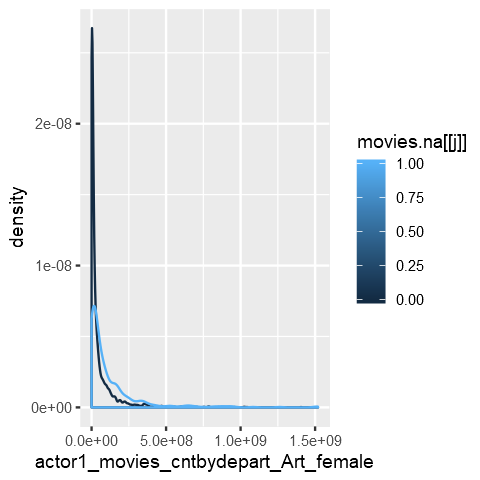

[1] "actor1_movies_cnt by NA depart_Lighting"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 9.5029, df = 490.18, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  74635950 113544116
sample estimates:
mean of x mean of y 
142756300  48666267 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


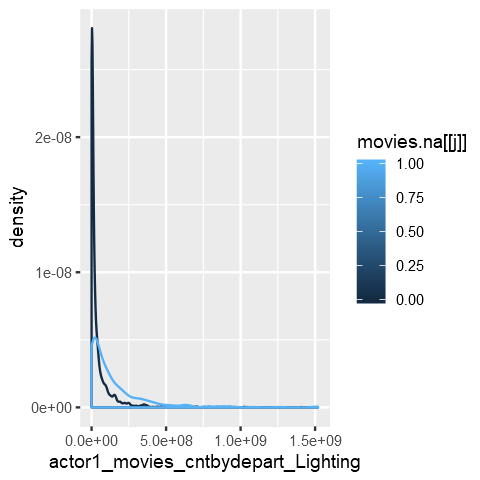

[1] "actor1_movies_cnt by NA depart_Sound"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 10.306, df = 453.71, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  91093937 134018527
sample estimates:
mean of x mean of y 
159107877  46551645 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


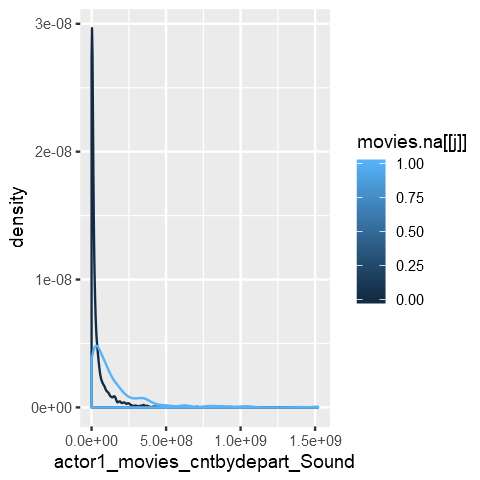

[1] "actor1_movies_cnt by NA depart_Directing_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 4.8067, df = 479.96, p-value = 2.056e-06
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 24985273 59537104
sample estimates:
mean of x mean of y 
 99688549  57427360 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


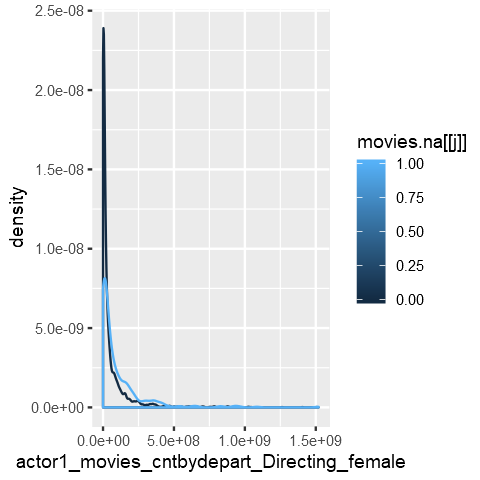

[1] "actor1_movies_cnt by NA depart_Custom_Mkup"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 9.1305, df = 396.17, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  78649818 121813570
sample estimates:
mean of x mean of y 
150751581  50519887 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


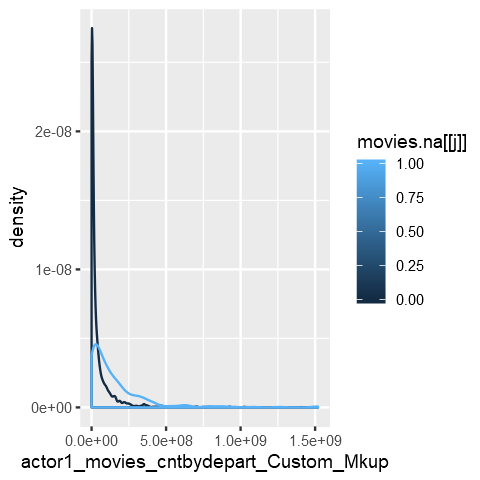

[1] "actor1_movies_cnt by NA sw_female_actor0"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -1.3441, df = 147.64, p-value = 0.181
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -42206498   8035069
sample estimates:
mean of x mean of y 
 47280491  64366206 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


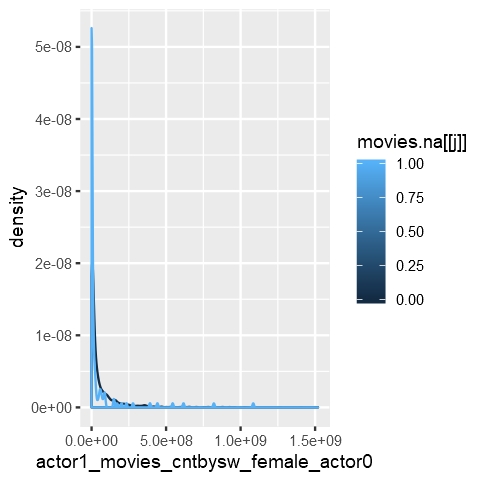

[1] "actor1_movies_cnt by NA sw_male_actor0"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -1.3441, df = 147.64, p-value = 0.181
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -42206498   8035069
sample estimates:
mean of x mean of y 
 47280491  64366206 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


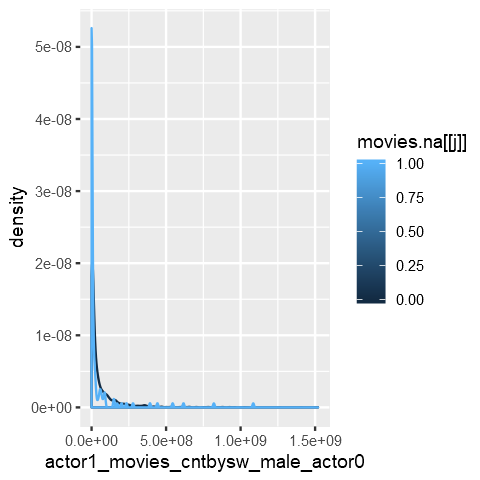

[1] "actor1_movies_cnt by NA depart_Editing_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 1.3495, df = 427.3, p-value = 0.1779
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -4942661 26600123
sample estimates:
mean of x mean of y 
 73043246  62214515 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


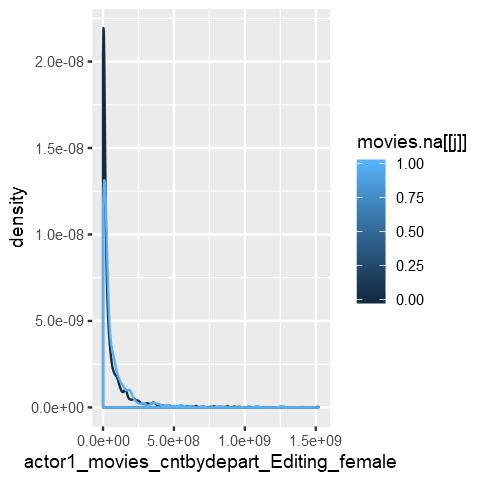

[1] "actor1_movies_cnt by NA depart_Writing_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 4.366, df = 338.93, p-value = 1.683e-05
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 28398406 74966139
sample estimates:
mean of x mean of y 
109444594  57762321 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


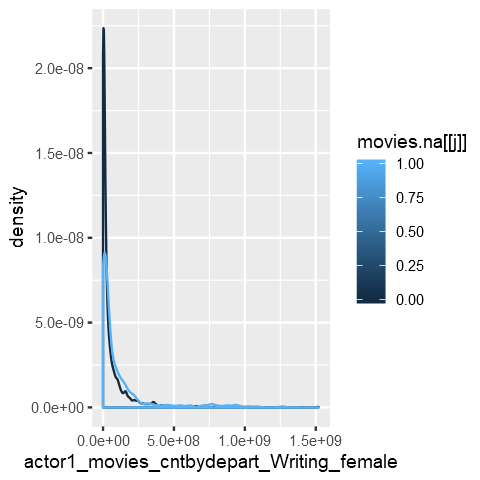

[1] "actor1_movies_cnt by NA sw_female_actor2"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 0.88812, df = 71.601, p-value = 0.3775
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -26007496  67793244
sample estimates:
mean of x mean of y 
 83895265  63002391 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


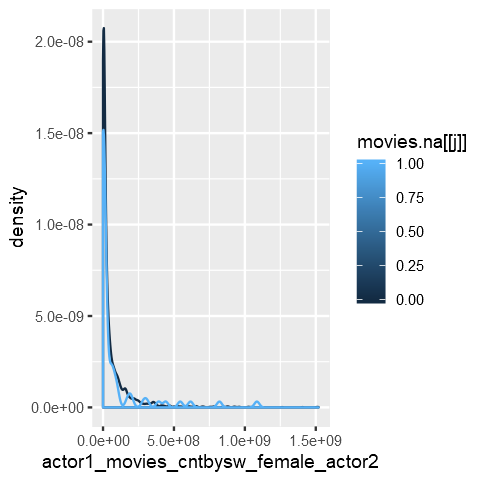

[1] "actor1_movies_cnt by NA sw_male_actor2"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 0.88812, df = 71.601, p-value = 0.3775
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -26007496  67793244
sample estimates:
mean of x mean of y 
 83895265  63002391 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


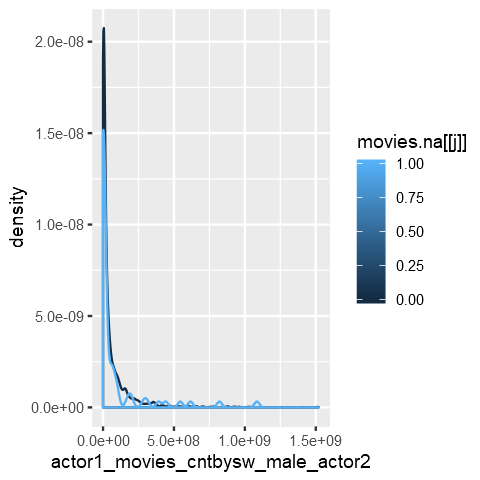

[1] "actor1_movies_cnt by NA sw_female_actor1"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 1.2027, df = 68.119, p-value = 0.2332
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -21588029  87100600
sample estimates:
mean of x mean of y 
 95493330  62737044 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


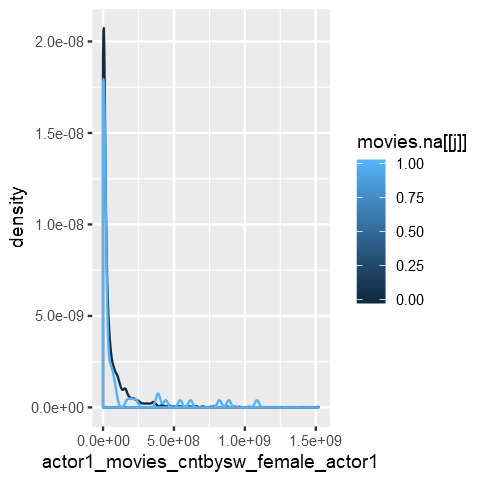

[1] "actor1_movies_cnt by NA sw_male_actor1"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 1.2027, df = 68.119, p-value = 0.2332
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -21588029  87100600
sample estimates:
mean of x mean of y 
 95493330  62737044 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


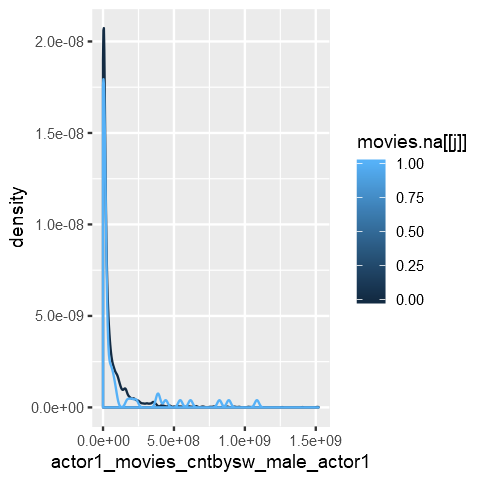

[1] "actor1_movies_cnt by NA depart_Art"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 9.7488, df = 280.05, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 118700193 178763595
sample estimates:
mean of x mean of y 
197888726  49156831 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


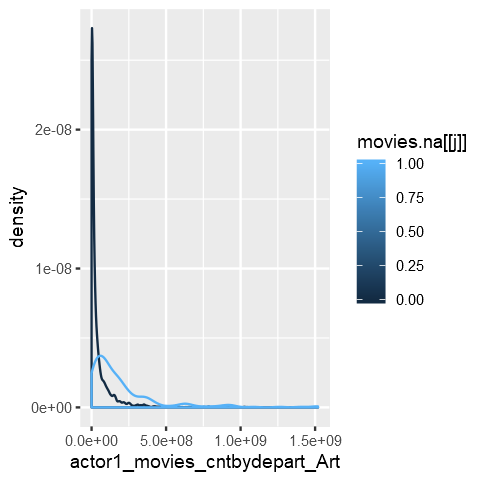

[1] "actor1_movies_cnt by NA depart_Camera"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 8.5759, df = 272.27, p-value = 7.54e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  98889631 157820647
sample estimates:
mean of x mean of y 
179893317  51538178 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


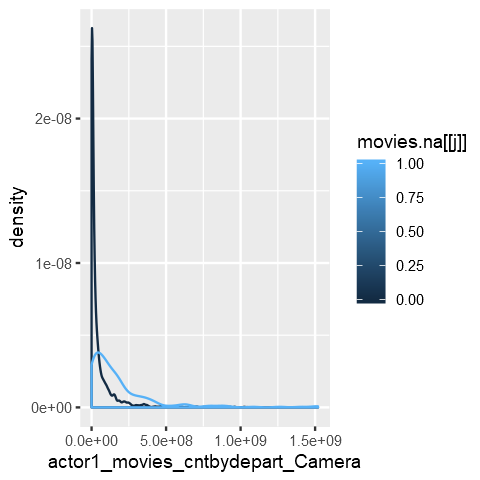

[1] "actor1_movies_cnt by NA keywords_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -18.76, df = 2353, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -64135217 -51996183
sample estimates:
mean of x mean of y 
 10891259  68956959 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


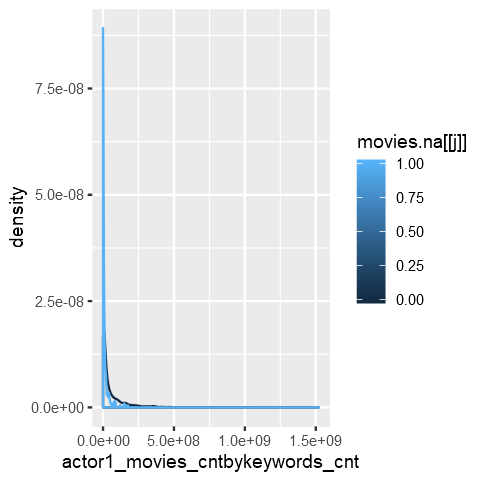

[1] "actor1_movies_cnt by NA budget"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 14.401, df = 217.42, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 246708468 324942932
sample estimates:
mean of x mean of y 
327339162  41513462 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


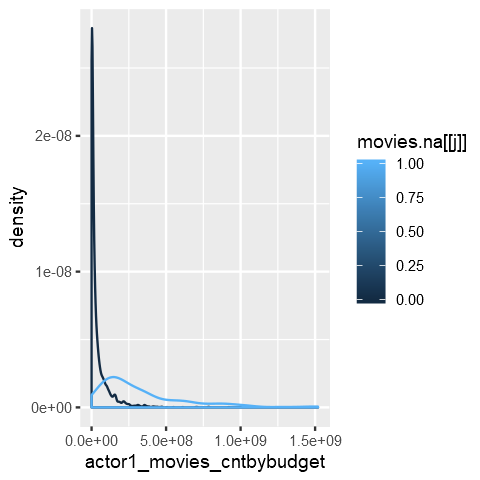

[1] "actor1_movies_cnt by NA popularity"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -15.232, df = 750.97, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -67301898 -51934455
sample estimates:
mean of x mean of y 
  8697155  68315331 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


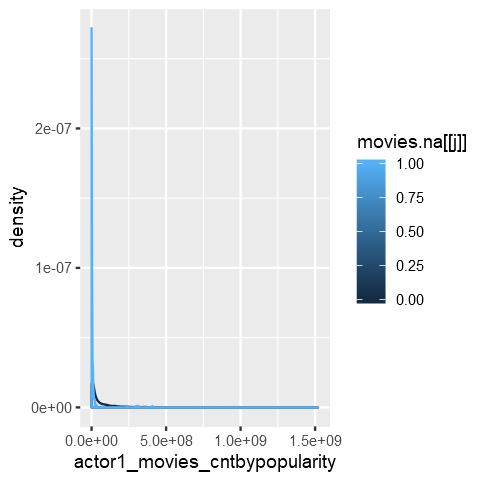

[1] "actor1_movies_cnt by NA producers_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -3.8958, df = 223.89, p-value = 0.0001292
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -56733871 -18618652
sample estimates:
mean of x mean of y 
 28461860  66138122 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


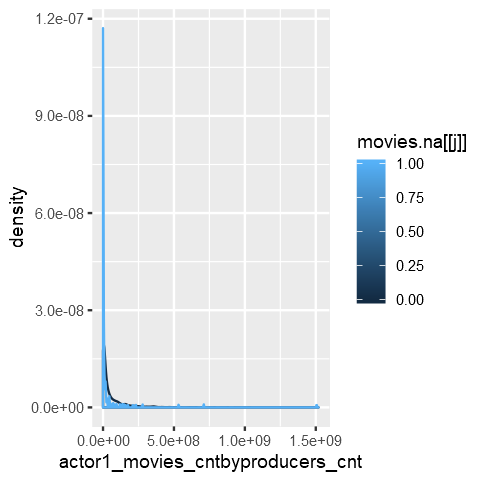

[1] "actor1_movies_cnt by NA depart_Sound_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 4.9916, df = 221.54, p-value = 1.212e-06
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  44618453 102835027
sample estimates:
mean of x mean of y 
131710248  57983508 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


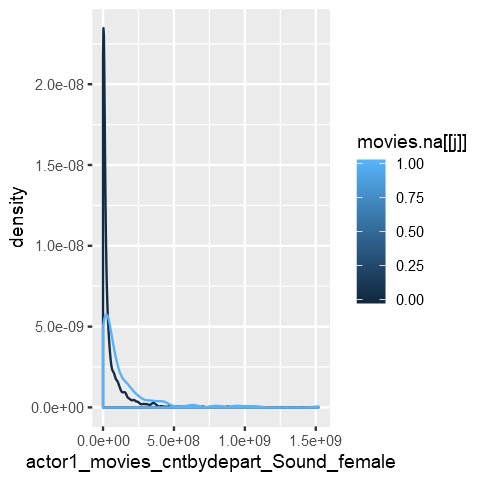

[1] "actor1_movies_cnt by NA actor2_movies_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 4.1019, df = 189.06, p-value = 6.084e-05
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  36768682 104893256
sample estimates:
mean of x mean of y 
129739682  58908713 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


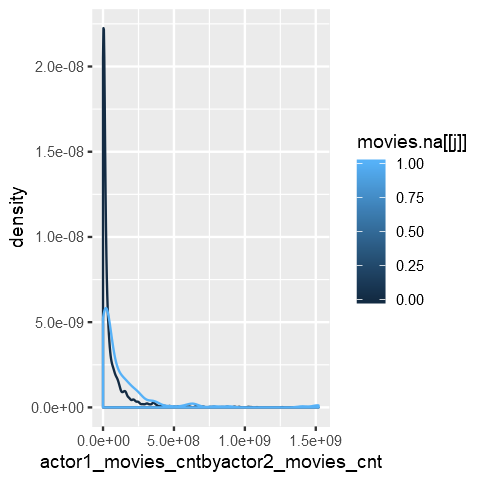

[1] "actor1_movies_cnt by NA director_movies_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 4.3622, df = 155.61, p-value = 2.334e-05
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 37558563 99723570
sample estimates:
mean of x mean of y 
128525011  59883944 



Warning message:
"Removed 4571 rows containing non-finite values (stat_density)."


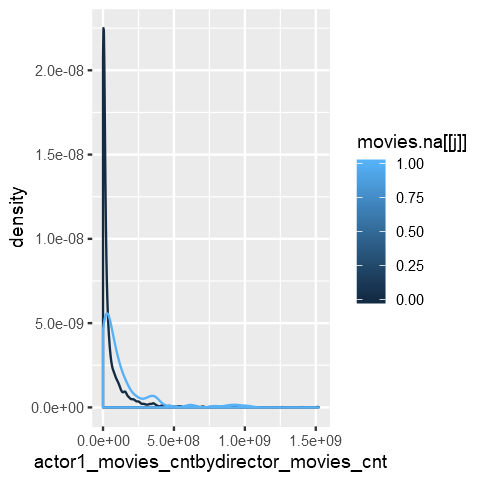

[1] "actor1_movies_cnt by NA depart_Crew_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 5.6587, df = 149.03, p-value = 7.582e-08
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  74094128 153607665
sample estimates:
mean of x mean of y 
171454273  57603377 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


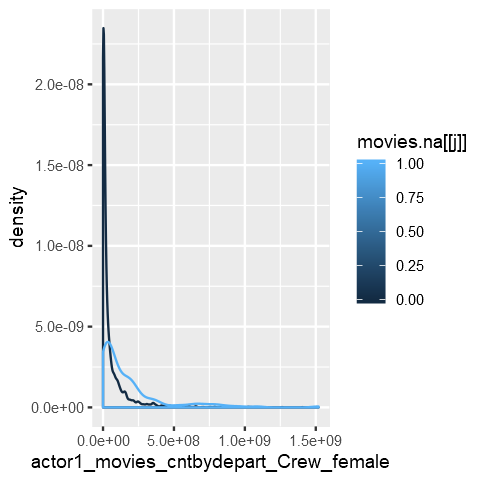

[1] "actor2_prev_revenue by NA revenue"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 1.8402, df = 3094.8, p-value = 0.06583
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  -518805.8 16362892.7
sample estimates:
mean of x mean of y 
136921140 128999096 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


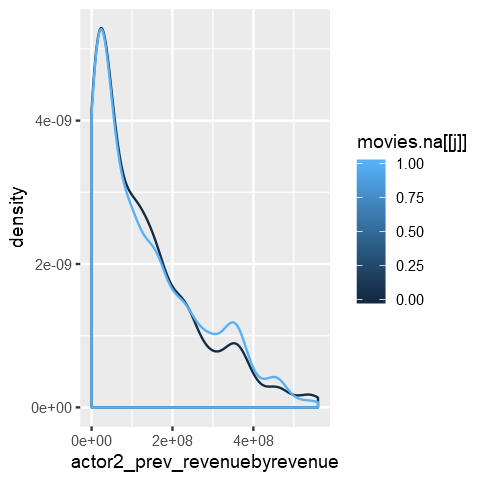

[1] "actor2_prev_revenue by NA actor1_movies_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 1.648, df = 3230.4, p-value = 0.09944
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -1337925 15442606
sample estimates:
mean of x mean of y 
136676980 129624640 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


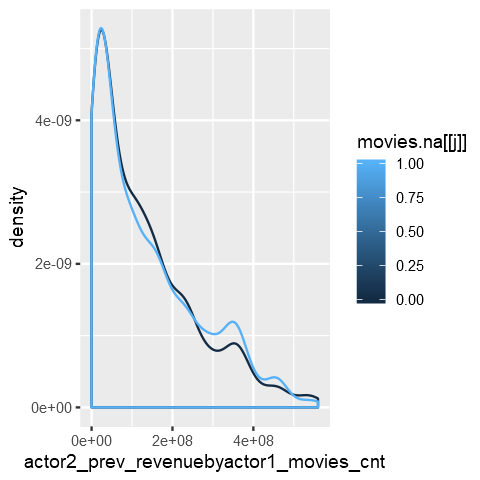

[1] "actor2_prev_revenue by NA actor1_prev_revenue"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -5.2551, df = 1963.8, p-value = 1.64e-07
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -33404346 -15247577
sample estimates:
mean of x mean of y 
116538043 140864004 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


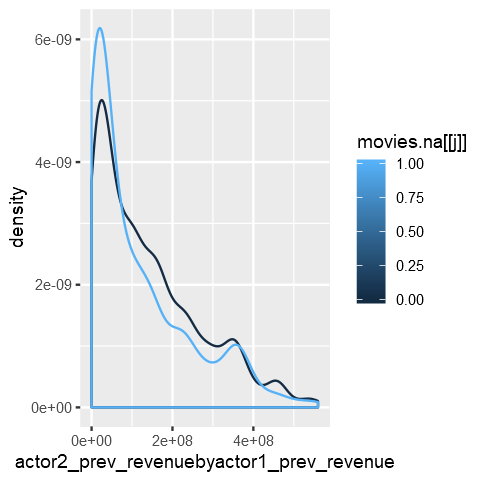

[1] "actor2_prev_revenue by NA actor0_prev_revenue"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -5.587, df = 1394, p-value = 2.775e-08
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -36954144 -17747571
sample estimates:
mean of x mean of y 
112653010 140003867 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


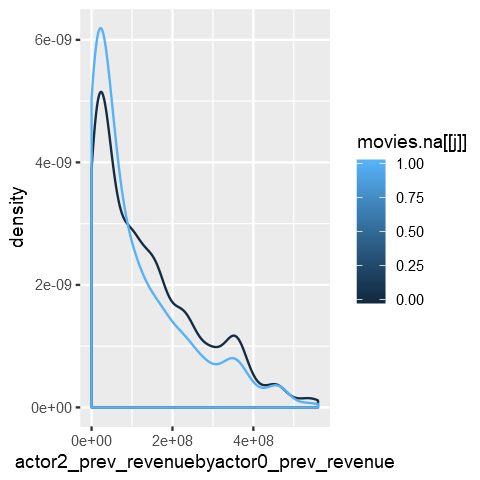

[1] "actor2_prev_revenue by NA countries_cnt"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 1.5342, df = 1631.1, p-value = 0.1252
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -2077026 16995904
sample estimates:
mean of x mean of y 
139318653 131859214 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


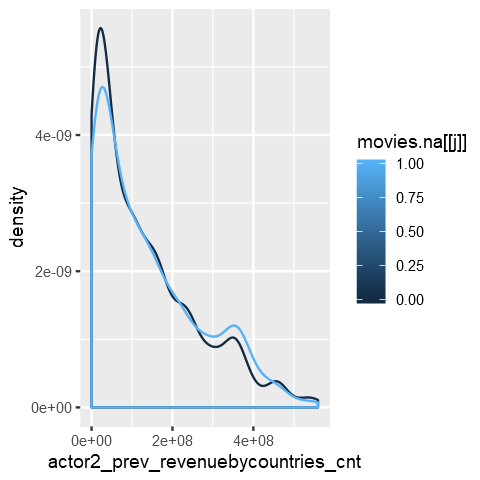

[1] "actor2_prev_revenue by NA depart_Visual_Effects"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 7.3577, df = 1664.1, p-value = 2.925e-13
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 26423770 45632174
sample estimates:
mean of x mean of y 
159908222 123880250 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


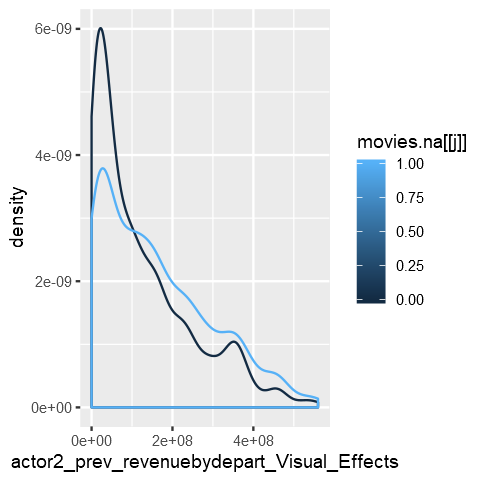

[1] "actor2_prev_revenue by NA depart_Art_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 6.2015, df = 1328.8, p-value = 7.451e-10
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 21646144 41677474
sample estimates:
mean of x mean of y 
158170699 126508890 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


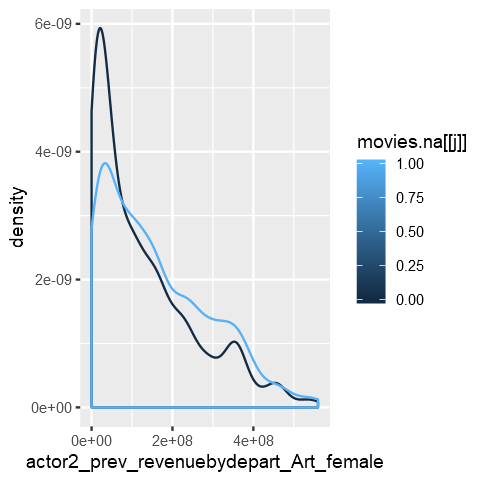

[1] "actor2_prev_revenue by NA depart_Lighting"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 4.8266, df = 1103.2, p-value = 1.584e-06
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 15307992 36279400
sample estimates:
mean of x mean of y 
154403722 128610026 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


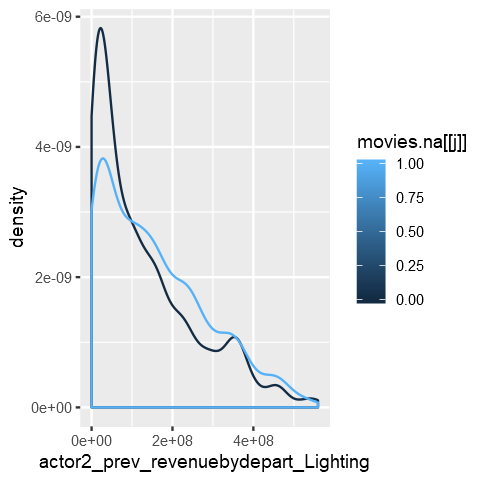

[1] "actor2_prev_revenue by NA depart_Sound"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 6.273, df = 998.39, p-value = 5.268e-10
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 23644621 45172204
sample estimates:
mean of x mean of y 
161747317 127338904 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


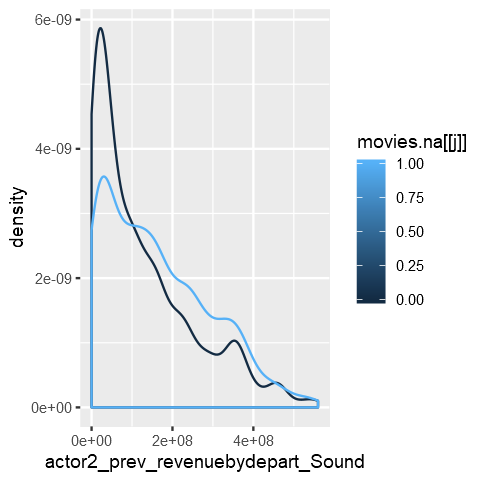

[1] "actor2_prev_revenue by NA depart_Directing_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 2.7264, df = 870.95, p-value = 0.006532
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  4297440 26387116
sample estimates:
mean of x mean of y 
146584720 131242441 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


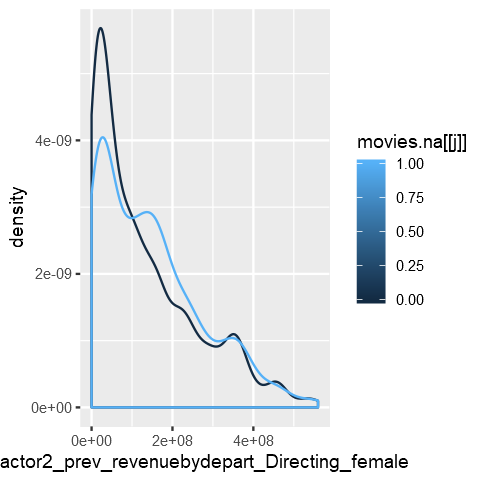

[1] "actor2_prev_revenue by NA depart_Custom_Mkup"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 6.8467, df = 893.47, p-value = 1.405e-11
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 27870273 50269311
sample estimates:
mean of x mean of y 
166039152 126969360 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


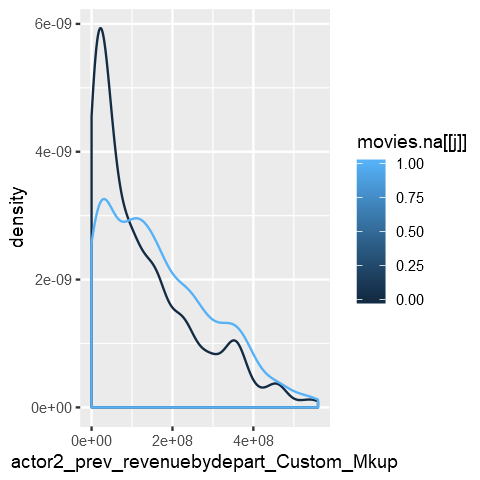

[1] "actor2_prev_revenue by NA sw_female_actor0"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -1.4279, df = 102.7, p-value = 0.1563
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -47971605   7810351
sample estimates:
mean of x mean of y 
114278468 134359095 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


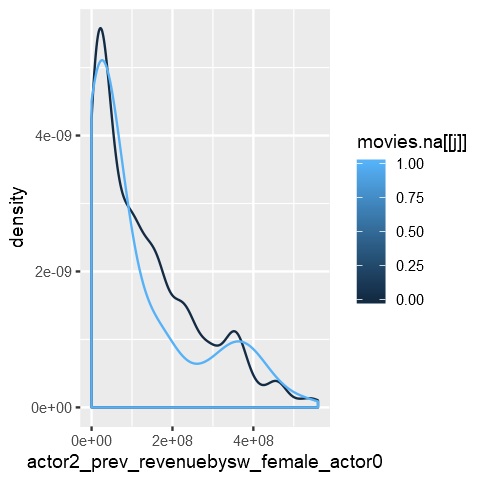

[1] "actor2_prev_revenue by NA sw_male_actor0"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = -1.4279, df = 102.7, p-value = 0.1563
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -47971605   7810351
sample estimates:
mean of x mean of y 
114278468 134359095 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


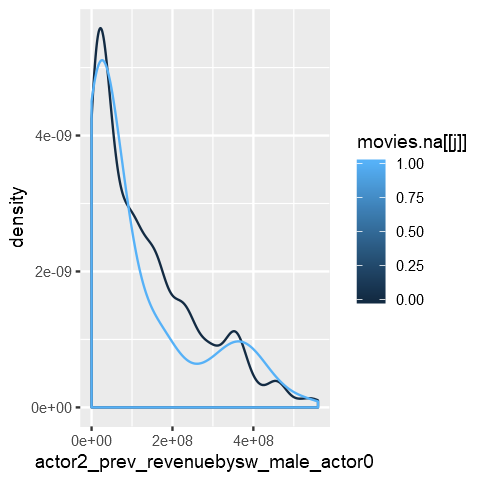

[1] "actor2_prev_revenue by NA depart_Editing_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 2.41, df = 624.7, p-value = 0.01624
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  2818837 27631658
sample estimates:
mean of x mean of y 
147029682 131804435 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


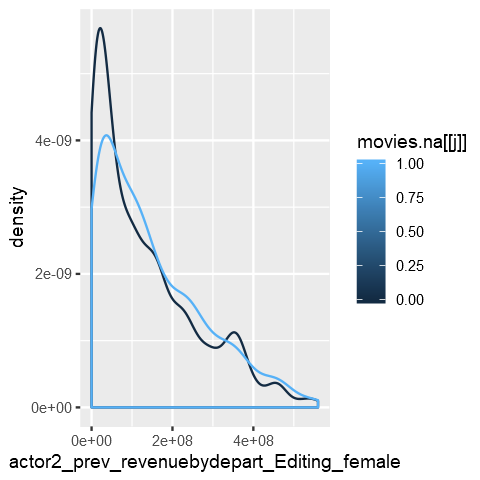

[1] "actor2_prev_revenue by NA depart_Writing_female"

	Welch Two Sample t-test

data:  b1[[i]] and b2[[i]]
t = 1.3606, df = 524.44, p-value = 0.1742
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -4010553 22083329
sample estimates:
mean of x mean of y 
141815806 132779418 



Warning message:
"Removed 3754 rows containing non-finite values (stat_density)."


[1] "actor2_prev_revenue by NA sw_female_actor2"


ERROR: Error in t.test.default(b1[[i]], b2[[i]]): not enough 'x' observations


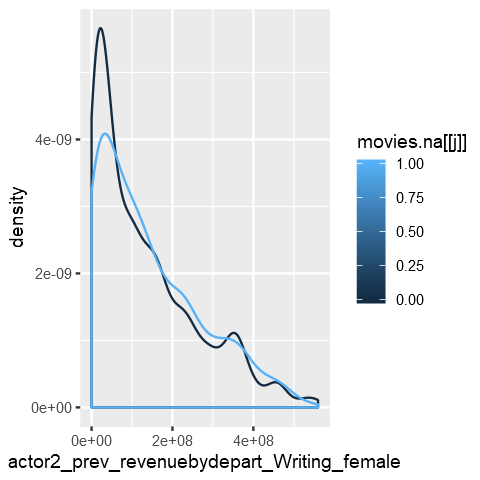

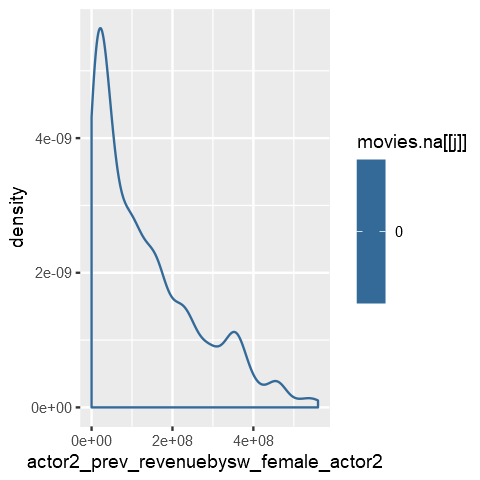

In [144]:
options(repr.plot.width = 4, repr.plot.height = 4)
for (i in (na_5_pct)) {
    for (j in (na_5_pct)) {
       if(i!=j){
           print(ggplot(df,aes(x=df[[i]],
                                     group=movies.na[[j]],
                                     color=movies.na[[j]]))+
                 geom_density()+
                 labs(x=paste(i,'by',j,sep='')))     
           b1 <- df %>% select (i,j) %>% filter(df.na[j]==1)
           b2 <- df %>% select (i,j) %>% filter(df.na[j]==0)
           print(paste(i,' by NA ', j,sep=''))
           print(t.test(b1[[i]],b2[[i]]))
           
       } 
    }
}


### 3.2.2. Determinate the Missingness Generation Mechanism

By the regression above and the t-test I asume that the missing mechanism is MNAR

| Variable                     | Mechanism | Treatment               |
|------------------------------|-----------|-------------------------|
| actor1_movies_cnt            | MNAR      | categorized   by IQRs   |
| depart_Crew                  | MNAR      | categorized by   IQRs   |
| actor2_prev_revenue          | MNAR      | categorized by IQRs     |
| actor1_prev_revenue          | MNAR      | categorized by IQRs     |
| actor0_prev_revenue          | MNAR      | categorized by IQRs     |
| countries_cnt                | MNAR      | categorized by IQRs     |
| depart_Visual_Effects        | MNAR      | categorized by IQRs     |
| keywords_cnt                 | MNAR      | categorized by IQRs     |
| depart_Art_female            | MNAR      | categorized by IQRs     |
| depart_Lighting              | MNAR      | categorized by IQRs     |
| depart_Sound                 | MNAR      | categorized by IQRs     |
| depart_Directing_female      | MNAR      | categorized by IQRs     |
| depart_Custom_Mkup           | MNAR      | categorized by IQRs     |
| sw_female_actor0             | MNAR      | categorized by   factor |
| sw_male_actor0               | MNAR      | categorized by   factor |
| depart_Editing_female        | MNAR      | categorized by IQRs     |
| depart_Writing_female        | MNAR      | categorized by IQRs     |
| sw_female_actor2             | MNAR      | categorized by   factor |
| sw_male_actor2               | MNAR      | categorized by factor   |
| sw_female_actor1             | MNAR      | categorized by factor   |
| sw_male_actor1               | MNAR      | categorized by factor   |
| depart_Art                   | MNAR      | categorized by IQRs     |
| depart_Camera                | MNAR      | categorized by IQRs     |
| budget                       | MNAR      | categorized by IQRs     |
| popularity                   | MNAR      | categorized by IQRs     |
| producers_cnt                | MNAR      | categorized by IQRs     |
| depart_Sound_female          | MNAR      | categorized by IQRs     |
| actor2_movies_cnt            | MNAR      | categorized by IQRs     |
| director_movies_cnt          | MNAR      | categorized by IQRs     |
| depart_Crew_female           | MNAR      | categorized by IQRs     |
| depart_Editing               | MNAR      | Deleate                 |
| director_movies_5y_cnt       | MNAR      | Deleate                 |
| actor2_movies_5y_cnt         | MNAR      | Deleate                 |
| actor0_movies_cnt            | MNAR      | Deleate                 |
| runtime                      | MNAR      | Deleate                 |
| release_year                 | MNAR      | Deleate                 |
| sw_collection                | MNAR      | Deleate                 |
| depart_Camera_female         | MNAR      | Deleate                 |
| depart_Writing               | MNAR      | Deleate                 |
| actor1_movies_5y_cnt         | MNAR      | Deleate                 |
| depart_Custom_Mkup_female    | MNAR      | Deleate                 |
| depart_Production            | MNAR      | Deleate                 |
| depart_Visual_Effects_female | MNAR      | Deleate                 |
| actor0_movies_5y_cnt         | MNAR      | Deleate                 |
| depart_Lighting_female       | MNAR      | Deleate                 |
| depart_Directing             | MNAR      | Deleate                 |
| depart_Production_female     | MNAR      | Deleate                 |
| release_date                 | MNAR      | Deleate                 |
| release_month                | MNAR      | Deleate                 |
| release_day                  | MNAR      | Deleate                 |
| seasonality                  | MNAR      | Deleate                 |
| seasonality                  | MNAR      | Deleate                 |

### 3.2.3 - Missingess treatment

In [266]:
#deleting rows with NA for all missing with less than 5%
na.omit(df$depart_Editing)
na.omit(df$depart_Editing)
na.omit(df$director_movies_5y_cnt)
na.omit(df$actor2_movies_5y_cnt)
na.omit(df$actor0_movies_cnt)
na.omit(df$runtime)
na.omit(df$release_year)
na.omit(df$sw_collection)
na.omit(df$depart_Camera_female)
na.omit(df$depart_Writing)
na.omit(df$actor1_movies_5y_cnt)
na.omit(df$depart_Custom_Mkup_female)
na.omit(df$depart_Production)
na.omit(df$depart_Visual_Effects_female)
na.omit(df$actor0_movies_5y_cnt)
na.omit(df$depart_Lighting_female)
na.omit(df$depart_Directing)
na.omit(df$depart_Production_female)
na.omit(df$release_date)
na.omit(df$release_month)
na.omit(df$release_day)
na.omit(df$seasonality)


[1] 2 1 0 0 0 0 1 1 4 0 2 2 3 1 0 2 4 1 0 1 1 1 1 1 1 1 2 2 0 3 3 0 3 0 3 0 1
  [38] 1 0 1 1 1 5 1 1 0 1 0 0 2 0 0 4 0 0 0 3 1 4 1 1 0 2 5 1 1 1 0 1 0 1 1 2 2
  [75] 1 4 2 0 1 3 0 1 1 0 1 1 1 0 1 2 0 1 4 5 0 1 0 3 1 3 0 1 4 1 1 1 2 0 2 1 1
 [112] 2 0 1 2 0 0 1 0 0 0 0 4 1 1 0 1 0 2 1 1 0 0 1 1 2 2 3 3 0 1 3 1 0 0 1 0 1
 [149] 0 0 1 1 1 0 2 3 2 3 1 0 1 1 0 0 1 1 2 0 2 1 1 0 1 0 0 3 1 1 0 0 0 1 0 2 1
 [186] 0 2 0 2 1 1 2 3 1 3 0 1 0 1 0 3 0 1 1 0 1 1 0 1 1 3 0 5 1 2 0 1 1 1 3 0 1
 [223] 3 1 1 2 2 1 2 1 1 0 0 4 0 1 0 5 1 5 0 1 1 1 2 3 2 2 1 1 0 0 1 1 1 4 1 1 1
 [260] 0 5 5 2 1 1 4 1 2 2 1 1 2 0 4 0 4 2 1 0 3 0 0 1 2 1 0 1 1 2 1 1 0 0 2 3 0
 [297] 0 1 0 2 4 0 1 4 3 2 0 0 2 1 0 0 2 0 1 1 0 3 0 0 0 0 0 1 3 0 2 2 0 0 3 0 4
 [334] 3 1 1 1 1 0 1 3 1 1 2 1 3 0 1 3 1 2 1 0 5 0 1 5 1 1 1 1 0 2 1 1 0 0 1 3 2
 [371] 1 0 1 3 1 2 0 2 2 1 3 2 2 2 1 2 3 1 0 1 1 1 1 1 1 3 1 1 0 0 0 1 1 2 1 5 1
 [408] 1 1 1 0 1 2 2 4 4 2 1 1 0 2 2 3 1 1 1 0 2 0 0 2 0 1 2 0 1 2 0 1 2 1 2 3 1
 [445] 0 0 0 0 1 3 1 0 0 1 0 0 3 0 3 0 1 1 1 0 0 1 1 0 0 1 1 4 0 1 2 0 1 3 1 0 1
 [482] 0 1 1 5 1 2 1 1 0 0 1 3 2 2 1 0 0 1 1 0 0 1 2 0 2 1 3 2 1 2 1 1 0 0 1 2 2
 [519] 0 3 1 3 1 1 0 1 4 1 1 0 1 1 1 2 5 2 0 1 2 1 1 1 1 1 1 4 1 1 0 3 1 2 0 0 2
 [556] 1 0 0 4 4 1 1 3 1 5 2 2 0 3 2 0 1 1 1 0 5 1 0 4 1 1 1 1 5 3 5 1 1 1 3 1 1
 [593] 1 1 1 0 1 0 1 1 1 2 0 1 1 1 1 1 3 0 1 0 0 1 1 1 1 2 1 5 2 0 5 0 1 5 0 1 1
 [630] 1 0 1 1 4 1 1 0 0 1 3 1 1 1 2 1 0 2 0 2 0 1 0 1 0 2 1 1 1 4 0 1 1 0 1 3 1
 [667] 2 1 1 2 0 1 0 1 1 1 0 1 0 1 4 1 2 2 1 1 1 1 1 2 2 1 2 4 1 0 1 0 3 1 0 1 0
 [704] 2 1 1 0 0 2 0 1 1 1 4 1 2 2 1 0 1 2 1 5 0 1 0 4 1 5 5 2 3 2 1 1 0 1 0 1 4
 [741] 1 2 2 3 2 1 0 4 1 3 1 1 2 2 0 0 1 2 2 1 0 1 0 1 2 2 1 0 1 1 1 2 1 1 0 0 5
 [778] 0 0 1 1 1 0 1 0 1 1 1 0 0 2 3 5 1 1 2 4 0 0 0 1 0 1 5 1 0 2 4 2 1 1 1 1 2
 [815] 3 0 0 0 1 1 2 0 2 1 3 1 1 5 0 1 0 2 1 2 1 2 0 0 1 1 1 0 1 1 0 1 0 1 1 4 0
 [852] 3 0 0 0 1 1 0 1 0 2 0 0 2 1 0 1 0 3 4 0 1 1 1 2 0 1 1 1 1 2 0 2 5 1 0 2 1
 [889] 5 1 0 0 1 0 1 0 1 1 3 1 0 3 1 2 4 1 5 1 1 1 4 1 1 1 0 1 0 1 0 0 0 1 1 1 0
 [926] 1 0 1 0 1 1 1 1 2 4 1 2 2 1 1 2 1 1 0 1 3 1 1 1 0 1 2 4 2 0 1 1 0 2 2 3 0
 [963] 0 0 1 2 1 1 1 3 0 1 0 2 0 4 1 5 0 0 1 1 4 1 3 1 1 1 2 5 0 0 0 1 2 2 1 0 2
[1000] 2 3 2 1 0 3 0 1 1 0 0 1 0 1 1 2 2 1 1 1 0 2 0 2 1 1 0 0 2 1 2 1 1 1 0 1 0
[1037] 2 1 0 0 0 1 0 2 0 1 2 0 2 1 1 2 1 4 1 1 1 0 0 2 4 1 1 1 2 1 2 1 0 0 1 1 2
[1074] 3 1 2 1 1 1 0 1 1 1 3 1 1 1 1 0 0 0 1 1 1 1 0 2 0 3 0 1 0 0 1 0 1 0 1 1 4
[1111] 1 1 2 5 5 4 4 1 1 1 1 1 0 1 1 1 1 3 1 0 1 0 1 1 1 1 1 0 1 1 3 2 2 2 0 1 1
[1148] 5 1 0 1 1 3 1 2 0 0 1 3 1 1 1 1 1 3 1 1 0 2 2 0 1 3 1 1 2 5 1 2 0 1 1 0 0
[1185] 0 2 0 1 1 1 0 1 0 1 0 0 0 1 0 4 0 1 2 1 1 1 1 1 0 0 0 1 1 2 1 1 0 2 1 1 0
[1222] 4 1 1 2 1 0 1 1 0 0 4 1 1 1 1 1 5 0 1 1 0 2 2 1 0 1 0 5 1 2 2 1 1 4 0 1 0
[1259] 3 0 1 0 1 0 0 0 5 0 1 1 0 1 1 0 3 0 0 0 1 1 0 1 0 1 1 3 0 3 1 0 4 1 1 1 0
[1296] 2 0 2 2 1 3 3 1 1 1 1 2 1 5 1 1 1 1 0 1 5 0 3 1 3 2 1 2 2 1 2 1 0 0 0 0 0
[1333] 1 0 0 3 1 5 1 1 2 1 2 1 0 0 0 2 0 0 2 2 1 0 3 0 1 1 1 0 4 0 1 1 5 1 1 3 2
[1370] 0 1 0 0 1 1 1 2 3 0 1 1 1 1 1 2 1 3 1 0 1 1 3 1 1 0 2 1 3 1 3 1 1 0 0 3 1
[1407] 1 0 1 1 1 0 1 0 1 1 2 0 5 1 1 0 4 1 4 0 2 0 1 1 1 1 1 4 0 5 3 1 1 0 0 0 2
[1444] 0 1 1 1 1 0 1 0 1 0 0 0 0 0 5 0 2 1 2 0 1 0 2 4 1 1 1 0 2 0 2 1 2 1 1 1 1
[1481] 0 1 1 1 1 2 0 1 1 1 1 1 1 0 4 0 2 1 5 0 1 2 2 2 0 2 3 0 5 1 2 1 1 0 2 3 1
[1518] 0 0 2 0 2 1 0 1 0 2 1 3 4 1 2 5 0 0 1 1 0 3 4 1 0 0 2 0 5 1 0 0 2 2 0 1 0
[1555] 1 1 1 2 4 0 1 2 0 2 1 2 0 1 0 1 1 0 0 1 3 1 0 1 1 1 4 1 0 0 1 1 1 5 1 3 0
[1592] 1 1 3 0 0 0 0 0 4 1 0 2 1 1 0 1 1 1 1 1 0 1 2 0 1 0 3 1 1 1 2 2 1 1 1 0 1
[1629] 2 2 0 0 3 1 0 5 1 1 0 0 1 1 0 1 0 1 2 1 1 2 1 1 1 2 1 2 2 1 1 0 1 1 0 1 1
[1666] 0 0 1 0 0 5 1 2 1 0 0 1 0 1 0 0 0 1 3 4 1 1 1 3 2 1 1 3 0 0 0 1 3 1 0 2 2
[1703] 0 1 1 5 2 1 3 0 0 2 0 1 2 4 2 0 1 5 1 0 1 1 0 1 0 0 1 0 1 1 1 0 2 1 1 0 2
[1740] 0 1 0 0 3 2 0 1 2 1 2 0 1 1 0 1 1 1 0 2 3 1 1 0 0 1 1 1 2 4 2 3 1 4 1 0 3
[1777] 4 0 0 2 1 1 0 3 3 0 0 0 1 1 4 1 0 1 0 1 2 1 0 1 2 1 1 2 3 1 3 1 0 1 0 1 1
[1814] 1 1 0 1 0 1 1 1 2 0 0 2 1 1

[1] 2 1 0 0 0 0 1 1 4 0 2 2 3 1 0 2 4 1 0 1 1 1 1 1 1 1 2 2 0 3 3 0 3 0 3 0 1
  [38] 1 0 1 1 1 5 1 1 0 1 0 0 2 0 0 4 0 0 0 3 1 4 1 1 0 2 5 1 1 1 0 1 0 1 1 2 2
  [75] 1 4 2 0 1 3 0 1 1 0 1 1 1 0 1 2 0 1 4 5 0 1 0 3 1 3 0 1 4 1 1 1 2 0 2 1 1
 [112] 2 0 1 2 0 0 1 0 0 0 0 4 1 1 0 1 0 2 1 1 0 0 1 1 2 2 3 3 0 1 3 1 0 0 1 0 1
 [149] 0 0 1 1 1 0 2 3 2 3 1 0 1 1 0 0 1 1 2 0 2 1 1 0 1 0 0 3 1 1 0 0 0 1 0 2 1
 [186] 0 2 0 2 1 1 2 3 1 3 0 1 0 1 0 3 0 1 1 0 1 1 0 1 1 3 0 5 1 2 0 1 1 1 3 0 1
 [223] 3 1 1 2 2 1 2 1 1 0 0 4 0 1 0 5 1 5 0 1 1 1 2 3 2 2 1 1 0 0 1 1 1 4 1 1 1
 [260] 0 5 5 2 1 1 4 1 2 2 1 1 2 0 4 0 4 2 1 0 3 0 0 1 2 1 0 1 1 2 1 1 0 0 2 3 0
 [297] 0 1 0 2 4 0 1 4 3 2 0 0 2 1 0 0 2 0 1 1 0 3 0 0 0 0 0 1 3 0 2 2 0 0 3 0 4
 [334] 3 1 1 1 1 0 1 3 1 1 2 1 3 0 1 3 1 2 1 0 5 0 1 5 1 1 1 1 0 2 1 1 0 0 1 3 2
 [371] 1 0 1 3 1 2 0 2 2 1 3 2 2 2 1 2 3 1 0 1 1 1 1 1 1 3 1 1 0 0 0 1 1 2 1 5 1
 [408] 1 1 1 0 1 2 2 4 4 2 1 1 0 2 2 3 1 1 1 0 2 0 0 2 0 1 2 0 1 2 0 1 2 1 2 3 1
 [445] 0 0 0 0 1 3 1 0 0 1 0 0 3 0 3 0 1 1 1 0 0 1 1 0 0 1 1 4 0 1 2 0 1 3 1 0 1
 [482] 0 1 1 5 1 2 1 1 0 0 1 3 2 2 1 0 0 1 1 0 0 1 2 0 2 1 3 2 1 2 1 1 0 0 1 2 2
 [519] 0 3 1 3 1 1 0 1 4 1 1 0 1 1 1 2 5 2 0 1 2 1 1 1 1 1 1 4 1 1 0 3 1 2 0 0 2
 [556] 1 0 0 4 4 1 1 3 1 5 2 2 0 3 2 0 1 1 1 0 5 1 0 4 1 1 1 1 5 3 5 1 1 1 3 1 1
 [593] 1 1 1 0 1 0 1 1 1 2 0 1 1 1 1 1 3 0 1 0 0 1 1 1 1 2 1 5 2 0 5 0 1 5 0 1 1
 [630] 1 0 1 1 4 1 1 0 0 1 3 1 1 1 2 1 0 2 0 2 0 1 0 1 0 2 1 1 1 4 0 1 1 0 1 3 1
 [667] 2 1 1 2 0 1 0 1 1 1 0 1 0 1 4 1 2 2 1 1 1 1 1 2 2 1 2 4 1 0 1 0 3 1 0 1 0
 [704] 2 1 1 0 0 2 0 1 1 1 4 1 2 2 1 0 1 2 1 5 0 1 0 4 1 5 5 2 3 2 1 1 0 1 0 1 4
 [741] 1 2 2 3 2 1 0 4 1 3 1 1 2 2 0 0 1 2 2 1 0 1 0 1 2 2 1 0 1 1 1 2 1 1 0 0 5
 [778] 0 0 1 1 1 0 1 0 1 1 1 0 0 2 3 5 1 1 2 4 0 0 0 1 0 1 5 1 0 2 4 2 1 1 1 1 2
 [815] 3 0 0 0 1 1 2 0 2 1 3 1 1 5 0 1 0 2 1 2 1 2 0 0 1 1 1 0 1 1 0 1 0 1 1 4 0
 [852] 3 0 0 0 1 1 0 1 0 2 0 0 2 1 0 1 0 3 4 0 1 1 1 2 0 1 1 1 1 2 0 2 5 1 0 2 1
 [889] 5 1 0 0 1 0 1 0 1 1 3 1 0 3 1 2 4 1 5 1 1 1 4 1 1 1 0 1 0 1 0 0 0 1 1 1 0
 [926] 1 0 1 0 1 1 1 1 2 4 1 2 2 1 1 2 1 1 0 1 3 1 1 1 0 1 2 4 2 0 1 1 0 2 2 3 0
 [963] 0 0 1 2 1 1 1 3 0 1 0 2 0 4 1 5 0 0 1 1 4 1 3 1 1 1 2 5 0 0 0 1 2 2 1 0 2
[1000] 2 3 2 1 0 3 0 1 1 0 0 1 0 1 1 2 2 1 1 1 0 2 0 2 1 1 0 0 2 1 2 1 1 1 0 1 0
[1037] 2 1 0 0 0 1 0 2 0 1 2 0 2 1 1 2 1 4 1 1 1 0 0 2 4 1 1 1 2 1 2 1 0 0 1 1 2
[1074] 3 1 2 1 1 1 0 1 1 1 3 1 1 1 1 0 0 0 1 1 1 1 0 2 0 3 0 1 0 0 1 0 1 0 1 1 4
[1111] 1 1 2 5 5 4 4 1 1 1 1 1 0 1 1 1 1 3 1 0 1 0 1 1 1 1 1 0 1 1 3 2 2 2 0 1 1
[1148] 5 1 0 1 1 3 1 2 0 0 1 3 1 1 1 1 1 3 1 1 0 2 2 0 1 3 1 1 2 5 1 2 0 1 1 0 0
[1185] 0 2 0 1 1 1 0 1 0 1 0 0 0 1 0 4 0 1 2 1 1 1 1 1 0 0 0 1 1 2 1 1 0 2 1 1 0
[1222] 4 1 1 2 1 0 1 1 0 0 4 1 1 1 1 1 5 0 1 1 0 2 2 1 0 1 0 5 1 2 2 1 1 4 0 1 0
[1259] 3 0 1 0 1 0 0 0 5 0 1 1 0 1 1 0 3 0 0 0 1 1 0 1 0 1 1 3 0 3 1 0 4 1 1 1 0
[1296] 2 0 2 2 1 3 3 1 1 1 1 2 1 5 1 1 1 1 0 1 5 0 3 1 3 2 1 2 2 1 2 1 0 0 0 0 0
[1333] 1 0 0 3 1 5 1 1 2 1 2 1 0 0 0 2 0 0 2 2 1 0 3 0 1 1 1 0 4 0 1 1 5 1 1 3 2
[1370] 0 1 0 0 1 1 1 2 3 0 1 1 1 1 1 2 1 3 1 0 1 1 3 1 1 0 2 1 3 1 3 1 1 0 0 3 1
[1407] 1 0 1 1 1 0 1 0 1 1 2 0 5 1 1 0 4 1 4 0 2 0 1 1 1 1 1 4 0 5 3 1 1 0 0 0 2
[1444] 0 1 1 1 1 0 1 0 1 0 0 0 0 0 5 0 2 1 2 0 1 0 2 4 1 1 1 0 2 0 2 1 2 1 1 1 1
[1481] 0 1 1 1 1 2 0 1 1 1 1 1 1 0 4 0 2 1 5 0 1 2 2 2 0 2 3 0 5 1 2 1 1 0 2 3 1
[1518] 0 0 2 0 2 1 0 1 0 2 1 3 4 1 2 5 0 0 1 1 0 3 4 1 0 0 2 0 5 1 0 0 2 2 0 1 0
[1555] 1 1 1 2 4 0 1 2 0 2 1 2 0 1 0 1 1 0 0 1 3 1 0 1 1 1 4 1 0 0 1 1 1 5 1 3 0
[1592] 1 1 3 0 0 0 0 0 4 1 0 2 1 1 0 1 1 1 1 1 0 1 2 0 1 0 3 1 1 1 2 2 1 1 1 0 1
[1629] 2 2 0 0 3 1 0 5 1 1 0 0 1 1 0 1 0 1 2 1 1 2 1 1 1 2 1 2 2 1 1 0 1 1 0 1 1
[1666] 0 0 1 0 0 5 1 2 1 0 0 1 0 1 0 0 0 1 3 4 1 1 1 3 2 1 1 3 0 0 0 1 3 1 0 2 2
[1703] 0 1 1 5 2 1 3 0 0 2 0 1 2 4 2 0 1 5 1 0 1 1 0 1 0 0 1 0 1 1 1 0 2 1 1 0 2
[1740] 0 1 0 0 3 2 0 1 2 1 2 0 1 1 0 1 1 1 0 2 3 1 1 0 0 1 1 1 2 4 2 3 1 4 1 0 3
[1777] 4 0 0 2 1 1 0 3 3 0 0 0 1 1 4 1 0 1 0 1 2 1 0 1 2 1 1 2 3 1 3 1 0 1 0 1 1
[1814] 1 1 0 1 0 1 1 1 2 0 0 2 1 1

[1] 2 2 0 0 0 0 0 0 1 0 0 0 0 2 0 1 1 1 2 1 0 1 0 0 1 2 0 1 0 2 0 0 0 0 2 0 0
  [38] 0 0 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0 0 0 1 0 0 0 0 0 1 0 0 1 1
  [75] 1 0 1 1 0 2 0 1 1 0 0 0 0 0 1 0 0 0 0 0 1 1 0 1 0 0 2 1 0 0 0 2 0 0 1 0 1
 [112] 0 0 1 0 1 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 1 2 0 0 0 2 0 0 1 0 0 0 0 0 1 0 0
 [149] 0 0 0 1 0 0 0 1 0 1 0 0 0 1 0 0 0 0 0 2 1 0 1 2 1 1 2 1 1 0 0 1 0 0 0 0 0
 [186] 0 0 0 1 0 0 2 0 1 0 0 0 0 0 2 1 1 1 0 1 0 2 0 0 0 0 0 0 2 0 0 1 0 1 2 0 0
 [223] 2 0 1 0 0 0 1 1 0 0 1 0 0 0 0 0 1 2 1 1 1 0 0 0 2 0 0 0 1 2 0 0 0 1 0 0 1
 [260] 1 2 1 1 1 1 1 0 1 0 2 0 0 0 1 1 1 2 2 0 2 1 0 1 0 2 2 2 1 1 0 0 0 2 0 1 0
 [297] 1 2 1 0 1 0 0 0 0 1 0 2 0 2 1 0 0 1 0 1 0 0 0 0 0 0 0 1 2 0 0 1 0 1 0 0 1
 [334] 0 2 0 0 0 2 0 1 1 1 0 0 0 2 1 0 0 0 0 1 0 1 0 0 1 0 2 0 1 0 0 0 1 0 0 1 1
 [371] 0 2 2 0 0 0 0 1 1 0 0 2 0 0 0 0 1 0 0 0 0 0 0 0 2 1 1 1 0 0 0 1 0 0 0 0 0
 [408] 0 2 0 0 0 0 0 2 0 1 1 0 0 0 2 0 0 0 1 0 0 0 0 0 0 2 1 0 0 0 1 0 0 0 0 1 1
 [445] 0 1 2 0 1 2 0 0 2 1 0 0 0 0 1 1 0 2 0 0 1 2 0 1 0 0 1 0 0 0 0 0 0 1 0 1 0
 [482] 1 1 1 2 2 1 0 1 1 0 0 1 2 0 1 0 0 1 1 0 1 1 0 1 0 0 0 0 1 2 1 0 0 2 0 2 0
 [519] 1 2 1 2 0 1 1 0 0 0 0 2 2 1 0 0 0 0 1 0 0 0 0 0 2 2 0 0 0 0 0 1 0 2 0 0 0
 [556] 1 0 0 0 0 2 0 0 0 0 2 0 2 0 0 1 2 1 0 1 0 0 0 1 1 1 0 0 2 0 0 1 0 1 2 1 0
 [593] 0 0 1 0 0 2 2 0 2 0 0 0 0 0 1 1 0 1 2 0 1 0 0 0 0 0 0 1 1 1 0 1 0 0 0 1 0
 [630] 0 0 0 0 1 0 0 0 1 0 0 1 1 2 0 1 2 0 1 0 1 2 0 0 0 0 0 2 1 0 1 0 1 1 0 2 1
 [667] 0 0 0 1 0 1 1 1 0 0 0 2 0 0 0 1 0 0 0 1 0 2 0 0 0 1 0 0 1 0 1 2 0 1 2 2 0
 [704] 1 0 0 0 2 0 0 1 1 0 0 2 2 0 0 0 1 1 1 0 1 0 2 0 0 1 1 0 1 0 2 0 0 2 0 0 2
 [741] 1 0 0 0 1 0 0 0 0 0 0 0 2 0 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 0 1 1 0 1 0
 [778] 0 2 0 2 0 1 2 0 1 0 0 0 0 2 2 0 0 0 1 0 0 1 2 1 0 2 2 1 0 0 0 0 0 0 1 2 0
 [815] 1 1 0 1 1 0 0 0 0 0 0 2 0 0 0 0 2 0 0 0 2 1 0 1 1 1 0 0 1 1 0 0 0 2 1 0 2
 [852] 1 0 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 2 0 2 0 1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0
 [889] 1 0 0 0 0 0 2 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 1 1 0 0 0 0 0 1 1 0 1 0 0 0 0
 [926] 1 0 2 2 0 1 0 0 0 0 1 0 1 1 2 0 0 2 0 0 0 0 1 0 0 0 0 1 0 1 0 2 1 0 0 0 0
 [963] 0 1 0 0 0 1 1 2 0 0 0 0 0 0 1 0 0 1 2 0 1 1 1 1 0 0 0 2 0 0 0 0 0 1 0 0 1
[1000] 0 0 2 1 2 2 0 0 1 0 0 2 1 0 2 0 2 0 1 0 2 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 2
[1037] 0 0 0 0 0 1 0 0 0 0 1 0 1 1 0 0 1 0 0 0 0 0 1 0 0 0 1 0 0 2 1 1 0 0 2 1 2
[1074] 0 1 1 1 1 0 0 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1 0 2 0 0 2 0 1 2 0 1 1 0 0 0 2
[1111] 1 0 0 2 1 0 0 0 0 2 0 2 0 1 0 0 1 0 0 1 0 1 1 0 1 0 2 0 0 1 0 1 2 2 0 2 1
[1148] 0 1 0 0 2 0 1 1 2 0 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 1 0 1 1 2 1 0 0 0 1 1 0
[1185] 1 0 0 0 1 1 0 0 0 0 0 1 2 0 1 0 0 0 0 1 1 1 0 0 1 0 0 2 0 2 0 0 0 1 0 0 0
[1222] 0 0 0 2 1 0 1 1 0 0 1 1 1 0 1 0 0 0 0 0 0 2 0 2 0 1 0 0 0 0 0 0 2 0 0 0 0
[1259] 2 1 0 0 0 0 2 0 0 0 0 0 0 0 2 0 2 0 1 0 0 0 1 0 0 0 0 0 0 1 2 0 1 2 0 0 0
[1296] 2 0 1 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 0 1 0 2 0 2 2 0 0 1 0 2 0
[1333] 0 0 1 2 0 1 1 1 1 0 1 0 2 0 0 0 0 2 1 0 0 1 0 1 1 0 0 0 0 0 1 0 1 1 2 1 0
[1370] 1 0 2 0 0 0 0 0 2 0 0 0 2 0 1 2 0 0 1 1 1 0 2 0 2 1 1 0 0 0 1 0 0 0 2 0 1
[1407] 1 0 1 0 1 1 0 1 2 0 2 1 0 1 0 2 0 0 0 1 0 2 1 0 1 1 0 0 1 0 1 0 2 1 0 0 0
[1444] 0 0 0 2 1 0 0 0 0 1 2 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 2 0 0 0
[1481] 2 0 0 2 2 1 0 1 0 2 0 0 2 0 1 0 0 2 2 0 0 1 1 0 0 0 0 2 0 0 0 0 0 1 0 1 1
[1518] 1 0 2 0 2 1 2 1 2 1 0 0 2 2 0 0 1 0 2 0 0 0 0 0 0 0 0 0 0 1 2 0 1 0 0 1 0
[1555] 0 2 1 0 0 1 1 2 0 0 0 0 0 1 1 0 0 0 1 1 1 1 0 1 1 1 0 2 0 0 0 2 0 1 0 1 1
[1592] 1 0 0 0 0 1 1 2 2 0 0 0 1 0 1 2 1 0 0 1 0 0 0 0 1 0 2 1 1 0 1 0 1 1 0 2 1
[1629] 1 1 0 2 0 0 0 0 1 0 0 0 0 2 0 2 1 1 1 0 1 0 0 2 2 1 1 1 1 2 1 0 0 0 0 0 1
[1666] 1 0 1 0 0 0 0 0 1 0 0 0 0 0 1 1 1 0 0 0 0 0 0 2 0 2 0 0 0 0 0 0 2 0 1 1 2
[1703] 0 0 0 0 0 1 0 0 1 2 0 0 0 0 0 0 0 0 1 0 1 2 1 1 1 0 0 0 1 0 0 2 0 0 0 2 0
[1740] 1 1 1 0 0 1 0 0 1 0 0 2 0 0 0 0 1 0 0 1 0 0 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0
[1777] 0 1 0 0 1 0 0 0 0 0 1 2 0 0 1 1 1 0 0 0 2 0 2 0 1 1 0 0 0 0 1 2 0 0 0 0 0
[1814] 0 2 1 0 0 0 0 2 0 0 0 1 1 2

[1] 6 4 0 0 0 0 1 1 0 2 0 1 1 1 0 1 5 0 0 0 0 0 0 2 1 6 0 1 1 0 6 0 3 3 0 4 0
  [38] 0 0 0 0 0 2 0 1 0 0 0 0 1 0 2 3 5 0 6 0 3 2 0 5 0 1 1 2 0 0 0 4 0 0 0 2 3
  [75] 0 0 0 1 1 3 5 1 0 3 1 0 4 2 0 0 0 0 0 1 0 2 3 1 2 1 4 0 2 4 0 3 2 4 5 5 0
 [112] 6 4 0 6 2 0 1 5 4 5 4 1 0 3 6 1 0 4 0 5 4 0 4 0 4 3 0 2 2 4 1 3 4 6 0 0 0
 [149] 0 0 3 1 0 0 0 3 1 4 2 2 5 1 1 0 1 0 0 1 1 0 1 1 0 3 0 3 5 5 0 2 2 7 0 0 0
 [186] 2 0 0 0 0 3 0 0 1 7 7 0 5 0 0 6 0 0 0 2 0 2 0 1 7 7 0 1 0 0 0 1 4 1 0 4 6
 [223] 1 2 2 0 2 0 4 0 0 0 1 4 2 4 0 3 1 1 6 1 5 0 0 5 1 0 0 0 0 0 0 1 1 0 0 0 6
 [260] 6 0 0 5 1 6 7 0 0 0 0 2 3 4 0 3 0 1 0 4 5 0 0 2 4 0 7 6 4 1 0 0 0 0 4 1 0
 [297] 0 0 0 2 0 0 0 4 5 3 0 0 1 3 2 2 1 4 4 2 1 4 6 0 0 5 0 2 4 0 1 2 4 5 0 1 2
 [334] 1 7 2 0 0 3 1 1 0 2 6 2 6 0 3 0 1 1 0 0 1 3 0 1 2 0 0 0 0 0 3 1 3 0 3 3 5
 [371] 1 0 5 2 2 1 2 1 3 0 0 0 3 3 1 3 0 0 2 3 4 0 3 3 4 1 0 5 7 0 1 0 3 1 1 0 4
 [408] 1 0 0 0 0 6 4 2 2 3 2 0 3 0 3 0 3 1 0 1 1 0 0 3 4 0 0 0 0 0 2 3 0 0 2 1 0
 [445] 1 5 4 1 4 2 1 3 2 3 0 1 7 0 6 6 1 0 1 1 2 1 4 5 0 3 0 3 4 0 0 4 0 1 4 0 6
 [482] 1 6 5 3 0 1 2 6 0 2 0 7 0 3 1 5 0 0 0 2 0 3 0 1 1 1 4 1 2 0 4 7 0 4 0 5 2
 [519] 0 0 2 3 0 0 0 5 0 0 2 0 3 4 0 1 1 2 4 2 1 2 5 1 2 0 0 1 0 1 0 0 0 0 1 0 1
 [556] 0 2 0 0 0 0 2 0 0 2 0 4 1 2 0 0 4 7 4 2 3 0 3 0 0 1 0 0 1 0 1 0 1 0 1 0 2
 [593] 1 0 2 2 4 0 4 0 3 0 1 7 0 0 0 2 0 0 0 2 0 1 4 3 2 0 2 4 0 0 3 5 0 0 0 0 0
 [630] 0 2 0 0 2 0 1 4 6 1 5 1 4 1 0 1 2 2 4 2 3 0 0 0 4 2 6 0 2 1 4 2 0 0 1 7 1
 [667] 0 0 0 3 1 0 0 7 0 2 7 0 6 1 1 3 1 5 1 0 0 0 4 3 4 2 6 0 1 1 7 0 0 0 0 0 2
 [704] 0 0 6 1 1 1 3 0 3 0 7 1 2 0 2 0 2 5 0 0 3 0 6 2 4 0 0 0 5 0 4 0 3 0 1 0 0
 [741] 0 1 6 3 3 4 3 2 1 1 0 0 2 0 1 2 2 0 0 4 1 5 6 1 1 0 1 4 0 0 1 6 0 1 0 0 6
 [778] 0 5 0 1 2 2 0 5 0 4 1 0 0 0 1 1 2 5 2 3 1 4 5 7 1 2 1 0 0 4 5 2 0 0 1 0 2
 [815] 4 0 0 2 5 6 0 0 5 0 0 0 6 0 0 5 3 1 3 3 5 4 1 0 5 3 2 7 1 4 0 2 0 1 0 0 2
 [852] 6 2 1 1 4 2 0 0 2 5 4 0 1 2 0 0 0 6 5 0 5 3 1 0 0 1 0 2 0 5 0 2 0 0 1 4 0
 [889] 0 0 0 1 1 2 4 0 1 0 0 7 0 1 1 0 0 0 6 0 0 0 4 2 0 3 1 0 0 3 7 0 6 1 0 4 0
 [926] 3 1 5 5 0 2 1 4 1 2 4 6 0 2 7 2 0 0 0 0 0 2 0 0 2 0 2 5 0 4 3 3 4 0 0 2 4
 [963] 0 1 3 7 0 3 7 0 0 3 0 1 1 3 4 1 1 3 0 0 0 3 0 4 2 3 3 0 3 0 1 0 2 0 1 0 2
[1000] 4 2 3 0 2 4 0 4 0 1 0 2 1 0 1 1 0 3 0 5 0 4 3 0 0 4 1 0 0 0 0 0 0 0 1 1 0
[1037] 2 0 0 0 1 0 5 0 0 0 1 6 0 1 1 1 3 0 0 0 0 1 3 0 3 3 3 5 0 0 3 4 4 7 0 0 0
[1074] 1 2 1 0 0 0 5 4 0 0 1 0 0 1 5 3 1 2 0 1 0 7 0 3 0 0 0 7 1 0 2 0 3 0 0 5 4
[1111] 0 0 0 1 0 3 3 4 3 0 1 0 1 3 3 0 0 1 0 2 1 3 3 2 0 5 2 2 2 0 1 4 0 6 1 2 0
[1148] 1 2 2 0 0 0 4 2 0 1 0 3 0 0 7 0 0 1 1 0 3 2 0 2 5 1 1 5 3 1 5 4 0 1 0 6 0
[1185] 0 4 0 0 2 0 2 5 1 0 2 5 1 0 1 5 0 1 1 7 1 1 0 0 0 1 1 1 1 1 0 2 0 0 0 1 0
[1222] 0 6 0 5 1 1 0 0 3 0 1 3 0 2 1 2 2 6 2 5 5 0 0 2 4 0 4 0 0 0 1 1 0 0 2 5 2
[1259] 4 0 0 0 0 0 1 4 0 0 4 0 1 0 1 0 2 1 2 7 2 3 0 2 0 3 0 4 2 6 2 2 2 3 5 0 1
[1296] 0 0 0 0 0 0 0 0 4 0 2 0 1 2 0 4 5 0 0 3 1 0 0 0 0 4 1 3 0 0 6 3 0 4 3 2 0
[1333] 5 2 2 0 1 3 2 1 4 2 5 1 0 3 1 2 0 5 0 2 5 0 0 1 0 7 2 1 4 3 5 6 3 3 0 1 0
[1370] 1 1 1 0 1 0 0 2 1 5 2 0 0 3 1 4 3 2 0 1 0 0 0 0 3 2 6 6 1 0 3 2 0 0 0 1 0
[1407] 0 2 1 2 2 2 0 0 2 2 1 2 5 0 0 1 0 0 4 5 3 5 1 1 0 5 0 0 2 2 0 4 3 7 2 2 1
[1444] 0 1 7 0 1 3 0 1 0 1 0 1 4 1 5 0 0 0 1 4 1 1 0 6 0 6 0 6 0 0 5 3 3 0 0 1 1
[1481] 3 5 0 1 1 0 5 4 0 0 0 0 7 7 0 0 2 1 0 3 0 0 0 1 4 0 4 1 0 1 2 4 0 1 6 4 5
[1518] 5 0 0 2 7 0 2 5 0 3 6 1 3 0 0 6 1 0 1 0 2 0 3 4 1 1 0 0 3 1 0 0 0 5 7 4 1
[1555] 1 2 4 0 0 2 3 5 0 0 1 3 0 0 1 0 3 2 3 0 0 1 0 6 4 0 0 0 4 0 0 1 1 0 1 1 1
[1592] 1 0 0 0 0 2 6 4 1 0 6 1 0 0 0 2 3 1 0 0 0 2 0 0 6 1 0 0 2 0 6 5 5 1 0 2 0
[1629] 6 2 0 4 2 2 0 2 2 5 0 3 0 0 4 2 3 4 3 3 3 7 5 0 2 1 0 2 2 3 0 0 3 0 3 0 1
[1666] 2 5 1 0 6 1 1 0 1 2 0 0 0 0 0 0 5 0 0 0 0 1 0 0 5 3 2 5 2 2 3 0 0 2 1 0 0
[1703] 0 0 3 0 1 0 0 0 1 0 4 0 6 5 1 0 0 0 0 1 0 0 3 0 0 2 0 4 5 0 2 4 0 1 0 0 0
[1740] 2 1 0 0 0 2 1 2 0 0 0 3 0 1 2 3 0 1 1 2 0 2 0 1 0 0 0 3 3 3 0 1 4 5 0 0 0
[1777] 0 6 1 2 4 4 3 1 0 0 2 0 0 0 5 3 6 3 5 1 3 1 2 0 4 0 1 0 0 0 1 4 3 3 1 5 0
[1814] 0 0 1 4 1 2 3 0 0 2 5 1 1 0

[1] 18  3  7  2  0  1  8  0 12 10  5  6 14 24 20  0  4 22  3  9 11  0  1  5
  [25]  0  1 10 10  2 16  4  1 17  0  5 21  1 13  0  5  0  9 10  4  0  3  3  0
  [49]  2  6  5  0  2  1  3  0  7  8  1 12  2 17  2 25  2  9  5  3  1  3  0  0
  [73]  5  5  0  9  4 18 18  8  8  0  3  7  7 18  4 10  0  2  0  4 12  0  2  1
  [97]  5  4  8  0 19  0  1 16  1  2 24  8 12  4 10  5 13 10  3  9  4  7 17  9
 [121] 12  9  1  3  1  5 17 11 20  5  0 11  6  1 12  3  4  0 19  7  5 15  6 24
 [145]  0  0  0 21  1  0  2  0 11  5  7  1  0  8  3  0 12  4  3  1  3  6  0  3
 [169]  4  8  0 12  2 13  1 16  3 14  2  0  1  0  5  1 27  5  1 11  1  0 18  6
 [193]  9 24  4  5  0 13  8  0  3 14  1  2  9  8 18 21  0  2  0  0  0  0 13  8
 [217]  0  4  4  4 10 16  0 27  0  6  0  3  0  5  1 14  1  1  4  0  3  4  3 17
 [241]  6  1  7  1  0  0 22 14  0  0  1 11  2  3  2  8  4  0  0 19  5 16  2 24
 [265] 18  1  2 23  5 23  7  2  5 11 13 18 18  2 19  1  3  8  6 13 11  4 21 13
 [289] 12  1  6  1 10  8 11  9  1  8 16  2  1  0 17 17  1 14  3 20 23 10 15  4
 [313] 12 25 18  0  9 12  4  0 11  8  2  0  8  5 12  1  3 10  6 18  2  0  0  9
 [337]  2  2  1  0 15  0 15 17  0  2  4 10 17  0 20  0  7 20  1  7  8  1  1 12
 [361] 13  7 12 26 13  0  9 15 18 11  5  8  4 10  2  0  0 17  8 20 13 10  5  6
 [385] 13  1  0  3  1  0  9  9  2 16  3 17  3  0  5 15  0  2  1  2  6  7  8 16
 [409] 16  0  1  8  0  4 12 17 17  3 11  8  7  3  5  0  0  4 17  5 15  0 22  2
 [433]  2  0  0  0  1  0  0  0  5  0 10  6  7  1  2 11  4 21  3  7  4  2  0  0
 [457]  3  1  7  0  5 15  4  0  8 13  0 13  0 13 19 12  4  4  3  0  4  1  1  8
 [481] 25 14  2  9 15  0  2  1  5  9  0 17  0  5  0 15  8  2 20  0  1  9  1 11
 [505] 15  4  0  0  3  3  6  8  6 26 17  1  0  1  2 11  2  8 12  2  8  0  3  5
 [529] 18 15  0  0  9  9  3  0  0  5 11 23  3  0  8  8 26  6  0  4  0 18 12  8
 [553]  9  6  0  8 11 18  0  1 12  0 18  0  0  0  0 16 21  2  3  3 10 17 17  7
 [577]  0  2  0 14  2  0  0  2  2  0  0  9  0  7 13  0  8  1  0 17  0 27 13  8
 [601]  2  2  0 11  3 12  1  6  4  4  0  2  0  0 12 15  7  7  6  1  0 15  1  0
 [625]  0  1  7  0  0  0  9  6  1  0  0 11 22  6  4 12 19 10  6  3  9  5  7 16
 [649]  2  8  1  6  2 14  5  0  5  8  4 15  2 10  3  0 13  8  5  5 16  0  1  6
 [673] 20 17 20  4  0  0  0 26  4  2  9  3 13  8  9 10  1 16  3  8  6  2  0  0
 [697]  8 11 12  0  4  6  9  0  6  4  0  6  8  1  1 24  2  6  2  1 18  1  1  0
 [721] 11  0 12 20  1 10  0  6 22  0 23  7 25  0 11  7  7 21  3  0  2  4  0 16
 [745] 22 22  9 18  7  2  8  5  5  4  0  0 20  0  0  1  6 18  0  0  0  0 25 16
 [769] 14  0 18  0  0  1 14  4 11  1 13 15  1  0  0  1  4  1 17  3  2 12  6  0
 [793] 17  5  2 14 10  3 13 23 11  5  1  0  7  0  4  0  9 12  1  3 22 11 11  2
 [817]  0  0 17  0 12  3  4  2  1  0  0  5  0  3 10  7  5  9  5  9 10 14  0 17
 [841]  2  3 15  2  0  6  0 19  0  0  1  6  0  7 16 11  4  1 24  1  5  0  1 17
 [865]  5  0  6  0  3  2  0 26  1  1  2  4  0  2  3 11  0  0  0 19 17  5  4 13
 [889]  1  0 24 16  0  3  0  4 26  1  1 22  8  2  0 13 27  5 13  3  9  5  3 20
 [913] 20  4  0  2 13  5  5  7  0 11  0 10 10  0 13  0 11  4 18  5  7 10  1  5
 [937]  1 18  0  0  7 23  0  7 25 12  6  0  0  0  7  4  0  0 15 22  3  4  9  6
 [961] 22 11 16  2  2  1 10  1 21 10  4  6 13 22 16 18  0 10  5  2  2  1 19  1
 [985]  3  7  0  0  2  2  0 13  0 17  9  0 18  7 22  1  0  4  7  0  6 12  7 13
[1009]  0  9  7  4 23  2  1  1  1  2  0  0 17  0  5  1  1 15  1  9 11  3  0 20
[1033]  1  1 14  1  9 11  0  0  0  4  9  0 18  9  0  5 19  4  2  3  8  3  0  0
[1057] 13  6  0  1  0 25 23  3  4  1  2  1  3  1 13 11  4  1 10  4  8  8 17 12
[1081]  0  0  4  0 20  2  2  5  0 21  9  2  0  0  1  0  0  9  3  0  2  1  3  7
[1105]  0  5  0 25  0  0 12 12  8  0  2  0 13  0  2 14  7  0  5  4  0  2  4 20
[1129] 22  1  7  0  7 16  6  2  2  0  4  0  2  0 15 17 11  5  0  0 15  0  4 11
[1153]  1  9  0  1  0  3  3 10  8  3  3  0  1  3 15  6 25  2  7  1  0  0  6  6
[1177] 25  0  3 12  6 13 12 21  9  1 18  9 15  4 22  4  0  0  5  1  6  6 13 12
[1201]  0  1  6 12  4  7 16  2  1  0 26  7  1 17  1  

[1]  93 113 105 122 118  83  92  84 100  91 119  98 122 118 145  97  85 111
  [19]  96  87 130  95 116  92  87  95 110  93  84  89 112 117 106 125  91  94
  [37] 105 127  90 123 118 126 108  92  88  95  91  94 118 102  97  98 107  95
  [55]  97 125  95  95 144 105 124 100 115  92 108 133 129 104 103 126  85  90
  [73]  84 106  98 122 102 118 104 104 116  85 109 105  91 126 109 111 106 135
  [91]  96 147  72  98  90 120  91 135 102 121 117 105 105  97 123 111 122 106
 [109]  86 145 100 107 113  90  88  94 115  95 125 105 111 100 120  90  93  97
 [127]  95 100  90  92  79  93 133 101 108  98 108  88  90 126  87 113 108 100
 [145]  92  91  90  72 126  94 102 107  98  88  90  93  99  90  87 122 113  95
 [163]  87 102 121  98  97 106  91  74  93 133 130 119 104 141 107  93  95  65
 [181]  98 111  86 110  91  90  97  96  87 108 107 106  97 100  91  87  94  97
 [199] 105  92  96 136 105 124  95 143 105 111  90 106 107 105 132  97  98 127
 [217] 110 105 100 145 139 120 114  93 101 140  94  87  95 127 118 102  88 114
 [235] 103  96 109 101  99 140 105 119 104  95 104  88 121  89  83  95  99  99
 [253] 133  99 108 135 148  92  93 119  99 116  94  87 119 127 132  98 102 120
 [271]  91  95 100 130 109  95 117 113 110  87 117  99 137 110 137  99 104 101
 [289]  89  94  96  87 105 107 101 101 129 104  97  96  97  89 109 141  88 109
 [307] 126 113  96 106 100  83  85 102 108 117 108 100 139  97 132 140 124 115
 [325] 116 118 124  95 115  88  93 105 113  97  84 117  85 107 120  96  93 102
 [343]  99 124  89  99 136  87 154 120 123  77  99 109  98  83 112 140 106  97
 [361]  97 112  79 115  76  97 143 109  98 130  90  92  85 106 140  89  89  95
 [379]  87  74 103 112  95  98 100  93 105 100 102 125  90 115 137 141 115  83
 [397]  83 116 130  90 100  94  91  90 111 100 115  89  84 106 130 116 113 113
 [415] 123 104  90  95  88 108 140 102  94  83 103 120  93  97  89 124 110 111
 [433] 102 116  93 101  84 130  82  94 104 124 110 150 124 100 121  99 108 100
 [451] 113 100  99  99  85 120 100 100  92 104  91 149 132 129  85 122  65 104
 [469]  85  92  92  95 110  97  99  80  84 152  89 145 123 104 128 122 109 104
 [487] 131  84  89 108 100 107  99  96  99 123 141 137 108 116 105  99 109  87
 [505] 125 103 135 117 107 107 105 113 136 127  87 111 102 100 149  95 125  93
 [523]  99  81 120  98  96 108  90 112  96 106 118  98  96  99 100 120 101  91
 [541] 100 118 113  89 117  97 123 130  96  86 114  88  82 116 135 108 116 107
 [559]  72 134  94 109 108  97  88 120 102 110 112 110 100 132  97 109 141  88
 [577]  77  71  82 145 101  95 110  95  94  90 105 120 109 130  84 112 142 116
 [595] 116 126 125 110 106 106 102 107  98 105 122 146  95 116  84 143 113 128
 [613]  98 130  85 136 107 101 111  92  97  99 106  93 132 116 111  88  85  98
 [631] 118 101 106 147 151 107 114 121  77 103 117 106 106 124  99 107  91 129
 [649]  81 114  80 122 140 104 102 108 112  97 132 108  94 137 102  94  94  95
 [667] 102 112 113  90 127 146 100 112 120 132 125 108  89 132  76  95  95  94
 [685]  99 100 130 114 105 129 112 102  97 108 104 121 108  89  91 134 124  86
 [703]  92 101  92  96 112 103  96  91 107 103  92 100 104  97  96 103  88  99
 [721] 124  92  95 137 116 115 114 107 113  98 105 139 135 110  75  97 103 116
 [739] 112  87 123 108 105  90  95  95  96  89 145  99  83  83  93 116  90 133
 [757] 102  89 117 108  94 108  83  72 119 100 150  90 121 124 113  98  95  97
 [775]  96  92  90  92 107  99 103 107  81  76  80 130  89 121  78 139 110 140
 [793]  82  98  91 100 120 126  86 122  97 104  85  72 120 102 140  87 121  90
 [811] 108 111 107 105 109  81  99 115  89  91  82  87 111 114  91 109 144 125
 [829]  85 124 108 135 100  95 136  84 107  93 123 108  95 117  85 104 100 128
 [847]  95  94 105 110  89 100 113 111 104 121  88  93  95 122 113  90  96 121
 [865]  84  89 105 105 121 120 134  98  80 138  96  97  96  78 127  91 123 114
 [883]  99 116 102  94 115 119 122  93 100  90  89 112  97  85  75 120 114 103
 [901]  89  96 100 120  95  93 111 120  95  89 103 11

[1] 2015 2004 2014 2012 2009 1987 2012 2004 1996 2003 1976 1987 1999 2005
  [15] 2002 2010 2005 2013 2011 2005 1998 1982 2012 2011 2006 1992 1997 2013
  [29] 1986 2002 2011 2005 2015 2014 2007 2012 2000 1995 2013 1965 2006 1967
  [43] 2000 2014 2005 2009 2006 2015 2017 1994 2008 1965 1980 1988 2016 1993
  [57] 2009 1997 2008 2002 2006 1998 1989 2013 1988 2010 2013 2006 2005 2004
  [71] 1990 2004 1976 2011 2000 1980 1981 2016 2002 2005 2005 1984 2011 1995
  [85] 1979 1995 2017 1993 2003 2001 1995 2008 2001 2012 2011 2011 2012 1988
  [99] 1990 2001 2007 2012 2014 2013 2010 1995 1999 1966 2001 2004 2015 1988
 [113] 2001 2002 2012 2007 1993 1997 2001 1999 1990 2000 2009 2008 1978 2000
 [127] 2005 1996 2013 2011 2000 2010 2007 2006 2012 1994 2010 2003 1968 2003
 [141] 2016 2008 1967 2016 1988 2013 1992 2012 1980 2016 1988 2015 1983 2002
 [155] 2005 1994 2000 1995 2006 1988 2011 1998 2007 1989 1982 2005 1975 1981
 [169] 1985 1987 1966 1991 2011 2001 2000 1997 1982 1989 2008 2002 1991 2010
 [183] 2006 1997 2006 2008 2014 1996 2012 2016 1983 2009 2008 1988 2006 2000
 [197] 2014 2006 1988 2013 2007 1985 2015 1992 1995 1994 2004 1997 1975 1993
 [211] 2012 2012 2013 2014 1981 1980 2004 2009 1992 2010 1992 2016 2003 2011
 [225] 2009 1969 1995 2004 1993 2013 2009 2016 2007 1996 1978 1990 2002 1997
 [239] 2013 2009 1995 1979 2008 1994 2004 2001 1978 2001 1995 2004 2012 2012
 [253] 2013 2015 1995 1998 1988 2006 2010 1987 2004 2002 2007 1994 2006 2007
 [267] 2011 2006 1990 2010 1998 2013 2009 1998 2016 2004 1999 2012 1998 2008
 [281] 2012 1996 2016 1994 2003 1994 1994 2007 2014 1997 2015 2009 2002 2003
 [295] 1991 1991 1990 2005 1993 1988 2002 2009 2016 2004 2003 2009 2012 2004
 [309] 2001 2017 2008 2012 2013 2006 1985 1986 2012 2015 1999 1987 1998 1996
 [323] 2011 2010 2006 1982 2009 2007 2003 2014 2013 2010 2005 1970 2014 1997
 [337] 2005 1982 2014 1988 2016 1996 1984 2004 2016 1971 1984 2001 2008 2017
 [351] 2005 1994 1998 2009 2016 2010 2015 2012 1999 2004 2014 1999 2016 2015
 [365] 1988 2011 2001 1985 1977 1981 1998 1990 2005 2015 2006 2004 1993 2012
 [379] 1999 2007 2010 1991 2011 2003 2012 2017 2016 1996 1981 2008 2013 1989
 [393] 1992 1994 2005 2002 2014 2013 1989 1997 1992 1997 1989 1993 1986 2003
 [407] 2013 2006 2012 1999 2008 1985 2003 2010 2011 1986 2009 2012 2007 2012
 [421] 2007 2009 1977 2006 2016 2004 2000 2001 2006 1987 2014 2003 1988 2016
 [435] 2014 2015 1997 1985 2016 1988 2009 1995 1997 2005 2004 2016 2014 1992
 [449] 1988 2007 1992 2016 1995 1986 2007 1997 1989 1990 1987 1982 2007 2013
 [463] 1986 2009 1991 2001 2010 2012 1992 2016 2006 1993 2009 2001 2015 1993
 [477] 2010 1998 2006 2014 1991 2009 2007 2012 1985 2009 1997 2017 1992 2006
 [491] 2015 1969 2005 2015 1995 2011 2008 1998 1998 2014 2017 2011 1994 2016
 [505] 1999 2000 2014 2017 2012 2001 2014 2014 2005 2011 2011 2008 2009 2006
 [519] 2016 1986 2010 2007 2008 2002 1996 1989 2011 2015 1993 1998 2002 1969
 [533] 2006 2002 1990 2016 2005 2002 2015 2003 1993 2001 2014 2013 2016 1979
 [547] 2007 2013 2004 2015 1984 2009 2012 2017 1986 2002 2003 2010 2001 2016
 [561] 1990 1990 2017 2012 1986 2014 2007 1996 1987 2016 2015 2016 1997 1999
 [575] 2003 2008 2013 1995 2013 1982 2006 2006 2013 1986 2015 2001 1999 1977
 [589] 2015 2014 2011 2007 1997 1987 2016 2004 2004 2008 2010 1993 1982 1982
 [603] 1999 2004 2016 1993 2001 1993 2016 2016 1998 2004 1970 1991 2005 1968
 [617] 1984 1981 2008 1981 2000 1999 2014 1988 1998 2010 2005 1968 2005 1995
 [631] 1983 1998 1997 2007 1994 1994 1985 2009 2012 2006 2012 2009 2012 1994
 [645] 2010 2013 2013 2012 1995 2010 2014 1984 2005 2002 2013 1998 2011 2004
 [659] 1986 1993 2009 2017 2016 1990 2013 2005 2003 2002 2014 1983 2003 1992
 [673] 2013 2015 2016 1986 2015 1999 1999 2006 1978 2014 2014 2011 1984 2006
 [687] 2005 1979 2010 1993 1992 1992 2014 1986 2003 1988 1993 2009 2015 2012
 [701] 2007 1980 2014 1991 1967 1994 2002 2016 1992 1988 2016 2005 1989 1991
 [715] 2010 2010 1982 2007 2007 2015 2012 1999 2005 2008 1998 1980 1999 1981

[1] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [38] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [75] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [112] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [149] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [186] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [223] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [260] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [297] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [334] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [371] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [408] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [445] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [482] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [519] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [556] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [593] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [630] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [667] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [704] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [741] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [778] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [815] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [852] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [889] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [926] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [963] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1000] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1037] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1074] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1111] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1148] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1185] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1222] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1259] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1296] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1333] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1370] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1407] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1444] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1481] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1518] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1555] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1592] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1629] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1666] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1703] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1740] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1777] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1814] 0 0 0 0 0 0 0 0 0 0 0 0 0 0

[1] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [38] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [75] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [112] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [149] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [186] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [223] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [260] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [297] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [334] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [371] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [408] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [445] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [482] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [519] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [556] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [593] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [630] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [667] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [704] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [741] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [778] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [815] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [852] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [889] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [926] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [963] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1000] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1037] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1074] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1111] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1148] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1185] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1222] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1259] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1296] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1333] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1370] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1407] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1444] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1481] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1518] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1555] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1592] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1629] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1666] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1703] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1740] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1777] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1814] 0 0 0 0 0 0 0 0 0 0 0 0 0 0

[1] 2 1 1 1 1 4 4 0 2 2 1 1 3 2 4 4 1 2 1 4 3 5 6 2 1 2 1 3 1 2 3 1 4 2 1 1 2
  [38] 1 4 0 3 1 2 1 2 2 1 2 2 1 1 4 2 3 2 2 3 0 0 4 5 1 1 1 4 4 1 3 1 2 1 1 0 1
  [75] 1 2 3 2 1 2 1 2 2 2 2 2 2 2 3 3 2 4 2 1 2 4 2 6 1 2 3 2 1 1 1 1 2 2 3 2 1
 [112] 5 2 4 2 2 1 2 2 2 5 3 2 2 0 1 2 3 1 5 1 0 6 2 1 2 2 1 6 1 2 2 3 3 1 1 6 2
 [149] 3 3 0 1 1 1 1 0 5 2 1 1 2 1 2 5 1 4 2 2 3 3 2 2 2 1 6 1 4 5 3 5 1 1 2 2 2
 [186] 3 2 4 1 1 3 1 1 1 2 1 2 1 1 4 3 5 0 2 3 2 2 1 4 3 1 4 1 2 2 3 2 2 1 1 1 1
 [223] 1 2 2 1 4 1 5 1 1 0 2 6 5 2 1 2 1 3 1 2 3 3 1 4 1 2 2 4 6 1 1 1 2 2 3 0 1
 [260] 1 2 2 2 2 2 1 1 0 3 2 2 2 3 1 1 1 4 1 1 2 1 1 1 3 2 3 2 1 1 1 5 2 4 5 3 2
 [297] 2 1 2 1 1 1 5 3 3 2 5 3 2 1 0 0 1 1 3 2 1 5 3 3 1 2 4 2 1 4 1 3 1 4 1 1 5
 [334] 0 6 2 2 2 1 1 3 0 1 2 2 0 3 3 1 0 4 1 6 4 1 4 0 2 2 3 2 1 2 3 2 2 1 4 2 1
 [371] 4 1 1 3 2 1 3 2 2 2 2 3 0 4 4 0 0 2 3 1 1 1 3 2 4 1 2 0 1 1 2 2 4 2 2 2 1
 [408] 2 3 1 2 3 1 4 2 3 2 2 3 2 1 1 3 2 3 3 1 3 3 1 2 2 1 4 1 1 4 1 0 2 3 2 1 3
 [445] 2 4 2 1 0 4 0 1 5 0 1 1 2 3 6 2 1 1 1 1 2 1 2 2 0 2 0 1 1 2 1 1 2 1 1 1 4
 [482] 3 2 2 2 1 1 1 2 1 1 2 2 1 3 2 1 1 2 1 2 2 2 3 2 2 6 2 1 2 2 4 3 1 1 0 2 3
 [519] 2 5 2 1 5 4 0 2 3 2 2 0 3 4 1 2 1 2 4 4 1 2 4 2 0 1 2 2 1 2 5 2 2 2 4 1 1
 [556] 2 2 3 1 1 4 2 2 2 2 2 2 3 3 6 3 3 4 2 3 2 2 2 4 0 1 2 1 1 3 1 5 2 2 1 1 2
 [593] 2 3 1 2 3 2 4 2 2 1 0 2 3 1 1 2 1 0 2 2 2 2 2 2 4 3 4 1 4 4 1 3 3 2 5 1 3
 [630] 3 3 2 4 3 2 2 1 2 1 2 3 6 2 3 1 1 1 1 1 5 1 3 3 3 1 3 1 1 5 1 2 2 2 1 4 3
 [667] 2 5 3 2 1 2 3 2 2 3 3 3 1 1 1 2 2 2 1 4 1 5 2 2 3 2 2 1 1 1 2 2 1 5 2 5 1
 [704] 1 4 4 2 5 2 2 2 3 1 1 3 2 1 1 1 2 5 2 1 1 4 6 4 0 4 3 3 1 4 2 5 2 0 2 1 2
 [741] 3 3 0 2 2 1 5 2 2 2 2 1 1 6 1 4 3 2 2 1 2 2 1 0 1 0 5 6 2 1 2 4 5 1 1 1 2
 [778] 1 0 1 2 2 3 6 1 3 1 1 4 1 2 2 2 1 1 5 3 2 2 1 1 3 2 5 3 2 1 4 1 1 3 1 3 2
 [815] 1 1 1 2 4 1 3 1 1 3 1 6 3 3 1 2 4 2 2 1 2 1 3 1 2 3 0 2 1 5 2 4 1 3 1 0 1
 [852] 2 1 1 2 1 2 1 1 2 3 2 0 1 2 1 2 3 5 3 2 3 1 1 1 2 2 0 1 4 4 3 4 3 3 2 5 1
 [889] 5 1 4 2 1 1 2 1 2 2 3 1 1 1 4 1 3 4 1 4 2 1 5 1 2 5 2 6 2 2 3 1 1 2 1 1 1
 [926] 1 2 1 4 1 2 2 4 1 2 1 2 2 0 6 1 5 1 2 4 3 2 1 2 1 1 3 1 2 5 2 1 2 2 3 2 0
 [963] 3 1 1 1 2 0 2 3 4 1 1 1 4 2 2 4 1 3 1 3 2 2 2 2 1 3 1 1 1 1 1 2 2 1 2 2 1
[1000] 1 1 1 2 2 1 3 6 3 3 1 3 3 2 1 1 2 4 3 3 1 2 1 4 2 2 2 1 4 1 1 2 2 3 2 1 2
[1037] 1 3 2 1 3 4 1 3 5 2 4 2 1 0 3 1 2 3 2 0 2 2 2 1 2 5 1 1 2 0 3 0 1 2 1 1 2
[1074] 0 3 1 4 3 1 6 1 3 3 1 2 0 2 2 1 4 3 0 1 3 3 3 4 6 3 1 2 1 2 2 1 2 6 2 1 3
[1111] 3 1 2 1 3 0 2 3 1 2 1 2 5 3 2 6 1 2 1 3 5 2 2 1 1 1 1 4 1 6 2 4 0 2 1 3 2
[1148] 1 1 1 3 1 0 3 4 1 4 4 2 2 4 2 3 3 2 3 0 3 2 2 3 1 2 3 1 3 1 1 1 1 3 2 4 2
[1185] 3 2 1 2 2 3 1 0 1 2 2 5 1 2 2 1 2 5 4 2 2 2 2 1 2 2 1 3 1 5 2 2 1 1 2 2 2
[1222] 2 3 2 3 2 4 1 1 1 2 1 4 2 0 1 1 1 3 5 2 2 1 2 1 2 4 4 0 3 2 2 1 1 1 1 1 1
[1259] 1 2 2 2 1 6 2 4 3 6 1 1 1 2 4 1 4 1 1 2 1 1 2 1 2 3 2 2 1 2 1 3 1 3 6 0 2
[1296] 3 3 4 2 1 2 1 1 2 2 2 1 1 1 1 4 1 2 0 3 3 3 1 1 1 1 3 2 2 3 1 2 2 1 1 2 2
[1333] 1 1 1 1 1 3 4 1 3 1 4 2 1 1 0 2 3 1 1 1 1 2 2 1 3 4 1 2 2 1 2 1 0 2 1 2 5
[1370] 6 5 2 2 2 2 4 3 3 2 1 2 3 2 2 0 1 4 3 1 1 2 1 1 2 1 3 1 2 2 3 4 2 2 2 1 2
[1407] 2 3 1 4 2 2 2 3 1 4 1 3 2 1 1 3 1 1 4 3 2 1 2 6 2 1 2 1 1 1 3 1 3 3 2 4 3
[1444] 4 0 1 2 1 1 1 1 2 3 0 3 2 4 2 2 1 1 2 1 1 2 1 3 3 2 1 1 1 1 2 2 1 1 3 2 3
[1481] 1 1 1 1 4 3 1 4 2 3 2 0 4 2 3 3 3 2 1 3 4 1 1 5 1 1 2 1 1 2 2 2 2 2 2 1 3
[1518] 2 1 1 1 2 3 2 1 1 2 5 4 3 1 1 4 3 1 1 5 3 0 1 2 3 5 3 0 1 2 2 1 3 4 5 3 1
[1555] 3 1 1 3 1 4 2 2 1 2 3 2 2 3 2 5 2 1 2 3 1 1 2 3 2 1 3 1 1 3 4 1 2 2 3 0 1
[1592] 4 2 5 5 2 2 3 2 1 1 1 1 1 1 1 2 2 2 3 5 2 2 2 2 6 2 0 2 2 4 1 1 1 2 5 1 1
[1629] 4 2 4 1 1 3 2 3 1 2 3 3 2 2 6 1 2 1 5 1 2 1 3 1 1 2 2 2 1 3 3 1 2 0 1 2 3
[1666] 1 2 2 2 2 2 1 1 1 1 3 5 1 2 3 2 1 5 1 3 1 3 2 3 1 2 2 5 2 1 1 1 1 4 2 3 0
[1703] 3 5 3 2 0 1 1 6 1 3 3 4 3 1 3 2 2 3 5 1 3 1 2 1 1 3 2 3 2 6 1 3 5 2 0 1 3
[1740] 1 4 4 4 2 1 1 2 3 1 2 2 2 0 3 2 2 2 1 2 1 3 3 1 1 2 2 2 1 1 1 3 2 3 1 1 1
[1777] 2 2 3 1 2 0 0 2 3 2 2 1 4 3 2 0 1 1 2 1 3 1 2 1 1 3 4 0 3 2 2 1 1 3 4 1 3
[1814] 1 3 2 2 3 1 3 4 3 2 0 2 3 1

[1]  4  2  2  0  0  0  0  0  1  2  2  3  4  2  0  5  5  3  2  3  0  1  0  0
  [25]  1  1  6  0  1  2  1  2  2  1  0  3  0  2  0  2  3  3  3  0  6  2  0  0
  [49]  0  1  0  0  3  1  2  6  0  3  2  0  3  0  6  0  6  1  0  0  5  0  0  0
  [73]  0  7  0  0  0  1  0  4  2  4  0  1  2  0  1  3  7  0  0  0  0  0  0  0
  [97]  0  2  0  5  0  4  0  4  0  4  1  3  4  1  4  2  3  3  6  3  0  5  6  5
 [121]  0  9  3  0  9  0  8  0  1  0  8  3  0  0  0  2  3  2  2  0  3  0 10  4
 [145]  0  1  0  0  0  2  2  0  0  0  0  3  7  9  1 10  0  2  0  0  4  1  0  1
 [169]  1  0  0  1  3  7  0  1  0  7  0  0  0  5  0  0  0  1  3  0  1  3  0  1
 [193]  0  0  3  3  6  9  3  9  1  1  9  0  0  3  0  3  1  4  0  3  4  0  0  0
 [217]  0  0  2  0  5  0  3  5  3  1  3  2  0  2  0  4  0  2  0  1  3  1  3  0
 [241]  4  0  3  0  0  2  1  1  2  1  0  0  6  6  1  0  0  1  2  0  1  4  8  5
 [265]  0  0  0  2  7  0  5  5  0  1  4  0  2  3  3  9  2  8  1  2  1  1  0  4
 [289]  8  8  0  6  1  5  2  4  0  3  1  6  5  0  0  8  7  3  0  8  0  2  5  0
 [313]  0  9  2  0  0  0  3  8  5  5  1  2  8  3  8  0  0  5  0  0  2 10  0  2
 [337]  1  8  4  0  4  5  0  5  0  0  0  3  0  0  4  2  5  5  4  0  6  0  1  0
 [361]  0  5  0  5  1  8  7  0  1  5  2  0  2  4  2  0  4  5  4  3  8  7  0  3
 [385]  1  4  2  1  0  0  4  2  2  0  1  2  2  4  0  0  4  0  0  2  4  2  0  2
 [409]  0  7  0  0  2  0  0  0  2  4  1  1  2  1  0  0  0  0  5  0  0  1  6  2
 [433]  1  8  6  0  0  2  5  0  1  1  4  0  1  7  0  1  1  0  0  1  0  1  0  1
 [457]  0  0  0  6  1  0  4  2  1  7  1  5  0  5  1  0  6  9  0  3  0  2  9  0
 [481]  1  6  4  0  2  0  5  8  9  1  4  5  0  0  0  7  0  6  4  5  1  4  7  8
 [505]  1  5  1  4  2  0  0  0  1  5  0  8  4  0 10  0  0  1  2  9  5  2  0  0
 [529]  5  4  0  2  0  3  3  1  5  0  3  3  0  0  4  0  2  0  1  4  2  5  0  0
 [553]  5  7  0  0  2  7  3  0  0  0  1  1  0  0  0  7  2  4  3  1  0  0  1  6
 [577]  6  4  0  1  0  2  0  0  1  0  4  1  1  0  3  5  2  5  1  7  1  1  1  0
 [601]  1  0  0  0  2  0  3  3  0  1  0  0  0  1  6  0 10  3  0  1  0  2  4  3
 [625]  2  1  2  1  1  0  1  3  0  5  0  0  1  0  3  0  1  4  3  1  0  0  0  1
 [649]  2  0  2  1  5  1  1  2  4  7  2  1  6  2  2  2  0  3  4  2 10  6  3  3
 [673]  0  2  4  1  3  0  3  4  4  0  1  4  6  0  0  1  2  0  5  0  1  0  0  5
 [697]  2  0  9  0  0  6  5  3  1  3  1  0  1  0  0  2  3  7  2  9  0  2  1  5
 [721]  0  3  1  0 10  2  0  0  4  1  5  3  1  7  0  0  0  2  0  2  2  0  0  0
 [745]  2  0  2  4  3  5  3 10  0  1  1  4  7  1  5  6  7  6  2  0  0  0  8  0
 [769]  6  5  5  8  3  6  1  4  6  0  0  0  0  0  2  2  7  0  0  3  0 10  7  4
 [793]  5  1  3  7  0  0  1  7  4  0  3  7  1  4  3  0  0  6  2  3  7  0  3  2
 [817]  1  0  6  0  1  5  5  2  7  1  6  3  5  1  4  1  3  0  1  1  2  2  0  2
 [841]  4  3  1  0  0  2  0  8  1  0  2  0  0  0  6  0  0  5  3  1  0  5  2  8
 [865]  3  3  2  2  5  5  6  3  0  0  5  1  0  3  2  2  1  2  2  1  4  1  0  1
 [889]  0  0  2  2  0  1  5  0  0  3  0 10  5  0  2  0  1  1  0  1  1  2  0  4
 [913]  3  1  0  1  1  0  6  4  0  7  1  0  2  1  6  4  3  2  0  3  6  0  3  0
 [937]  2  0  2  0  7  2  0  1  7  1  0  2  1  0  0  1  5  2  6  7  0  6  2  2
 [961]  0  3  0  7  1  3  3  0  3  3  0  2  6  2  0  0  0  2  4  1  0  0  0  1
 [985]  1  0  3  2  3  0  4  0  0  0  1  0  0  0  5  1  3  3  1  0  3  0  0  1
[1009]  4  0  0  0  7  0  0  1  0  0  1  0  5  0  1  4  2  2  0  3  1  3  0  1
[1033]  5  3  4  3  0  2  2  2  0  2  2  1  1  0  7  3  0  2  0  6  0  6  2  0
[1057]  0  6  0  0  0  1  2  7  9  0  0  0  1  0  7  5  8  0  0  5  2  0  2  1
[1081]  0  0  6  6  0  0  0  0  9  2  3  0  0  1  7  0  4  6  1  3  2  3  2  5
[1105]  7  5  8  2  0  2  1  0  3  1  2  1  0  8  4  0  1  0  1  0  2  1  2  5
[1129]  1  2  0  1  2  3  0  8  0  0  2  6  0  0  2  0  5  0  1  6  1  0  3  2
[1153]  1  0  5  7  4  5  0  0  4  6  3  2  0  0  0  0  0  0  5  0  6  6  1  0
[1177]  2  0  0  7  0  3  0  1  0  1  3  5  7  0  4  0  6  9  2  1  5  9  0  0
[1201]  2  2  0  1  0  4  7  0  6  0  4  5  4  4  1  

[1] 0 0 0 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0 0 1 0 1 2 0 0 0
  [38] 0 0 0 1 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 0 0
  [75] 0 0 0 0 0 2 1 0 0 1 0 0 2 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 2 2 0 1 1
 [112] 0 0 0 0 0 0 0 0 0 1 0 0 2 1 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 2 0 0
 [149] 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 2 1 0 0 0 0 0 1 2 0 0 1 0 0 0 1 0 0 0 0 0 0
 [186] 0 1 2 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0 1 1 0 1
 [223] 1 0 0 0 2 0 1 0 1 0 2 0 1 0 0 0 0 1 0 1 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0
 [260] 0 0 1 2 0 0 0 0 0 0 0 0 0 0 1 0 0 1 1 0 1 1 1 0 1 1 0 0 0 1 0 0 2 0 0 0 1
 [297] 0 1 0 0 0 0 1 0 1 1 0 0 0 0 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 1 0
 [334] 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1 0 1 1 0 0 0 0 2 0 0 0 0 0 0 0 0 1 1
 [371] 0 0 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 2 1 1 1 0 1 0
 [408] 0 0 2 0 1 1 0 2 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0 0 0 2 0
 [445] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 0 0 0 0 1 1 0 0
 [482] 0 0 1 0 0 0 0 1 0 0 0 0 0 2 0 1 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 [519] 2 0 0 0 0 0 2 0 0 0 1 1 0 1 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0
 [556] 0 0 0 0 0 1 2 1 0 0 2 0 1 0 1 1 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1 1 1 0 2
 [593] 2 1 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 1 2 0 0 0 1 1 1 0 0 0 0 0 0 0 0
 [630] 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 0 0 1 0 1 0 0 0 1 0 1 0 0
 [667] 0 0 1 0 0 1 1 0 0 0 0 1 0 1 2 0 0 0 0 0 1 1 1 1 2 0 0 1 0 0 2 0 0 0 0 1 1
 [704] 0 0 0 0 0 0 0 1 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 2 0
 [741] 0 0 1 0 0 1 0 1 0 0 0 0 0 1 0 1 0 0 2 0 1 0 1 0 0 0 0 0 1 0 2 0 0 0 1 0 0
 [778] 0 0 0 2 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0
 [815] 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 1 0 2 0 0 0 0 0 0 0 0 0 0 2 1 0 0 0 0 0
 [852] 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 0
 [889] 0 0 1 2 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 2 0 0 0 0 0 0 1
 [926] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 1 0 0 0 1 1 0 2 0 1
 [963] 0 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 1 1 0 1 1 1 0 0 0 0 0 0 2 0 1 0 0 0 2 1 1
[1000] 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 2 0 2 0 0 1 0 0
[1037] 0 0 1 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 1 1
[1074] 1 1 0 1 0 0 0 1 1 0 0 0 1 1 0 0 0 1 0 1 1 0 0 0 0 2 0 0 2 0 2 1 1 0 1 0 0
[1111] 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 0 0 1 0 1 0 1 0 0 1 1 1 0 0 0 0 0 1 0 0 0
[1148] 0 0 0 0 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 0 0 0 2 0 1 1 1 1 0 0 0 1 0 1 0 0 0
[1185] 0 0 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 0
[1222] 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 1 0 0 2 0 0 0 0 0 2 0 0 1 0 0 0 0 1 0 0
[1259] 1 1 0 0 1 0 0 0 0 1 0 0 0 0 0 2 0 0 1 0 0 0 0 2 1 0 0 1 0 2 0 0 1 1 0 0 0
[1296] 0 1 2 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0
[1333] 0 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 0 1 0 1 1 0 1 0 0 0 0 0
[1370] 0 1 1 0 2 0 0 0 0 0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 1 2 0 1 1 0 0
[1407] 0 0 0 0 0 0 0 1 0 0 2 0 0 0 0 2 0 1 0 1 0 0 0 0 1 2 1 0 0 0 0 1 1 0 0 0 0
[1444] 1 1 0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 1 0 1 0 2 0 0 0 0 0 0 1 1 1
[1481] 0 0 0 0 2 1 0 0 0 0 0 2 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0
[1518] 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 1 2 0 0 1 0 0 1 0 0 0 1 0 1 0 2 0 0 1 0
[1555] 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 1 2 1 0 0 0 0 0 0 0
[1592] 0 0 0 0 0 1 1 0 0 0 2 0 0 0 1 1 0 1 2 0 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0
[1629] 0 0 1 0 2 0 0 0 0 0 0 2 0 0 0 2 0 0 0 0 0 0 1 0 0 2 0 0 1 0 0 0 1 0 0 0 1
[1666] 0 0 1 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 1 0 0 1 1 0 0
[1703] 0 0 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 2 0 0 0 0 0 0 0 0 0 0 0 0 1
[1740] 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 1 0 0 1 1 2 0 0
[1777] 0 0 1 0 0 0 0 0 0 0 0 2 0 1 0 1 0 0 0 0 2 1 0 1 2 0 0 0 0 0 0 0 0 1 0 0 0
[1814] 0 1 0 0 0 0 0 2 2 1 1 1 1 0

[1] 0 3 2 0 0 0 3 0 0 1 0 0 4 1 4 0 4 2 0 0 2 0 1 0 0 1 4 1 0 0 0 1 3 0 0 0 0
  [38] 1 0 0 0 0 2 1 1 0 0 4 1 1 0 0 0 0 0 0 0 2 0 0 2 0 1 1 0 0 1 0 1 3 2 1 1 0
  [75] 0 1 0 0 0 3 1 2 3 1 2 1 2 0 4 1 5 0 0 0 1 0 0 0 0 1 1 0 1 0 0 3 1 0 2 5 3
 [112] 2 2 3 1 0 2 1 0 1 2 2 1 2 0 0 1 3 0 1 0 0 2 2 1 0 1 2 1 0 1 0 0 0 0 0 0 0
 [149] 0 0 1 3 0 0 0 0 0 0 0 0 0 0 2 1 0 2 0 0 0 0 0 0 0 3 1 3 1 3 2 0 0 0 0 0 0
 [186] 0 1 0 2 2 0 0 0 0 0 1 1 1 2 0 0 1 0 0 1 1 0 0 1 1 0 0 0 3 0 0 0 0 0 0 0 0
 [223] 0 2 1 1 0 0 2 0 0 0 1 1 1 0 3 1 2 0 0 2 0 3 1 0 0 0 0 1 1 0 0 0 1 0 0 0 1
 [260] 0 0 0 3 1 3 0 0 0 0 0 0 0 4 0 0 1 0 2 5 2 0 2 3 2 2 3 0 1 2 3 0 2 0 2 0 1
 [297] 0 1 0 0 0 0 2 0 3 2 1 2 0 0 0 1 1 1 3 0 0 2 0 2 2 0 0 2 0 2 1 0 0 1 0 0 0
 [334] 1 0 2 0 0 2 0 0 5 0 0 0 0 0 2 0 0 0 4 0 5 0 2 1 0 0 0 1 0 3 0 1 2 0 0 2 2
 [371] 1 1 0 1 0 1 3 0 1 1 2 1 0 0 1 0 0 0 1 0 0 1 0 1 1 0 2 0 1 0 0 3 1 1 0 0 4
 [408] 4 1 0 0 1 0 0 3 0 5 0 0 2 0 0 0 0 0 2 4 4 1 1 1 1 0 0 1 0 2 1 0 2 0 0 1 0
 [445] 3 2 3 0 0 0 0 1 0 0 2 1 0 0 5 0 0 0 1 1 2 0 1 1 0 0 0 0 0 1 1 0 0 1 0 0 2
 [482] 3 0 2 0 1 2 1 1 0 0 1 0 0 0 0 0 1 0 0 1 1 1 0 0 2 0 1 0 1 0 4 2 3 1 0 0 0
 [519] 0 0 4 1 0 0 0 3 0 1 0 1 2 0 1 0 2 3 0 0 0 0 0 0 1 1 3 1 0 0 1 1 0 0 0 0 3
 [556] 4 0 0 0 3 1 2 0 0 1 2 0 0 2 0 1 0 2 0 2 3 1 0 0 1 0 4 0 0 3 2 0 0 0 3 2 1
 [593] 2 3 3 0 0 0 0 2 0 1 0 1 0 0 2 0 0 0 0 0 2 0 3 1 0 0 0 1 0 1 0 0 1 0 0 1 4
 [630] 0 2 1 0 1 0 0 1 5 0 0 2 1 2 0 0 0 0 2 2 0 0 3 0 0 1 0 0 4 0 1 1 0 0 1 0 0
 [667] 0 0 0 0 1 2 1 0 1 0 0 1 0 2 1 2 0 0 0 3 2 1 1 0 1 0 1 0 0 3 1 0 2 1 2 2 0
 [704] 0 0 0 1 1 0 0 0 0 1 2 3 2 1 0 1 0 0 0 0 1 0 1 2 0 0 0 1 1 0 0 0 1 3 1 0 0
 [741] 2 0 0 1 0 2 4 2 2 3 1 1 0 2 1 0 1 0 4 0 1 0 2 5 3 4 3 1 3 0 0 0 0 0 0 3 4
 [778] 0 2 0 0 0 1 5 2 0 4 0 0 1 0 1 0 1 1 0 1 0 2 1 0 0 0 1 0 0 0 0 1 1 0 0 2 0
 [815] 0 2 3 1 1 0 3 5 0 2 0 0 0 0 3 1 1 0 0 5 0 0 0 0 0 5 1 5 2 0 3 1 1 1 0 0 1
 [852] 3 0 0 0 0 1 2 0 1 1 1 2 3 0 1 0 0 0 0 1 0 0 1 0 0 2 0 2 2 1 0 1 0 1 0 5 2
 [889] 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 3 1 1 1 2 1 2 1 0 0 0 1 0 2 2 1 0 0
 [926] 0 1 1 1 1 0 0 0 0 1 0 0 0 2 2 0 1 1 0 0 1 2 2 1 2 0 1 0 2 0 0 3 0 1 0 2 0
 [963] 0 1 1 0 0 1 3 0 1 1 0 1 1 0 0 2 4 0 0 2 2 4 0 1 1 0 0 1 0 1 1 2 2 0 2 3 3
[1000] 0 0 2 0 1 0 3 1 0 1 1 0 0 1 1 0 0 0 2 1 0 0 1 3 0 0 1 4 4 0 3 1 1 1 0 3 0
[1037] 0 0 1 2 1 0 0 0 0 1 0 0 0 0 0 0 3 0 0 0 0 1 2 0 1 2 2 0 0 0 0 0 0 2 3 0 0
[1074] 0 1 3 0 0 5 0 0 0 3 1 2 0 0 0 4 0 0 1 0 4 1 1 0 0 1 1 4 0 1 0 1 2 2 0 0 0
[1111] 1 2 0 0 0 1 1 0 2 0 1 0 0 1 0 3 4 0 0 3 1 0 1 5 0 0 1 0 1 0 0 0 0 0 0 0 0
[1148] 0 0 0 0 0 0 0 3 5 0 0 1 2 1 2 2 0 1 0 0 0 0 1 3 2 4 2 2 0 1 0 2 0 2 1 1 0
[1185] 1 3 2 2 1 1 0 1 4 1 0 0 0 0 2 0 1 0 0 0 5 0 1 0 5 1 4 1 2 0 2 2 0 1 1 0 0
[1222] 2 0 2 0 0 0 0 0 0 2 0 0 0 2 1 1 0 3 0 0 1 0 0 2 0 0 3 1 0 0 1 1 0 0 1 0 2
[1259] 1 1 0 0 0 0 0 0 2 0 0 0 3 0 0 1 1 0 1 0 1 0 2 0 3 1 0 4 0 2 0 1 0 0 0 3 2
[1296] 0 0 0 0 1 1 0 0 0 0 2 0 1 0 0 0 1 0 2 0 0 0 0 2 0 0 0 0 0 0 4 0 0 3 0 0 0
[1333] 1 0 0 2 0 1 1 1 0 0 0 0 3 0 2 2 2 2 2 1 0 0 0 1 2 2 1 1 0 0 3 0 2 0 1 0 1
[1370] 2 2 1 1 3 0 0 0 0 0 2 0 0 1 0 1 0 2 0 2 3 0 0 0 0 1 0 0 1 1 1 0 0 1 3 0 0
[1407] 2 0 0 0 2 1 0 3 0 0 1 0 0 3 0 3 1 0 0 2 2 0 0 1 0 3 1 1 1 0 0 3 4 0 0 0 0
[1444] 2 1 0 2 1 5 0 0 0 0 2 0 3 0 0 0 0 1 0 0 4 1 3 0 2 3 1 0 1 1 1 0 2 2 0 1 2
[1481] 2 1 2 2 0 2 1 1 1 0 1 1 1 0 0 1 0 3 0 0 0 0 0 1 0 0 0 3 0 1 4 0 0 0 0 1 1
[1518] 0 0 0 0 2 0 1 0 0 2 3 2 0 0 0 1 0 1 1 3 0 3 1 1 0 4 0 0 0 1 1 3 0 0 0 0 1
[1555] 0 0 3 0 2 1 3 1 0 1 1 0 2 4 1 0 0 1 0 0 0 0 0 0 2 2 1 1 2 1 1 0 0 1 2 0 0
[1592] 1 3 0 0 0 0 1 3 0 0 0 1 0 1 0 0 0 0 2 2 0 2 1 3 0 2 0 0 0 0 0 0 0 0 0 1 0
[1629] 1 0 0 3 0 2 0 0 0 2 0 2 2 3 1 0 1 1 0 0 1 0 0 0 1 0 0 2 0 0 0 0 0 0 3 0 0
[1666] 0 2 0 0 0 0 3 0 0 0 3 2 1 2 0 4 0 0 1 2 0 0 2 0 2 1 0 1 0 0 1 0 0 0 0 0 3
[1703] 5 0 0 1 1 0 1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 2 0 2 0 0 0 0 0 0 1 0 0 0
[1740] 0 1 3 5 0 0 2 1 2 0 1 0 0 0 1 2 0 0 0 0 0 0 0 2 3 0 0 0 0 0 0 0 2 0 0 0 1
[1777] 1 5 0 0 3 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 1 0 2 2 0 2 1 0 0 0 0 0 0 0
[1814] 0 2 0 1 0 1 3 0 0 0 0 1 2 1

[1] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [38] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [75] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [112] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [149] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [186] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [223] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [260] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [297] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [334] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [371] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [408] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [445] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [482] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [519] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [556] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [593] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [630] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [667] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [704] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [741] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [778] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [815] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [852] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [889] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [926] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [963] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1000] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1037] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1074] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1111] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1148] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1185] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1222] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1259] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1296] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1333] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1370] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1407] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1444] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1481] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1518] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1555] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1592] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1629] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1666] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1703] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1740] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1777] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1814] 0 0 0 0 0 0 0 0 0 0 0 0 0 0

[1] 11  3  7  1  0  1  7  0  7  3  4  0  6  8  2  0  4  7  3  8  7  0  1  0
  [25]  0  1  1  3  2  9  2  0  5  0  0 10  1  2  0  2  0  4  4 12  2  0  3 11
  [49]  1  0  0  2  5  0  1  0  3  0  4  6  1  7  1  1  2  6  2  2  3  2  1  2
  [73]  0  0  3  5  0  5  1  3  4  5  2  0  3  2  4 11  3  1  0  1  0  1  7  0
  [97]  2  0  2  4  5  0 10  0  1  4  5  1  2  8  7 10  4  4  3  6  6  2  5  3
 [121]  2  5  1  5  4  1  3  1  1 11  2  6 10  5  0  1  5  1  5  3  1  0  5  2
 [145]  5  6  1  2  0  0  0  4  1  0  2  0  5  5  4  6  1  0  4  0  0  5  0  3
 [169]  1  1  2  0  2  4  1  0  6  1  3  1  8  2  7  1  0  1  0  2  1  7  1  0
 [193]  0  0  0  2  5  4  5  3 11  1  0  4  1  0  3  3  1  1  5  6  8  0  2  0
 [217]  0  0  0  3  4  0  4 11  4  1  5  4  0  9  0  2  0  3  0  2  1  4  1  1
 [241]  2  0  2  1  1  7  2  1  2  1  0  0 12 11  0  0  0  1  5  2  2  2  7  4
 [265]  0  0  1  5 11  2  8  6  1  2  3  5  4  3  2  1  6  4  7  8  2  3  1  2
 [289]  4  3  4 10  4  3  5  1  1  3  1  3  3  4  2  1  7  3  5  7  1  1  0  9
 [313]  8  1  0  5  2  6  3  7  4  3  1  5  5  8  0  2  8  4  0  7  5  0  0  3
 [337]  3  4  1  1  7  3  6  0  0  0 10  3  2  1  1  0  6  0  5  9  0  2  2  5
 [361]  3  0  5  0  5  1  5  6  1  0  1  8  5  7  6  4  0  2  3  4  4  3  6  3
 [385]  6  1  0  0  5  4  4  5  3  2  1  4  1  0  1  1  0  4  3  2  7  1  2  2
 [409]  0  2  7  0  2  1  0 11  3  2  5  1  6  4  0  1  5  0  4  5  7  8  0  6
 [433]  2  4  0  3  0  0  4  7  5  0  0  2  2  2  4  0  0  0  1  0  0  0  4  0
 [457]  7  2  3  1  2  5  3  6  3  6  4  2  0  0  2  0  3  0  4  6  4  0  5  0
 [481]  0 10  0  5  3  4  4  1  2  0  4  1  8  0  8  5  8  2  5 10  5  0  2  1
 [505]  4  2  4  0  6  0  2  0  1  7  0  8  0  1  2  1  2  9  4  0  0  3  1  4
 [529]  6  3  4  3  0  0  1  2  4  0  8  2  1  3  0  3  4  5  6  0  0  8  6  3
 [553]  0  0  4  6 11  3  0  2  5  6  5  0  0  1  0  0  3  5  7  4  0  0 10 11
 [577]  0  0  3  0  2  0  0  0  0  4  4  2  1  1  6  5  6  7  0  2  0  5  0  0
 [601]  0  2  1  0  0  3  0  1 10  0  1  1  0  5  0  8  5  4  2  1  0  9  3  5
 [625]  1  4  3  2  0  2  0  0  5  8  2  5  6  1  0  7  1  0  0  1  5  0  0  0
 [649]  6  3  1  0  0  5  5  6  4  6 10  4  0  3  1  2  6 12  2  7  0  4  2  5
 [673]  1  0  3  6  4  5  0  9  0  0  8  2  5  4  8  0  1  3  7  7 10  4  0  0
 [697]  0 12  0  2  6  5  2  7  2  5  7  0  5  2  5  2  1  0  0  8  6  8  0  4
 [721]  3  6  0  1  0  0  2  3  0  1  8  0  2  1  1  5  1  1  0  6  0  7  7  2
 [745] 10  1  4  0  3 11  0  2  4 10  0  6  2  3  6  7  3  3  0  2  1  0  7  9
 [769]  8  8  8  7 12  7  2  5  0  2  4  0  0  6  0  0  1  4  8  0  0  0  0  9
 [793]  9  4  3  0  5 11  0  0  1  6  6  4  4  1  4  4  1  0  0  1  3  1  3  1
 [817]  0  4  2  0  9  3  0  4  3  2  6  4 10  6  4  1  0  6  0  2  0  3  9  7
 [841]  1  0  2  3  8  2  0  0  7  0  5  1  1  2  0  0  0  2  0  3  2  5  4  4
 [865]  4  4 10  5  0  9  2  3  8  2 11 10  0  2  0  3  0  0  1  6  0  7  4  3
 [889]  4  1  6  0  3  0  2  0  4  4  0  3  0  3  1  0  2  5  1  1  1  3  0  2
 [913]  2  2  0  0  0  6  2  4  2  1  0  6  8  0  3  0  3  0  1  3  3  2  0  5
 [937]  5  2  4  2  0  3  1  1  5  3  0  2  8  2  3  3  0  4  0  2  5  0  4  3
 [961]  0  8  3  1  2  7  1  2  1  6  0  0  7 11  0  0  3  5  4  0  0  0  3  3
 [985]  0  0  3  7  2  1  6  5  6  4  9  1  1  1  3  1  5  9  1  4  2  7  7  9
[1009]  0  2  5  1  2  1 12  4  1  3  3  0  0  2  2  0  1  0 11  4  0  4  4  0
[1033]  0  3  6  0  1  4  7  2  5  0  9  4  2  5  2  0  0  1  2  0  0  7  0  3
[1057]  1  1  2  0  2  1  0  0 10  1  1  9  0  5 11  0  0  0  3  8  0 10  9  7
[1081]  0  0  8  2  1  2  7  1  0  0  3  3  0  0  0 12  2  3  2  1  2  1  9  2
[1105]  1  5  4  4  1  6  4  6  1  6  7  4  0  0  4  0  7  0  2  2  0  4  5  2
[1129]  0  0  1  0  0  5  2  0  2  0  2  7  0  4  0 10  0  0  5  5  5  0  2  0
[1153]  5  0  2  6  0  0  1  2  7  0  2  0  7  7  0  5  0  4  6  4  2  0  0  2
[1177]  0  1  0  9  4  1  5  9  0  0  5  0  0  9  1  5  0  1  0  0  3  4  5  3
[1201]  2  0  0  8  0  9  1  4  1  6 11  1  0  0  3  

[1] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [38] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [75] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [112] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [149] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [186] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [223] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [260] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [297] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [334] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [371] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [408] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [445] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [482] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [519] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [556] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [593] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [630] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [667] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [704] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [741] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [778] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [815] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [852] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [889] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [926] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [963] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1000] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1037] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1074] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1111] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1148] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1185] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1222] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1259] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1296] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1333] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1370] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1407] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1444] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1481] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1518] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1555] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1592] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1629] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1666] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1703] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1740] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1777] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1814] 0 0 0 0 0 0 0 0 0 0 0 0 0 0

[1]  0.32663426        -Inf  0.09404783        -Inf        -Inf        -Inf
   [7]  0.32663426        -Inf        -Inf        -Inf  0.32663426        -Inf
  [13]  0.47588500        -Inf  0.32663426        -Inf -0.36651292        -Inf
  [19]        -Inf -0.36651292  0.47588500        -Inf  0.83403245        -Inf
  [25]        -Inf        -Inf -0.36651292        -Inf        -Inf        -Inf
  [31]  0.09404783        -Inf  0.32663426  1.22412754        -Inf -0.36651292
  [37]        -Inf        -Inf        -Inf        -Inf        -Inf -0.36651292
  [43]        -Inf        -Inf        -Inf        -Inf        -Inf -0.36651292
  [49] -0.36651292        -Inf        -Inf        -Inf        -Inf        -Inf
  [55]        -Inf        -Inf        -Inf -0.36651292        -Inf        -Inf
  [61]  0.83403245        -Inf        -Inf        -Inf  0.09404783        -Inf
  [67]        -Inf        -Inf  0.32663426  0.09404783        -Inf        -Inf
  [73]        -Inf -0.36651292        -Inf        -Inf        -Inf        -Inf
  [79]        -Inf -0.36651292        -Inf        -Inf  0.09404783        -Inf
  [85] -0.36651292        -Inf  0.47588500        -Inf        -Inf -0.36651292
  [91]  0.32663426        -Inf        -Inf        -Inf        -Inf        -Inf
  [97]        -Inf        -Inf        -Inf        -Inf -0.36651292 -0.36651292
 [103]        -Inf        -Inf -0.36651292 -0.36651292 -0.36651292        -Inf
 [109]        -Inf        -Inf  0.09404783 -0.36651292  0.09404783        -Inf
 [115]        -Inf        -Inf        -Inf        -Inf        -Inf        -Inf
 [121]        -Inf  0.47588500 -0.36651292        -Inf -0.36651292        -Inf
 [127]        -Inf -0.36651292        -Inf        -Inf        -Inf        -Inf
 [133]        -Inf  0.09404783        -Inf -0.36651292        -Inf  0.09404783
 [139] -0.36651292 -0.36651292        -Inf        -Inf        -Inf        -Inf
 [145]  0.09404783 -0.36651292        -Inf  0.09404783        -Inf -0.36651292
 [151]        -Inf        -Inf        -Inf  0.09404783        -Inf  0.09404783
 [157]        -Inf        -Inf -0.36651292        -Inf        -Inf        -Inf
 [163]        -Inf        -Inf        -Inf        -Inf        -Inf  0.32663426
 [169]  0.09404783        -Inf        -Inf        -Inf -0.36651292        -Inf
 [175]        -Inf  0.09404783  0.32663426  0.32663426  0.32663426        -Inf
 [181]        -Inf        -Inf        -Inf        -Inf        -Inf        -Inf
 [187]        -Inf        -Inf -0.36651292        -Inf -0.36651292 -0.36651292
 [193] -0.36651292        -Inf        -Inf        -Inf        -Inf -0.36651292
 [199]        -Inf -0.36651292        -Inf        -Inf        -Inf  1.04141152
 [205]        -Inf        -Inf        -Inf        -Inf        -Inf  0.47588500
 [211]        -Inf  0.47588500        -Inf        -Inf        -Inf -0.36651292
 [217] -0.36651292        -Inf -0.36651292        -Inf -0.36651292        -Inf
 [223] -0.36651292 -0.36651292        -Inf -0.36651292 -0.36651292        -Inf
 [229]  0.09404783        -Inf  0.47588500 -0.36651292        -Inf -0.36651292
 [235] -0.36651292        -Inf -0.36651292  0.32663426 -0.36651292        -Inf
 [241]        -Inf  0.09404783        -Inf -0.36651292        -Inf        -Inf
 [247]        -Inf  0.09404783        -Inf        -Inf        -Inf        -Inf
 [253]  0.32663426        -Inf        -Inf        -Inf  0.09404783 -0.36651292
 [259]        -Inf        -Inf        -Inf        -Inf        -Inf        -Inf
 [265]        -Inf -0.36651292  0.47588500        -Inf        -Inf        -Inf
 [271]        -Inf        -Inf        -Inf        -Inf -0.36651292        -Inf
 [277]        -Inf -0.36651292        -Inf  0.09404783 -0.36651292 -0.36651292
 [283] -0.36651292        -Inf        -Inf        -Inf  0.47588500        -Inf
 [289]        -Inf  0.09404783        -Inf        -Inf  0.09404783        -Inf
 [295] -0.36651292        -Inf  0.09404783        -Inf        -Inf        -Inf
 [301] -0.36651292        -Inf        -Inf        -In

[1]  0  3  2  0  0  0  3  0  0  1  0  0  4  1  4  0  4  2  0  0  2  0  1  0
  [25]  0  1  4  1  0  0  0  1  3  0  0  0  0  1  0  0  0  0  2  1  1  0  0  4
  [49]  1  1  0  0  0  0  0  0  0  2  0  0  2  0  1  1  0  0  1  0  1  3  2  1
  [73]  1  0  0  1  0  0  0  3  1  2  3  1  2  1  2  0  4  1  5  0  0  0  1  0
  [97]  0  0  0  1  1  6  0  1  0  0  3  1  0  2  5  3  2  2  3  1  0  2  1  0
 [121]  1  2  2  1  2  0  0  1  3  0  1  0  0  2  2  1  0  1  2  1  0  1  0  0
 [145]  0  0  0  6  0  0  0  0  1  3  0  0  0  0  0  0  0  0  0  0  2  1  0  2
 [169]  0  0  0  0  0  0  0  3  1  3  1  3  2  0  0  0  0  0  0  0  1  0  2  2
 [193]  0  0  0  0  0  1  1  1  2  0  0  1  0  0  1  1  0  0  1  1  0  0  0  3
 [217]  0  0  0  0  0  0  0  0  0  2  1  1  0  0  2  0  0  0  1  1  1  0  3  1
 [241]  2  0  0  2  0  3  1  0  0  0  0  1  1  0  0  0  1  0  0  0  1  0  0  0
 [265]  3  1  3  0  0  0  0  0  0  0  4  0  0  1  0  6  2  5  2  0  2  3  2  2
 [289]  3  0  1  2  3  0  2  0  2  0  1  0  1  0  0  0  0  2  0  3  2  1  2  0
 [313]  0  0  1  1  1  3  0  0  2  0  2  2  0  0  2  0  2  1  0  0  1  0  0  0
 [337]  1  0  2  0  0  2  0  0  5  0  0  0  0  0  2  0  0  0  4  0  5  0  2  7
 [361]  1  0  0  0  1  0  3  0  1  2  0  0  2  2  1  1  0  1  0  1  3  0  1  1
 [385]  2  1  0  0  1  0  0  0  1  0  0  1  0  1  1  0  2  0  1  0  0  3  1  1
 [409]  0  0  4  4  1  0  0  1  0  0  3  0  5  0  0  2  0  0  0  0  0  2  4  4
 [433]  1  1  1  1  0  0  1  0  2  1  0  2  0  0  1  0  3  2  3  0  0  0  0  1
 [457]  0  0  2  1  0  0  5  0  0  0  1  1  2  0  1  1  0  0  0  0  0  1  1  0
 [481]  0  1  0  0  2  3  0  2  0  1  2  1  1  0  0  1  0  0  0  0  0  1  0  0
 [505]  1  1  6  1  0  0  2  0  1  0  1  0  4  2  3  1  0  0  0  0  6  0  4  1
 [529]  0  0  0  3  0  1  0  1  2  0  1  0  2  3  0  0  0  0  0  0  1  1  3  1
 [553]  0  0  1  1  0  0  0  0  3  4  0  0  0  3  1  2  0  0  1  2  0  0  2  0
 [577]  1  0  2  0  2  3  1  0  0  1  0  4  0  0  3  2  0  0  0  3  6  2  1  2
 [601]  3  3  0  0  0  0  2  0  1  0  1  0  0  2  0  0  0  0  0  2  0  3  1  0
 [625]  0  0  1  0  1  0  0  1  0  0  1  4  0  2  1  0  1  0  0  1  5  0  0  2
 [649]  1  2  0  0  0  0  2  2  0  0  3  0  0  1  0  0  4  0  1  1  0  0  1  0
 [673]  6  0  0  0  0  0  1  2  6  1  0  1  0  0  1  0  2  1  2  0  0  0  3  2
 [697]  1  1  0  1  0  1  0  0  3  1  0  2  1  2  2  0  0  0  0  1  1  0  0  0
 [721]  0  1  2  3  2  1  0  1  0  0  0  0  1  0  1  2  7  6  0  0  0  1  1  0
 [745]  0  0  1  3  1  0  0  2  0  0  1  0  2  4  2  2  3  1  1  0  2  1  0  1
 [769]  0  4  0  1  0  2  5  3  4  3  1  3 12  0  0  7  0  0  0  0  3  4  0  2
 [793]  0  0  0  1  5  2  0  4  0  0  1  0  1  0  1  1  0  1  0  2  1  0  0  0
 [817]  1  0  0  0  0  1  1  0  0  2  0  0  2  3  1  1  0  3  5  0  2  0  6  0
 [841]  0  0  3  1  1  0  0  5  0  0  0  0  0  5  1  5  2  0  3  1  1  1  0  0
 [865]  1  6  3  0  0  0  0  1  2  0  1  1  1  2  3  0  1  0  0  0  0  1  0  0
 [889]  1  0  0  2  0  2  2  1  0  1  0  1  0  5  2  1  0  1  0  0  0  1  0  0
 [913]  0  0  0  0  0  0  0  0  0  0  3  1  1  1  2  1  2  1  0  0  0  1  0  2
 [937]  2  1  0  0  0  1  1  1  1  0  0  0  0  1  0  0  0  2  2  0  1  1  0  0
 [961]  1  2  2  1  2  0  1  0  2  0  0  3  0  1  0  2  0  0  1  1  0  0  1  3
 [985]  0  1  1  0  1  1  0  0  2  4  0  0  2  2  4  0  1  1  0  0  1  0  1  1
[1009]  2  2  0  2  3  3  0  0  2  0  1  0  3  1  0  1  1  0  0  1  1  0  0  0
[1033]  2  1  0  0  1  3  0  0  1  4  4  0  3  1  1  1  0  3  0  0  0  1  2  1
[1057]  0  0  0  0  1  0  0  0  0  0  0  3  0  0  0  0  1  2  0  1  2  2  0  0
[1081]  0  0  0  0  2  3  0  0  0  1  3  0  0  5  0  0  0  3  1  2  0  0  0  4
[1105]  0  0  1  7  0  4  1  1  0  0  1  1  4  0  1  0  1  2  2  0  0  0  1  2
[1129]  7  0  0  0  1  1  0  2  0  1  0  0  1  0  3  4  0  0  3  1  0  1  5  0
[1153]  0  1  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  3  5  0  0  1
[1177]  2  1  2  2  0  1  0  0  0  0  1  3  2  6  4  2  2  0  1  0  2  0  2  1
[1201]  1  0  1  3  2  2  1  1  0  1  4  1  6  0  0  

[1] 2015-02-20 2004-08-06 2014-10-10 2012-03-09 2009-02-05 1987-08-06
   [7] 2012-08-30 2004-01-15 1996-02-16 2003-04-16 1976-11-21 1987-07-10
  [13] 1999-09-15 2005-03-04 2002-06-20 2010-10-06 2005-08-04 2013-12-25
  [19] 2011-02-02 2005-08-02 1998-04-03 1982-08-13 2012-07-28 2011-09-02
  [25] 2006-09-09 1992-10-23 1997-09-08 2013-09-07 1986-08-08 2002-04-07
  [31] 2011-11-02 2005-05-02 2015-10-21 2014-10-02 2007-08-08 2012-04-16
  [37] 2000-01-28 1995-03-10 2013-09-13 1965-04-07 2006-04-26 1967-06-22
  [43] 2000-03-03 2014-09-05 2005-02-04 2009-10-09 2006-03-23 2015-12-25
  [49] 2017-03-24 1994-11-17 2008-01-30 1965-07-01 1980-06-24 1988-01-15
  [55] 2016-02-19 1993-07-02 2009-08-05 1997-06-20 2008-06-24 2002-03-08
  [61] 2006-11-14 1956-05-30 1998-01-16 1989-07-28 2013-09-21 1988-02-26
  [67] 2010-01-14 2013-10-04 1962-12-25 2006-06-03 2005-03-04 2004-02-06
  [73] 1990-04-05 2004-03-30 1976-03-31 2011-08-18 2000-05-05 1980-07-25
  [79] 1981-12-18 2016-09-15 2002-12-14 2005-10-21 2005-07-29 1984-12-06
  [85] 2011-01-21 1995-06-09 1979-12-18 1995-01-30 2017-03-31 1993-02-05
  [91] 2003-10-10 2001-03-16 1995-09-20 2008-05-15 2001-05-16 2012-12-09
  [97] 2011-11-14 2011-06-26 2012-08-31 1988-04-15 1990-01-26 2001-12-11
 [103] 2007-08-18 2012-09-28 2014-02-20 2013-09-08 2010-01-21 1995-05-24
 [109] 1999-04-15 1966-10-10 2001-10-12 2004-08-06 2015-11-20 1988-03-25
 [115] 2001-12-18 2002-05-31 2012-11-01 2007-03-02 1993-06-18 1997-01-31
 [121] 2001-08-03 1999-06-18 1990-02-09 2000-03-20 2009-07-17 2008-07-03
 [127] 1978-06-02 2000-12-22 2005-10-14 1996-10-16 2013-07-24 2011-01-01
 [133] 2000-09-02 2010-11-04 2007-09-06 2006-06-29 2012-05-25 1994-04-29
 [139] 2010-02-05 2003-04-24 1968-07-18 2003-08-31 2016-01-22 2008-11-05
 [145] 1967-10-26 2016-12-09 1988-03-17 2013-08-01 1992-04-03 2012-03-28
 [151] 1980-12-12 2016-01-25 1988-01-01 2015-01-23 1983-01-04 2002-02-14
 [157] 2005-03-05 1994-01-07 2000-10-06 1995-02-09 2006-02-07 1988-04-22
 [163] 2011-09-11 1998-09-17 2007-04-05 1989-01-01 1982-06-06 2005-09-09
 [169] 1975-05-21 1981-12-24 1985-03-28 1987-10-11 1966-02-23 1991-08-02
 [175] 2011-10-14 2001-06-22 2000-01-14 1997-03-07 1982-10-22 1989-07-07
 [181] 2008-09-09 2002-10-24 1991-05-24 2010-09-09 2006-06-22 1997-02-20
 [187] 2006-10-06 1928-11-24 2008-06-22 2014-03-14 1996-03-08 2012-05-17
 [193] 2016-07-01 1983-09-07 2009-10-10 2008-10-01 1988-12-02 2006-04-19
 [199] 2000-04-07 2014-09-12 2006-12-15 1988-09-08 2013-10-30 2007-07-25
 [205] 1985-11-15 2015-09-17 1992-05-08 1995-06-30 1994-04-22 2004-03-05
 [211] 1997-12-25 1975-06-18 1993-08-27 2012-06-01 2012-09-01 2013-02-07
 [217] 2014-08-08 1981-06-25 1980-08-22 2004-07-09 2009-04-22 1992-11-13
 [223] 2010-06-04 1992-03-20 2016-05-01 2003-03-22 2011-02-24 2009-10-29
 [229] 1969-06-17 1995-03-31 2004-06-16 1993-10-08 2013-10-04 2009-02-04
 [235] 2016-10-15 2007-02-09 1996-08-16 1978-09-14 1990-07-12 2002-12-13
 [241] 1997-10-08 2013-06-13 2009-08-01 1995-11-02 1979-04-26 2008-10-16
 [247] 1994-07-29 2004-09-08 2001-06-07 1978-10-06 2001-02-07 1995-12-22
 [253] 2004-02-27 2012-11-29 2012-09-05 2013-09-06 2015-09-10 1956-11-15
 [259] 1995-11-18 1998-09-12 1988-09-02 2006-04-28 2010-12-11 1987-11-12
 [265] 2004-05-14 2002-12-16 2007-09-11 1994-09-13 2006-07-21 2007-09-07
 [271] 2011-03-25 2006-08-04 1990-10-05 2010-06-04 1998-12-17 2013-05-24
 [277] 2009-01-16 1998-06-12 2016-09-23 2004-08-04 1999-10-22 2012-04-12
 [283] 1998-10-30 2008-01-19 2012-09-20 1996-03-01 2016-11-15 1994-10-14
 [289] 2003-01-31 1994-03-30 1994-03-09 2007-03-09 2014-12-25 1997-05-01
 [295] 2015-11-18 2009-04-23 2002-02-22 2003-02-28 1991-02-22 1991-11-21
 [301] 1990-01-19 1933-10-06 2005-09-13 1993-06-04 1988-01-22 2002-12-14
 [307] 2009-10-16 2016-12-25 2004-06-15 2003-08-03 2009-03-25 2012-05-18
 [313] 2004-09-03 2001-02-10 2017-06-15 2008-01-30 2012-03-12 2013-08-07
 [319] 2006-06-17 1985-02-08 1986-09-06 2012-03-15 2015-12-25 1999-02-05
 [325] 1987-08-07 1998-06-22 1996-09-20 2011-07-27 2010-12-22

[1]  2  8 10  3  2  8  8  1  2  4 11  7  9  3  6 10  8 12  2  8  4  8  7  9
  [25]  9 10  9  9  8  4 11  5 10 10  8  4  1  3  9  4  4  6  3  9  2 10  3 12
  [49]  3 11  1  7  6  1  2  7  8  6  6  3 11  5  1  7  9  2  1 10 12  6  3  2
  [73]  4  3  3  8  5  7 12  9 12 10  7 12  1  6 12  1  3  2 10  3  9  5  5 12
  [97] 11  6  8  4  1 12  8  9  2  9  1  5  4 10 10  8 11  3 12  5 11  3  6  1
 [121]  8  6  2  3  7  7  6 12 10 10  7  1  9 11  9  6  5  4  2  4  7  8  1 11
 [145] 10 12  3  8  4  3 12  1  1  1  1  2  3  1 10  2  2  4  9  9  4  1  6  9
 [169]  5 12  3 10  2  8 10  6  1  3 10  7  9 10  5  9  6  2 10 11  6  3  3  5
 [193]  7  9 10 10 12  4  4  9 12  9 10  7 11  9  5  6  4  3 12  6  8  6  9  2
 [217]  8  6  8  7  4 11  6  3  5  3  2 10  6  3  6 10 10  2 10  2  8  9  7 12
 [241] 10  6  8 11  4 10  7  9  6 10  2 12  2 11  9  9  9 11 11  9  9  4 12 11
 [265]  5 12  9  9  7  9  3  8 10  6 12  5  1  6  9  8 10  4 10  1  9  3 11 10
 [289]  1  3  3  3 12  5 11  4  2  2  2 11  1 10  9  6  1 12 10 12  6  8  3  5
 [313]  9  2  6  1  3  8  6  2  9  3 12  2  8  6  9  7 12 11  3 12  9 12  5  5
 [337]  5 11  6  1  9 10  4  6  1  7 12 10  3 12  9 12  9 11 12  4  4  6 10 12
 [361] 11  5  4  5 10 10  4  2  4  1  9  4 11  9  8  5 11  9  3  9 12  4  7  9
 [385] 12  3  7 12 11  4 12  4  8 11  6  1  7 11  9  4  7  6 10  2  1 10  7 10
 [409]  2  4  7  7  2 12  5  6  9  8  8  2  5  5 10  3 11  7  8  7  1 10  3  1
 [433]  9  3 10  7  1  4  6  9  3 10 10  2 10 10 10  7  7  5  1  1  9  9  9  8
 [457]  4  9  3  8  2  9  7  7  4 10  5  9  4  6  6  2 10  3  8  3  4 10  8  2
 [481]  1 10  9  8  9  5  3  7  4  2 10 11  6 10 10  4 11  9  9  9 10  4  9  5
 [505] 11 10  3  7 12  6  1  1  9  4  9  4 11  5  9  1  4 12 10  6  4  7  6  3
 [529]  5  9 10  6  7  9  9  8  6  5  4  9  9 11 12  1  9 12  5 10  9  9  3 11
 [553]  3  5  4  3  9  2 10 10  8  2 10 11 11 10  1  4  6 10  4  1  4  9 12  8
 [577]  2  6 11  7 10 10  1 11 12 11 12 10 12  5 12  9  4  3  1 11  7 11  2  5
 [601]  9  5  3 12  2 12  4  2  1  8  6  2  1  4 10 10  6  8 12  9 11  9  6  6
 [625] 12  3  4 11  8 10 10  7  6  2  4  8  2  2  9  9 10  6  5 10  6 11 10  5
 [649]  9 12  4  9 11  9 10  2  8  5  3  3  9  9  5  9  3 12  9  2  2  7  9  3
 [673]  8  7  7  7  9  2  8  5  5  9  1  3  1  8  9  1  5 12  9  9 10  4  8 10
 [697]  9  9  1 12  9  7 10 12  8  5  2  8  6  6 12  2  8 11  5  3  4  4  9  8
 [721]  1 11  9  3  3  3  6  6  3  5 12  5  3  2  7 11  4  9  4  8 11  5  4 12
 [745]  5  2  8 11  4  4  1 10  7  4  2  6 11  9  8  9  5  3  6  3 12  2  8  2
 [769] 12  6  8  4 10  3  4 11 12 11  2  1  2 11  7  9  1  7  5  1 12  1 11 12
 [793] 11 12  8  8  4  3  6  7  5  8 11  2  3  1  9  7 10  5  8  9 10  8  9  2
 [817]  8 12 11  9  8 10  3  4  2  1  7  8  1 12 11  6  1  6  3  5  5  8  4  2
 [841]  8  4  7  2 12 12 11  6  2  9  1 11  3 12  9 10  3 10  9 11  4  5  9  9
 [865] 11  5 11  6  4  9 11  8 10  1  5 11  9  4  3  2  3 12  1 12  7 12 11  2
 [889]  1  3  8  6  8  9  3  8  3  9  6  4  3  5  3 12  7  7 12  9  9  9  6  7
 [913]  2  8  8  4  1  4  8 11 10  4  5 11  3  2  2  7  7  3  5 10  7  2  5  7
 [937]  3 10 12  4  5  4  7  6  2 12 11  5  4  8  5  7  4 11  5  6  1  7 12  9
 [961]  7  4  7  9  2  4  9  6  8  5  7  4  8  7  9 11 10 10 11  7  2  3  8  1
 [985]  7 10 11 12  8  9  1  9 12  3  4  7 10  5  5  4  5  5  9  9 11  2  2  8
[1009] 12  7  6  9  9 10 10  6  8  9 10  2  9  7  5  8 11 11 11  9  5  6  6  3
[1033]  4  4  8  1 12  6  9 12  3 11  5  6  9 11  4  5 12  8 10 11  6  6  5 12
[1057]  6 10  6 10  2  6 12  5  6 11 12  2  1  9  7 10  9  4  1  1  8  9  5 12
[1081]  3  5  2 10  8  7  9 10  5  1  2 10  3 12 11  1  4  1  1 12 10 10 12  2
[1105]  2  7  5 12 11  9  7  5  9  9  7  5 11 11 10  7  7  5  3  6  4  4  1 10
[1129]  9  5  7  2  9  5 11  7 12  2  4 12  9  8 11 10 11  1  9  4  7  6  6  6
[1153]  2  7  9  7 10  8  3  3  9 12 11 11 10  1  9  9  2 11  4  9  6  9  1  9
[1177]  7  2  8  7  2  5  3  5  9 10  3  2  8  1  7 12 10  5  3  9  9 12 11  9
[1201] 10  1  4  7  5 11  7  8  9  8  5  6 10  1  5  

[1] 20  6 10  9  5  6 30 15 16 16 21 10 15  4 20  6  4 25  2  2  3 13 28  2
  [25]  9 23  8  7  8  7  2  2 21  2  8 16 28 10 13  7 26 22  3  5  4  9 23 25
  [49] 24 17 30  1 24 15 19  2  5 20 24  8 14 30 16 28 21 26 14  4 25  3  4  6
  [73]  5 30 31 18  5 25 18 15 14 21 29  6 21  9 18 30 31  5 10 16 20 15 16  9
  [97] 14 26 31 15 26 11 18 28 20  8 21 24 15 10 12  6 20 25 18 31  1  2 18 31
 [121]  3 18  9 20 17  3  2 22 14 16 24  1  2  4  6 29 25 29  5 24 18 31 22  5
 [145] 26  9 17  1  3 28 12 25  1 23  4 14  5  7  6  9  7 22 11 17  5  1  6  9
 [169] 21 24 28 11 23  2 14 22 14  7 22  7  9 24 24  9 22 20  6 24 22 14  8 17
 [193]  1  7 10  1  2 19  7 12 15  8 30 25 15 17  8 30 22  5 25 18 27  1  1  7
 [217]  8 25 22  9 22 13  4 20  1 22 24 29 17 31 16  8  4  4 15  9 16 14 12 13
 [241]  8 13  1  2 26 16 29  8  7  6  7 22 27 29  5  6 10 15 18 12  2 28 11 12
 [265] 14 16 11 13 21  7 25  4  5  4 17 24 16 12 23  4 22 12 30 19 20  1 15 14
 [289] 31 30  9  9 25  1 18 23 22 28 22 21 19  6 13  4 22 14 16 25 15  3 25 18
 [313]  3 10 15 30 12  7 17  8  6 15 25  5  7 22 20 27 22 16 25 18  7 21  5  9
 [337] 29 13  6 27 26  3 29 10 15  8  6 16 11  8 29 13 28 16  5 14  6 23 23 26
 [361]  2 28 30 17 28  8 16  1 27 29  1  8 17 13 24 22 20 21 25 13  7  7  8  6
 [385] 16 22 30  6  4 11 22 12 17 15 19 18  3 10 25 13 21  7 11  9 13 17 10  3
 [409] 17  9 18 22  7 14 15 18 13  8 20 26 11 23 16  9 16  2  8  2  1 19 30 22
 [433] 25  1 15 10 18  6 15  1  5 23  3 15 19 21  1 18 25 15  9 22 26 11 23 16
 [457] 12 11 23 25  6 28 11 31 27 23 28 21  3 18  5  8 14 18  3 13  5 13 13  9
 [481] 16 19 18  6 10 14 16 17  5  9 22  8 20 10 10 21  5  9 21 10  6  9 15 30
 [505]  2 17  6 10  4 22 19 28 15  8 10 14 26 30  7 12 24 24  5 17  9  1 20 19
 [529] 12 16  2  6  3 20 15  1  6 24 22 24 24 13 18  1  1 13  3 20 15  9  4 21
 [553]  5 26  9  6 27 26 17  5 23 13  2  9 27 23 26 20 13 31 11 29 21 14 19 24
 [577]  1 29  9 25 17  1 19 25 23 12 23  1 25 12  4  7  5 31  7 12 26 16 21 16
 [601] 11 11 30 21  8 24 29  8  1 14  1  9 23 27 17 10 23 13 17 24  5 30 18  1
 [625] 26  5 15  4 28 22 29 31 29  7  5  7 14  5  6 17  1 28  8  9  3 23 10 15
 [649]  4 13 14  3  6 20  1 18  7  5 10 15  4 13 24 23 14 11  7 12 10  3 24 13
 [673] 10 28  3 17 11  3  3 26 30 29 15 16  7 17 14 30 17 23  5 26  9 29 15  1
 [697] 14 11 14 19 10  9 22 11  1 18  7  4 19  6 26 17 12  7 20 12 15 10  9  2
 [721] 17 18 10 15 11  8  1 19 19 15 11 31 29 11 16  8 22 15  1 17 15  7  2  7
 [745] 22 22 26  9  9  6 24 21  5 21 13 24 26  3 31  5  2 15 20  3  3  2 17  7
 [769] 24 24 14  4  6 12  8 18 16  4  8 20  5 20 10 10 10 10 15 25 15 15 17 15
 [793] 27 17 30  4 19 31 10 30 27  1  8  7  2 18 23  5 13 13 16 18 20  9 23 16
 [817]  1 17 23  2 27 15  7  2 10  8 10  1  1 16 19 10 29 30  8 14 13 31  8 19
 [841] 18 20 18 12 24 22 14 21  5  1 26  4 13 30  6 17 10 21 23 21  5 13 12 12
 [865]  8 24 22  2  7  6 24 24 13 17  2 22 30 17  1 14  3 10 26 26 19 24 26 22
 [889] 18 24  1 17 13 28 10 11 27 15 14  4 19 21 16 21 21 16 20 12 13  5 15  4
 [913] 14 12 25  9  7 17 14 13 12  7 19 15 14 26 27  5 13 14 21  8 29  8  8  3
 [937] 22 20 26 28 28 10  6  6  8  8  4 21 17 21 17 26 20 26 18 12  2 29 18 10
 [961]  7  7 12  8 13 23 29 11  3 23 18  4 21  9 17  2 27 18  6 23  1  3  9 23
 [985]  1 27 22 23 22  5 19  6 13  8 24 29  1  3 24 19 22 20  2 19  4 25  5  1
[1009] 25 17 28 28 17 14 31 16 13 26 14  1 27 13 13 17  6 25 11 25 12 29 25 19
[1033] 25  2 22  9  3  1 11 21  4 19  6  6 11  3 28 25 20  6 19  7  4  5  3 10
[1057] 17  1 29 21  8 16  7 16  7  9  3  6 16  1 12 27 10 23  9 18  8 10 21 21
[1081]  6 14  8 22 13 22 22 20 29 21 28 20 14  8 16 24  2 21 27 20  1 29 30  4
[1105] 27  1  7 12  8 16 28  3 15  2  7 15  1 17  4 31 27 31 22 23  6 25 14 15
[1129] 17 26 14  8  2 15 29 18  6 11  5 20  8  5 26 20  1  1 30 30  3 13 27 15
[1153] 16 29 11 22 11  7 30 16 23 25 24 11  9 26  9 19  5 21 13  7  5  9 22 26
[1177] 30 19  9 15 10  7  9 16  9  6 22  8 28  1 18 25 11 17 11 13 12 19 12 18
[1201] 25 12 20 22 22 18 17 21  1  5 19 21 25 20  5 2

[1] -15309317 -33273015 -28659422  -7149862 -15309317 -33273015 -33273015
   [8] -50746591 -15309317 -28405871  31944703  40981593 -37667937  -7149862
  [15]  74205073 -28659422 -33273015  32322910 -15309317 -33273015 -28405871
  [22] -33273015  40981593 -37667937 -37667937 -28659422 -37667937 -37667937
  [29] -33273015 -28405871  31944703  21757736 -28659422 -28659422 -33273015
  [36] -28405871 -50746591  -7149862 -37667937 -28405871 -28405871  74205073
  [43]  -7149862 -37667937 -15309317 -28659422  -7149862  32322910  -7149862
  [50]  31944703 -50746591  40981593  74205073 -50746591 -15309317  40981593
  [57] -33273015  74205073  74205073  -7149862  31944703  21757736 -50746591
  [64]  40981593 -37667937 -15309317 -50746591 -28659422  32322910  74205073
  [71]  -7149862 -15309317 -28405871  -7149862  -7149862 -33273015  21757736
  [78]  40981593  32322910 -37667937  32322910 -28659422  40981593  32322910
  [85] -50746591  74205073  32322910 -50746591  -7149862 -15309317 -28659422
  [92]  -7149862 -37667937  21757736  21757736  32322910  31944703  74205073
  [99] -33273015 -28405871 -50746591  32322910 -33273015 -37667937 -15309317
 [106] -37667937 -50746591  21757736 -28405871 -28659422 -28659422 -33273015
 [113]  31944703  -7149862  32322910  21757736  31944703  -7149862  74205073
 [120] -50746591 -33273015  74205073 -15309317  -7149862  40981593  40981593
 [127]  74205073  32322910 -28659422 -28659422  40981593 -50746591 -37667937
 [134]  31944703 -37667937  74205073  21757736 -28405871 -15309317 -28405871
 [141]  40981593 -33273015 -50746591  31944703 -28659422  32322910  -7149862
 [148] -33273015 -28405871  -7149862  32322910 -50746591 -50746591 -50746591
 [155] -50746591 -15309317  -7149862 -50746591 -28659422 -15309317 -15309317
 [162] -28405871 -37667937 -37667937 -28405871 -50746591  74205073 -37667937
 [169]  21757736  32322910  -7149862 -28659422 -15309317 -33273015 -28659422
 [176]  74205073 -50746591  -7149862 -28659422  40981593 -37667937 -28659422
 [183]  21757736 -37667937  74205073 -15309317 -28659422  31944703  74205073
 [190]  -7149862  -7149862  21757736  40981593 -37667937 -28659422 -28659422
 [197]  32322910 -28405871 -28405871 -37667937  32322910 -37667937 -28659422
 [204]  40981593  31944703 -37667937  21757736  74205073 -28405871  -7149862
 [211]  32322910  74205073 -33273015  74205073 -37667937 -15309317 -33273015
 [218]  74205073 -33273015  40981593 -28405871  31944703  74205073  -7149862
 [225]  21757736  -7149862 -15309317 -28659422  74205073  -7149862  74205073
 [232] -28659422 -28659422 -15309317 -28659422 -15309317 -33273015 -37667937
 [239]  40981593  32322910 -28659422  74205073 -33273015  31944703 -28405871
 [246] -28659422  40981593 -37667937  74205073 -28659422 -15309317  32322910
 [253] -15309317  31944703 -37667937 -37667937 -37667937  31944703  31944703
 [260] -37667937 -37667937 -28405871  32322910  31944703  21757736  32322910
 [267] -37667937 -37667937  40981593 -37667937  -7149862 -33273015 -28659422
 [274]  74205073  32322910  21757736 -50746591  74205073 -37667937 -33273015
 [281] -28659422 -28405871 -28659422 -50746591 -37667937  -7149862  31944703
 [288] -28659422 -50746591  -7149862  -7149862  -7149862  32322910  21757736
 [295]  31944703 -28405871 -15309317 -15309317 -15309317  31944703 -50746591
 [302] -28659422 -37667937  74205073 -50746591  32322910 -28659422  32322910
 [309]  74205073 -33273015  -7149862  21757736 -37667937 -15309317  74205073
 [316] -50746591  -7149862 -33273015  74205073 -15309317 -37667937  -7149862
 [323]  32322910 -15309317 -33273015  74205073 -37667937  40981593  32322910
 [330]  31944703  -7149862  32322910 -37667937  32322910  21757736  21757736
 [337]  21757736  31944703  74205073 -50746591 -37667937 -28659422 -28405871
 [344]  74205073 -50746591  40981593  32322910 -28659422  -7149862  32322910
 [351] -37667937  32322910 -37667937  31944703  32322910 -28405871 -28405871
 [358]  74205073 -28659422  32322910  31944703  21757736 -28405871  21757736

### Categorize by IQRs

In [363]:
ApplyQuintiles <- function(x) {
  cut(x, breaks=unique(c(x, probs = seq(0, 1, by = 0.25))), include.lowest=TRUE)
}

In [371]:
df$actor1_movies_cnt        <- ApplyQuintiles(as.numeric(df$actor1_movies_cnt))
df$depart_Crew              <- ApplyQuintiles(as.numeric(df$depart_Crew))
df$actor2_prev_revenue      <- ApplyQuintiles(as.numeric(df$actor2_prev_revenue))
df$actor1_prev_revenue      <- ApplyQuintiles(as.numeric(df$actor1_prev_revenue))
df$actor0_prev_revenue      <- ApplyQuintiles(as.numeric(df$actor0_prev_revenue))
df$countries_cnt            <- ApplyQuintiles(as.numeric(df$countries_cnt))
df$depart_Visual_Effects    <- ApplyQuintiles(as.numeric(df$depart_Visual_Effects))
df$keywords_cnt             <- ApplyQuintiles(as.numeric(df$keywords_cnt))
df$depart_Art_female        <- ApplyQuintiles(as.numeric(df$depart_Art_female))
df$depart_Lighting          <- ApplyQuintiles(as.numeric(df$depart_Lighting))
df$depart_Sound             <- ApplyQuintiles(as.numeric(df$depart_Sound))
df$depart_Directing_female  <- ApplyQuintiles(as.numeric(df$depart_Directing_female))
df$depart_Custom_Mkup       <- ApplyQuintiles(as.numeric(df$depart_Custom_Mkup))
df$depart_Editing_female    <- ApplyQuintiles(as.numeric(df$depart_Editing_female))
df$depart_Writing_female    <- ApplyQuintiles(as.numeric(df$depart_Writing_female))
df$depart_Art               <- ApplyQuintiles(as.numeric(df$depart_Art))
df$depart_Camera            <- ApplyQuintiles(as.numeric(df$depart_Camera))
df$budget                   <- ApplyQuintiles(as.numeric(df$budget))
df$popularity               <- ApplyQuintiles(as.numeric(df$popularity))
df$producers_cnt            <- ApplyQuintiles(as.numeric(df$producers_cnt))
df$depart_Sound_female      <- ApplyQuintiles(as.numeric(df$depart_Sound_female))
df$actor2_movies_cnt        <- ApplyQuintiles(as.numeric(df$actor2_movies_cnt))
df$director_movies_cnt      <- ApplyQuintiles(as.numeric(df$director_movies_cnt))
df$depart_Crew_female       <- ApplyQuintiles(as.numeric(df$depart_Crew_female))


### Categorize by Factor


In [359]:
df$sw_female_actor0  <- na.replace(df.orig$sw_female_actor0,2)
df$sw_male_actor0    <- na.replace(df.orig$sw_male_actor0,2)
df$sw_female_actor2  <- na.replace(df.orig$sw_female_actor2,2)
df$sw_male_actor2    <- na.replace(df.orig$sw_male_actor2,2)
df$sw_female_actor1  <- na.replace(df.orig$sw_female_actor1,2)
df$sw_male_actor1    <- na.replace(df.orig$sw_male_actor1,2)

In [372]:
summary(df)

    movie_id    original_language     release_date  runtime_cat  
 Min.   :   1   en     :6336      2010-09-10:  10   Large :1769  
 1st Qu.:1848   fr     : 199      2011-09-09:   8   Medium:3884  
 Median :3696   hi     : 118      2005-09-16:   7   Short :1722  
 Mean   :3698   ru     : 105      2008-12-25:   7                
 3rd Qu.:5550   es     :  95      2009-01-16:   7                
 Max.   :7398   ja     :  90      (Other)   :7335                
                (Other): 432      NA's      :   1                
    runtime            budget           popularity      revenue         
 Min.   : 59.0   (0.9,1]  :2012   (0.9,1]    :   2   Min.   :        1  
 1st Qu.: 94.0   (520,521]: 184   (1307,1308]:   2   1st Qu.:  1749265  
 Median :103.0   (533,534]: 175   (3240,3241]:   2   Median : 12000000  
 Mean   :105.9   (493,494]: 172   (1,2]      :   1   Mean   : 30454231  
 3rd Qu.:116.0   (551,552]: 156   (2,3]      :   1   3rd Qu.: 42763574  
 Max.   :154.0   (Other)  :4052   

In [ ]:
dbDisconnect(con)